# Graph Neural Network for Ceph

## Installations

In [1]:
!pip install pycocotools
!pip install roboflow
!pip install ultralytics==8.3.19
!pip install pyyaml
!pip install gdown
!pip install torch-geometric
!pip install torch-cluster -f https://pytorch-geometric.com/whl/torch-2.4.1+cu121.html


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.5/84.5 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 65.2 MB/s eta 0:00:00:00:010:01
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-decision-forests 1.10.0 requires tensorflow==2.17.0, but you have tensorflow 2.17.1 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 876.6/876.6 kB 17.2 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 20.6 MB/s eta 0:00:00a 0:00:01
Looking in links: https://pytorch-geometric.com/whl/torch-2.4.1+cu1

## Imports

In [2]:
import os
import shutil
import cv2
import random
import json
import time
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import matplotlib.patches as patches
from roboflow import Roboflow
from ultralytics import YOLO
from pycocotools.coco import COCO
from PIL import Image, ImageEnhance
import albumentations as A
from albumentations.pytorch import ToTensorV2
from tqdm import tqdm
import torchvision.transforms as T
import torchvision.transforms.functional as F
from torchvision.models import inception_v3
import networkx as nx
from collections import defaultdict

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.


## Initialization

In [3]:
platform = 'kaggle' ## Change if you colab to 'colab'
platform_root = '/kaggle/working' if platform == 'kaggle' else '/content'
platform_root

'/kaggle/working'

## Importing Data

In [4]:
categories_names = ['S', 'N', 'Or', 'Po', 'A', 'B', 'Pog', 'Me', 'Gn', 'Go', 'Ii', 'Is', 'UL', 'LL', 'Pog`', 'Sn', 'PNS', 'ANS', 'Ar']
# categories_names = ['S', 'N', 'Or', 'Po', 'A', 'B', 'Pog', 'Me', 'Gn', 'Go', 'Ii', 'Is', 'UL', 'LL', 'Sn', 'Pog`', 'PNS', 'ANS', 'Ar']
categories_names_mapper = {str(i):categories_names[i] for i in range(len(categories_names))}
easy_categories = ['S', 'Po', 'Pog', 'Me', 'Gn', 'Ii', 'Is', 'UL', 'LL', 'Sn']
hard_categories = ['N', 'Or', 'A', 'B', 'Go', 'Pog`', 'PNS', 'ANS', 'Ar']
cls2idx = {categories_names[i]: i for i in range(len(categories_names))}
easy_ids = [cls2idx[i] for i in easy_categories]
print('Easy IDs', easy_ids)
hard_ids = [cls2idx[i] for i in hard_categories]
print('Hard IDs', hard_ids)

hard_labels_mapper = {str(i): hard_categories[i] for i in range(len(hard_categories))}
print(hard_labels_mapper)

easy_labels_mapper = {str(i): easy_categories[i] for i in range(len(easy_categories))}
print(easy_labels_mapper)



Easy IDs [0, 3, 6, 7, 8, 10, 11, 12, 13, 15]
Hard IDs [1, 2, 4, 5, 9, 14, 16, 17, 18]
{'0': 'N', '1': 'Or', '2': 'A', '3': 'B', '4': 'Go', '5': 'Pog`', '6': 'PNS', '7': 'ANS', '8': 'Ar'}
{'0': 'S', '1': 'Po', '2': 'Pog', '3': 'Me', '4': 'Gn', '5': 'Ii', '6': 'Is', '7': 'UL', '8': 'LL', '9': 'Sn'}


## Importing YOLO Weights

In [5]:
import gdown

# # Download the first file -> Easy Model
file_id_1 = '1qbZhHeb8rKfneLDb4jKxDa5SX5cCHk3A'
url_1 = f'https://drive.google.com/uc?id={file_id_1}'
gdown.download(url_1, 'easy_model.pt', quiet=False)

file_id_2 = '19vBTRwxx-A-Z21YKrh2V4dk0klptVs8u'
url_2 = f'https://drive.google.com/uc?id={file_id_2}'
gdown.download(url_2, 'hard_model.pt', quiet=False)

file_id_3 = '1GZr1vEsRDUnHLG_TABkyefBUdSuNIwfu'
url_3 = f'https://drive.google.com/uc?id={file_id_3}'
gdown.download(url_3, 'gnns.pth', quiet=False)

file_id_4 = '1HJGwi1TwE4PztEqCjewAxDaNUxt1TJ4y'
url_4 = f'https://drive.google.com/uc?id={file_id_4}'
gdown.download(url_4, 'gnns_best.pth', quiet=False)


Downloading...
From (original): https://drive.google.com/uc?id=1qbZhHeb8rKfneLDb4jKxDa5SX5cCHk3A
From (redirected): https://drive.google.com/uc?id=1qbZhHeb8rKfneLDb4jKxDa5SX5cCHk3A&confirm=t&uuid=8f699b10-b8d0-445f-a1f1-8cb29612df1a
To: /kaggle/working/easy_model.pt
100%|██████████| 114M/114M [00:01<00:00, 61.9MB/s] 
Downloading...
From (original): https://drive.google.com/uc?id=19vBTRwxx-A-Z21YKrh2V4dk0klptVs8u
From (redirected): https://drive.google.com/uc?id=19vBTRwxx-A-Z21YKrh2V4dk0klptVs8u&confirm=t&uuid=0c0ab475-fdb0-4fe1-b669-14b1fab2d3ae
To: /kaggle/working/hard_model.pt
100%|██████████| 114M/114M [00:00<00:00, 181MB/s] 
Downloading...
From (original): https://drive.google.com/uc?id=1GZr1vEsRDUnHLG_TABkyefBUdSuNIwfu
From (redirected): https://drive.google.com/uc?id=1GZr1vEsRDUnHLG_TABkyefBUdSuNIwfu&confirm=t&uuid=3606b03c-e6f7-4c81-949d-afad03971711
To: /kaggle/working/gnns.pth
100%|██████████| 183M/183M [00:01<00:00, 103MB/s]  
Downloading...
From (original): https://drive.goo

'gnns_best.pth'

### Initialize YOLO Models

In [8]:
hard_model = YOLO(f"{platform_root}/hard_model.pt")
easy_model = YOLO(f"{platform_root}/easy_model.pt")


## Ceph Pipeline Processor

## Importing Dataset

In [9]:
## CSV LABELS PATH
train_csv = '/kaggle/input/cephalometric-landmarks/train_senior.csv'
valid_csv = '/kaggle/input/cephalometric-landmarks/test1_senior.csv'
test_csv = '/kaggle/input/cephalometric-landmarks/test2_senior.csv'
## PATHS DICT 
PATHS = {}

In [10]:
import pandas as pd
train_df = pd.read_csv(train_csv)
train_df

,image_path,1_x,1_y,2_x,2_y,3_x,3_y,4_x,4_y,5_x,...,15_x,15_y,16_x,16_y,17_x,17_y,18_x,18_y,19_x,19_y
0,017.jpg,806,1028,1384,972,1258,1218,591,1212,1406,...,1530,1546,1471,2136,954,1447,1366,1504,649,1261
1,121.jpg,847,1121,1407,1118,1250,1362,601,1218,1331,...,1417,1666,1388,2245,941,1533,1383,1600,741,1441
2,033.jpg,819,1084,1457,1105,1282,1337,563,1232,1359,...,1498,1670,1467,2192,947,1530,1393,1602,604,1302
3,093.jpg,782,1003,1369,936,1236,1200,570,1178,1373,...,1487,1420,1429,2003,958,1401,1420,1371,613,1239
4,052.jpg,799,1039,1469,955,1264,1225,623,1204,1447,...,1574,1536,1644,2167,983,1445,1441,1487,662,1353
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,057.jpg,760,1059,1359,933,1243,1199,559,1277,1375,...,1464,1417,1364,1938,975,1410,1381,1382,671,1370
146,038.jpg,815,1042,1379,1074,1250,1307,569,1211,1291,...,1455,1603,1260,2094,908,1471,1331,1562,626,1318
147,013.jpg,753,1037,1348,1018,1171,1276,526,1192,1257,...,1383,1546,1356,2045,898,1425,1299,1507,603,1247
148,003.jpg,761,1105,1329,911,1250,1181,622,1279,1436,...,1524,1369,1526,1923,1008,1404,1420,1350,712,1348


# Processing Csv Labels
Convert csv files for the labels to text files and also can manuiplate the boxes size

In [11]:
import os
import pandas as pd


def process_labels(csv_file, output_folder, bbox_sizes = None):
    """
    Processes a CSV file containing image annotations and converts them into individual .txt files with bounding boxes.

    Args:
        csv_file (str): Path to the CSV file with annotations.
        output_folder (str): Path to the output folder where .txt files will be stored.
        bbox_sizes (dict): A dictionary mapping landmark IDs to bounding box sizes (width, height).

    Returns:
        None
    """

    # Read the CSV file
    df = pd.read_csv(csv_file)

    # Ensure the output folder exists
    os.makedirs(output_folder, exist_ok=True)

    # Process each row in the CSV file
    for index, row in df.iterrows():
        image_name = row["image_path"]  # Get the image name
        coordinates = row[1:].values    # Get all landmark coordinates

        # Prepare the output file name (replace .jpg with .txt)
        output_file = os.path.join(output_folder, f"{os.path.splitext(image_name)[0]}.txt")

        # Open the output file for writing
        file_labels = []
        with open(output_file, "w") as f:
            for i in range(0, len(coordinates), 2):
                landmark_id = (i // 2)
                x = coordinates[i]
                y = coordinates[i + 1]

                # Get bounding box size for the landmark
                # width, height = bbox_sizes.get(landmark_id, (10, 10))  # Default to (10, 10) if not specified
                width, height = 155, 155

                # Write the formatted line to the file
                f.write(f"{landmark_id} {x} {y} {width} {height}\n")
                file_labels.append(f"{landmark_id} {x} {y} {width} {height}\n")
    print(file_labels[:19])
    print('folder processed')

In [12]:
# Example usage
# bbox_sizes = {
#     0: (20, 20),
#     1: (15, 15),
#     2: (25, 25),
#     # Add more landmark-specific sizes as needed
# }

annotations_path  = '/kaggle/working/annotations'
process_labels(train_csv, annotations_path, bbox_sizes = None)
process_labels(valid_csv, annotations_path, bbox_sizes = None)
process_labels(test_csv, annotations_path, bbox_sizes = None)

['0 808 1025 155 155\n', '1 1393 1050 155 155\n', '2 1233 1299 155 155\n', '3 581 1200 155 155\n', '4 1318 1591 155 155\n', '5 1396 1949 155 155\n', '6 1390 2144 155 155\n', '7 1343 2188 155 155\n', '8 1374 2173 155 155\n', '9 737 1810 155 155\n', '10 1438 1790 155 155\n', '11 1371 1817 155 155\n', '12 1491 1741 155 155\n', '13 1538 1870 155 155\n', '14 1401 1620 155 155\n', '15 1470 2169 155 155\n', '16 922 1449 155 155\n', '17 1344 1544 155 155\n', '18 647 1259 155 155\n']
folder processed
['0 797 1008 155 155\n', '1 1433 963 155 155\n', '2 1262 1221 155 155\n', '3 557 1209 155 155\n', '4 1393 1555 155 155\n', '5 1470 1896 155 155\n', '6 1462 2056 155 155\n', '7 1407 2124 155 155\n', '8 1443 2107 155 155\n', '9 805 1743 155 155\n', '10 1497 1741 155 155\n', '11 1449 1734 155 155\n', '12 1562 1613 155 155\n', '13 1612 1807 155 155\n', '14 1517 1509 155 155\n', '15 1534 2120 155 155\n', '16 946 1445 155 155\n', '17 1390 1462 155 155\n', '18 651 1279 155 155\n']
folder processed
['0 883

## Image Copying

In [14]:
import os
from PIL import Image
from shutil import copyfile
from pathlib import Path

def copy_images(src_folder, dst_folder, resize=False, target_size=None):
    """
    Copy images between folders with optional resizing
    
    :param src_folder: Source folder with images
    :param dst_folder: Destination folder
    :param resize: Boolean to enable/disable resizing
    :param target_size: Tuple (width, height) required if resize=True
    """
    # Validate inputs
    if resize and not target_size:
        raise ValueError("Target size required when resize=True")
    
    # Create destination folder
    Path(dst_folder).mkdir(parents=True, exist_ok=True)
    
    # Supported image formats
    img_exts = ('.jpg', '.jpeg', '.png', '.bmp', '.tiff')
    
    print(f"\nCopying from: {src_folder}")
    print(f"Destination: {dst_folder}")
    print(f"Resizing {'ON' if resize else 'OFF'}")

    for filename in os.listdir(src_folder):
        if filename.lower().endswith(img_exts):
            src_path = os.path.join(src_folder, filename)
            dst_path = os.path.join(dst_folder, filename)
            
            try:
                if resize:
                    with Image.open(src_path) as img:
                        print(f"\nProcessing: {filename}")
                        print(f"Original size: {img.size}")
                        img.thumbnail(target_size, Image.Resampling.LANCZOS)
                        img.save(dst_path)
                        print(f"Resized to: {img.size}")
                        print(f"Saved to: {dst_path}")
                else:
                    copyfile(src_path, dst_path)
                    # print(f"\nCopied: {filename}")

            except Exception as e:
                print(f"\nError processing {filename}: {str(e)}")  

In [15]:
# Example usage:
# Copy without resizing
copy_images(
    src_folder="/kaggle/input/cephalometric-landmarks/cepha400/cepha400",
    dst_folder="/kaggle/working/images",
    resize=False
)



Copying from: /kaggle/input/cephalometric-landmarks/cepha400/cepha400
Destination: /kaggle/working/images
Resizing OFF


In [15]:
# import os
# import cv2
# import numpy as np
# from tqdm import tqdm

# import os
# import cv2
# import shutil
# import numpy as np
# import matplotlib.pyplot as plt

# def resize_with_labels(images_folder, labels_folder, output_folder, target_size=1000):
#     # Create output folders for resized images and labels
#     resized_images_folder = os.path.join(output_folder, "images")
#     resized_labels_folder = os.path.join(output_folder, "labels")
#     os.makedirs(resized_images_folder, exist_ok=True)
#     os.makedirs(resized_labels_folder, exist_ok=True)
#     image_files = [f for f in os.listdir(images_folder) if f.endswith(('.jpg', '.png'))]
#     for image_file in tqdm(image_files):
#         # Ensure we're processing images only
#         if not image_file.lower().endswith(('.png', '.jpg', '.jpeg')):
#             continue

#         # Paths for images and labels
#         image_path = os.path.join(images_folder, image_file)
#         label_path = os.path.join(labels_folder, os.path.splitext(image_file)[0] + '.txt')

#         # Load the image
#         image = cv2.imread(image_path)
#         h, w = image.shape[:2]
        
#         # Calculate new dimensions while preserving aspect ratio
#         scale = target_size / max(h, w)
#         new_w, new_h = int(w * scale), int(h * scale)

#         # Resize the image and add padding to make it square
#         resized_image = cv2.resize(image, (new_w, new_h), interpolation=cv2.INTER_LINEAR)
#         # plt.imshow(image)
#         # plt.scatter([0])
#         padded_image = np.full((target_size, target_size, 3), 128, dtype=np.uint8)
#         top_pad = (target_size - new_h) // 2
#         left_pad = (target_size - new_w) // 2
#         padded_image[top_pad:top_pad + new_h, left_pad:left_pad + new_w] = resized_image

#         # Save the resized image
#         resized_image_path = os.path.join(resized_images_folder, image_file)
#         cv2.imwrite(resized_image_path, padded_image)

#         # Update label coordinates
#         if os.path.exists(label_path):
#             with open(label_path, 'r') as f:
#                 lines = f.readlines()

#             updated_labels = []
#             for line in lines:
#                 class_id, x, y, w, h = map(float, line.strip().split())
#                 # Scale and shift the bounding box coordinates
#                 x = x * scale + left_pad
#                 y = y * scale + top_pad
#                 updated_labels.append(f"{int(class_id)} {x:.6f} {y:.6f} {w:.6f} {h:.6f}\n")

#             # Save updated labels
#             resized_label_path = os.path.join(resized_labels_folder, os.path.splitext(image_file)[0] + '.txt')
#             with open(resized_label_path, 'w') as f:
#                 f.writelines(updated_labels)

#     print(f"Resized dataset saved to: {output_folder}")


# # Example usage
# images_folder = "/kaggle/working/images"
# labels_folder = "/kaggle/working/annotations"
# output_folder = "/kaggle/working/resized_dataset"

# resize_with_labels(images_folder, labels_folder, output_folder, target_size=1000)
# resized_images_path = f'{output_folder}/images'
# resized_labels_path = f'{output_folder}/labels'

In [16]:
# def plot_resized_image(image_path, label_path):
#     # Load the image
#     image = cv2.imread(image_path)
#     h, w = image.shape[:2]

#     # Load and draw bounding boxes from labels
#     with open(label_path, 'r') as f:
#         lines = f.readlines()
    
#     for line in lines:
#         class_id, x, y, w, h = map(float, line.strip().split())
#         w, h = 64, 64
#         x1, y1 = int(x - w), int(y - h)  # Top-left corner
#         x2, y2 = int(x + w), int(y + h)  # Bottom-right corner

#         # Draw the bounding box
#         cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

#         # Calculate and plot the center of the bounding box
#         center_x, center_y = int(x), int(y)
#         cv2.circle(image, (center_x, center_y), radius=5, color=(255, 0, 0), thickness=-1)

#         # Add class_id label near the center
#         cv2.putText(
#             image, f"{int(class_id)}",
#             (center_x - 10, center_y - 10),
#             fontFace=cv2.FONT_HERSHEY_SIMPLEX,
#             fontScale=0.5,
#             color=(0, 0, 255),
#             thickness=1
#         )

#     # Convert image to RGB for matplotlib
#     image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

#     # Display using a larger canvas
#     plt.figure(figsize=(12, 12))
#     plt.imshow(image)
#     plt.axis('off')
#     plt.show()



In [17]:
# number = np.random.randint(1, 400)
# # Example usage
# plot_resized_image(
#     image_path=f"{resized_images_path}/{number}.jpg",
#     label_path=f"{resized_labels_path}/{number}.txt"
# )

In [16]:
import os
import shutil
import random

def split_dataset(image_folder, annotation_folder, output_root, train_ratio=0.7, valid_ratio=0.2, test_ratio=0.1, seed=42):
    """
    Splits the dataset into train, validation, and test sets and organizes them into separate folders.

    Args:
        image_folder (str): Path to the folder containing images.
        annotation_folder (str): Path to the folder containing annotation files.
        output_root (str): Path to the root folder where the dataset will be organized.
        train_ratio (float): Ratio of training data.
        valid_ratio (float): Ratio of validation data.
        test_ratio (float): Ratio of test data.
        seed (int): Random seed for reproducibility.

    Returns:
        None
    """
    # Ensure the sum of ratios equals 1
    if not (0 <= train_ratio <= 1 and 0 <= valid_ratio <= 1 and 0 <= test_ratio <= 1):
        raise ValueError("Ratios must be between 0 and 1.")
    if not abs(train_ratio + valid_ratio + test_ratio - 1.0) < 1e-6:
        raise ValueError("Ratios must sum up to 1.")

    # Create the required directory structure
    for subset in ['train', 'valid', 'test']:
        os.makedirs(os.path.join(output_root, subset, 'images'), exist_ok=True)
        os.makedirs(os.path.join(output_root, subset, 'labels'), exist_ok=True)

    # Get all image files and corresponding annotation files
    image_files = sorted([f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.png'))])
    annotation_files = sorted([f for f in os.listdir(annotation_folder) if f.endswith('.txt')])

    # Ensure each image has a corresponding annotation file
    dataset = list(zip(image_files, annotation_files))

    # Shuffle the dataset with a fixed seed
    random.seed(seed)
    random.shuffle(dataset)

    # Split the dataset
    total = len(dataset)
    train_end = int(total * train_ratio)
    valid_end = train_end + int(total * valid_ratio)

    train_set = dataset[:train_end]
    valid_set = dataset[train_end:valid_end]
    test_set = dataset[valid_end:]

    subsets = {'train': train_set, 'valid': valid_set, 'test': test_set}

    # Move files into their respective folders
    for subset_name, subset_data in subsets.items():
        for image_file, annotation_file in subset_data:
            shutil.copy(os.path.join(image_folder, image_file), os.path.join(output_root, subset_name, 'images', image_file))
            shutil.copy(os.path.join(annotation_folder, annotation_file), os.path.join(output_root, subset_name, 'labels', annotation_file))

    print(f"Dataset split completed. Data organized under: {output_root}")
    print(f'Length of Training Set:{len(train_set)}')
    print(f'Length of Validating Set:{len(valid_set)}')
    print(f'Length of Testing Set:{len(test_set)}')


In [17]:
PATHS['data_root'] = "/kaggle/working/dataset"
PATHS['train'] = "/kaggle/working/dataset/train"
PATHS['valid'] = "/kaggle/working/dataset/valid"
PATHS['test'] = "/kaggle/working/dataset/test"

In [18]:
split_dataset(
    image_folder="/kaggle/working/images",
    annotation_folder="/kaggle/working/annotations",
    output_root= PATHS['data_root']
)

Dataset split completed. Data organized under: /kaggle/working/dataset
Length of Training Set:280
Length of Validating Set:80
Length of Testing Set:40


In [21]:
# import os
# import json
# from PIL import Image

# def normalize_coordinates_and_size(image_width, image_height, x_center, y_center, width, height):
#     """
#     Normalize coordinates and bounding box size based on the image's width and height.
#     """
#     normalized_x_center = x_center / image_width
#     normalized_y_center = y_center / image_height
#     normalized_width = width / image_width
#     normalized_height = height / image_width
#     # normalized_height = height / image_height
#     return normalized_x_center, normalized_y_center, normalized_width, normalized_height

# def create_id_mapping(ids):
#     """
#     Create a mapping from original IDs to sequential IDs starting from 0.
#     """
#     return {original_id: new_id for new_id, original_id in enumerate(ids)}

# def split_labels_by_difficulty(dataset_path, easy_labels_root, hard_labels_root, easy_ids, hard_ids):
#     """
#     Splits labels into easy and hard subsets, normalizes coordinates, and reorders IDs.
#     """
#     os.makedirs(easy_labels_root, exist_ok=True)
#     os.makedirs(hard_labels_root, exist_ok=True)

#     # Create ID mappings
#     easy_id_mapping = create_id_mapping(easy_ids)
#     hard_id_mapping = create_id_mapping(hard_ids)

#     # Save the mappings for later use
#     with open(os.path.join(easy_labels_root, "easy_id_mapping.json"), "w") as f:
#         json.dump(easy_id_mapping, f)
#     with open(os.path.join(hard_labels_root, "hard_id_mapping.json"), "w") as f:
#         json.dump(hard_id_mapping, f)

#     for subset in ['train', 'valid', 'test']:
#         subset_labels_path = os.path.join(dataset_path, subset, 'labels')
#         subset_images_path = os.path.join(dataset_path, subset, 'images')
#         easy_labels_path = os.path.join(easy_labels_root, subset, 'labels')
#         hard_labels_path = os.path.join(hard_labels_root, subset, 'labels')
#         easy_images_path = os.path.join(easy_labels_root, subset, 'images')
#         hard_images_path = os.path.join(hard_labels_root, subset, 'images')

#         os.makedirs(easy_images_path, exist_ok=True)
#         os.makedirs(hard_images_path, exist_ok=True)
#         os.makedirs(easy_labels_path, exist_ok=True)
#         os.makedirs(hard_labels_path, exist_ok=True)

#         copy_images(src_folder=subset_images_path, dst_folder=easy_images_path, resize=False)
#         copy_images(src_folder=subset_images_path, dst_folder=hard_images_path, resize=False)
        
#         for label_file in os.listdir(subset_labels_path):
#             with open(os.path.join(subset_labels_path, label_file), 'r') as file:
#                 lines = file.readlines()

#             easy_lines = []
#             hard_lines = []

#             # Get the image size to normalize
#             image_path = os.path.join(subset_images_path, label_file.replace('.txt', '.jpg'))  # Assuming JPG format for images
#             image = Image.open(image_path)
#             image_width, image_height = image.size

#             for line in lines:
#                 parts = line.strip().split()
#                 landmark_id = int(parts[0])
#                 x_center, y_center, width, height = map(float, parts[1:])

#                 # Normalize the coordinates and size
#                 normalized_x_center, normalized_y_center, normalized_width, normalized_height = normalize_coordinates_and_size(
#                     image_width, image_height, x_center, y_center, width, height
#                 )

#                 # Create the normalized label line with reordered IDs
#                 if landmark_id in easy_ids:
#                     new_id = easy_id_mapping[landmark_id]
#                     easy_lines.append(f"{new_id} {normalized_x_center} {normalized_y_center} {normalized_width} {normalized_height}\n")
#                 elif landmark_id in hard_ids:
#                     new_id = hard_id_mapping[landmark_id]
#                     hard_lines.append(f"{new_id} {normalized_x_center} {normalized_y_center} {normalized_width} {normalized_height}\n")

#             # Save the normalized labels
#             with open(os.path.join(easy_labels_path, label_file), 'w') as easy_file:
#                 easy_file.writelines(easy_lines)

#             with open(os.path.join(hard_labels_path, label_file), 'w') as hard_file:
#                 hard_file.writelines(hard_lines)

#     print("Labels split into easy and hard categories with normalized coordinates and reordered IDs.")
# PATHS['easy_labels_dataset'] = '/kaggle/working/easy_labels_dataset'
# PATHS['hard_labels_dataset'] = '/kaggle/working/hard_labels_dataset'
# split_labels_by_difficulty(
#     dataset_path = PATHS['data_root'],
#     easy_labels_root = PATHS['easy_labels_dataset'],
#     hard_labels_root = PATHS['hard_labels_dataset'],
#     easy_ids=easy_ids,
#     hard_ids=hard_ids
# )

In [19]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import random
import albumentations as A
from typing import Dict, List, Tuple
import shutil

class CephalometricAugmentation:
    def __init__(
        self,
        images_dir: str,
        labels_dir: str,
        output_dir: str = None,
        num_augmentations: int = 2
    ):
        """
        Initialize the augmentation pipeline.
        
        Args:
            images_dir: Directory containing original images
            labels_dir: Directory containing label files (txt format)
            output_dir: Directory to save augmented data (if None, will use original dirs)
            num_augmentations: Number of augmented versions to create per image
        """
        self.images_dir = images_dir
        self.labels_dir = labels_dir
        self.output_dir = output_dir or images_dir
        self.num_augmentations = num_augmentations
        self.labels_aug_dir = os.path.join(self.output_dir, 'labels')
        self.images_aug_dir = os.path.join(self.output_dir, 'images')
        # Create output directories if they don't exist
        os.makedirs(self.output_dir, exist_ok=True)
        os.makedirs(os.path.join(self.output_dir, 'labels'), exist_ok=True)
        os.makedirs(os.path.join(self.output_dir, 'images'), exist_ok=True)
        
        # Define augmentation pipeline
        self.transform = A.Compose([
            A.Rotate(limit=10, p=0.3),  # Reduced rotation
            A.RandomBrightnessContrast(
                brightness_limit=0.1,    # Reduced brightness variation
                contrast_limit=0.2,      # Reduced contrast variation
                p=0.4
            ),
            A.GaussianBlur(blur_limit=(3, 5), p=0.2),    # Reduced blur
            A.ShiftScaleRotate(
                shift_limit=0.05,        # Reduced shift
                scale_limit=0.1,        # Reduced scale
                rotate_limit=10,         # Reduced rotation
                p=0.3
            ),
            A.Equalize(
                mode='cv', 
                by_channels=True,
                p=0.2
            ),
            A.CLAHE(
                clip_limit=(1, 4),
                tile_grid_size=(8, 8),
                p=0.4
            ),
        ], bbox_params=A.BboxParams(
            format='coco',  # [x_min, y_min, width, height]
            label_fields=['labels']
        ))

    def load_labels(self, label_file: str) -> Tuple[List[List[float]], List[int]]:
        """
        Load bounding box coordinates from text file.
        Returns bounding boxes in COCO format [x_min, y_min, width, height] and their labels.
        """
        bboxes = []
        labels = []
        
        with open(label_file, 'r') as f:
            for line in f:
                if line.strip():
                    # Parse line: landmark_id xc yc width height
                    parts = line.strip().split()
                    if len(parts) == 5:
                        landmark_id = int(parts[0])
                        xc = float(parts[1])
                        yc = float(parts[2])
                        width = float(parts[3])
                        height = float(parts[4])
                        
                        # Convert from center format to COCO format
                        x_min = xc - width/2
                        y_min = yc - height/2
                        
                        bboxes.append([x_min, y_min, width, height])
                        labels.append(landmark_id)
        
        return bboxes, labels

    def save_labels(self, bboxes: List[List[float]], labels: List[int], filename: str):
        """
        Save augmented bounding boxes to text file.
        Converts from COCO format back to center coordinates format.
        """
        with open(filename, 'w') as f:
            for bbox, label in zip(bboxes, labels):
                x_min, y_min, w, h = bbox
                # Convert back to center coordinates
                xc = x_min + w/2
                yc = y_min + h/2
                # Write in format: landmark_id xc yc width height
                f.write(f"{int(label)} {xc:.6f} {yc:.6f} {w:.6f} {h:.6f}\n")

    def augment_single_image(
        self,
        image: np.ndarray,
        bboxes: List[List[float]],
        labels: List[int]
    ) -> Tuple[np.ndarray, List[List[float]], List[int]]:
        """Apply augmentation to a single image and its bounding boxes."""
        # Apply augmentation
        transformed = self.transform(
            image=image,
            bboxes=bboxes,
            labels=labels
        )
        
        return transformed['image'], transformed['bboxes'], transformed['labels']

    def process_dataset(self):
        """Process entire dataset and create augmented versions."""
        image_files = [f for f in os.listdir(self.images_dir) 
                      if f.endswith(('.jpg', '.png', '.jpeg'))]
        
        total_processed = 0
        augmented_pairs = []  # Store some examples for visualization
        
        for img_file in tqdm(image_files):
            base_name = os.path.splitext(img_file)[0]
            
            # Load original image and labels
            img_path = os.path.join(self.images_dir, img_file)
            label_path = os.path.join(self.labels_dir, f"{base_name}.txt")
            
            image = cv2.imread(img_path)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            bboxes, labels = self.load_labels(label_path)
            
            # Create augmented versions
            for aug_idx in range(self.num_augmentations):
                # Apply augmentation
                aug_image, aug_bboxes, aug_labels = self.augment_single_image(
                    image, bboxes, labels
                )
                
                # Generate new filenames
                new_img_name = f"{base_name}_aug_{aug_idx}.jpg"
                new_label_name = f"{base_name}_aug_{aug_idx}.txt"
                
                # Save augmented image and labels
                aug_img_path = os.path.join(self.images_aug_dir, new_img_name)
                aug_label_path = os.path.join(self.labels_aug_dir, new_label_name)
                
                # Save image
                aug_image_rgb = cv2.cvtColor(aug_image, cv2.COLOR_RGB2BGR)
                cv2.imwrite(aug_img_path, aug_image_rgb)
                
                # Save labels
                self.save_labels(aug_bboxes, aug_labels, aug_label_path)
                
                total_processed += 1
                
                # Store some examples for visualization
                if len(augmented_pairs) < 5:  # Store first 5 examples
                    augmented_pairs.append({
                        'original': (image, bboxes, labels),
                        'augmented': (aug_image, aug_bboxes, aug_labels)
                    })
        
        print(f"Processed {len(image_files)} original images")
        print(f"Created {total_processed} augmented images")
        return augmented_pairs

    def visualize_augmentations(self, augmented_pairs: List[Dict]):
        """Visualize some example augmentations with bounding boxes."""
        for idx, pair in enumerate(augmented_pairs):
            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7))
            
            # Plot original
            ax1.imshow(pair['original'][0])
            for bbox, label in zip(pair['original'][1], pair['original'][2]):
                x_min, y_min, w, h = bbox
                rect = plt.Rectangle(
                    (x_min, y_min), w, h,
                    fill=False, color='red'
                )
                ax1.add_patch(rect)
                ax1.text(
                    x_min, y_min - 5, str(label),
                    color='red', fontsize=8
                )
            ax1.set_title('Original Image')
            
            # Plot augmented
            ax2.imshow(pair['augmented'][0])
            for bbox, label in zip(pair['augmented'][1], pair['augmented'][2]):
                x_min, y_min, w, h = bbox
                rect = plt.Rectangle(
                    (x_min, y_min), w, h,
                    fill=False, color='red'
                )
                ax2.add_patch(rect)
                ax2.text(
                    x_min, y_min - 5, str(label),
                    color='red', fontsize=8
                )
            ax2.set_title('Augmented Image')
            
            plt.tight_layout()
            plt.show()

    def get_dataset_stats(self):
        """Return statistics about the dataset before and after augmentation."""
        original_count = len([f for f in os.listdir(self.images_dir) 
                            if f.endswith(('.jpg', '.png', '.jpeg'))
                            and not f.endswith('_aug_.jpg')])
        
        augmented_count = len([f for f in os.listdir(self.images_aug_dir) 
                             if f.endswith('_aug_.jpg')])
        
        return {
            'original_images': original_count,
            'augmented_images': augmented_count,
            'total_images': original_count + augmented_count,
            'augmentation_factor': round(
                (original_count + augmented_count) / original_count, 2
            )
        }

100%|██████████| 280/280 [02:04<00:00,  2.25it/s]


Processed 280 original images
Created 1120 augmented images


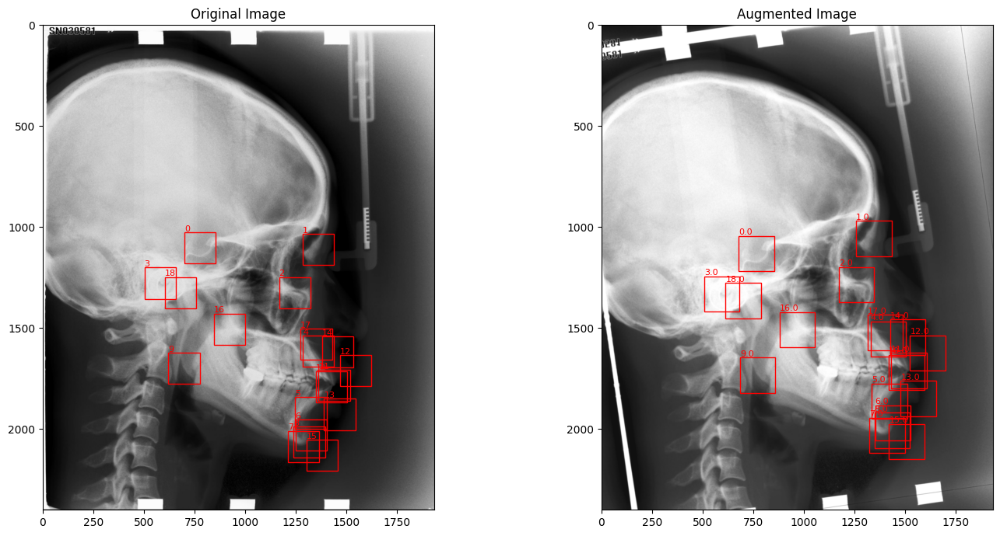

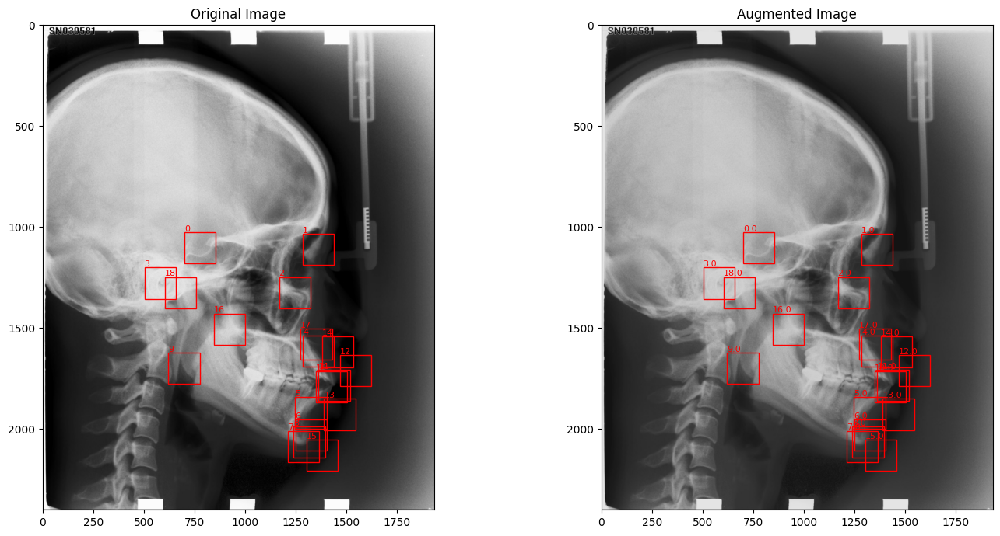

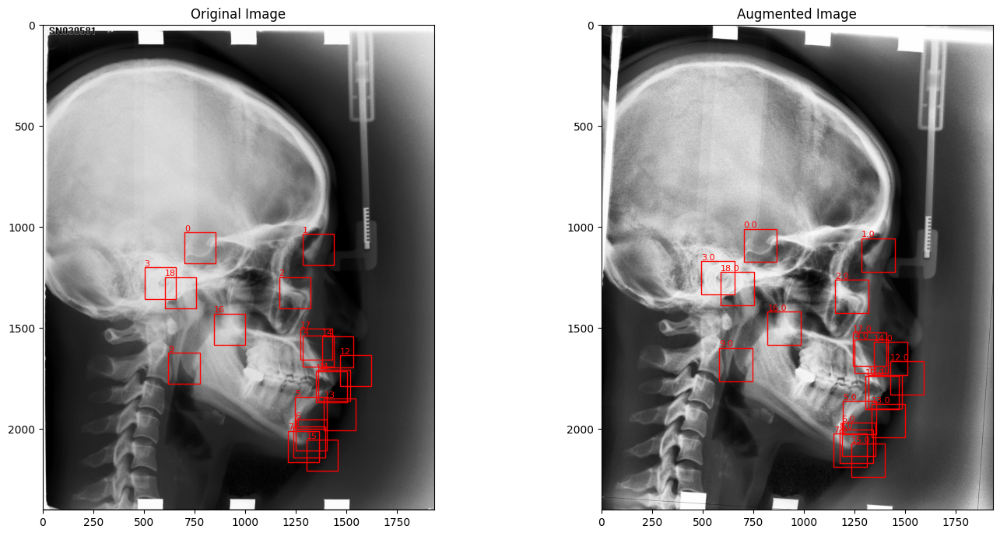

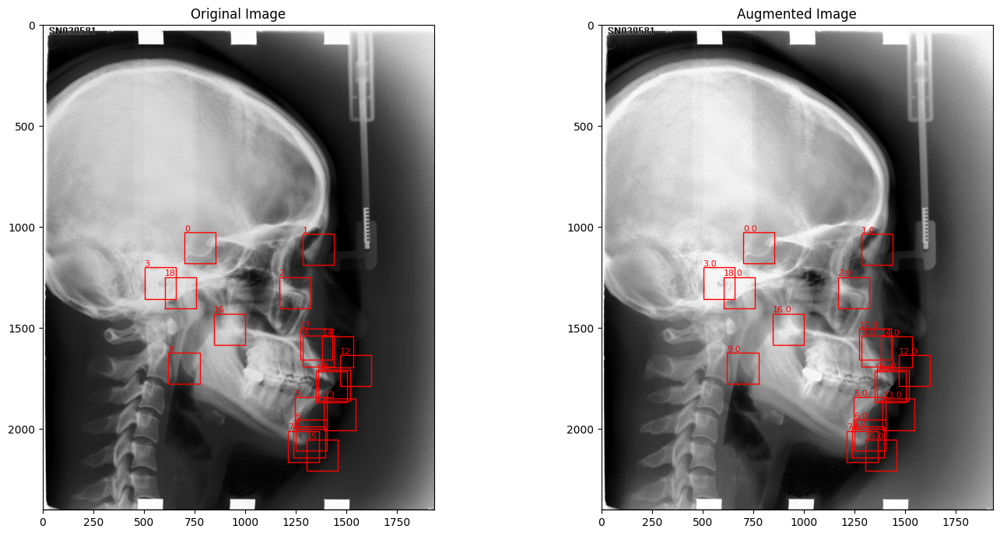

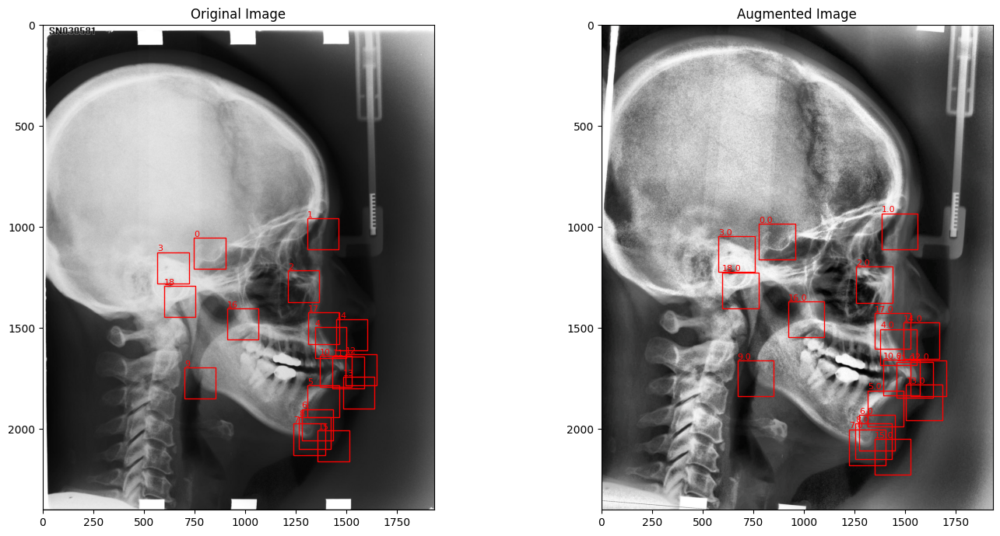

Dataset size increased by a factor of 1.0


In [20]:
# Initialize augmentation pipeline
augmenter = CephalometricAugmentation(
    images_dir='/kaggle/working/dataset/train/images',
    labels_dir='/kaggle/working/dataset/train/labels',
    output_dir = '/kaggle/working/dataset/train_aug',
    num_augmentations=4
)

# Process the dataset
augmented_pairs = augmenter.process_dataset()

# Visualize some examples
augmenter.visualize_augmentations(augmented_pairs)

# Get dataset statistics
stats = augmenter.get_dataset_stats()
print(f"Dataset size increased by a factor of {stats['augmentation_factor']}")

### Labels Processor ('YOLO_FORMAT')

In [21]:
from pathlib import Path

class LandmarkLabelsProcessor:
    def __init__(self, labels_dir):
        self.labels_dir = Path(labels_dir)
        self.labels_dict = {}
        self.width, self.height = 1935, 2400

    def _convert_yolo_to_xywh(self, x_center, y_center, width, height):
        """Convert YOLO format (xywhn) to xywh"""
        return {"x": x_center, "y": y_center, "width": width, "height": height}

    def process_labels(self):
        """Process all label files in directory"""
        for label_file in self.labels_dir.glob("*.txt"):
            # Get corresponding image name
            image_name = label_file.stem + ".jpg"

            # Initialize nested dict for this image
            self.labels_dict[image_name] = {str(i): None for i in range(19)}

            # Read and process label file
            with open(label_file, "r") as f:
                for line in f:
                    class_id, xc, yc, w, h = map(float, line.strip().split())                    
                    bbox = {"x": xc, "y": yc, "width": w, "height": h}
                    str_class_id = str(int(class_id))
                    # Store in nested dict
                    self.labels_dict[image_name][str_class_id] = bbox

        return self.labels_dict

    def calculate_landmark_centroids(self):
        """Calculate centroid coordinates for each landmark class across all images."""
        # Dictionary to store coordinates for each class
        class_points = {}

        # Collect all points for each class
        for image_data in self.labels_dict.values():
            for class_id, bbox in image_data.items():
                if class_id not in class_points:
                    class_points[class_id] = {'x': [], 'y': []}
                # Use center point of bbox
                class_points[class_id]['x'].append(bbox['x'])
                class_points[class_id]['y'].append(bbox['y'])

        # Calculate centroids
        centroids = {}
        for class_id, points in class_points.items():
            if points['x'] and points['y']:  # Check if we have any points
                centroids[class_id] = {
                    'x': sum(points['x']) / len(points['x']),
                    'y': sum(points['y']) / len(points['y']),
                    'count': len(points['x'])  # Number of instances
                }

        return centroids


## Ceph Pipeline for Images

In [22]:
class CephalometricPipeline:
    def __init__(self, easy_labels_model, hard_labels_model, train_folder, classes_names, labels_centroids, batch_size= 8):
        
        self.train_folder = train_folder
        self.easy_labels_model = easy_labels_model
        self.hard_labels_model = hard_labels_model
        self.yolo_predictions = {}  # Dictionary to store predictions
        self.classes_names = classes_names
        self.transform = T.Compose(
            [
                T.Resize((224, 224)),
                T.ToTensor(),
                T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
            ]
        )
        self.feature_extractor = inception_v3(pretrained=True)
        self.feature_extractor.fc = torch.nn.Identity()  # Remove classification layer
        self.feature_extractor.eval()
        self.predictions = {}
        self.labels_centroids = labels_centroids
        self.batch_size = batch_size

    def predict(self, image, conf=0.0, iou=0.5):
        """
        Predicts labels in the image using the YOLO model.
        """
        if not os.path.isfile(image):
            raise FileNotFoundError(f"The image file '{image}' does not exist.")
        
        image_name = os.path.basename(image)
        
        # Clear previous predictions
        self.predicted_centers = {str(i): None for i in range(19)}
        self.predictions[image_name] = {str(i): None for i in range(19)}
        
        image = Image.open(image)

        if self.easy_labels_model:
            easy_labels_results = self.easy_labels_model.predict(source=image, conf=conf, iou=iou)
            # Process predictions for easy labels
            for result in easy_labels_results:
                for det in result.boxes:
                    # IF I WANT UNNORMALIZED COORDINATES
                    x_center, y_center, width, height = det.xywh[0].tolist()
                    
                    # IF I WANT NORMALIZED COORDINATES
                    # x_center, y_center, width, height = det.xywhn[0].tolist()
                    
                    cls = det.cls.item()
                    class_id = cls2idx[easy_labels_mapper[str(int(cls))]]
                    class_id_str = str(int(class_id))
                    confidence = det.conf.item()

                    # Check if the class_id already exists and compare confidence
                    existing = self.predictions[image_name].get(class_id_str)
                    if not existing or confidence > existing["confidence"]:
                        self.predictions[image_name][class_id_str] = {
                            "bbox": [x_center, y_center, width, height],
                            "confidence": confidence,
                        }
                        self.predicted_centers[class_id_str] = [x_center, y_center]

        if self.hard_labels_model:
            hard_labels_results = self.hard_labels_model.predict(source=image, conf=conf, iou=iou)
            # Process predictions for hard labels
            for result in hard_labels_results:
                for det in result.boxes:
                    x_center, y_center, width, height = det.xywh[0].tolist()
                    cls = det.cls.item()
                    class_id = cls2idx[hard_labels_mapper[str(int(cls))]]
                    class_id_str = str(int(class_id))
                    confidence = det.conf.item()

                    # Check if the class_id already exists and compare confidence
                    existing = self.predictions[image_name].get(class_id_str)
                    if not existing or confidence > existing["confidence"]:
                        self.predictions[image_name][class_id_str] = {
                            "bbox": [x_center, y_center, width, height],
                            "confidence": confidence,
                        }
                        self.predicted_centers[class_id_str] = [x_center, y_center]
        # print(self.predictions)
        return self.predictions[image_name]

    def process_image(self, image_path, predictions, roi_width, roi_height):
        """Process YOLO predictions for an image to extract ROIs."""
        image = Image.open(image_path)
        image_name = os.path.basename(image_path)
        rois = []
        rois_dict = {}
        new_predictions = predictions.copy()
        for class_id_str, detection in predictions.items():
            if detection is None:
                print(f"landmark {self.classes_names[int(class_id_str)]} detection failed")
                centroid = self.labels_centroids[class_id_str]
                xc, yc = float(centroid['x']), float(centroid['y'])
                new_predictions[class_id_str] = {
                    'bbox': [xc, yc, 155, 155],
                    'confidence': 0,
                }

                x_start = max(0, xc - roi_width // 2)
                y_start = max(0, yc - roi_height // 2)
                x_end = min(image.width, xc + roi_width // 2)
                y_end = min(image.height, yc + roi_height // 2)
                
                roi = image.crop((x_start, y_start, x_end, y_end))
                roi = self.transform(roi)
                rois.append(roi)
                rois_dict[class_id_str] = roi

            if detection is not None:
                x_center, y_center, _, _ = detection["bbox"]  # [x_center, y_center, width, height]
                xc, yc = float(x_center), float(y_center)

                x_start = max(0, xc - roi_width // 2)
                y_start = max(0, yc - roi_height // 2)
                x_end = min(image.width, xc + roi_width // 2)
                y_end = min(image.height, yc + roi_height // 2)
                # print(x_start, x_end)

                roi = image.crop((x_start, y_start, x_end, y_end))
                roi = self.transform(roi)
                rois.append(roi)
                rois_dict[class_id_str] = roi
                
        # print((rois[0].shape))
        # print((rois_dict))
        return torch.stack(rois) if rois else None, rois_dict, new_predictions

    def extract_features(self, rois_tensor):
        """Extract features from ROIs for a single image."""
        # rois_tensor shape: (19, 3, 224, 224)
        with torch.no_grad():
            # Ensure we're on the right device
            torch.cuda.set_device(0)
            if torch.cuda.is_available():
                rois_tensor = rois_tensor.cuda()
                self.feature_extractor = self.feature_extractor.cuda()

            # Process all ROIs from the single image
            features = self.feature_extractor(rois_tensor)  # Output shape: (19, feature_dim)

            # Move back to CPU if needed
            features = features.cpu()

            return features  # Shape: (19, feature_dim)

    def batch_generator(self, lst):
        """Yield successive batch-sized chunks from lst."""
        for i in range(0, len(lst), self.batch_size):
            yield lst[i:i + self.batch_size]

    def predict_batch(self, image_paths):
        """Predict on a batch of images."""
        return [self.predict(img_path) for img_path in image_paths]

    def process_image_batch(self, image_paths, predictions, roi_width, roi_height):
        """Process batch of images to extract ROIs."""
        return [
            self.process_image(img_path, pred, roi_width, roi_height)
            for img_path, pred in zip(image_paths, predictions)
        ]

    def extract_features_batch(self, batch_rois):
        """Extract features from batch of ROIs."""
        return [self.extract_features(rois) for rois in batch_rois]

    def process_folder(self, train_folder, roi_width, roi_height):
        """Process entire folder in batches."""
        image_list = os.listdir(train_folder)
        all_features = []

        for batch_images in self.batch_generator(image_list):
            # Prepare batch
            image_paths = [os.path.join(train_folder, img) for img in batch_images]

            # Process batch
            batch_predictions = self.predict_batch(image_paths)
            batch_rois = self.process_image_batch(image_paths, batch_predictions, roi_width, roi_height)
            batch_features = self.extract_features_batch(batch_rois)

            # Store or process features
            all_features.extend(batch_features)

            # Print shapes for monitoring
            for img_name, features in zip(batch_images, batch_features):
                print(f"Image {img_name}: {features.shape}")

        return all_features


In [23]:
def process_folder(data_folder, pipeline, roi_width, roi_height):
    # Initialize containers
    feature_dict = {}
    feature_list = []

    # Start timing
    start_time = time.time()
    predictions = {}
    # Process all images
    for image_name in tqdm(os.listdir(data_folder)):
        image_path = os.path.join(data_folder, image_name)

        # Process single image
        data_dict = pipeline.predict(image_path)
        rois, _, data_dict_2 = pipeline.process_image(image_path, data_dict, roi_width, roi_height)
        predictions[image_name] = data_dict_2
        # print(data_dict_2)
        features = pipeline.extract_features(rois)

        # Store features
        feature_dict[image_name] = features
        feature_list.append(features)

        # Print progress
        print(f"Processed {image_name}: {features.shape}")

    # Calculate execution time
    end_time = time.time()
    execution_time = end_time - start_time

    print(f"\nProcessing Summary:")
    print(f"Total images processed: {len(feature_dict)}")
    print(f"Total execution time: {execution_time:.2f} seconds")
    print(f"Average time per image: {execution_time/len(feature_dict):.2f} seconds")

    return {
        'predictions': predictions,
        'feature_dict': feature_dict,
        'feature_list': feature_list,
        'execution_time': execution_time
    }

### Train Data Setup

In [24]:
train_folder = f"{platform_root}/dataset/train/images"  # Path to training images

# Generate YOLO predictions for all images in the training folder
roi_width = 512  # Specify the width of the ROI
roi_height = 512  # Specify the height of the ROI

train_processor = LandmarkLabelsProcessor(f"{platform_root}/dataset/train/labels")
train_labels = train_processor.process_labels()
# print(train_labels)
train_centroids = train_processor.calculate_landmark_centroids()
# first_image = list(train_distances.keys())[0]
# print(train_centroids)
train_pipeline = CephalometricPipeline(
    easy_labels_model=easy_model,
    hard_labels_model=hard_model,
    train_folder=train_folder,
    classes_names=categories_names,
    labels_centroids=train_centroids,
)

# Usage
train_results = process_folder(train_folder, train_pipeline, roi_width, roi_height)

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth
100%|██████████| 104M/104M [00:00<00:00, 206MB/s] 
  0%|          | 0/280 [00:00<?, ?it/s]


0: 1024x832 58 Ss, 35 Pos, 12 Pogs, 30 Mes, 14 Gns, 6 Iis, 5 Iss, 65 ULs, 31 LLs, 44 Sns, 123.1ms
Speed: 15.5ms preprocess, 123.1ms inference, 328.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 6 Ors, 12 As, 42 Bs, 90 Gos, 50 Pog`s, 28 PNSs, 21 ANSs, 38 Ars, 110.1ms
Speed: 6.4ms preprocess, 110.1ms inference, 55.8ms postprocess per image at shape (1, 3, 1024, 832)


  0%|          | 1/280 [00:03<18:35,  4.00s/it]

Processed 223.jpg: torch.Size([19, 2048])

0: 1024x832 49 Ss, 27 Pos, 27 Pogs, 45 Mes, 13 Gns, 8 Iis, 5 Iss, 56 ULs, 29 LLs, 41 Sns, 103.1ms
Speed: 6.0ms preprocess, 103.1ms inference, 46.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 8 Ors, 16 As, 39 Bs, 100 Gos, 59 Pog`s, 20 PNSs, 15 ANSs, 32 Ars, 100.4ms
Speed: 6.0ms preprocess, 100.4ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)


  1%|          | 2/280 [00:04<09:32,  2.06s/it]

Processed 129.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 52 Pos, 22 Pogs, 29 Mes, 11 Gns, 7 Iis, 5 Iss, 63 ULs, 11 LLs, 34 Sns, 104.7ms
Speed: 5.9ms preprocess, 104.7ms inference, 47.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 16 Ors, 20 As, 36 Bs, 83 Gos, 54 Pog`s, 17 PNSs, 17 ANSs, 43 Ars, 104.6ms
Speed: 6.1ms preprocess, 104.6ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)


  1%|          | 3/280 [00:05<06:38,  1.44s/it]

Processed 315.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 40 Pos, 15 Pogs, 34 Mes, 14 Gns, 9 Iis, 10 Iss, 58 ULs, 15 LLs, 46 Sns, 101.2ms
Speed: 6.4ms preprocess, 101.2ms inference, 44.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 9 Ors, 19 As, 40 Bs, 82 Gos, 59 Pog`s, 27 PNSs, 9 ANSs, 38 Ars, 103.9ms
Speed: 6.2ms preprocess, 103.9ms inference, 47.0ms postprocess per image at shape (1, 3, 1024, 832)


  1%|▏         | 4/280 [00:06<05:15,  1.14s/it]

Processed 399.jpg: torch.Size([19, 2048])

0: 1024x832 32 Ss, 30 Pos, 14 Pogs, 33 Mes, 12 Gns, 11 Iis, 14 Iss, 73 ULs, 24 LLs, 57 Sns, 104.0ms
Speed: 6.0ms preprocess, 104.0ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 13 Ors, 14 As, 41 Bs, 102 Gos, 53 Pog`s, 21 PNSs, 20 ANSs, 24 Ars, 101.9ms
Speed: 6.2ms preprocess, 101.9ms inference, 45.1ms postprocess per image at shape (1, 3, 1024, 832)


  2%|▏         | 5/280 [00:06<04:29,  1.02it/s]

Processed 106.jpg: torch.Size([19, 2048])

0: 1024x832 35 Ss, 25 Pos, 22 Pogs, 35 Mes, 12 Gns, 7 Iis, 8 Iss, 75 ULs, 22 LLs, 59 Sns, 101.2ms
Speed: 6.1ms preprocess, 101.2ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 10 Ors, 13 As, 52 Bs, 96 Gos, 61 Pog`s, 22 PNSs, 11 ANSs, 20 Ars, 103.6ms
Speed: 6.1ms preprocess, 103.6ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)


  2%|▏         | 6/280 [00:07<04:00,  1.14it/s]

Processed 144.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 38 Pos, 18 Pogs, 26 Mes, 7 Gns, 9 Iis, 7 Iss, 66 ULs, 18 LLs, 46 Sns, 84.2ms
Speed: 6.4ms preprocess, 84.2ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 8 Ors, 16 As, 41 Bs, 84 Gos, 62 Pog`s, 17 PNSs, 16 ANSs, 47 Ars, 102.8ms
Speed: 6.3ms preprocess, 102.8ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


  2%|▎         | 7/280 [00:08<03:41,  1.23it/s]

Processed 171.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 41 Pos, 17 Pogs, 25 Mes, 12 Gns, 6 Iis, 10 Iss, 60 ULs, 24 LLs, 47 Sns, 101.8ms
Speed: 6.1ms preprocess, 101.8ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 5 Ors, 20 As, 51 Bs, 82 Gos, 60 Pog`s, 23 PNSs, 13 ANSs, 36 Ars, 107.2ms
Speed: 6.1ms preprocess, 107.2ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)


  3%|▎         | 8/280 [00:08<03:29,  1.30it/s]

Processed 165.jpg: torch.Size([19, 2048])

0: 1024x832 69 Ss, 46 Pos, 15 Pogs, 25 Mes, 12 Gns, 7 Iis, 7 Iss, 58 ULs, 27 LLs, 34 Sns, 105.2ms
Speed: 6.2ms preprocess, 105.2ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 5 Ors, 21 As, 38 Bs, 99 Gos, 47 Pog`s, 20 PNSs, 22 ANSs, 38 Ars, 103.2ms
Speed: 5.8ms preprocess, 103.2ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)


  3%|▎         | 9/280 [00:09<03:21,  1.34it/s]

Processed 209.jpg: torch.Size([19, 2048])

0: 1024x832 43 Ss, 43 Pos, 20 Pogs, 31 Mes, 13 Gns, 7 Iis, 5 Iss, 74 ULs, 28 LLs, 36 Sns, 102.7ms
Speed: 6.1ms preprocess, 102.7ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 6 Ors, 20 As, 36 Bs, 96 Gos, 53 Pog`s, 23 PNSs, 23 ANSs, 36 Ars, 105.4ms
Speed: 6.1ms preprocess, 105.4ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)


  4%|▎         | 10/280 [00:10<03:16,  1.38it/s]

Processed 100.jpg: torch.Size([19, 2048])

0: 1024x832 70 Ss, 39 Pos, 15 Pogs, 29 Mes, 14 Gns, 3 Iis, 9 Iss, 48 ULs, 23 LLs, 50 Sns, 104.2ms
Speed: 5.9ms preprocess, 104.2ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 13 Ors, 20 As, 47 Bs, 86 Gos, 51 Pog`s, 20 PNSs, 16 ANSs, 34 Ars, 98.1ms
Speed: 5.9ms preprocess, 98.1ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


  4%|▍         | 11/280 [00:10<03:11,  1.40it/s]

Processed 172.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 37 Pos, 19 Pogs, 41 Mes, 12 Gns, 8 Iis, 7 Iss, 53 ULs, 15 LLs, 42 Sns, 102.6ms
Speed: 5.9ms preprocess, 102.6ms inference, 43.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 13 Ors, 19 As, 40 Bs, 78 Gos, 53 Pog`s, 22 PNSs, 20 ANSs, 43 Ars, 100.9ms
Speed: 5.8ms preprocess, 100.9ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)


  4%|▍         | 12/280 [00:11<03:08,  1.42it/s]

Processed 297.jpg: torch.Size([19, 2048])

0: 1024x832 84 Ss, 76 Pos, 11 Pogs, 27 Mes, 6 Gns, 1 Ii, 3 Iss, 55 ULs, 16 LLs, 21 Sns, 104.2ms
Speed: 5.9ms preprocess, 104.2ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 12 Ors, 15 As, 30 Bs, 85 Gos, 45 Pog`s, 27 PNSs, 14 ANSs, 61 Ars, 101.5ms
Speed: 5.8ms preprocess, 101.5ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)


  5%|▍         | 13/280 [00:12<03:05,  1.44it/s]

Processed 077.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 46 Pos, 13 Pogs, 24 Mes, 9 Gns, 7 Iis, 7 Iss, 71 ULs, 24 LLs, 41 Sns, 103.7ms
Speed: 6.8ms preprocess, 103.7ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 14 Ors, 20 As, 47 Bs, 84 Gos, 54 Pog`s, 18 PNSs, 15 ANSs, 34 Ars, 105.9ms
Speed: 6.2ms preprocess, 105.9ms inference, 47.2ms postprocess per image at shape (1, 3, 1024, 832)


  5%|▌         | 14/280 [00:12<03:07,  1.42it/s]

Processed 311.jpg: torch.Size([19, 2048])

0: 1024x832 47 Ss, 25 Pos, 14 Pogs, 35 Mes, 12 Gns, 9 Iis, 8 Iss, 69 ULs, 24 LLs, 57 Sns, 106.0ms
Speed: 6.4ms preprocess, 106.0ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 12 Ors, 21 As, 42 Bs, 90 Gos, 51 Pog`s, 27 PNSs, 18 ANSs, 27 Ars, 102.2ms
Speed: 6.0ms preprocess, 102.2ms inference, 47.8ms postprocess per image at shape (1, 3, 1024, 832)


  5%|▌         | 15/280 [00:13<03:13,  1.37it/s]

Processed 216.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 51 Pos, 18 Pogs, 42 Mes, 11 Gns, 2 Iis, 4 Iss, 46 ULs, 19 LLs, 41 Sns, 103.3ms
Speed: 6.2ms preprocess, 103.3ms inference, 44.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 7 Ors, 18 As, 39 Bs, 63 Gos, 63 Pog`s, 27 PNSs, 21 ANSs, 50 Ars, 102.7ms
Speed: 5.9ms preprocess, 102.7ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)


  6%|▌         | 16/280 [00:14<03:09,  1.40it/s]

Processed 319.jpg: torch.Size([19, 2048])

0: 1024x832 46 Ss, 31 Pos, 21 Pogs, 45 Mes, 15 Gns, 12 Iis, 16 Iss, 48 ULs, 16 LLs, 50 Sns, 104.3ms
Speed: 6.8ms preprocess, 104.3ms inference, 47.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 10 Ors, 16 As, 35 Bs, 104 Gos, 47 Pog`s, 20 PNSs, 19 ANSs, 36 Ars, 102.5ms
Speed: 5.9ms preprocess, 102.5ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)


  6%|▌         | 17/280 [00:15<03:06,  1.41it/s]

Processed 262.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 42 Pos, 15 Pogs, 43 Mes, 12 Gns, 5 Iis, 11 Iss, 46 ULs, 21 LLs, 39 Sns, 102.2ms
Speed: 7.1ms preprocess, 102.2ms inference, 47.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 8 Ors, 15 As, 49 Bs, 96 Gos, 52 Pog`s, 14 PNSs, 15 ANSs, 34 Ars, 102.4ms
Speed: 6.5ms preprocess, 102.4ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


  6%|▋         | 18/280 [00:15<03:04,  1.42it/s]

Processed 188.jpg: torch.Size([19, 2048])

0: 1024x832 38 Ss, 19 Pos, 15 Pogs, 40 Mes, 13 Gns, 7 Iis, 12 Iss, 63 ULs, 31 LLs, 62 Sns, 106.9ms
Speed: 7.2ms preprocess, 106.9ms inference, 43.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 9 Ors, 16 As, 47 Bs, 96 Gos, 54 Pog`s, 15 PNSs, 20 ANSs, 28 Ars, 102.7ms
Speed: 5.9ms preprocess, 102.7ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)


  7%|▋         | 19/280 [00:16<03:01,  1.44it/s]

Processed 140.jpg: torch.Size([19, 2048])

0: 1024x832 43 Ss, 28 Pos, 23 Pogs, 33 Mes, 24 Gns, 11 Iis, 13 Iss, 52 ULs, 25 LLs, 48 Sns, 101.9ms
Speed: 6.2ms preprocess, 101.9ms inference, 43.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 10 Ors, 23 As, 46 Bs, 67 Gos, 61 Pog`s, 24 PNSs, 30 ANSs, 30 Ars, 105.3ms
Speed: 6.1ms preprocess, 105.3ms inference, 47.2ms postprocess per image at shape (1, 3, 1024, 832)


  7%|▋         | 20/280 [00:17<03:00,  1.44it/s]

Processed 359.jpg: torch.Size([19, 2048])

0: 1024x832 81 Ss, 51 Pos, 20 Pogs, 28 Mes, 9 Gns, 5 Iis, 8 Iss, 50 ULs, 18 LLs, 30 Sns, 108.0ms
Speed: 6.0ms preprocess, 108.0ms inference, 45.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 15 Ors, 16 As, 38 Bs, 83 Gos, 50 Pog`s, 20 PNSs, 24 ANSs, 43 Ars, 101.8ms
Speed: 5.9ms preprocess, 101.8ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)


  8%|▊         | 21/280 [00:17<02:59,  1.44it/s]

Processed 207.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 42 Pos, 15 Pogs, 37 Mes, 12 Gns, 5 Iis, 5 Iss, 57 ULs, 16 LLs, 46 Sns, 105.3ms
Speed: 6.1ms preprocess, 105.3ms inference, 43.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 11 Ors, 21 As, 47 Bs, 85 Gos, 54 Pog`s, 15 PNSs, 19 ANSs, 37 Ars, 104.0ms
Speed: 5.9ms preprocess, 104.0ms inference, 43.9ms postprocess per image at shape (1, 3, 1024, 832)


  8%|▊         | 22/280 [00:18<02:57,  1.45it/s]

Processed 152.jpg: torch.Size([19, 2048])

0: 1024x832 64 Ss, 49 Pos, 17 Pogs, 20 Mes, 8 Gns, 8 Iis, 11 Iss, 60 ULs, 22 LLs, 41 Sns, 103.7ms
Speed: 6.2ms preprocess, 103.7ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 15 Ors, 18 As, 45 Bs, 85 Gos, 52 Pog`s, 17 PNSs, 17 ANSs, 39 Ars, 105.3ms
Speed: 7.6ms preprocess, 105.3ms inference, 45.1ms postprocess per image at shape (1, 3, 1024, 832)


  8%|▊         | 23/280 [00:19<02:56,  1.46it/s]

Processed 229.jpg: torch.Size([19, 2048])

0: 1024x832 37 Ss, 22 Pos, 20 Pogs, 40 Mes, 15 Gns, 5 Iis, 10 Iss, 69 ULs, 24 LLs, 58 Sns, 105.0ms
Speed: 6.1ms preprocess, 105.0ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 12 Ors, 13 As, 40 Bs, 88 Gos, 62 Pog`s, 23 PNSs, 20 ANSs, 31 Ars, 102.6ms
Speed: 5.8ms preprocess, 102.6ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)


  9%|▊         | 24/280 [00:19<02:55,  1.46it/s]

Processed 010.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 29 Pos, 13 Pogs, 25 Mes, 14 Gns, 6 Iis, 10 Iss, 78 ULs, 15 LLs, 42 Sns, 102.1ms
Speed: 5.9ms preprocess, 102.1ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 14 Ors, 17 As, 43 Bs, 92 Gos, 43 Pog`s, 22 PNSs, 17 ANSs, 38 Ars, 104.5ms
Speed: 6.2ms preprocess, 104.5ms inference, 46.4ms postprocess per image at shape (1, 3, 1024, 832)


  9%|▉         | 25/280 [00:20<02:54,  1.47it/s]

Processed 340.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 36 Pos, 16 Pogs, 27 Mes, 10 Gns, 5 Iis, 7 Iss, 68 ULs, 18 LLs, 47 Sns, 104.8ms
Speed: 6.0ms preprocess, 104.8ms inference, 43.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 16 Ors, 20 As, 50 Bs, 97 Gos, 44 Pog`s, 15 PNSs, 24 ANSs, 26 Ars, 104.0ms
Speed: 6.1ms preprocess, 104.0ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)


  9%|▉         | 26/280 [00:21<02:54,  1.46it/s]

Processed 364.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 35 Pos, 18 Pogs, 37 Mes, 9 Gns, 9 Iis, 7 Iss, 63 ULs, 19 LLs, 44 Sns, 103.5ms
Speed: 5.8ms preprocess, 103.5ms inference, 42.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 7 Ors, 15 As, 46 Bs, 82 Gos, 58 Pog`s, 19 PNSs, 23 ANSs, 34 Ars, 102.3ms
Speed: 6.0ms preprocess, 102.3ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)


 10%|▉         | 27/280 [00:21<02:53,  1.46it/s]

Processed 020.jpg: torch.Size([19, 2048])

0: 1024x832 50 Ss, 31 Pos, 15 Pogs, 43 Mes, 10 Gns, 3 Iis, 6 Iss, 66 ULs, 24 LLs, 52 Sns, 104.1ms
Speed: 5.9ms preprocess, 104.1ms inference, 43.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 15 Ors, 9 As, 50 Bs, 103 Gos, 42 Pog`s, 15 PNSs, 7 ANSs, 42 Ars, 103.9ms
Speed: 6.0ms preprocess, 103.9ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)


 10%|█         | 28/280 [00:22<02:52,  1.46it/s]

Processed 213.jpg: torch.Size([19, 2048])

0: 1024x832 61 Ss, 45 Pos, 21 Pogs, 28 Mes, 11 Gns, 7 Iis, 15 Iss, 49 ULs, 17 LLs, 46 Sns, 106.3ms
Speed: 6.7ms preprocess, 106.3ms inference, 44.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 5 Ns, 11 Ors, 18 As, 46 Bs, 78 Gos, 57 Pog`s, 23 PNSs, 18 ANSs, 44 Ars, 104.3ms
Speed: 6.0ms preprocess, 104.3ms inference, 44.4ms postprocess per image at shape (1, 3, 1024, 832)


 10%|█         | 29/280 [00:23<02:51,  1.46it/s]

Processed 147.jpg: torch.Size([19, 2048])

0: 1024x832 76 Ss, 42 Pos, 10 Pogs, 40 Mes, 14 Gns, 8 Iis, 8 Iss, 46 ULs, 20 LLs, 36 Sns, 107.1ms
Speed: 6.6ms preprocess, 107.1ms inference, 49.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 11 Ors, 14 As, 29 Bs, 85 Gos, 50 Pog`s, 32 PNSs, 19 ANSs, 50 Ars, 90.3ms
Speed: 6.1ms preprocess, 90.3ms inference, 47.9ms postprocess per image at shape (1, 3, 1024, 832)


 11%|█         | 30/280 [00:24<02:52,  1.45it/s]

Processed 351.jpg: torch.Size([19, 2048])

0: 1024x832 75 Ss, 61 Pos, 14 Pogs, 23 Mes, 6 Gns, 5 Iis, 7 Iss, 54 ULs, 14 LLs, 41 Sns, 106.4ms
Speed: 6.8ms preprocess, 106.4ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 6 Ors, 22 As, 40 Bs, 84 Gos, 52 Pog`s, 21 PNSs, 16 ANSs, 50 Ars, 102.4ms
Speed: 5.9ms preprocess, 102.4ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)


 11%|█         | 31/280 [00:24<02:52,  1.45it/s]

Processed 035.jpg: torch.Size([19, 2048])

0: 1024x832 39 Ss, 28 Pos, 16 Pogs, 35 Mes, 6 Gns, 7 Iis, 10 Iss, 79 ULs, 18 LLs, 62 Sns, 103.3ms
Speed: 6.2ms preprocess, 103.3ms inference, 46.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 7 Ors, 9 As, 49 Bs, 94 Gos, 65 Pog`s, 21 PNSs, 8 ANSs, 36 Ars, 105.9ms
Speed: 5.9ms preprocess, 105.9ms inference, 44.4ms postprocess per image at shape (1, 3, 1024, 832)


 11%|█▏        | 32/280 [00:25<02:50,  1.45it/s]

Processed 180.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 33 Pos, 22 Pogs, 36 Mes, 11 Gns, 8 Iis, 11 Iss, 45 ULs, 20 LLs, 49 Sns, 102.9ms
Speed: 6.0ms preprocess, 102.9ms inference, 43.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 21 Ns, 14 Ors, 19 As, 39 Bs, 90 Gos, 46 Pog`s, 22 PNSs, 25 ANSs, 24 Ars, 104.2ms
Speed: 5.9ms preprocess, 104.2ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)


 12%|█▏        | 33/280 [00:26<02:49,  1.46it/s]

Processed 314.jpg: torch.Size([19, 2048])

0: 1024x832 62 Ss, 42 Pos, 15 Pogs, 30 Mes, 9 Gns, 10 Iis, 9 Iss, 62 ULs, 21 LLs, 40 Sns, 107.0ms
Speed: 5.9ms preprocess, 107.0ms inference, 43.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 11 Ors, 17 As, 38 Bs, 90 Gos, 62 Pog`s, 25 PNSs, 17 ANSs, 31 Ars, 103.9ms
Speed: 6.8ms preprocess, 103.9ms inference, 43.9ms postprocess per image at shape (1, 3, 1024, 832)


 12%|█▏        | 34/280 [00:26<02:48,  1.46it/s]

Processed 089.jpg: torch.Size([19, 2048])

0: 1024x832 62 Ss, 32 Pos, 13 Pogs, 31 Mes, 9 Gns, 5 Iis, 10 Iss, 74 ULs, 24 LLs, 40 Sns, 106.2ms
Speed: 6.0ms preprocess, 106.2ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 15 Ors, 19 As, 41 Bs, 92 Gos, 50 Pog`s, 22 PNSs, 16 ANSs, 29 Ars, 106.3ms
Speed: 6.1ms preprocess, 106.3ms inference, 48.4ms postprocess per image at shape (1, 3, 1024, 832)


 12%|█▎        | 35/280 [00:27<02:48,  1.46it/s]

Processed 156.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 56 Pos, 16 Pogs, 21 Mes, 10 Gns, 9 Iis, 10 Iss, 54 ULs, 14 LLs, 39 Sns, 104.6ms
Speed: 5.8ms preprocess, 104.6ms inference, 45.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 7 Ors, 22 As, 40 Bs, 94 Gos, 47 Pog`s, 16 PNSs, 17 ANSs, 44 Ars, 103.9ms
Speed: 6.0ms preprocess, 103.9ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)


 13%|█▎        | 36/280 [00:28<02:47,  1.45it/s]

Processed 002.jpg: torch.Size([19, 2048])

0: 1024x832 83 Ss, 58 Pos, 14 Pogs, 26 Mes, 9 Gns, 4 Iis, 7 Iss, 46 ULs, 22 LLs, 31 Sns, 106.4ms
Speed: 7.4ms preprocess, 106.4ms inference, 46.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 8 Ors, 14 As, 39 Bs, 81 Gos, 42 Pog`s, 29 PNSs, 15 ANSs, 63 Ars, 106.2ms
Speed: 6.0ms preprocess, 106.2ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)


 13%|█▎        | 37/280 [00:28<02:47,  1.45it/s]

Processed 222.jpg: torch.Size([19, 2048])

0: 1024x832 49 Ss, 32 Pos, 23 Pogs, 47 Mes, 16 Gns, 5 Iis, 6 Iss, 55 ULs, 15 LLs, 52 Sns, 105.9ms
Speed: 6.2ms preprocess, 105.9ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 21 Ns, 15 Ors, 15 As, 41 Bs, 95 Gos, 37 Pog`s, 16 PNSs, 8 ANSs, 52 Ars, 103.4ms
Speed: 6.7ms preprocess, 103.4ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


 14%|█▎        | 38/280 [00:29<02:46,  1.46it/s]

Processed 361.jpg: torch.Size([19, 2048])

0: 1024x832 46 Ss, 27 Pos, 13 Pogs, 37 Mes, 14 Gns, 7 Iis, 13 Iss, 61 ULs, 21 LLs, 61 Sns, 105.3ms
Speed: 6.8ms preprocess, 105.3ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 7 Ors, 23 As, 38 Bs, 82 Gos, 70 Pog`s, 18 PNSs, 20 ANSs, 31 Ars, 105.9ms
Speed: 6.1ms preprocess, 105.9ms inference, 46.8ms postprocess per image at shape (1, 3, 1024, 832)


 14%|█▍        | 39/280 [00:30<02:45,  1.46it/s]

Processed 271.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 51 Pos, 17 Pogs, 25 Mes, 8 Gns, 7 Iis, 8 Iss, 58 ULs, 18 LLs, 42 Sns, 104.6ms
Speed: 5.9ms preprocess, 104.6ms inference, 43.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 9 Ors, 15 As, 42 Bs, 65 Gos, 51 Pog`s, 58 PNSs, 13 ANSs, 39 Ars, 106.8ms
Speed: 5.8ms preprocess, 106.8ms inference, 49.0ms postprocess per image at shape (1, 3, 1024, 832)


 14%|█▍        | 40/280 [00:30<02:44,  1.46it/s]

Processed 260.jpg: torch.Size([19, 2048])

0: 1024x832 67 Ss, 71 Pos, 19 Pogs, 38 Mes, 12 Gns, 4 Iis, 3 Iss, 40 ULs, 9 LLs, 37 Sns, 106.3ms
Speed: 5.7ms preprocess, 106.3ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 24 Ns, 12 Ors, 13 As, 35 Bs, 68 Gos, 43 Pog`s, 15 PNSs, 15 ANSs, 75 Ars, 108.9ms
Speed: 5.9ms preprocess, 108.9ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)


 15%|█▍        | 41/280 [00:31<02:44,  1.45it/s]

Processed 131.jpg: torch.Size([19, 2048])

0: 1024x832 60 Ss, 39 Pos, 22 Pogs, 35 Mes, 9 Gns, 7 Iis, 7 Iss, 58 ULs, 14 LLs, 49 Sns, 106.2ms
Speed: 6.0ms preprocess, 106.2ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 18 Ns, 8 Ors, 16 As, 38 Bs, 94 Gos, 51 Pog`s, 18 PNSs, 14 ANSs, 43 Ars, 105.2ms
Speed: 6.3ms preprocess, 105.2ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)


 15%|█▌        | 42/280 [00:32<02:44,  1.45it/s]

Processed 051.jpg: torch.Size([19, 2048])

0: 1024x832 52 Ss, 29 Pos, 18 Pogs, 34 Mes, 13 Gns, 8 Iis, 12 Iss, 62 ULs, 26 LLs, 46 Sns, 104.6ms
Speed: 6.1ms preprocess, 104.6ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 11 Ors, 18 As, 42 Bs, 99 Gos, 51 Pog`s, 20 PNSs, 20 ANSs, 25 Ars, 103.8ms
Speed: 5.8ms preprocess, 103.8ms inference, 43.8ms postprocess per image at shape (1, 3, 1024, 832)


 15%|█▌        | 43/280 [00:32<02:42,  1.45it/s]

Processed 208.jpg: torch.Size([19, 2048])

0: 1024x832 60 Ss, 44 Pos, 17 Pogs, 31 Mes, 11 Gns, 4 Iis, 6 Iss, 66 ULs, 20 LLs, 41 Sns, 107.9ms
Speed: 6.0ms preprocess, 107.9ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 11 Ors, 18 As, 47 Bs, 85 Gos, 58 Pog`s, 17 PNSs, 18 ANSs, 39 Ars, 104.5ms
Speed: 5.8ms preprocess, 104.5ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)


 16%|█▌        | 44/280 [00:33<02:43,  1.44it/s]

Processed 363.jpg: torch.Size([19, 2048])

0: 1024x832 60 Ss, 45 Pos, 16 Pogs, 35 Mes, 9 Gns, 9 Iis, 10 Iss, 56 ULs, 18 LLs, 42 Sns, 104.3ms
Speed: 5.9ms preprocess, 104.3ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 10 Ors, 15 As, 37 Bs, 95 Gos, 49 Pog`s, 25 PNSs, 10 ANSs, 50 Ars, 106.1ms
Speed: 6.1ms preprocess, 106.1ms inference, 47.1ms postprocess per image at shape (1, 3, 1024, 832)


 16%|█▌        | 45/280 [00:34<02:42,  1.44it/s]

Processed 116.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 44 Pos, 11 Pogs, 26 Mes, 8 Gns, 5 Iis, 5 Iss, 70 ULs, 24 LLs, 39 Sns, 105.7ms
Speed: 5.8ms preprocess, 105.7ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 14 Ors, 19 As, 33 Bs, 103 Gos, 46 Pog`s, 22 PNSs, 15 ANSs, 42 Ars, 106.3ms
Speed: 6.0ms preprocess, 106.3ms inference, 45.5ms postprocess per image at shape (1, 3, 1024, 832)


 16%|█▋        | 46/280 [00:35<02:42,  1.44it/s]

Processed 224.jpg: torch.Size([19, 2048])

0: 1024x832 57 Ss, 38 Pos, 14 Pogs, 47 Mes, 8 Gns, 5 Iis, 8 Iss, 66 ULs, 18 LLs, 39 Sns, 104.7ms
Speed: 6.1ms preprocess, 104.7ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 14 Ors, 14 As, 46 Bs, 101 Gos, 48 Pog`s, 11 PNSs, 8 ANSs, 45 Ars, 104.6ms
Speed: 5.8ms preprocess, 104.6ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


 17%|█▋        | 47/280 [00:35<02:41,  1.44it/s]

Processed 232.jpg: torch.Size([19, 2048])

0: 1024x832 44 Ss, 18 Pos, 31 Pogs, 51 Mes, 15 Gns, 5 Iis, 7 Iss, 53 ULs, 21 LLs, 55 Sns, 103.7ms
Speed: 5.9ms preprocess, 103.7ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 8 Ors, 19 As, 49 Bs, 80 Gos, 60 Pog`s, 13 PNSs, 15 ANSs, 47 Ars, 106.1ms
Speed: 6.0ms preprocess, 106.1ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)


 17%|█▋        | 48/280 [00:36<02:39,  1.45it/s]

Processed 386.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 44 Pos, 15 Pogs, 36 Mes, 7 Gns, 3 Iis, 7 Iss, 62 ULs, 28 LLs, 45 Sns, 105.7ms
Speed: 6.1ms preprocess, 105.7ms inference, 46.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 11 Ors, 11 As, 34 Bs, 86 Gos, 52 Pog`s, 17 PNSs, 13 ANSs, 59 Ars, 106.9ms
Speed: 6.1ms preprocess, 106.9ms inference, 46.6ms postprocess per image at shape (1, 3, 1024, 832)


 18%|█▊        | 49/280 [00:37<02:39,  1.45it/s]

Processed 337.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 40 Pos, 13 Pogs, 34 Mes, 6 Gns, 6 Iis, 10 Iss, 56 ULs, 21 LLs, 49 Sns, 104.1ms
Speed: 6.0ms preprocess, 104.1ms inference, 42.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 10 Ors, 13 As, 44 Bs, 104 Gos, 49 Pog`s, 15 PNSs, 20 ANSs, 34 Ars, 104.8ms
Speed: 6.0ms preprocess, 104.8ms inference, 47.2ms postprocess per image at shape (1, 3, 1024, 832)


 18%|█▊        | 50/280 [00:37<02:38,  1.45it/s]

Processed 330.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 39 Pos, 15 Pogs, 26 Mes, 12 Gns, 8 Iis, 10 Iss, 62 ULs, 17 LLs, 45 Sns, 107.5ms
Speed: 5.8ms preprocess, 107.5ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 9 Ors, 25 As, 44 Bs, 94 Gos, 43 Pog`s, 27 PNSs, 21 ANSs, 27 Ars, 104.4ms
Speed: 6.1ms preprocess, 104.4ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)


 18%|█▊        | 51/280 [00:38<02:38,  1.45it/s]

Processed 306.jpg: torch.Size([19, 2048])

0: 1024x832 88 Ss, 52 Pos, 14 Pogs, 27 Mes, 10 Gns, 6 Iis, 8 Iss, 48 ULs, 6 LLs, 41 Sns, 105.4ms
Speed: 6.1ms preprocess, 105.4ms inference, 44.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 12 Ors, 18 As, 42 Bs, 79 Gos, 54 Pog`s, 22 PNSs, 19 ANSs, 42 Ars, 106.2ms
Speed: 6.1ms preprocess, 106.2ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


 19%|█▊        | 52/280 [00:39<02:37,  1.45it/s]

Processed 057.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 41 Pos, 17 Pogs, 33 Mes, 15 Gns, 8 Iis, 11 Iss, 43 ULs, 16 LLs, 50 Sns, 104.8ms
Speed: 5.9ms preprocess, 104.8ms inference, 42.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 10 Ors, 14 As, 43 Bs, 101 Gos, 56 Pog`s, 20 PNSs, 14 ANSs, 32 Ars, 105.5ms
Speed: 5.7ms preprocess, 105.5ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)


 19%|█▉        | 53/280 [00:39<02:35,  1.46it/s]

Processed 183.jpg: torch.Size([19, 2048])

0: 1024x832 64 Ss, 30 Pos, 18 Pogs, 38 Mes, 14 Gns, 7 Iis, 8 Iss, 54 ULs, 21 LLs, 46 Sns, 107.0ms
Speed: 6.5ms preprocess, 107.0ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 13 Ors, 16 As, 42 Bs, 80 Gos, 52 Pog`s, 29 PNSs, 16 ANSs, 37 Ars, 106.0ms
Speed: 5.9ms preprocess, 106.0ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)


 19%|█▉        | 54/280 [00:40<02:35,  1.45it/s]

Processed 331.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 58 Pos, 20 Pogs, 21 Mes, 5 Gns, 6 Iis, 11 Iss, 66 ULs, 19 LLs, 39 Sns, 105.7ms
Speed: 6.4ms preprocess, 105.7ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 5 Ors, 11 As, 41 Bs, 86 Gos, 59 Pog`s, 10 PNSs, 16 ANSs, 57 Ars, 105.2ms
Speed: 6.3ms preprocess, 105.2ms inference, 48.6ms postprocess per image at shape (1, 3, 1024, 832)


 20%|█▉        | 55/280 [00:41<02:35,  1.45it/s]

Processed 067.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 32 Pos, 20 Pogs, 26 Mes, 9 Gns, 9 Iis, 10 Iss, 64 ULs, 20 LLs, 55 Sns, 106.4ms
Speed: 6.5ms preprocess, 106.4ms inference, 48.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 13 Ors, 16 As, 33 Bs, 96 Gos, 57 Pog`s, 20 PNSs, 24 ANSs, 30 Ars, 108.3ms
Speed: 5.7ms preprocess, 108.3ms inference, 43.7ms postprocess per image at shape (1, 3, 1024, 832)


 20%|██        | 56/280 [00:41<02:34,  1.45it/s]

Processed 160.jpg: torch.Size([19, 2048])

0: 1024x832 39 Ss, 30 Pos, 13 Pogs, 45 Mes, 11 Gns, 1 Ii, 5 Iss, 77 ULs, 30 LLs, 49 Sns, 107.9ms
Speed: 6.1ms preprocess, 107.9ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 20 Ns, 9 Ors, 11 As, 48 Bs, 99 Gos, 38 Pog`s, 20 PNSs, 12 ANSs, 43 Ars, 104.8ms
Speed: 5.7ms preprocess, 104.8ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)


 20%|██        | 57/280 [00:42<02:33,  1.45it/s]

Processed 381.jpg: torch.Size([19, 2048])

0: 1024x832 74 Ss, 54 Pos, 15 Pogs, 28 Mes, 11 Gns, 3 Iis, 13 Iss, 57 ULs, 14 LLs, 31 Sns, 107.2ms
Speed: 6.1ms preprocess, 107.2ms inference, 45.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 20 As, 36 Bs, 100 Gos, 44 Pog`s, 13 PNSs, 15 ANSs, 49 Ars, 105.5ms
Speed: 6.0ms preprocess, 105.5ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)


 21%|██        | 58/280 [00:43<02:33,  1.45it/s]

Processed 357.jpg: torch.Size([19, 2048])

0: 1024x832 61 Ss, 40 Pos, 15 Pogs, 31 Mes, 13 Gns, 6 Iis, 8 Iss, 61 ULs, 20 LLs, 45 Sns, 106.0ms
Speed: 7.0ms preprocess, 106.0ms inference, 47.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 16 Ors, 18 As, 42 Bs, 90 Gos, 49 Pog`s, 22 PNSs, 20 ANSs, 31 Ars, 107.3ms
Speed: 6.0ms preprocess, 107.3ms inference, 53.9ms postprocess per image at shape (1, 3, 1024, 832)


 21%|██        | 59/280 [00:44<02:35,  1.42it/s]

Processed 210.jpg: torch.Size([19, 2048])

0: 1024x832 50 Ss, 27 Pos, 19 Pogs, 42 Mes, 18 Gns, 5 Iis, 12 Iss, 63 ULs, 28 LLs, 36 Sns, 107.0ms
Speed: 6.3ms preprocess, 107.0ms inference, 51.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 9 Ors, 19 As, 34 Bs, 93 Gos, 51 Pog`s, 16 PNSs, 15 ANSs, 53 Ars, 106.1ms
Speed: 6.1ms preprocess, 106.1ms inference, 48.4ms postprocess per image at shape (1, 3, 1024, 832)


 21%|██▏       | 60/280 [00:44<02:35,  1.41it/s]

Processed 083.jpg: torch.Size([19, 2048])

0: 1024x832 48 Ss, 42 Pos, 18 Pogs, 29 Mes, 10 Gns, 6 Iis, 9 Iss, 63 ULs, 34 LLs, 41 Sns, 108.6ms
Speed: 6.1ms preprocess, 108.6ms inference, 44.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 5 Ors, 12 As, 55 Bs, 101 Gos, 55 Pog`s, 17 PNSs, 12 ANSs, 37 Ars, 104.2ms
Speed: 6.0ms preprocess, 104.2ms inference, 47.8ms postprocess per image at shape (1, 3, 1024, 832)


 22%|██▏       | 61/280 [00:45<02:35,  1.41it/s]

Processed 211.jpg: torch.Size([19, 2048])

0: 1024x832 39 Ss, 25 Pos, 21 Pogs, 35 Mes, 8 Gns, 6 Iis, 8 Iss, 65 ULs, 33 LLs, 60 Sns, 107.8ms
Speed: 6.0ms preprocess, 107.8ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 6 Ors, 12 As, 46 Bs, 101 Gos, 49 Pog`s, 13 PNSs, 11 ANSs, 51 Ars, 109.1ms
Speed: 6.0ms preprocess, 109.1ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


 22%|██▏       | 62/280 [00:46<02:33,  1.42it/s]

Processed 244.jpg: torch.Size([19, 2048])

0: 1024x832 73 Ss, 37 Pos, 13 Pogs, 40 Mes, 8 Gns, 2 Iis, 5 Iss, 58 ULs, 22 LLs, 42 Sns, 105.0ms
Speed: 6.6ms preprocess, 105.0ms inference, 49.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 19 As, 40 Bs, 87 Gos, 48 Pog`s, 13 PNSs, 14 ANSs, 56 Ars, 104.8ms
Speed: 6.3ms preprocess, 104.8ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)


 22%|██▎       | 63/280 [00:46<02:34,  1.41it/s]

Processed 253.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 36 Pos, 16 Pogs, 26 Mes, 12 Gns, 8 Iis, 12 Iss, 68 ULs, 16 LLs, 38 Sns, 108.7ms
Speed: 6.2ms preprocess, 108.7ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 9 Ors, 12 As, 50 Bs, 87 Gos, 76 Pog`s, 10 PNSs, 17 ANSs, 33 Ars, 109.1ms
Speed: 5.9ms preprocess, 109.1ms inference, 44.3ms postprocess per image at shape (1, 3, 1024, 832)


 23%|██▎       | 64/280 [00:47<02:32,  1.41it/s]

Processed 009.jpg: torch.Size([19, 2048])

0: 1024x832 61 Ss, 54 Pos, 19 Pogs, 33 Mes, 12 Gns, 3 Iis, 10 Iss, 45 ULs, 20 LLs, 43 Sns, 107.2ms
Speed: 5.9ms preprocess, 107.2ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 6 Ors, 24 As, 51 Bs, 85 Gos, 55 Pog`s, 16 PNSs, 14 ANSs, 37 Ars, 109.0ms
Speed: 6.9ms preprocess, 109.0ms inference, 47.3ms postprocess per image at shape (1, 3, 1024, 832)


 23%|██▎       | 65/280 [00:48<02:31,  1.42it/s]

Processed 327.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 40 Pos, 19 Pogs, 40 Mes, 8 Gns, 5 Iis, 6 Iss, 56 ULs, 18 LLs, 43 Sns, 105.6ms
Speed: 5.8ms preprocess, 105.6ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 10 Ors, 12 As, 47 Bs, 86 Gos, 45 Pog`s, 20 PNSs, 12 ANSs, 56 Ars, 109.3ms
Speed: 5.8ms preprocess, 109.3ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)


 24%|██▎       | 66/280 [00:49<02:30,  1.42it/s]

Processed 267.jpg: torch.Size([19, 2048])

0: 1024x832 74 Ss, 34 Pos, 18 Pogs, 36 Mes, 11 Gns, 8 Iis, 13 Iss, 48 ULs, 18 LLs, 40 Sns, 104.7ms
Speed: 6.0ms preprocess, 104.7ms inference, 43.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 18 Ors, 18 As, 33 Bs, 86 Gos, 56 Pog`s, 17 PNSs, 18 ANSs, 45 Ars, 110.5ms
Speed: 5.7ms preprocess, 110.5ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)


 24%|██▍       | 67/280 [00:49<02:28,  1.43it/s]

Processed 019.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 39 Pos, 17 Pogs, 30 Mes, 12 Gns, 8 Iis, 13 Iss, 43 ULs, 23 LLs, 43 Sns, 105.8ms
Speed: 5.9ms preprocess, 105.8ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 16 Ors, 14 As, 35 Bs, 93 Gos, 48 Pog`s, 28 PNSs, 20 ANSs, 31 Ars, 110.0ms
Speed: 6.1ms preprocess, 110.0ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)


 24%|██▍       | 68/280 [00:50<02:27,  1.44it/s]

Processed 272.jpg: torch.Size([19, 2048])

0: 1024x832 70 Ss, 55 Pos, 14 Pogs, 32 Mes, 9 Gns, 4 Iis, 4 Iss, 59 ULs, 18 LLs, 35 Sns, 105.5ms
Speed: 5.8ms preprocess, 105.5ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 7 Ors, 17 As, 25 Bs, 80 Gos, 47 Pog`s, 39 PNSs, 16 ANSs, 57 Ars, 109.1ms
Speed: 6.1ms preprocess, 109.1ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)


 25%|██▍       | 69/280 [00:51<02:26,  1.44it/s]

Processed 279.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 48 Pos, 14 Pogs, 39 Mes, 8 Gns, 10 Iis, 6 Iss, 53 ULs, 17 LLs, 37 Sns, 108.4ms
Speed: 6.2ms preprocess, 108.4ms inference, 46.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 9 Ors, 13 As, 42 Bs, 85 Gos, 60 Pog`s, 23 PNSs, 15 ANSs, 36 Ars, 106.2ms
Speed: 6.1ms preprocess, 106.2ms inference, 47.6ms postprocess per image at shape (1, 3, 1024, 832)


 25%|██▌       | 70/280 [00:51<02:26,  1.44it/s]

Processed 168.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 26 Pos, 23 Pogs, 40 Mes, 12 Gns, 9 Iis, 6 Iss, 54 ULs, 21 LLs, 56 Sns, 108.8ms
Speed: 5.9ms preprocess, 108.8ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 19 Ns, 8 Ors, 20 As, 46 Bs, 91 Gos, 52 Pog`s, 14 PNSs, 15 ANSs, 35 Ars, 106.5ms
Speed: 5.9ms preprocess, 106.5ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)


 25%|██▌       | 71/280 [00:52<02:25,  1.44it/s]

Processed 001.jpg: torch.Size([19, 2048])

0: 1024x832 42 Ss, 30 Pos, 20 Pogs, 36 Mes, 11 Gns, 5 Iis, 15 Iss, 59 ULs, 28 LLs, 54 Sns, 107.6ms
Speed: 6.1ms preprocess, 107.6ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 15 Ors, 9 As, 42 Bs, 99 Gos, 58 Pog`s, 18 PNSs, 13 ANSs, 32 Ars, 107.1ms
Speed: 6.5ms preprocess, 107.1ms inference, 46.6ms postprocess per image at shape (1, 3, 1024, 832)


 26%|██▌       | 72/280 [00:53<02:24,  1.44it/s]

Processed 056.jpg: torch.Size([19, 2048])

0: 1024x832 67 Ss, 56 Pos, 13 Pogs, 29 Mes, 11 Gns, 5 Iis, 9 Iss, 59 ULs, 13 LLs, 38 Sns, 111.2ms
Speed: 5.9ms preprocess, 111.2ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 12 Ors, 12 As, 38 Bs, 93 Gos, 59 Pog`s, 20 PNSs, 15 ANSs, 36 Ars, 108.6ms
Speed: 7.3ms preprocess, 108.6ms inference, 46.1ms postprocess per image at shape (1, 3, 1024, 832)


 26%|██▌       | 73/280 [00:53<02:24,  1.43it/s]

Processed 218.jpg: torch.Size([19, 2048])

0: 1024x832 79 Ss, 58 Pos, 14 Pogs, 22 Mes, 7 Gns, 6 Iis, 4 Iss, 61 ULs, 15 LLs, 34 Sns, 111.2ms
Speed: 5.8ms preprocess, 111.2ms inference, 43.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 13 Ors, 15 As, 35 Bs, 86 Gos, 56 Pog`s, 29 PNSs, 12 ANSs, 40 Ars, 105.5ms
Speed: 5.9ms preprocess, 105.5ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)


 26%|██▋       | 74/280 [00:54<02:24,  1.42it/s]

Processed 107.jpg: torch.Size([19, 2048])

0: 1024x832 79 Ss, 47 Pos, 12 Pogs, 27 Mes, 11 Gns, 9 Iis, 9 Iss, 61 ULs, 13 LLs, 32 Sns, 109.1ms
Speed: 6.0ms preprocess, 109.1ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 8 Ors, 17 As, 44 Bs, 89 Gos, 51 Pog`s, 18 PNSs, 22 ANSs, 37 Ars, 110.6ms
Speed: 6.1ms preprocess, 110.6ms inference, 47.7ms postprocess per image at shape (1, 3, 1024, 832)


 27%|██▋       | 75/280 [00:55<02:23,  1.42it/s]

Processed 255.jpg: torch.Size([19, 2048])

0: 1024x832 54 Ss, 35 Pos, 23 Pogs, 48 Mes, 14 Gns, 6 Iis, 8 Iss, 52 ULs, 16 LLs, 44 Sns, 106.4ms
Speed: 6.0ms preprocess, 106.4ms inference, 42.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 20 Ns, 9 Ors, 13 As, 44 Bs, 87 Gos, 40 Pog`s, 17 PNSs, 15 ANSs, 55 Ars, 110.4ms
Speed: 5.8ms preprocess, 110.4ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


 27%|██▋       | 76/280 [00:55<02:22,  1.43it/s]

Processed 301.jpg: torch.Size([19, 2048])

0: 1024x832 51 Ss, 34 Pos, 14 Pogs, 33 Mes, 11 Gns, 8 Iis, 13 Iss, 67 ULs, 22 LLs, 47 Sns, 108.3ms
Speed: 6.1ms preprocess, 108.3ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 10 Ors, 14 As, 42 Bs, 89 Gos, 67 Pog`s, 18 PNSs, 9 ANSs, 39 Ars, 110.9ms
Speed: 5.8ms preprocess, 110.9ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)


 28%|██▊       | 77/280 [00:56<02:21,  1.44it/s]

Processed 007.jpg: torch.Size([19, 2048])

0: 1024x832 43 Ss, 32 Pos, 16 Pogs, 35 Mes, 8 Gns, 10 Iis, 6 Iss, 71 ULs, 22 LLs, 57 Sns, 106.6ms
Speed: 5.9ms preprocess, 106.6ms inference, 46.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 8 Ors, 19 As, 61 Bs, 80 Gos, 54 Pog`s, 18 PNSs, 19 ANSs, 32 Ars, 106.1ms
Speed: 6.2ms preprocess, 106.1ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)


 28%|██▊       | 78/280 [00:57<02:20,  1.44it/s]

Processed 226.jpg: torch.Size([19, 2048])

0: 1024x832 97 Ss, 69 Pos, 13 Pogs, 24 Mes, 8 Gns, 6 Iis, 5 Iss, 44 ULs, 14 LLs, 20 Sns, 107.2ms
Speed: 5.9ms preprocess, 107.2ms inference, 44.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 9 Ors, 13 As, 31 Bs, 67 Gos, 52 Pog`s, 48 PNSs, 7 ANSs, 62 Ars, 109.0ms
Speed: 6.1ms preprocess, 109.0ms inference, 48.6ms postprocess per image at shape (1, 3, 1024, 832)


 28%|██▊       | 79/280 [00:58<02:20,  1.43it/s]

Processed 062.jpg: torch.Size([19, 2048])

0: 1024x832 80 Ss, 62 Pos, 15 Pogs, 26 Mes, 5 Gns, 8 Iis, 5 Iss, 51 ULs, 14 LLs, 34 Sns, 110.7ms
Speed: 6.2ms preprocess, 110.7ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 18 Ns, 12 Ors, 13 As, 30 Bs, 83 Gos, 59 Pog`s, 14 PNSs, 17 ANSs, 54 Ars, 107.5ms
Speed: 5.8ms preprocess, 107.5ms inference, 47.6ms postprocess per image at shape (1, 3, 1024, 832)


 29%|██▊       | 80/280 [00:58<02:20,  1.43it/s]

Processed 142.jpg: torch.Size([19, 2048])

0: 1024x832 101 Ss, 54 Pos, 10 Pogs, 16 Mes, 6 Gns, 6 Iis, 6 Iss, 58 ULs, 17 LLs, 26 Sns, 110.8ms
Speed: 6.0ms preprocess, 110.8ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 7 Ors, 11 As, 39 Bs, 76 Gos, 61 Pog`s, 25 PNSs, 15 ANSs, 56 Ars, 111.7ms
Speed: 6.5ms preprocess, 111.7ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


 29%|██▉       | 81/280 [00:59<02:20,  1.42it/s]

Processed 096.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 60 Pos, 17 Pogs, 28 Mes, 16 Gns, 6 Iis, 5 Iss, 45 ULs, 15 LLs, 36 Sns, 109.5ms
Speed: 6.1ms preprocess, 109.5ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 9 Ors, 17 As, 35 Bs, 69 Gos, 55 Pog`s, 26 PNSs, 17 ANSs, 63 Ars, 106.5ms
Speed: 6.0ms preprocess, 106.5ms inference, 44.3ms postprocess per image at shape (1, 3, 1024, 832)


 29%|██▉       | 82/280 [01:00<02:18,  1.43it/s]

Processed 132.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 48 Pos, 14 Pogs, 30 Mes, 8 Gns, 5 Iis, 7 Iss, 61 ULs, 18 LLs, 41 Sns, 111.3ms
Speed: 5.9ms preprocess, 111.3ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 7 Ors, 19 As, 50 Bs, 90 Gos, 54 Pog`s, 16 PNSs, 19 ANSs, 36 Ars, 107.3ms
Speed: 5.9ms preprocess, 107.3ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


 30%|██▉       | 83/280 [01:00<02:17,  1.44it/s]

Processed 320.jpg: torch.Size([19, 2048])

0: 1024x832 37 Ss, 19 Pos, 18 Pogs, 52 Mes, 10 Gns, 9 Iis, 11 Iss, 58 ULs, 29 LLs, 57 Sns, 110.1ms
Speed: 6.5ms preprocess, 110.1ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 17 As, 48 Bs, 82 Gos, 48 Pog`s, 18 PNSs, 12 ANSs, 52 Ars, 110.3ms
Speed: 6.0ms preprocess, 110.3ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)


 30%|███       | 84/280 [01:01<02:16,  1.43it/s]

Processed 387.jpg: torch.Size([19, 2048])

0: 1024x832 69 Ss, 38 Pos, 14 Pogs, 42 Mes, 9 Gns, 6 Iis, 9 Iss, 50 ULs, 16 LLs, 47 Sns, 107.1ms
Speed: 6.1ms preprocess, 107.1ms inference, 42.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 8 Ors, 22 As, 45 Bs, 79 Gos, 58 Pog`s, 16 PNSs, 22 ANSs, 39 Ars, 109.6ms
Speed: 6.1ms preprocess, 109.6ms inference, 48.1ms postprocess per image at shape (1, 3, 1024, 832)


 30%|███       | 85/280 [01:02<02:15,  1.44it/s]

Processed 073.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 51 Pos, 14 Pogs, 36 Mes, 10 Gns, 5 Iis, 7 Iss, 49 ULs, 21 LLs, 41 Sns, 108.6ms
Speed: 6.3ms preprocess, 108.6ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 13 Ors, 11 As, 47 Bs, 99 Gos, 35 Pog`s, 17 PNSs, 11 ANSs, 51 Ars, 108.9ms
Speed: 6.0ms preprocess, 108.9ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)


 31%|███       | 86/280 [01:02<02:15,  1.43it/s]

Processed 094.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 48 Pos, 19 Pogs, 35 Mes, 10 Gns, 10 Iis, 7 Iss, 50 ULs, 17 LLs, 39 Sns, 109.6ms
Speed: 6.0ms preprocess, 109.6ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 19 Ns, 11 Ors, 9 As, 40 Bs, 83 Gos, 44 Pog`s, 25 PNSs, 14 ANSs, 55 Ars, 92.1ms
Speed: 5.8ms preprocess, 92.1ms inference, 45.1ms postprocess per image at shape (1, 3, 1024, 832)


 31%|███       | 87/280 [01:03<02:14,  1.43it/s]

Processed 231.jpg: torch.Size([19, 2048])

0: 1024x832 84 Ss, 66 Pos, 9 Pogs, 21 Mes, 5 Gns, 7 Iis, 7 Iss, 59 ULs, 18 LLs, 24 Sns, 111.2ms
Speed: 6.0ms preprocess, 111.2ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 15 Ors, 11 As, 37 Bs, 99 Gos, 47 Pog`s, 24 PNSs, 15 ANSs, 40 Ars, 112.2ms
Speed: 7.1ms preprocess, 112.2ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)


 31%|███▏      | 88/280 [01:04<02:13,  1.43it/s]

Processed 258.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 27 Pos, 18 Pogs, 40 Mes, 11 Gns, 11 Iis, 6 Iss, 62 ULs, 23 LLs, 49 Sns, 108.5ms
Speed: 6.0ms preprocess, 108.5ms inference, 45.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 14 Ors, 14 As, 36 Bs, 83 Gos, 72 Pog`s, 22 PNSs, 19 ANSs, 33 Ars, 107.9ms
Speed: 6.0ms preprocess, 107.9ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)


 32%|███▏      | 89/280 [01:05<02:13,  1.43it/s]

Processed 055.jpg: torch.Size([19, 2048])

0: 1024x832 43 Ss, 30 Pos, 21 Pogs, 36 Mes, 15 Gns, 5 Iis, 10 Iss, 60 ULs, 18 LLs, 62 Sns, 112.9ms
Speed: 5.9ms preprocess, 112.9ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 13 Ors, 21 As, 42 Bs, 90 Gos, 54 Pog`s, 22 PNSs, 18 ANSs, 28 Ars, 111.4ms
Speed: 6.1ms preprocess, 111.4ms inference, 46.9ms postprocess per image at shape (1, 3, 1024, 832)


 32%|███▏      | 90/280 [01:05<02:12,  1.43it/s]

Processed 097.jpg: torch.Size([19, 2048])

0: 1024x832 61 Ss, 32 Pos, 18 Pogs, 35 Mes, 11 Gns, 8 Iis, 10 Iss, 57 ULs, 18 LLs, 50 Sns, 109.7ms
Speed: 5.8ms preprocess, 109.7ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 9 Ors, 21 As, 30 Bs, 92 Gos, 64 Pog`s, 12 PNSs, 21 ANSs, 36 Ars, 111.6ms
Speed: 5.9ms preprocess, 111.6ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)


 32%|███▎      | 91/280 [01:06<02:12,  1.43it/s]

Processed 076.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 49 Pos, 15 Pogs, 27 Mes, 13 Gns, 11 Iis, 15 Iss, 55 ULs, 11 LLs, 32 Sns, 109.5ms
Speed: 6.0ms preprocess, 109.5ms inference, 45.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 10 Ors, 13 As, 29 Bs, 91 Gos, 59 Pog`s, 23 PNSs, 18 ANSs, 46 Ars, 109.4ms
Speed: 6.0ms preprocess, 109.4ms inference, 48.6ms postprocess per image at shape (1, 3, 1024, 832)


 33%|███▎      | 92/280 [01:07<02:11,  1.43it/s]

Processed 377.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 46 Pos, 14 Pogs, 22 Mes, 8 Gns, 7 Iis, 8 Iss, 57 ULs, 18 LLs, 55 Sns, 111.6ms
Speed: 6.0ms preprocess, 111.6ms inference, 43.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 12 Ors, 15 As, 50 Bs, 87 Gos, 64 Pog`s, 15 PNSs, 18 ANSs, 30 Ars, 111.6ms
Speed: 5.8ms preprocess, 111.6ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)


 33%|███▎      | 93/280 [01:07<02:10,  1.43it/s]

Processed 281.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 44 Pos, 13 Pogs, 42 Mes, 12 Gns, 6 Iis, 5 Iss, 53 ULs, 17 LLs, 49 Sns, 108.8ms
Speed: 5.9ms preprocess, 108.8ms inference, 44.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 18 Ns, 10 Ors, 13 As, 37 Bs, 89 Gos, 47 Pog`s, 20 PNSs, 9 ANSs, 57 Ars, 111.6ms
Speed: 6.0ms preprocess, 111.6ms inference, 47.2ms postprocess per image at shape (1, 3, 1024, 832)


 34%|███▎      | 94/280 [01:08<02:09,  1.43it/s]

Processed 090.jpg: torch.Size([19, 2048])

0: 1024x832 82 Ss, 60 Pos, 15 Pogs, 22 Mes, 8 Gns, 6 Iis, 7 Iss, 53 ULs, 16 LLs, 31 Sns, 110.6ms
Speed: 6.0ms preprocess, 110.6ms inference, 43.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 8 Ors, 23 As, 35 Bs, 79 Gos, 60 Pog`s, 19 PNSs, 20 ANSs, 43 Ars, 110.3ms
Speed: 5.9ms preprocess, 110.3ms inference, 48.0ms postprocess per image at shape (1, 3, 1024, 832)


 34%|███▍      | 95/280 [01:09<02:09,  1.43it/s]

Processed 033.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 36 Pos, 18 Pogs, 38 Mes, 18 Gns, 6 Iis, 6 Iss, 59 ULs, 17 LLs, 49 Sns, 109.4ms
Speed: 5.9ms preprocess, 109.4ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 10 Ors, 16 As, 50 Bs, 92 Gos, 50 Pog`s, 25 PNSs, 13 ANSs, 35 Ars, 112.0ms
Speed: 5.8ms preprocess, 112.0ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)


 34%|███▍      | 96/280 [01:09<02:08,  1.43it/s]

Processed 011.jpg: torch.Size([19, 2048])

0: 1024x832 91 Ss, 60 Pos, 15 Pogs, 35 Mes, 8 Gns, 1 Ii, 5 Iss, 40 ULs, 11 LLs, 34 Sns, 108.7ms
Speed: 6.1ms preprocess, 108.7ms inference, 44.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 13 Ors, 12 As, 30 Bs, 92 Gos, 36 Pog`s, 20 PNSs, 10 ANSs, 74 Ars, 110.3ms
Speed: 5.9ms preprocess, 110.3ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)


 35%|███▍      | 97/280 [01:10<02:07,  1.44it/s]

Processed 278.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 26 Pos, 21 Pogs, 53 Mes, 19 Gns, 11 Iis, 7 Iss, 34 ULs, 17 LLs, 41 Sns, 109.1ms
Speed: 6.1ms preprocess, 109.1ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 11 Ors, 19 As, 37 Bs, 80 Gos, 54 Pog`s, 14 PNSs, 20 ANSs, 50 Ars, 107.9ms
Speed: 6.0ms preprocess, 107.9ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


 35%|███▌      | 98/280 [01:11<02:06,  1.44it/s]

Processed 032.jpg: torch.Size([19, 2048])

0: 1024x832 63 Ss, 41 Pos, 18 Pogs, 29 Mes, 9 Gns, 7 Iis, 10 Iss, 54 ULs, 22 LLs, 47 Sns, 111.5ms
Speed: 5.9ms preprocess, 111.5ms inference, 43.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 15 Ors, 19 As, 42 Bs, 97 Gos, 42 Pog`s, 23 PNSs, 12 ANSs, 38 Ars, 107.5ms
Speed: 6.1ms preprocess, 107.5ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)


 35%|███▌      | 99/280 [01:12<02:04,  1.45it/s]

Processed 264.jpg: torch.Size([19, 2048])

0: 1024x832 77 Ss, 56 Pos, 18 Pogs, 24 Mes, 9 Gns, 4 Iis, 8 Iss, 49 ULs, 21 LLs, 34 Sns, 107.2ms
Speed: 6.1ms preprocess, 107.2ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 6 Ors, 24 As, 38 Bs, 96 Gos, 51 Pog`s, 17 PNSs, 25 ANSs, 33 Ars, 111.8ms
Speed: 5.9ms preprocess, 111.8ms inference, 47.5ms postprocess per image at shape (1, 3, 1024, 832)


 36%|███▌      | 100/280 [01:12<02:04,  1.44it/s]

Processed 027.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 49 Pos, 18 Pogs, 31 Mes, 13 Gns, 7 Iis, 10 Iss, 53 ULs, 16 LLs, 45 Sns, 108.7ms
Speed: 6.1ms preprocess, 108.7ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 10 Ors, 20 As, 35 Bs, 87 Gos, 54 Pog`s, 25 PNSs, 19 ANSs, 41 Ars, 109.1ms
Speed: 6.0ms preprocess, 109.1ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)


 36%|███▌      | 101/280 [01:13<02:04,  1.44it/s]

Processed 153.jpg: torch.Size([19, 2048])

0: 1024x832 54 Ss, 35 Pos, 19 Pogs, 26 Mes, 13 Gns, 7 Iis, 10 Iss, 64 ULs, 23 LLs, 49 Sns, 112.8ms
Speed: 6.1ms preprocess, 112.8ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 12 Ors, 25 As, 29 Bs, 94 Gos, 54 Pog`s, 18 PNSs, 19 ANSs, 34 Ars, 112.4ms
Speed: 6.1ms preprocess, 112.4ms inference, 45.8ms postprocess per image at shape (1, 3, 1024, 832)


 36%|███▋      | 102/280 [01:14<02:04,  1.43it/s]

Processed 047.jpg: torch.Size([19, 2048])

0: 1024x832 79 Ss, 69 Pos, 13 Pogs, 23 Mes, 7 Gns, 4 Iis, 7 Iss, 42 ULs, 18 LLs, 38 Sns, 112.2ms
Speed: 6.0ms preprocess, 112.2ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 11 Ors, 20 As, 40 Bs, 68 Gos, 60 Pog`s, 12 PNSs, 19 ANSs, 59 Ars, 110.7ms
Speed: 6.1ms preprocess, 110.7ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)


 37%|███▋      | 103/280 [01:14<02:03,  1.43it/s]

Processed 345.jpg: torch.Size([19, 2048])

0: 1024x832 97 Ss, 51 Pos, 14 Pogs, 21 Mes, 5 Gns, 4 Iis, 6 Iss, 49 ULs, 15 LLs, 38 Sns, 111.8ms
Speed: 6.4ms preprocess, 111.8ms inference, 47.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 13 Ors, 19 As, 39 Bs, 85 Gos, 52 Pog`s, 17 PNSs, 24 ANSs, 41 Ars, 113.3ms
Speed: 6.0ms preprocess, 113.3ms inference, 51.6ms postprocess per image at shape (1, 3, 1024, 832)


 37%|███▋      | 104/280 [01:15<02:04,  1.42it/s]

Processed 042.jpg: torch.Size([19, 2048])

0: 1024x832 74 Ss, 30 Pos, 21 Pogs, 40 Mes, 18 Gns, 6 Iis, 12 Iss, 38 ULs, 19 LLs, 42 Sns, 109.7ms
Speed: 6.4ms preprocess, 109.7ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 14 Ors, 18 As, 43 Bs, 75 Gos, 69 Pog`s, 17 PNSs, 18 ANSs, 36 Ars, 111.7ms
Speed: 6.0ms preprocess, 111.7ms inference, 51.0ms postprocess per image at shape (1, 3, 1024, 832)


 38%|███▊      | 105/280 [01:16<02:04,  1.41it/s]

Processed 352.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 35 Pos, 21 Pogs, 32 Mes, 13 Gns, 8 Iis, 8 Iss, 51 ULs, 20 LLs, 44 Sns, 109.3ms
Speed: 6.0ms preprocess, 109.3ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 9 Ors, 18 As, 27 Bs, 98 Gos, 46 Pog`s, 35 PNSs, 20 ANSs, 39 Ars, 111.9ms
Speed: 6.1ms preprocess, 111.9ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)


 38%|███▊      | 106/280 [01:17<02:04,  1.39it/s]

Processed 015.jpg: torch.Size([19, 2048])

0: 1024x832 75 Ss, 44 Pos, 17 Pogs, 40 Mes, 15 Gns, 6 Iis, 7 Iss, 40 ULs, 19 LLs, 37 Sns, 108.5ms
Speed: 6.2ms preprocess, 108.5ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 14 Ors, 16 As, 35 Bs, 62 Gos, 81 Pog`s, 25 PNSs, 13 ANSs, 46 Ars, 111.8ms
Speed: 6.0ms preprocess, 111.8ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)


 38%|███▊      | 107/280 [01:17<02:02,  1.41it/s]

Processed 105.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 29 Pos, 20 Pogs, 32 Mes, 14 Gns, 6 Iis, 7 Iss, 56 ULs, 22 LLs, 56 Sns, 108.5ms
Speed: 6.1ms preprocess, 108.5ms inference, 45.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 12 Ors, 15 As, 41 Bs, 115 Gos, 46 Pog`s, 18 PNSs, 21 ANSs, 20 Ars, 111.9ms
Speed: 6.0ms preprocess, 111.9ms inference, 43.8ms postprocess per image at shape (1, 3, 1024, 832)


 39%|███▊      | 108/280 [01:18<02:01,  1.42it/s]

Processed 202.jpg: torch.Size([19, 2048])

0: 1024x832 46 Ss, 35 Pos, 17 Pogs, 32 Mes, 17 Gns, 8 Iis, 13 Iss, 70 ULs, 21 LLs, 41 Sns, 111.3ms
Speed: 6.1ms preprocess, 111.3ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 7 Ors, 17 As, 41 Bs, 89 Gos, 65 Pog`s, 21 PNSs, 16 ANSs, 34 Ars, 113.9ms
Speed: 6.1ms preprocess, 113.9ms inference, 46.5ms postprocess per image at shape (1, 3, 1024, 832)


 39%|███▉      | 109/280 [01:19<02:00,  1.42it/s]

Processed 103.jpg: torch.Size([19, 2048])

0: 1024x832 78 Ss, 53 Pos, 11 Pogs, 23 Mes, 6 Gns, 5 Iis, 9 Iss, 62 ULs, 11 LLs, 42 Sns, 113.1ms
Speed: 6.4ms preprocess, 113.1ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 20 Ns, 13 Ors, 14 As, 39 Bs, 97 Gos, 45 Pog`s, 19 PNSs, 14 ANSs, 39 Ars, 112.0ms
Speed: 6.0ms preprocess, 112.0ms inference, 47.5ms postprocess per image at shape (1, 3, 1024, 832)


 39%|███▉      | 110/280 [01:19<01:59,  1.42it/s]

Processed 169.jpg: torch.Size([19, 2048])

0: 1024x832 73 Ss, 88 Pos, 17 Pogs, 18 Mes, 8 Gns, 9 Iis, 9 Iss, 32 ULs, 15 LLs, 31 Sns, 109.7ms
Speed: 5.8ms preprocess, 109.7ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 10 Ors, 16 As, 46 Bs, 89 Gos, 58 Pog`s, 10 PNSs, 11 ANSs, 49 Ars, 111.1ms
Speed: 6.0ms preprocess, 111.1ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)


 40%|███▉      | 111/280 [01:20<01:58,  1.42it/s]

Processed 044.jpg: torch.Size([19, 2048])

0: 1024x832 81 Ss, 41 Pos, 17 Pogs, 28 Mes, 10 Gns, 10 Iis, 14 Iss, 48 ULs, 11 LLs, 40 Sns, 109.0ms
Speed: 5.9ms preprocess, 109.0ms inference, 45.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 5 Ns, 17 Ors, 16 As, 50 Bs, 89 Gos, 57 Pog`s, 12 PNSs, 13 ANSs, 41 Ars, 110.9ms
Speed: 5.8ms preprocess, 110.9ms inference, 43.5ms postprocess per image at shape (1, 3, 1024, 832)


 40%|████      | 112/280 [01:21<01:57,  1.43it/s]

Processed 277.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 49 Pos, 25 Pogs, 31 Mes, 13 Gns, 8 Iis, 11 Iss, 38 ULs, 16 LLs, 37 Sns, 114.0ms
Speed: 6.0ms preprocess, 114.0ms inference, 42.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 10 Ors, 18 As, 56 Bs, 74 Gos, 57 Pog`s, 16 PNSs, 17 ANSs, 41 Ars, 110.3ms
Speed: 5.8ms preprocess, 110.3ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


 40%|████      | 113/280 [01:21<01:56,  1.43it/s]

Processed 189.jpg: torch.Size([19, 2048])

0: 1024x832 86 Ss, 50 Pos, 15 Pogs, 27 Mes, 8 Gns, 8 Iis, 7 Iss, 48 ULs, 16 LLs, 35 Sns, 114.2ms
Speed: 6.1ms preprocess, 114.2ms inference, 43.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 12 Ors, 11 As, 38 Bs, 77 Gos, 54 Pog`s, 47 PNSs, 16 ANSs, 33 Ars, 111.3ms
Speed: 5.9ms preprocess, 111.3ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)


 41%|████      | 114/280 [01:22<01:55,  1.44it/s]

Processed 038.jpg: torch.Size([19, 2048])

0: 1024x832 81 Ss, 46 Pos, 13 Pogs, 21 Mes, 11 Gns, 4 Iis, 6 Iss, 58 ULs, 23 LLs, 37 Sns, 110.7ms
Speed: 5.9ms preprocess, 110.7ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 7 Ors, 19 As, 39 Bs, 95 Gos, 44 Pog`s, 22 PNSs, 21 ANSs, 36 Ars, 114.2ms
Speed: 5.8ms preprocess, 114.2ms inference, 48.8ms postprocess per image at shape (1, 3, 1024, 832)


 41%|████      | 115/280 [01:23<01:55,  1.43it/s]

Processed 308.jpg: torch.Size([19, 2048])

0: 1024x832 48 Ss, 22 Pos, 18 Pogs, 35 Mes, 13 Gns, 5 Iis, 8 Iss, 65 ULs, 31 LLs, 55 Sns, 109.5ms
Speed: 5.7ms preprocess, 109.5ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 18 Ns, 10 Ors, 11 As, 49 Bs, 99 Gos, 42 Pog`s, 16 PNSs, 7 ANSs, 48 Ars, 111.2ms
Speed: 6.0ms preprocess, 111.2ms inference, 43.9ms postprocess per image at shape (1, 3, 1024, 832)


 41%|████▏     | 116/280 [01:24<01:56,  1.41it/s]

Processed 375.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 79 Pos, 17 Pogs, 28 Mes, 8 Gns, 5 Iis, 5 Iss, 62 ULs, 11 LLs, 30 Sns, 111.4ms
Speed: 6.2ms preprocess, 111.4ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 18 Ns, 7 Ors, 15 As, 40 Bs, 67 Gos, 41 Pog`s, 15 PNSs, 8 ANSs, 89 Ars, 115.3ms
Speed: 5.9ms preprocess, 115.3ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)


 42%|████▏     | 117/280 [01:24<01:55,  1.42it/s]

Processed 155.jpg: torch.Size([19, 2048])

0: 1024x832 52 Ss, 22 Pos, 23 Pogs, 29 Mes, 14 Gns, 10 Iis, 10 Iss, 65 ULs, 28 LLs, 47 Sns, 113.5ms
Speed: 6.0ms preprocess, 113.5ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 13 Ors, 26 As, 51 Bs, 89 Gos, 43 Pog`s, 21 PNSs, 20 ANSs, 20 Ars, 113.4ms
Speed: 6.5ms preprocess, 113.4ms inference, 44.1ms postprocess per image at shape (1, 3, 1024, 832)


 42%|████▏     | 118/280 [01:25<01:53,  1.42it/s]

Processed 030.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 48 Pos, 15 Pogs, 30 Mes, 12 Gns, 4 Iis, 8 Iss, 65 ULs, 20 LLs, 40 Sns, 110.2ms
Speed: 6.1ms preprocess, 110.2ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 13 Ors, 15 As, 48 Bs, 87 Gos, 57 Pog`s, 18 PNSs, 15 ANSs, 34 Ars, 111.1ms
Speed: 6.2ms preprocess, 111.1ms inference, 45.5ms postprocess per image at shape (1, 3, 1024, 832)


 42%|████▎     | 119/280 [01:26<01:52,  1.42it/s]

Processed 374.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 50 Pos, 14 Pogs, 32 Mes, 10 Gns, 3 Iis, 3 Iss, 61 ULs, 21 LLs, 34 Sns, 114.3ms
Speed: 6.2ms preprocess, 114.3ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 13 Ors, 23 As, 41 Bs, 76 Gos, 44 Pog`s, 21 PNSs, 20 ANSs, 45 Ars, 114.7ms
Speed: 6.1ms preprocess, 114.7ms inference, 47.9ms postprocess per image at shape (1, 3, 1024, 832)


 43%|████▎     | 120/280 [01:26<01:52,  1.42it/s]

Processed 018.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 44 Pos, 19 Pogs, 35 Mes, 16 Gns, 6 Iis, 9 Iss, 55 ULs, 10 LLs, 47 Sns, 113.7ms
Speed: 6.0ms preprocess, 113.7ms inference, 46.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 14 Ors, 20 As, 32 Bs, 87 Gos, 53 Pog`s, 21 PNSs, 16 ANSs, 47 Ars, 115.9ms
Speed: 5.8ms preprocess, 115.9ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)


 43%|████▎     | 121/280 [01:27<01:52,  1.41it/s]

Processed 110.jpg: torch.Size([19, 2048])

0: 1024x832 95 Ss, 73 Pos, 12 Pogs, 36 Mes, 11 Gns, 5 Iis, 2 Iss, 36 ULs, 5 LLs, 25 Sns, 112.7ms
Speed: 5.9ms preprocess, 112.7ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 9 Ors, 14 As, 22 Bs, 76 Gos, 39 Pog`s, 57 PNSs, 7 ANSs, 65 Ars, 112.9ms
Speed: 5.9ms preprocess, 112.9ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


 44%|████▎     | 122/280 [01:28<01:51,  1.41it/s]

Processed 128.jpg: torch.Size([19, 2048])

0: 1024x832 62 Ss, 38 Pos, 21 Pogs, 37 Mes, 12 Gns, 7 Iis, 8 Iss, 54 ULs, 21 LLs, 40 Sns, 115.1ms
Speed: 6.4ms preprocess, 115.1ms inference, 47.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 11 Ors, 14 As, 53 Bs, 87 Gos, 55 Pog`s, 18 PNSs, 14 ANSs, 37 Ars, 113.6ms
Speed: 6.1ms preprocess, 113.6ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


 44%|████▍     | 123/280 [01:28<01:51,  1.41it/s]

Processed 122.jpg: torch.Size([19, 2048])

0: 1024x832 47 Ss, 49 Pos, 21 Pogs, 30 Mes, 11 Gns, 11 Iis, 13 Iss, 64 ULs, 15 LLs, 39 Sns, 113.8ms
Speed: 6.0ms preprocess, 113.8ms inference, 44.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 11 Ors, 18 As, 30 Bs, 97 Gos, 58 Pog`s, 26 PNSs, 19 ANSs, 32 Ars, 111.9ms
Speed: 5.7ms preprocess, 111.9ms inference, 46.2ms postprocess per image at shape (1, 3, 1024, 832)


 44%|████▍     | 124/280 [01:29<01:50,  1.41it/s]

Processed 323.jpg: torch.Size([19, 2048])

0: 1024x832 84 Ss, 49 Pos, 15 Pogs, 31 Mes, 8 Gns, 8 Iis, 4 Iss, 51 ULs, 7 LLs, 43 Sns, 110.3ms
Speed: 5.9ms preprocess, 110.3ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 13 Ors, 17 As, 35 Bs, 102 Gos, 45 Pog`s, 21 PNSs, 15 ANSs, 37 Ars, 111.3ms
Speed: 5.9ms preprocess, 111.3ms inference, 47.8ms postprocess per image at shape (1, 3, 1024, 832)


 45%|████▍     | 125/280 [01:30<01:49,  1.42it/s]

Processed 332.jpg: torch.Size([19, 2048])

0: 1024x832 102 Ss, 62 Pos, 12 Pogs, 20 Mes, 7 Gns, 3 Iis, 6 Iss, 49 ULs, 12 LLs, 27 Sns, 112.8ms
Speed: 5.9ms preprocess, 112.8ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 10 Ors, 16 As, 51 Bs, 78 Gos, 52 Pog`s, 26 PNSs, 8 ANSs, 47 Ars, 114.5ms
Speed: 6.1ms preprocess, 114.5ms inference, 45.8ms postprocess per image at shape (1, 3, 1024, 832)


 45%|████▌     | 126/280 [01:31<01:49,  1.41it/s]

Processed 022.jpg: torch.Size([19, 2048])

0: 1024x832 54 Ss, 34 Pos, 18 Pogs, 33 Mes, 10 Gns, 3 Iis, 4 Iss, 65 ULs, 31 LLs, 48 Sns, 111.8ms
Speed: 6.0ms preprocess, 111.8ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 9 Ors, 12 As, 42 Bs, 94 Gos, 46 Pog`s, 19 PNSs, 14 ANSs, 54 Ars, 114.9ms
Speed: 5.9ms preprocess, 114.9ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)


 45%|████▌     | 127/280 [01:31<01:47,  1.42it/s]

Processed 093.jpg: torch.Size([19, 2048])

0: 1024x832 87 Ss, 51 Pos, 14 Pogs, 27 Mes, 15 Gns, 5 Iis, 8 Iss, 42 ULs, 11 LLs, 40 Sns, 113.8ms
Speed: 6.1ms preprocess, 113.8ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 9 Ors, 11 As, 32 Bs, 79 Gos, 60 Pog`s, 29 PNSs, 17 ANSs, 51 Ars, 112.8ms
Speed: 6.0ms preprocess, 112.8ms inference, 45.5ms postprocess per image at shape (1, 3, 1024, 832)


 46%|████▌     | 128/280 [01:32<01:46,  1.42it/s]

Processed 257.jpg: torch.Size([19, 2048])

0: 1024x832 61 Ss, 42 Pos, 18 Pogs, 40 Mes, 12 Gns, 3 Iis, 3 Iss, 59 ULs, 20 LLs, 42 Sns, 113.0ms
Speed: 6.3ms preprocess, 113.0ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 11 Ors, 16 As, 45 Bs, 101 Gos, 36 Pog`s, 15 PNSs, 13 ANSs, 52 Ars, 84.6ms
Speed: 6.3ms preprocess, 84.6ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)


 46%|████▌     | 129/280 [01:33<01:44,  1.44it/s]

Processed 383.jpg: torch.Size([19, 2048])

0: 1024x832 33 Ss, 33 Pos, 18 Pogs, 30 Mes, 15 Gns, 7 Iis, 6 Iss, 76 ULs, 26 LLs, 56 Sns, 113.5ms
Speed: 6.0ms preprocess, 113.5ms inference, 43.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 12 Ors, 19 As, 44 Bs, 102 Gos, 51 Pog`s, 14 PNSs, 14 ANSs, 32 Ars, 115.3ms
Speed: 6.0ms preprocess, 115.3ms inference, 48.1ms postprocess per image at shape (1, 3, 1024, 832)


 46%|████▋     | 130/280 [01:33<01:44,  1.43it/s]

Processed 176.jpg: torch.Size([19, 2048])

0: 1024x832 51 Ss, 38 Pos, 11 Pogs, 30 Mes, 8 Gns, 4 Iis, 5 Iss, 84 ULs, 23 LLs, 46 Sns, 114.9ms
Speed: 6.0ms preprocess, 114.9ms inference, 46.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 9 Ors, 16 As, 39 Bs, 89 Gos, 61 Pog`s, 20 PNSs, 17 ANSs, 37 Ars, 114.5ms
Speed: 5.9ms preprocess, 114.5ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)


 47%|████▋     | 131/280 [01:34<01:44,  1.42it/s]

Processed 046.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 41 Pos, 16 Pogs, 29 Mes, 8 Gns, 5 Iis, 7 Iss, 51 ULs, 21 LLs, 57 Sns, 115.3ms
Speed: 6.0ms preprocess, 115.3ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 11 Ors, 15 As, 45 Bs, 89 Gos, 59 Pog`s, 22 PNSs, 16 ANSs, 32 Ars, 115.6ms
Speed: 5.8ms preprocess, 115.6ms inference, 45.8ms postprocess per image at shape (1, 3, 1024, 832)


 47%|████▋     | 132/280 [01:35<01:44,  1.42it/s]

Processed 252.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 72 Pos, 10 Pogs, 27 Mes, 4 Gns, 4 Iis, 9 Iss, 56 ULs, 17 LLs, 30 Sns, 116.4ms
Speed: 6.2ms preprocess, 116.4ms inference, 44.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 9 Ors, 19 As, 30 Bs, 80 Gos, 49 Pog`s, 35 PNSs, 17 ANSs, 51 Ars, 113.2ms
Speed: 6.0ms preprocess, 113.2ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


 48%|████▊     | 133/280 [01:35<01:43,  1.42it/s]

Processed 095.jpg: torch.Size([19, 2048])

0: 1024x832 73 Ss, 43 Pos, 21 Pogs, 34 Mes, 11 Gns, 3 Iis, 5 Iss, 57 ULs, 16 LLs, 37 Sns, 110.7ms
Speed: 5.9ms preprocess, 110.7ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 13 Ors, 25 As, 42 Bs, 92 Gos, 44 Pog`s, 9 PNSs, 28 ANSs, 36 Ars, 113.8ms
Speed: 6.0ms preprocess, 113.8ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)


 48%|████▊     | 134/280 [01:36<01:42,  1.42it/s]

Processed 396.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 36 Pos, 12 Pogs, 27 Mes, 9 Gns, 6 Iis, 7 Iss, 74 ULs, 17 LLs, 44 Sns, 117.3ms
Speed: 6.4ms preprocess, 117.3ms inference, 46.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 12 Ors, 10 As, 43 Bs, 104 Gos, 51 Pog`s, 22 PNSs, 13 ANSs, 36 Ars, 113.4ms
Speed: 6.1ms preprocess, 113.4ms inference, 47.2ms postprocess per image at shape (1, 3, 1024, 832)


 48%|████▊     | 135/280 [01:37<01:42,  1.42it/s]

Processed 104.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 39 Pos, 21 Pogs, 32 Mes, 14 Gns, 4 Iis, 6 Iss, 60 ULs, 14 LLs, 55 Sns, 111.8ms
Speed: 6.0ms preprocess, 111.8ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 8 Ors, 20 As, 47 Bs, 81 Gos, 60 Pog`s, 13 PNSs, 16 ANSs, 42 Ars, 113.4ms
Speed: 5.9ms preprocess, 113.4ms inference, 46.4ms postprocess per image at shape (1, 3, 1024, 832)


 49%|████▊     | 136/280 [01:38<01:41,  1.42it/s]

Processed 005.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 36 Pos, 22 Pogs, 40 Mes, 11 Gns, 2 Iis, 5 Iss, 51 ULs, 18 LLs, 50 Sns, 115.9ms
Speed: 6.0ms preprocess, 115.9ms inference, 46.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 10 Ors, 9 As, 51 Bs, 96 Gos, 48 Pog`s, 14 PNSs, 8 ANSs, 48 Ars, 115.1ms
Speed: 6.0ms preprocess, 115.1ms inference, 46.2ms postprocess per image at shape (1, 3, 1024, 832)


 49%|████▉     | 137/280 [01:38<01:41,  1.41it/s]

Processed 251.jpg: torch.Size([19, 2048])

0: 1024x832 63 Ss, 45 Pos, 17 Pogs, 35 Mes, 14 Gns, 2 Iis, 4 Iss, 61 ULs, 17 LLs, 42 Sns, 113.0ms
Speed: 6.2ms preprocess, 113.0ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 12 Ors, 11 As, 56 Bs, 82 Gos, 46 Pog`s, 19 PNSs, 14 ANSs, 48 Ars, 114.3ms
Speed: 6.0ms preprocess, 114.3ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)


 49%|████▉     | 138/280 [01:39<01:40,  1.42it/s]

Processed 164.jpg: torch.Size([19, 2048])

0: 1024x832 88 Ss, 51 Pos, 13 Pogs, 22 Mes, 14 Gns, 9 Iis, 11 Iss, 44 ULs, 18 LLs, 30 Sns, 116.3ms
Speed: 6.0ms preprocess, 116.3ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 7 Ors, 24 As, 51 Bs, 83 Gos, 37 Pog`s, 19 PNSs, 22 ANSs, 47 Ars, 114.5ms
Speed: 5.8ms preprocess, 114.5ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


 50%|████▉     | 139/280 [01:40<01:39,  1.42it/s]

Processed 060.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 51 Pos, 14 Pogs, 38 Mes, 9 Gns, 4 Iis, 10 Iss, 51 ULs, 20 LLs, 32 Sns, 110.9ms
Speed: 6.0ms preprocess, 110.9ms inference, 46.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 12 Ors, 23 As, 30 Bs, 87 Gos, 56 Pog`s, 24 PNSs, 17 ANSs, 39 Ars, 114.5ms
Speed: 5.9ms preprocess, 114.5ms inference, 47.0ms postprocess per image at shape (1, 3, 1024, 832)


 50%|█████     | 140/280 [01:40<01:38,  1.42it/s]

Processed 353.jpg: torch.Size([19, 2048])

0: 1024x832 33 Ss, 30 Pos, 26 Pogs, 37 Mes, 9 Gns, 9 Iis, 8 Iss, 70 ULs, 27 LLs, 51 Sns, 116.2ms
Speed: 6.0ms preprocess, 116.2ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 5 Ors, 21 As, 38 Bs, 91 Gos, 53 Pog`s, 17 PNSs, 18 ANSs, 48 Ars, 114.8ms
Speed: 6.0ms preprocess, 114.8ms inference, 46.8ms postprocess per image at shape (1, 3, 1024, 832)


 50%|█████     | 141/280 [01:41<01:38,  1.40it/s]

Processed 066.jpg: torch.Size([19, 2048])

0: 1024x832 50 Ss, 48 Pos, 14 Pogs, 27 Mes, 10 Gns, 12 Iis, 17 Iss, 66 ULs, 13 LLs, 43 Sns, 111.0ms
Speed: 6.0ms preprocess, 111.0ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 19 Ns, 9 Ors, 16 As, 30 Bs, 70 Gos, 62 Pog`s, 25 PNSs, 16 ANSs, 53 Ars, 114.9ms
Speed: 5.7ms preprocess, 114.9ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)


 51%|█████     | 142/280 [01:42<01:37,  1.42it/s]

Processed 228.jpg: torch.Size([19, 2048])

0: 1024x832 44 Ss, 39 Pos, 18 Pogs, 42 Mes, 14 Gns, 5 Iis, 9 Iss, 62 ULs, 16 LLs, 51 Sns, 113.0ms
Speed: 6.0ms preprocess, 113.0ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 12 Ors, 7 As, 51 Bs, 90 Gos, 42 Pog`s, 18 PNSs, 19 ANSs, 45 Ars, 112.8ms
Speed: 6.0ms preprocess, 112.8ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)


 51%|█████     | 143/280 [01:43<01:36,  1.42it/s]

Processed 101.jpg: torch.Size([19, 2048])

0: 1024x832 76 Ss, 69 Pos, 10 Pogs, 27 Mes, 12 Gns, 5 Iis, 8 Iss, 51 ULs, 13 LLs, 29 Sns, 114.4ms
Speed: 6.0ms preprocess, 114.4ms inference, 46.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 10 Ors, 16 As, 37 Bs, 75 Gos, 57 Pog`s, 19 PNSs, 13 ANSs, 57 Ars, 114.4ms
Speed: 8.6ms preprocess, 114.4ms inference, 53.3ms postprocess per image at shape (1, 3, 1024, 832)


 51%|█████▏    | 144/280 [01:43<01:37,  1.40it/s]

Processed 269.jpg: torch.Size([19, 2048])

0: 1024x832 41 Ss, 21 Pos, 18 Pogs, 36 Mes, 13 Gns, 4 Iis, 8 Iss, 81 ULs, 33 LLs, 45 Sns, 117.1ms
Speed: 6.4ms preprocess, 117.1ms inference, 45.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 10 Ors, 11 As, 55 Bs, 101 Gos, 56 Pog`s, 11 PNSs, 17 ANSs, 30 Ars, 113.3ms
Speed: 6.0ms preprocess, 113.3ms inference, 47.6ms postprocess per image at shape (1, 3, 1024, 832)


 52%|█████▏    | 145/280 [01:44<01:36,  1.40it/s]

Processed 344.jpg: torch.Size([19, 2048])

0: 1024x832 46 Ss, 28 Pos, 21 Pogs, 50 Mes, 14 Gns, 7 Iis, 4 Iss, 52 ULs, 27 LLs, 51 Sns, 117.6ms
Speed: 6.2ms preprocess, 117.6ms inference, 43.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 12 Ors, 21 As, 48 Bs, 79 Gos, 58 Pog`s, 16 PNSs, 12 ANSs, 47 Ars, 117.3ms
Speed: 5.9ms preprocess, 117.3ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)


 52%|█████▏    | 146/280 [01:45<01:36,  1.39it/s]

Processed 254.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 41 Pos, 18 Pogs, 30 Mes, 12 Gns, 3 Iis, 14 Iss, 59 ULs, 16 LLs, 49 Sns, 113.8ms
Speed: 6.6ms preprocess, 113.8ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 10 Ors, 25 As, 43 Bs, 93 Gos, 48 Pog`s, 21 PNSs, 17 ANSs, 31 Ars, 117.0ms
Speed: 5.9ms preprocess, 117.0ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


 52%|█████▎    | 147/280 [01:45<01:35,  1.39it/s]

Processed 348.jpg: torch.Size([19, 2048])

0: 1024x832 77 Ss, 65 Pos, 8 Pogs, 31 Mes, 10 Gns, 7 Iis, 7 Iss, 50 ULs, 15 LLs, 30 Sns, 116.4ms
Speed: 5.8ms preprocess, 116.4ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 11 Ors, 19 As, 37 Bs, 76 Gos, 67 Pog`s, 26 PNSs, 17 ANSs, 36 Ars, 115.2ms
Speed: 6.0ms preprocess, 115.2ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)


 53%|█████▎    | 148/280 [01:46<01:34,  1.40it/s]

Processed 305.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 72 Pos, 17 Pogs, 31 Mes, 8 Gns, 4 Iis, 6 Iss, 50 ULs, 11 LLs, 43 Sns, 117.1ms
Speed: 6.4ms preprocess, 117.1ms inference, 49.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 8 Ors, 18 As, 42 Bs, 52 Gos, 70 Pog`s, 19 PNSs, 14 ANSs, 65 Ars, 117.5ms
Speed: 6.2ms preprocess, 117.5ms inference, 47.2ms postprocess per image at shape (1, 3, 1024, 832)


 53%|█████▎    | 149/280 [01:47<01:34,  1.39it/s]

Processed 146.jpg: torch.Size([19, 2048])

0: 1024x832 37 Ss, 31 Pos, 23 Pogs, 42 Mes, 7 Gns, 8 Iis, 7 Iss, 70 ULs, 30 LLs, 45 Sns, 113.3ms
Speed: 5.8ms preprocess, 113.3ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 12 Ors, 15 As, 48 Bs, 94 Gos, 61 Pog`s, 13 PNSs, 18 ANSs, 26 Ars, 115.1ms
Speed: 5.8ms preprocess, 115.1ms inference, 47.8ms postprocess per image at shape (1, 3, 1024, 832)


 54%|█████▎    | 150/280 [01:48<01:33,  1.39it/s]

Processed 239.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 51 Pos, 12 Pogs, 30 Mes, 9 Gns, 7 Iis, 10 Iss, 66 ULs, 18 LLs, 29 Sns, 114.8ms
Speed: 5.6ms preprocess, 114.8ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 4 Ors, 16 As, 54 Bs, 72 Gos, 62 Pog`s, 22 PNSs, 11 ANSs, 48 Ars, 115.1ms
Speed: 5.8ms preprocess, 115.1ms inference, 46.2ms postprocess per image at shape (1, 3, 1024, 832)


 54%|█████▍    | 151/280 [01:48<01:32,  1.40it/s]

Processed 250.jpg: torch.Size([19, 2048])

0: 1024x832 32 Ss, 21 Pos, 18 Pogs, 40 Mes, 17 Gns, 4 Iis, 8 Iss, 76 ULs, 22 LLs, 62 Sns, 116.4ms
Speed: 6.1ms preprocess, 116.4ms inference, 44.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 11 Ors, 17 As, 50 Bs, 83 Gos, 74 Pog`s, 13 PNSs, 20 ANSs, 20 Ars, 117.5ms
Speed: 5.9ms preprocess, 117.5ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)


 54%|█████▍    | 152/280 [01:49<01:31,  1.40it/s]

Processed 031.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 32 Pos, 18 Pogs, 35 Mes, 13 Gns, 9 Iis, 14 Iss, 52 ULs, 19 LLs, 53 Sns, 116.4ms
Speed: 5.9ms preprocess, 116.4ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 11 Ors, 14 As, 46 Bs, 99 Gos, 56 Pog`s, 17 PNSs, 17 ANSs, 31 Ars, 117.2ms
Speed: 5.8ms preprocess, 117.2ms inference, 46.4ms postprocess per image at shape (1, 3, 1024, 832)


 55%|█████▍    | 153/280 [01:50<01:30,  1.40it/s]

Processed 350.jpg: torch.Size([19, 2048])

0: 1024x832 60 Ss, 37 Pos, 18 Pogs, 35 Mes, 14 Gns, 6 Iis, 7 Iss, 51 ULs, 24 LLs, 48 Sns, 117.9ms
Speed: 6.1ms preprocess, 117.9ms inference, 43.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 12 Ors, 16 As, 40 Bs, 77 Gos, 56 Pog`s, 36 PNSs, 17 ANSs, 36 Ars, 115.3ms
Speed: 5.8ms preprocess, 115.3ms inference, 46.4ms postprocess per image at shape (1, 3, 1024, 832)


 55%|█████▌    | 154/280 [01:50<01:29,  1.41it/s]

Processed 161.jpg: torch.Size([19, 2048])

0: 1024x832 47 Ss, 32 Pos, 20 Pogs, 48 Mes, 20 Gns, 11 Iis, 6 Iss, 53 ULs, 18 LLs, 45 Sns, 118.3ms
Speed: 5.9ms preprocess, 118.3ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 15 Ors, 16 As, 44 Bs, 89 Gos, 37 Pog`s, 20 PNSs, 12 ANSs, 53 Ars, 115.9ms
Speed: 5.8ms preprocess, 115.9ms inference, 49.1ms postprocess per image at shape (1, 3, 1024, 832)


 55%|█████▌    | 155/280 [01:51<01:28,  1.41it/s]

Processed 342.jpg: torch.Size([19, 2048])

0: 1024x832 70 Ss, 32 Pos, 24 Pogs, 37 Mes, 15 Gns, 10 Iis, 11 Iss, 47 ULs, 16 LLs, 38 Sns, 119.0ms
Speed: 5.8ms preprocess, 119.0ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 10 Ors, 17 As, 33 Bs, 72 Gos, 66 Pog`s, 33 PNSs, 11 ANSs, 49 Ars, 118.5ms
Speed: 5.7ms preprocess, 118.5ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)


 56%|█████▌    | 156/280 [01:52<01:28,  1.40it/s]

Processed 059.jpg: torch.Size([19, 2048])

0: 1024x832 64 Ss, 53 Pos, 13 Pogs, 30 Mes, 9 Gns, 12 Iis, 7 Iss, 56 ULs, 22 LLs, 34 Sns, 118.0ms
Speed: 6.3ms preprocess, 118.0ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 12 Ors, 19 As, 43 Bs, 76 Gos, 59 Pog`s, 12 PNSs, 23 ANSs, 44 Ars, 116.7ms
Speed: 6.0ms preprocess, 116.7ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)


 56%|█████▌    | 157/280 [01:53<01:27,  1.40it/s]

Processed 081.jpg: torch.Size([19, 2048])

0: 1024x832 48 Ss, 36 Pos, 14 Pogs, 31 Mes, 12 Gns, 8 Iis, 10 Iss, 78 ULs, 22 LLs, 41 Sns, 119.6ms
Speed: 6.3ms preprocess, 119.6ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 13 Ors, 21 As, 38 Bs, 90 Gos, 47 Pog`s, 22 PNSs, 20 ANSs, 33 Ars, 116.5ms
Speed: 5.9ms preprocess, 116.5ms inference, 50.8ms postprocess per image at shape (1, 3, 1024, 832)


 56%|█████▋    | 158/280 [01:53<01:27,  1.40it/s]

Processed 336.jpg: torch.Size([19, 2048])

0: 1024x832 85 Ss, 57 Pos, 17 Pogs, 27 Mes, 9 Gns, 4 Iis, 7 Iss, 52 ULs, 19 LLs, 23 Sns, 118.9ms
Speed: 6.0ms preprocess, 118.9ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 7 Ors, 22 As, 23 Bs, 67 Gos, 59 Pog`s, 22 PNSs, 24 ANSs, 60 Ars, 114.5ms
Speed: 5.9ms preprocess, 114.5ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)


 57%|█████▋    | 159/280 [01:54<01:26,  1.40it/s]

Processed 299.jpg: torch.Size([19, 2048])

0: 1024x832 75 Ss, 59 Pos, 13 Pogs, 26 Mes, 7 Gns, 6 Iis, 6 Iss, 54 ULs, 18 LLs, 36 Sns, 119.4ms
Speed: 6.2ms preprocess, 119.4ms inference, 43.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 16 As, 36 Bs, 75 Gos, 58 Pog`s, 29 PNSs, 26 ANSs, 37 Ars, 118.2ms
Speed: 6.0ms preprocess, 118.2ms inference, 48.0ms postprocess per image at shape (1, 3, 1024, 832)


 57%|█████▋    | 160/280 [01:55<01:25,  1.40it/s]

Processed 248.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 46 Pos, 15 Pogs, 24 Mes, 9 Gns, 8 Iis, 8 Iss, 67 ULs, 20 LLs, 32 Sns, 118.1ms
Speed: 5.8ms preprocess, 118.1ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 11 Ors, 19 As, 52 Bs, 95 Gos, 48 Pog`s, 21 PNSs, 15 ANSs, 29 Ars, 118.8ms
Speed: 5.7ms preprocess, 118.8ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)


 57%|█████▊    | 161/280 [01:55<01:25,  1.40it/s]

Processed 321.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 32 Pos, 17 Pogs, 41 Mes, 13 Gns, 4 Iis, 8 Iss, 60 ULs, 18 LLs, 54 Sns, 118.2ms
Speed: 6.0ms preprocess, 118.2ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 9 Ors, 20 As, 37 Bs, 77 Gos, 56 Pog`s, 39 PNSs, 14 ANSs, 36 Ars, 118.3ms
Speed: 5.7ms preprocess, 118.3ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)


 58%|█████▊    | 162/280 [01:56<01:24,  1.40it/s]

Processed 356.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 42 Pos, 20 Pogs, 35 Mes, 13 Gns, 7 Iis, 9 Iss, 60 ULs, 13 LLs, 43 Sns, 122.0ms
Speed: 6.1ms preprocess, 122.0ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 11 Ors, 18 As, 30 Bs, 107 Gos, 48 Pog`s, 22 PNSs, 20 ANSs, 30 Ars, 117.1ms
Speed: 5.8ms preprocess, 117.1ms inference, 46.1ms postprocess per image at shape (1, 3, 1024, 832)


 58%|█████▊    | 163/280 [01:57<01:23,  1.40it/s]

Processed 390.jpg: torch.Size([19, 2048])

0: 1024x832 69 Ss, 41 Pos, 14 Pogs, 37 Mes, 15 Gns, 7 Iis, 11 Iss, 52 ULs, 13 LLs, 41 Sns, 116.7ms
Speed: 6.0ms preprocess, 116.7ms inference, 44.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 6 Ors, 13 As, 32 Bs, 88 Gos, 57 Pog`s, 29 PNSs, 14 ANSs, 47 Ars, 116.4ms
Speed: 6.2ms preprocess, 116.4ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)


 59%|█████▊    | 164/280 [01:58<01:22,  1.40it/s]

Processed 123.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 43 Pos, 24 Pogs, 35 Mes, 14 Gns, 3 Iis, 3 Iss, 59 ULs, 18 LLs, 43 Sns, 117.8ms
Speed: 5.9ms preprocess, 117.8ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 9 Ors, 13 As, 37 Bs, 84 Gos, 52 Pog`s, 22 PNSs, 11 ANSs, 56 Ars, 117.1ms
Speed: 5.9ms preprocess, 117.1ms inference, 47.6ms postprocess per image at shape (1, 3, 1024, 832)


 59%|█████▉    | 165/280 [01:58<01:21,  1.40it/s]

Processed 069.jpg: torch.Size([19, 2048])

0: 1024x832 77 Ss, 52 Pos, 18 Pogs, 25 Mes, 12 Gns, 4 Iis, 8 Iss, 50 ULs, 14 LLs, 40 Sns, 119.6ms
Speed: 5.8ms preprocess, 119.6ms inference, 47.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 11 Ors, 19 As, 38 Bs, 91 Gos, 47 Pog`s, 14 PNSs, 20 ANSs, 45 Ars, 117.3ms
Speed: 5.8ms preprocess, 117.3ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)


 59%|█████▉    | 166/280 [01:59<01:21,  1.40it/s]

Processed 125.jpg: torch.Size([19, 2048])

0: 1024x832 61 Ss, 38 Pos, 18 Pogs, 34 Mes, 11 Gns, 4 Iis, 8 Iss, 65 ULs, 17 LLs, 44 Sns, 117.2ms
Speed: 5.9ms preprocess, 117.2ms inference, 43.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 11 Ors, 14 As, 47 Bs, 84 Gos, 62 Pog`s, 18 PNSs, 19 ANSs, 32 Ars, 116.7ms
Speed: 6.0ms preprocess, 116.7ms inference, 45.1ms postprocess per image at shape (1, 3, 1024, 832)


 60%|█████▉    | 167/280 [02:00<01:20,  1.40it/s]

Processed 075.jpg: torch.Size([19, 2048])

0: 1024x832 95 Ss, 91 Pos, 9 Pogs, 22 Mes, 6 Gns, 6 Iis, 6 Iss, 34 ULs, 8 LLs, 23 Sns, 116.2ms
Speed: 6.2ms preprocess, 116.2ms inference, 44.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 7 Ors, 19 As, 35 Bs, 62 Gos, 56 Pog`s, 29 PNSs, 11 ANSs, 72 Ars, 115.3ms
Speed: 6.0ms preprocess, 115.3ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)


 60%|██████    | 168/280 [02:00<01:19,  1.41it/s]

Processed 201.jpg: torch.Size([19, 2048])

0: 1024x832 13 Ss, 2 Pos, 10 Pogs, 25 Mes, 7 Gns, 4 Iis, 1 Is, 96 ULs, 58 LLs, 84 Sns, 119.0ms
Speed: 5.9ms preprocess, 119.0ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 21 Ns, 6 Ors, 12 As, 40 Bs, 108 Gos, 61 Pog`s, 9 PNSs, 12 ANSs, 31 Ars, 117.8ms
Speed: 5.8ms preprocess, 117.8ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)


 60%|██████    | 169/280 [02:01<01:18,  1.41it/s]

Processed 124.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 46 Pos, 17 Pogs, 32 Mes, 7 Gns, 9 Iis, 7 Iss, 57 ULs, 20 LLs, 40 Sns, 116.6ms
Speed: 6.0ms preprocess, 116.6ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 12 Ors, 17 As, 41 Bs, 70 Gos, 57 Pog`s, 35 PNSs, 19 ANSs, 39 Ars, 116.5ms
Speed: 6.1ms preprocess, 116.5ms inference, 48.0ms postprocess per image at shape (1, 3, 1024, 832)


 61%|██████    | 170/280 [02:02<01:18,  1.40it/s]

Processed 199.jpg: torch.Size([19, 2048])

0: 1024x832 76 Ss, 40 Pos, 14 Pogs, 18 Mes, 9 Gns, 5 Iis, 9 Iss, 55 ULs, 22 LLs, 52 Sns, 118.8ms
Speed: 6.2ms preprocess, 118.8ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 10 Ors, 14 As, 44 Bs, 105 Gos, 46 Pog`s, 22 PNSs, 10 ANSs, 37 Ars, 118.9ms
Speed: 6.4ms preprocess, 118.9ms inference, 46.7ms postprocess per image at shape (1, 3, 1024, 832)


 61%|██████    | 171/280 [02:03<01:18,  1.39it/s]

Processed 085.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 19 Pos, 24 Pogs, 36 Mes, 13 Gns, 8 Iis, 13 Iss, 64 ULs, 21 LLs, 49 Sns, 105.5ms
Speed: 5.9ms preprocess, 105.5ms inference, 43.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 15 Ors, 14 As, 48 Bs, 94 Gos, 48 Pog`s, 14 PNSs, 17 ANSs, 38 Ars, 115.5ms
Speed: 5.7ms preprocess, 115.5ms inference, 49.5ms postprocess per image at shape (1, 3, 1024, 832)


 61%|██████▏   | 172/280 [02:03<01:17,  1.40it/s]

Processed 148.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 34 Pos, 16 Pogs, 23 Mes, 10 Gns, 4 Iis, 8 Iss, 69 ULs, 23 LLs, 47 Sns, 118.5ms
Speed: 6.1ms preprocess, 118.5ms inference, 45.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 12 Ors, 13 As, 35 Bs, 88 Gos, 50 Pog`s, 25 PNSs, 10 ANSs, 56 Ars, 120.5ms
Speed: 6.8ms preprocess, 120.5ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


 62%|██████▏   | 173/280 [02:04<01:16,  1.40it/s]

Processed 028.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 46 Pos, 11 Pogs, 37 Mes, 8 Gns, 6 Iis, 8 Iss, 60 ULs, 22 LLs, 44 Sns, 120.5ms
Speed: 6.0ms preprocess, 120.5ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 11 Ors, 12 As, 41 Bs, 107 Gos, 43 Pog`s, 17 PNSs, 11 ANSs, 44 Ars, 115.8ms
Speed: 6.0ms preprocess, 115.8ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)


 62%|██████▏   | 174/280 [02:05<01:15,  1.40it/s]

Processed 362.jpg: torch.Size([19, 2048])

0: 1024x832 60 Ss, 39 Pos, 15 Pogs, 32 Mes, 10 Gns, 10 Iis, 6 Iss, 62 ULs, 20 LLs, 46 Sns, 114.9ms
Speed: 5.9ms preprocess, 114.9ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 9 Ors, 19 As, 42 Bs, 78 Gos, 55 Pog`s, 24 PNSs, 19 ANSs, 44 Ars, 116.2ms
Speed: 6.0ms preprocess, 116.2ms inference, 49.1ms postprocess per image at shape (1, 3, 1024, 832)


 62%|██████▎   | 175/280 [02:05<01:15,  1.40it/s]

Processed 170.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 71 Pos, 25 Pogs, 26 Mes, 15 Gns, 10 Iis, 14 Iss, 45 ULs, 12 LLs, 27 Sns, 115.3ms
Speed: 5.9ms preprocess, 115.3ms inference, 45.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 15 Ors, 6 As, 34 Bs, 83 Gos, 43 Pog`s, 43 PNSs, 18 ANSs, 46 Ars, 116.1ms
Speed: 5.8ms preprocess, 116.1ms inference, 45.8ms postprocess per image at shape (1, 3, 1024, 832)


 63%|██████▎   | 176/280 [02:06<01:14,  1.40it/s]

Processed 049.jpg: torch.Size([19, 2048])

0: 1024x832 48 Ss, 35 Pos, 17 Pogs, 40 Mes, 17 Gns, 5 Iis, 8 Iss, 56 ULs, 21 LLs, 53 Sns, 118.1ms
Speed: 6.1ms preprocess, 118.1ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 10 Ors, 16 As, 49 Bs, 77 Gos, 78 Pog`s, 13 PNSs, 14 ANSs, 29 Ars, 119.8ms
Speed: 5.8ms preprocess, 119.8ms inference, 48.8ms postprocess per image at shape (1, 3, 1024, 832)


 63%|██████▎   | 177/280 [02:07<01:14,  1.39it/s]

Processed 287.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 58 Pos, 17 Pogs, 23 Mes, 9 Gns, 5 Iis, 4 Iss, 46 ULs, 21 LLs, 46 Sns, 119.3ms
Speed: 6.1ms preprocess, 119.3ms inference, 47.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 1 Or, 22 As, 42 Bs, 70 Gos, 52 Pog`s, 13 PNSs, 24 ANSs, 67 Ars, 115.1ms
Speed: 6.1ms preprocess, 115.1ms inference, 48.8ms postprocess per image at shape (1, 3, 1024, 832)


 64%|██████▎   | 178/280 [02:08<01:13,  1.38it/s]

Processed 284.jpg: torch.Size([19, 2048])

0: 1024x832 39 Ss, 31 Pos, 18 Pogs, 39 Mes, 13 Gns, 9 Iis, 6 Iss, 64 ULs, 33 LLs, 48 Sns, 121.1ms
Speed: 6.1ms preprocess, 121.1ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 9 Ors, 10 As, 42 Bs, 105 Gos, 52 Pog`s, 14 PNSs, 11 ANSs, 44 Ars, 119.2ms
Speed: 5.7ms preprocess, 119.2ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)


 64%|██████▍   | 179/280 [02:08<01:12,  1.39it/s]

Processed 379.jpg: torch.Size([19, 2048])

0: 1024x832 69 Ss, 48 Pos, 16 Pogs, 32 Mes, 7 Gns, 7 Iis, 10 Iss, 46 ULs, 15 LLs, 50 Sns, 119.0ms
Speed: 5.9ms preprocess, 119.0ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 10 Ors, 14 As, 30 Bs, 55 Gos, 50 Pog`s, 65 PNSs, 11 ANSs, 52 Ars, 121.2ms
Speed: 6.7ms preprocess, 121.2ms inference, 47.5ms postprocess per image at shape (1, 3, 1024, 832)


 64%|██████▍   | 180/280 [02:09<01:12,  1.38it/s]

Processed 191.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 44 Pos, 15 Pogs, 30 Mes, 10 Gns, 5 Iis, 6 Iss, 63 ULs, 15 LLs, 44 Sns, 120.2ms
Speed: 6.0ms preprocess, 120.2ms inference, 44.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 10 Ors, 21 As, 41 Bs, 83 Gos, 61 Pog`s, 17 PNSs, 17 ANSs, 39 Ars, 119.5ms
Speed: 6.0ms preprocess, 119.5ms inference, 46.1ms postprocess per image at shape (1, 3, 1024, 832)


 65%|██████▍   | 181/280 [02:10<01:11,  1.38it/s]

Processed 200.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 36 Pos, 13 Pogs, 37 Mes, 14 Gns, 7 Iis, 6 Iss, 57 ULs, 17 LLs, 45 Sns, 120.0ms
Speed: 6.1ms preprocess, 120.0ms inference, 43.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 9 Ors, 11 As, 40 Bs, 99 Gos, 55 Pog`s, 19 PNSs, 12 ANSs, 43 Ars, 116.3ms
Speed: 6.0ms preprocess, 116.3ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)


 65%|██████▌   | 182/280 [02:10<01:10,  1.39it/s]

Processed 285.jpg: torch.Size([19, 2048])

0: 1024x832 38 Ss, 25 Pos, 23 Pogs, 37 Mes, 14 Gns, 13 Iis, 5 Iss, 67 ULs, 21 LLs, 57 Sns, 120.1ms
Speed: 6.3ms preprocess, 120.1ms inference, 46.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 17 Ors, 16 As, 45 Bs, 93 Gos, 54 Pog`s, 17 PNSs, 13 ANSs, 28 Ars, 121.1ms
Speed: 6.3ms preprocess, 121.1ms inference, 47.7ms postprocess per image at shape (1, 3, 1024, 832)


 65%|██████▌   | 183/280 [02:11<01:09,  1.39it/s]

Processed 245.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 43 Pos, 19 Pogs, 45 Mes, 13 Gns, 7 Iis, 6 Iss, 51 ULs, 16 LLs, 47 Sns, 122.1ms
Speed: 5.9ms preprocess, 122.1ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 16 Ors, 6 As, 49 Bs, 109 Gos, 42 Pog`s, 16 PNSs, 12 ANSs, 40 Ars, 117.1ms
Speed: 6.0ms preprocess, 117.1ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)


 66%|██████▌   | 184/280 [02:12<01:08,  1.39it/s]

Processed 054.jpg: torch.Size([19, 2048])

0: 1024x832 87 Ss, 33 Pos, 23 Pogs, 31 Mes, 13 Gns, 6 Iis, 9 Iss, 49 ULs, 10 LLs, 39 Sns, 120.8ms
Speed: 5.9ms preprocess, 120.8ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 15 As, 43 Bs, 89 Gos, 52 Pog`s, 20 PNSs, 17 ANSs, 41 Ars, 118.9ms
Speed: 5.9ms preprocess, 118.9ms inference, 49.4ms postprocess per image at shape (1, 3, 1024, 832)


 66%|██████▌   | 185/280 [02:13<01:08,  1.39it/s]

Processed 242.jpg: torch.Size([19, 2048])

0: 1024x832 63 Ss, 38 Pos, 9 Pogs, 33 Mes, 7 Gns, 9 Iis, 11 Iss, 58 ULs, 26 LLs, 46 Sns, 119.9ms
Speed: 6.1ms preprocess, 119.9ms inference, 46.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 13 Ors, 17 As, 49 Bs, 92 Gos, 52 Pog`s, 17 PNSs, 12 ANSs, 42 Ars, 122.7ms
Speed: 6.0ms preprocess, 122.7ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)


 66%|██████▋   | 186/280 [02:13<01:07,  1.39it/s]

Processed 313.jpg: torch.Size([19, 2048])

0: 1024x832 85 Ss, 44 Pos, 8 Pogs, 20 Mes, 8 Gns, 5 Iis, 7 Iss, 61 ULs, 16 LLs, 46 Sns, 123.4ms
Speed: 6.0ms preprocess, 123.4ms inference, 45.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 7 Ors, 22 As, 40 Bs, 90 Gos, 52 Pog`s, 23 PNSs, 20 ANSs, 38 Ars, 116.4ms
Speed: 5.9ms preprocess, 116.4ms inference, 44.4ms postprocess per image at shape (1, 3, 1024, 832)


 67%|██████▋   | 187/280 [02:14<01:06,  1.39it/s]

Processed 273.jpg: torch.Size([19, 2048])

0: 1024x832 77 Ss, 62 Pos, 17 Pogs, 42 Mes, 10 Gns, 8 Iis, 7 Iss, 35 ULs, 11 LLs, 31 Sns, 119.8ms
Speed: 5.9ms preprocess, 119.8ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 8 Ors, 14 As, 31 Bs, 78 Gos, 44 Pog`s, 40 PNSs, 6 ANSs, 68 Ars, 121.4ms
Speed: 5.8ms preprocess, 121.4ms inference, 46.6ms postprocess per image at shape (1, 3, 1024, 832)


 67%|██████▋   | 188/280 [02:15<01:06,  1.39it/s]

Processed 157.jpg: torch.Size([19, 2048])

0: 1024x832 87 Ss, 66 Pos, 12 Pogs, 17 Mes, 7 Gns, 6 Iis, 8 Iss, 54 ULs, 16 LLs, 27 Sns, 121.2ms
Speed: 5.8ms preprocess, 121.2ms inference, 45.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 7 Ors, 16 As, 34 Bs, 85 Gos, 55 Pog`s, 17 PNSs, 24 ANSs, 55 Ars, 120.5ms
Speed: 6.0ms preprocess, 120.5ms inference, 46.0ms postprocess per image at shape (1, 3, 1024, 832)


 68%|██████▊   | 189/280 [02:16<01:05,  1.39it/s]

Processed 003.jpg: torch.Size([19, 2048])

0: 1024x832 47 Ss, 33 Pos, 17 Pogs, 49 Mes, 12 Gns, 5 Iis, 8 Iss, 55 ULs, 26 LLs, 48 Sns, 123.8ms
Speed: 6.2ms preprocess, 123.8ms inference, 46.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 7 Ors, 11 As, 41 Bs, 97 Gos, 57 Pog`s, 19 PNSs, 9 ANSs, 51 Ars, 118.1ms
Speed: 5.9ms preprocess, 118.1ms inference, 48.6ms postprocess per image at shape (1, 3, 1024, 832)


 68%|██████▊   | 190/280 [02:16<01:05,  1.38it/s]

Processed 134.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 55 Pos, 14 Pogs, 23 Mes, 10 Gns, 9 Iis, 7 Iss, 60 ULs, 27 LLs, 30 Sns, 121.4ms
Speed: 5.8ms preprocess, 121.4ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 7 Ors, 11 As, 41 Bs, 90 Gos, 60 Pog`s, 25 PNSs, 15 ANSs, 40 Ars, 119.0ms
Speed: 5.9ms preprocess, 119.0ms inference, 44.5ms postprocess per image at shape (1, 3, 1024, 832)


 68%|██████▊   | 191/280 [02:17<01:04,  1.39it/s]

Processed 265.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 42 Pos, 21 Pogs, 26 Mes, 8 Gns, 6 Iis, 9 Iss, 68 ULs, 15 LLs, 39 Sns, 121.4ms
Speed: 6.1ms preprocess, 121.4ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 11 Ors, 22 As, 38 Bs, 97 Gos, 49 Pog`s, 15 PNSs, 17 ANSs, 41 Ars, 121.3ms
Speed: 5.9ms preprocess, 121.3ms inference, 47.8ms postprocess per image at shape (1, 3, 1024, 832)


 69%|██████▊   | 192/280 [02:18<01:04,  1.37it/s]

Processed 341.jpg: torch.Size([19, 2048])

0: 1024x832 88 Ss, 69 Pos, 16 Pogs, 23 Mes, 10 Gns, 5 Iis, 8 Iss, 46 ULs, 10 LLs, 25 Sns, 118.9ms
Speed: 6.4ms preprocess, 118.9ms inference, 55.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 9 Ors, 17 As, 30 Bs, 88 Gos, 37 Pog`s, 22 PNSs, 9 ANSs, 75 Ars, 121.0ms
Speed: 6.0ms preprocess, 121.0ms inference, 44.7ms postprocess per image at shape (1, 3, 1024, 832)


 69%|██████▉   | 193/280 [02:18<01:04,  1.35it/s]

Processed 040.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 54 Pos, 11 Pogs, 26 Mes, 6 Gns, 7 Iis, 10 Iss, 74 ULs, 20 LLs, 21 Sns, 121.7ms
Speed: 6.4ms preprocess, 121.7ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 11 Ors, 21 As, 38 Bs, 75 Gos, 60 Pog`s, 17 PNSs, 19 ANSs, 47 Ars, 124.6ms
Speed: 6.0ms preprocess, 124.6ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)


 69%|██████▉   | 194/280 [02:19<01:03,  1.36it/s]

Processed 373.jpg: torch.Size([19, 2048])

0: 1024x832 86 Ss, 45 Pos, 15 Pogs, 25 Mes, 6 Gns, 5 Iis, 6 Iss, 56 ULs, 17 LLs, 39 Sns, 125.0ms
Speed: 5.8ms preprocess, 125.0ms inference, 43.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 10 Ors, 18 As, 51 Bs, 85 Gos, 55 Pog`s, 21 PNSs, 15 ANSs, 35 Ars, 120.5ms
Speed: 5.8ms preprocess, 120.5ms inference, 49.0ms postprocess per image at shape (1, 3, 1024, 832)


 70%|██████▉   | 195/280 [02:20<01:02,  1.37it/s]

Processed 204.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 35 Pos, 24 Pogs, 39 Mes, 14 Gns, 4 Iis, 6 Iss, 61 ULs, 16 LLs, 42 Sns, 121.6ms
Speed: 6.3ms preprocess, 121.6ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 20 Ns, 15 Ors, 16 As, 48 Bs, 91 Gos, 38 Pog`s, 12 PNSs, 9 ANSs, 51 Ars, 311.1ms
Speed: 5.9ms preprocess, 311.1ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)


 70%|███████   | 196/280 [02:21<01:05,  1.29it/s]

Processed 398.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 49 Pos, 12 Pogs, 22 Mes, 7 Gns, 8 Iis, 10 Iss, 61 ULs, 22 LLs, 50 Sns, 120.9ms
Speed: 6.1ms preprocess, 120.9ms inference, 19.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 16 Ors, 17 As, 41 Bs, 102 Gos, 53 Pog`s, 11 PNSs, 19 ANSs, 28 Ars, 122.5ms
Speed: 5.8ms preprocess, 122.5ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 70%|███████   | 197/280 [02:21<01:01,  1.35it/s]

Processed 012.jpg: torch.Size([19, 2048])

0: 1024x832 94 Ss, 58 Pos, 13 Pogs, 24 Mes, 7 Gns, 8 Iis, 6 Iss, 43 ULs, 26 LLs, 21 Sns, 117.8ms
Speed: 6.2ms preprocess, 117.8ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 5 Ors, 19 As, 35 Bs, 64 Gos, 46 Pog`s, 46 PNSs, 19 ANSs, 60 Ars, 123.4ms
Speed: 5.7ms preprocess, 123.4ms inference, 14.0ms postprocess per image at shape (1, 3, 1024, 832)


 71%|███████   | 198/280 [02:22<00:58,  1.40it/s]

Processed 365.jpg: torch.Size([19, 2048])

0: 1024x832 44 Ss, 42 Pos, 15 Pogs, 31 Mes, 11 Gns, 8 Iis, 7 Iss, 66 ULs, 20 LLs, 56 Sns, 121.5ms
Speed: 6.2ms preprocess, 121.5ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 7 Ors, 13 As, 45 Bs, 95 Gos, 58 Pog`s, 15 PNSs, 14 ANSs, 43 Ars, 120.4ms
Speed: 6.0ms preprocess, 120.4ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 71%|███████   | 199/280 [02:23<00:56,  1.43it/s]

Processed 086.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 46 Pos, 16 Pogs, 23 Mes, 7 Gns, 8 Iis, 8 Iss, 51 ULs, 33 LLs, 37 Sns, 125.9ms
Speed: 6.2ms preprocess, 125.9ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 7 Ors, 18 As, 39 Bs, 89 Gos, 48 Pog`s, 24 PNSs, 15 ANSs, 50 Ars, 120.1ms
Speed: 6.3ms preprocess, 120.1ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 71%|███████▏  | 200/280 [02:23<00:55,  1.44it/s]

Processed 154.jpg: torch.Size([19, 2048])

0: 1024x832 74 Ss, 57 Pos, 12 Pogs, 35 Mes, 10 Gns, 4 Iis, 12 Iss, 48 ULs, 14 LLs, 34 Sns, 120.6ms
Speed: 6.3ms preprocess, 120.6ms inference, 15.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 8 Ors, 19 As, 34 Bs, 82 Gos, 56 Pog`s, 16 PNSs, 19 ANSs, 53 Ars, 121.3ms
Speed: 5.8ms preprocess, 121.3ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 72%|███████▏  | 201/280 [02:24<00:54,  1.46it/s]

Processed 212.jpg: torch.Size([19, 2048])

0: 1024x832 47 Ss, 31 Pos, 21 Pogs, 42 Mes, 9 Gns, 3 Iis, 10 Iss, 60 ULs, 33 LLs, 44 Sns, 125.5ms
Speed: 5.9ms preprocess, 125.5ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 22 Ns, 11 Ors, 11 As, 38 Bs, 102 Gos, 42 Pog`s, 17 PNSs, 12 ANSs, 45 Ars, 124.3ms
Speed: 5.9ms preprocess, 124.3ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 72%|███████▏  | 202/280 [02:25<00:53,  1.47it/s]

Processed 325.jpg: torch.Size([19, 2048])

0: 1024x832 57 Ss, 51 Pos, 18 Pogs, 25 Mes, 9 Gns, 8 Iis, 6 Iss, 59 ULs, 22 LLs, 45 Sns, 124.8ms
Speed: 5.8ms preprocess, 124.8ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 9 Ors, 21 As, 47 Bs, 87 Gos, 46 Pog`s, 19 PNSs, 20 ANSs, 38 Ars, 123.8ms
Speed: 5.9ms preprocess, 123.8ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 72%|███████▎  | 203/280 [02:25<00:51,  1.48it/s]

Processed 234.jpg: torch.Size([19, 2048])

0: 1024x832 60 Ss, 46 Pos, 16 Pogs, 28 Mes, 9 Gns, 6 Iis, 8 Iss, 63 ULs, 20 LLs, 44 Sns, 123.1ms
Speed: 6.4ms preprocess, 123.1ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 8 Ors, 19 As, 40 Bs, 95 Gos, 50 Pog`s, 22 PNSs, 20 ANSs, 38 Ars, 123.1ms
Speed: 5.8ms preprocess, 123.1ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 73%|███████▎  | 204/280 [02:26<00:50,  1.49it/s]

Processed 221.jpg: torch.Size([19, 2048])

0: 1024x832 40 Ss, 19 Pos, 18 Pogs, 39 Mes, 13 Gns, 5 Iis, 8 Iss, 76 ULs, 26 LLs, 56 Sns, 124.6ms
Speed: 5.9ms preprocess, 124.6ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 10 Ors, 14 As, 41 Bs, 86 Gos, 60 Pog`s, 31 PNSs, 18 ANSs, 31 Ars, 126.6ms
Speed: 6.7ms preprocess, 126.6ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 73%|███████▎  | 205/280 [02:27<00:50,  1.50it/s]

Processed 295.jpg: torch.Size([19, 2048])

0: 1024x832 74 Ss, 58 Pos, 17 Pogs, 26 Mes, 6 Gns, 3 Iis, 3 Iss, 58 ULs, 23 LLs, 32 Sns, 122.9ms
Speed: 5.9ms preprocess, 122.9ms inference, 14.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 11 Ors, 15 As, 38 Bs, 106 Gos, 37 Pog`s, 18 PNSs, 23 ANSs, 35 Ars, 119.8ms
Speed: 5.8ms preprocess, 119.8ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 74%|███████▎  | 206/280 [02:27<00:48,  1.51it/s]

Processed 198.jpg: torch.Size([19, 2048])

0: 1024x832 48 Ss, 29 Pos, 20 Pogs, 27 Mes, 13 Gns, 12 Iis, 12 Iss, 61 ULs, 25 LLs, 53 Sns, 125.3ms
Speed: 6.7ms preprocess, 125.3ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 15 Ors, 11 As, 41 Bs, 99 Gos, 47 Pog`s, 24 PNSs, 18 ANSs, 34 Ars, 122.8ms
Speed: 6.6ms preprocess, 122.8ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 74%|███████▍  | 207/280 [02:28<00:48,  1.50it/s]

Processed 070.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 47 Pos, 17 Pogs, 21 Mes, 4 Gns, 7 Iis, 7 Iss, 66 ULs, 23 LLs, 36 Sns, 122.5ms
Speed: 6.0ms preprocess, 122.5ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 9 Ors, 18 As, 46 Bs, 86 Gos, 57 Pog`s, 17 PNSs, 14 ANSs, 42 Ars, 123.4ms
Speed: 6.2ms preprocess, 123.4ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 74%|███████▍  | 208/280 [02:29<00:47,  1.50it/s]

Processed 119.jpg: torch.Size([19, 2048])

0: 1024x832 61 Ss, 33 Pos, 17 Pogs, 37 Mes, 11 Gns, 3 Iis, 6 Iss, 68 ULs, 28 LLs, 36 Sns, 123.9ms
Speed: 5.9ms preprocess, 123.9ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 12 Ors, 15 As, 46 Bs, 96 Gos, 37 Pog`s, 21 PNSs, 20 ANSs, 40 Ars, 99.4ms
Speed: 6.1ms preprocess, 99.4ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 75%|███████▍  | 209/280 [02:29<00:46,  1.52it/s]

Processed 368.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 41 Pos, 12 Pogs, 32 Mes, 12 Gns, 8 Iis, 6 Iss, 58 ULs, 20 LLs, 53 Sns, 124.7ms
Speed: 6.1ms preprocess, 124.7ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 14 As, 44 Bs, 90 Gos, 62 Pog`s, 14 PNSs, 14 ANSs, 39 Ars, 125.3ms
Speed: 5.9ms preprocess, 125.3ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 75%|███████▌  | 210/280 [02:30<00:46,  1.51it/s]

Processed 178.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 43 Pos, 13 Pogs, 29 Mes, 7 Gns, 7 Iis, 8 Iss, 63 ULs, 15 LLs, 43 Sns, 126.7ms
Speed: 6.0ms preprocess, 126.7ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 10 Ors, 18 As, 39 Bs, 91 Gos, 48 Pog`s, 20 PNSs, 14 ANSs, 43 Ars, 123.9ms
Speed: 6.0ms preprocess, 123.9ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 75%|███████▌  | 211/280 [02:31<00:45,  1.51it/s]

Processed 114.jpg: torch.Size([19, 2048])

0: 1024x832 51 Ss, 37 Pos, 15 Pogs, 44 Mes, 8 Gns, 7 Iis, 6 Iss, 72 ULs, 18 LLs, 42 Sns, 126.4ms
Speed: 5.9ms preprocess, 126.4ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 14 Ors, 9 As, 34 Bs, 77 Gos, 58 Pog`s, 27 PNSs, 15 ANSs, 54 Ars, 125.8ms
Speed: 5.7ms preprocess, 125.8ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 76%|███████▌  | 212/280 [02:31<00:45,  1.51it/s]

Processed 371.jpg: torch.Size([19, 2048])

0: 1024x832 56 Ss, 27 Pos, 17 Pogs, 45 Mes, 12 Gns, 6 Iis, 4 Iss, 61 ULs, 28 LLs, 44 Sns, 127.0ms
Speed: 6.0ms preprocess, 127.0ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 19 Ns, 12 Ors, 16 As, 45 Bs, 67 Gos, 61 Pog`s, 20 PNSs, 18 ANSs, 42 Ars, 127.8ms
Speed: 5.8ms preprocess, 127.8ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 76%|███████▌  | 213/280 [02:32<00:44,  1.50it/s]

Processed 318.jpg: torch.Size([19, 2048])

0: 1024x832 89 Ss, 57 Pos, 14 Pogs, 22 Mes, 9 Gns, 10 Iis, 8 Iss, 47 ULs, 18 LLs, 26 Sns, 127.0ms
Speed: 6.0ms preprocess, 127.0ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 15 Ors, 20 As, 37 Bs, 96 Gos, 46 Pog`s, 20 PNSs, 11 ANSs, 40 Ars, 122.6ms
Speed: 6.6ms preprocess, 122.6ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 76%|███████▋  | 214/280 [02:33<00:43,  1.50it/s]

Processed 238.jpg: torch.Size([19, 2048])

0: 1024x832 22 Ss, 22 Pos, 17 Pogs, 37 Mes, 9 Gns, 4 Iis, 9 Iss, 75 ULs, 39 LLs, 66 Sns, 126.8ms
Speed: 5.9ms preprocess, 126.8ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 5 Ors, 11 As, 33 Bs, 86 Gos, 66 Pog`s, 16 PNSs, 21 ANSs, 50 Ars, 126.4ms
Speed: 6.3ms preprocess, 126.4ms inference, 14.1ms postprocess per image at shape (1, 3, 1024, 832)


 77%|███████▋  | 215/280 [02:33<00:43,  1.49it/s]

Processed 061.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 30 Pos, 17 Pogs, 22 Mes, 10 Gns, 9 Iis, 8 Iss, 73 ULs, 19 LLs, 46 Sns, 123.3ms
Speed: 6.5ms preprocess, 123.3ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 15 Ors, 12 As, 48 Bs, 114 Gos, 36 Pog`s, 24 PNSs, 14 ANSs, 27 Ars, 123.8ms
Speed: 5.9ms preprocess, 123.8ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)


 77%|███████▋  | 216/280 [02:34<00:42,  1.49it/s]

Processed 227.jpg: torch.Size([19, 2048])

0: 1024x832 79 Ss, 41 Pos, 18 Pogs, 30 Mes, 9 Gns, 9 Iis, 15 Iss, 46 ULs, 14 LLs, 39 Sns, 127.5ms
Speed: 5.8ms preprocess, 127.5ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 5 Ns, 16 Ors, 18 As, 53 Bs, 88 Gos, 54 Pog`s, 16 PNSs, 12 ANSs, 38 Ars, 122.8ms
Speed: 5.8ms preprocess, 122.8ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 78%|███████▊  | 217/280 [02:35<00:42,  1.49it/s]

Processed 196.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 39 Pos, 12 Pogs, 31 Mes, 8 Gns, 8 Iis, 9 Iss, 61 ULs, 19 LLs, 45 Sns, 126.4ms
Speed: 5.9ms preprocess, 126.4ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 14 Ors, 12 As, 47 Bs, 103 Gos, 42 Pog`s, 21 PNSs, 18 ANSs, 33 Ars, 128.1ms
Speed: 5.8ms preprocess, 128.1ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 78%|███████▊  | 218/280 [02:35<00:41,  1.50it/s]

Processed 163.jpg: torch.Size([19, 2048])

0: 1024x832 45 Ss, 23 Pos, 22 Pogs, 47 Mes, 16 Gns, 7 Iis, 6 Iss, 60 ULs, 25 LLs, 49 Sns, 124.7ms
Speed: 5.9ms preprocess, 124.7ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 13 Ors, 14 As, 43 Bs, 85 Gos, 46 Pog`s, 22 PNSs, 12 ANSs, 53 Ars, 110.9ms
Speed: 6.1ms preprocess, 110.9ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 78%|███████▊  | 219/280 [02:36<00:40,  1.51it/s]

Processed 335.jpg: torch.Size([19, 2048])

0: 1024x832 62 Ss, 37 Pos, 13 Pogs, 29 Mes, 9 Gns, 8 Iis, 10 Iss, 73 ULs, 23 LLs, 36 Sns, 126.3ms
Speed: 6.1ms preprocess, 126.3ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 15 As, 40 Bs, 98 Gos, 58 Pog`s, 18 PNSs, 15 ANSs, 33 Ars, 128.6ms
Speed: 5.9ms preprocess, 128.6ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 79%|███████▊  | 220/280 [02:37<00:39,  1.50it/s]

Processed 307.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 36 Pos, 23 Pogs, 46 Mes, 12 Gns, 5 Iis, 4 Iss, 48 ULs, 12 LLs, 46 Sns, 128.4ms
Speed: 6.0ms preprocess, 128.4ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 13 Ors, 10 As, 31 Bs, 80 Gos, 48 Pog`s, 31 PNSs, 16 ANSs, 57 Ars, 126.3ms
Speed: 5.9ms preprocess, 126.3ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 79%|███████▉  | 221/280 [02:37<00:39,  1.50it/s]

Processed 246.jpg: torch.Size([19, 2048])

0: 1024x832 43 Ss, 45 Pos, 15 Pogs, 33 Mes, 9 Gns, 6 Iis, 10 Iss, 66 ULs, 22 LLs, 51 Sns, 127.8ms
Speed: 5.9ms preprocess, 127.8ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 10 Ors, 14 As, 48 Bs, 111 Gos, 43 Pog`s, 13 PNSs, 15 ANSs, 39 Ars, 128.6ms
Speed: 5.8ms preprocess, 128.6ms inference, 14.0ms postprocess per image at shape (1, 3, 1024, 832)


 79%|███████▉  | 222/280 [02:38<00:38,  1.50it/s]

Processed 179.jpg: torch.Size([19, 2048])

0: 1024x832 39 Ss, 22 Pos, 13 Pogs, 27 Mes, 12 Gns, 10 Iis, 17 Iss, 67 ULs, 33 LLs, 60 Sns, 125.6ms
Speed: 6.3ms preprocess, 125.6ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 5 Ns, 20 Ors, 14 As, 46 Bs, 97 Gos, 56 Pog`s, 22 PNSs, 17 ANSs, 23 Ars, 126.2ms
Speed: 5.8ms preprocess, 126.2ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 80%|███████▉  | 223/280 [02:39<00:37,  1.50it/s]

Processed 355.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 42 Pos, 18 Pogs, 34 Mes, 17 Gns, 7 Iis, 7 Iss, 52 ULs, 25 LLs, 39 Sns, 127.6ms
Speed: 5.9ms preprocess, 127.6ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 15 Ors, 20 As, 33 Bs, 91 Gos, 51 Pog`s, 21 PNSs, 27 ANSs, 35 Ars, 124.5ms
Speed: 5.8ms preprocess, 124.5ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 80%|████████  | 224/280 [02:39<00:37,  1.51it/s]

Processed 026.jpg: torch.Size([19, 2048])

0: 1024x832 57 Ss, 21 Pos, 18 Pogs, 40 Mes, 13 Gns, 5 Iis, 7 Iss, 69 ULs, 21 LLs, 49 Sns, 125.9ms
Speed: 6.1ms preprocess, 125.9ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 12 Ors, 13 As, 46 Bs, 104 Gos, 52 Pog`s, 17 PNSs, 12 ANSs, 30 Ars, 127.3ms
Speed: 5.8ms preprocess, 127.3ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 80%|████████  | 225/280 [02:40<00:36,  1.51it/s]

Processed 240.jpg: torch.Size([19, 2048])

0: 1024x832 57 Ss, 36 Pos, 17 Pogs, 26 Mes, 5 Gns, 8 Iis, 9 Iss, 82 ULs, 25 LLs, 35 Sns, 127.8ms
Speed: 6.1ms preprocess, 127.8ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 15 Ors, 13 As, 36 Bs, 96 Gos, 61 Pog`s, 18 PNSs, 19 ANSs, 30 Ars, 128.1ms
Speed: 5.7ms preprocess, 128.1ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 81%|████████  | 226/280 [02:41<00:35,  1.50it/s]

Processed 329.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 45 Pos, 14 Pogs, 33 Mes, 11 Gns, 5 Iis, 11 Iss, 60 ULs, 18 LLs, 37 Sns, 125.6ms
Speed: 6.0ms preprocess, 125.6ms inference, 15.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 9 Ors, 16 As, 38 Bs, 104 Gos, 49 Pog`s, 16 PNSs, 14 ANSs, 38 Ars, 128.1ms
Speed: 5.8ms preprocess, 128.1ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 81%|████████  | 227/280 [02:41<00:35,  1.49it/s]

Processed 326.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 42 Pos, 23 Pogs, 32 Mes, 6 Gns, 9 Iis, 12 Iss, 54 ULs, 16 LLs, 48 Sns, 127.2ms
Speed: 6.3ms preprocess, 127.2ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 13 Ors, 22 As, 56 Bs, 79 Gos, 50 Pog`s, 19 PNSs, 15 ANSs, 30 Ars, 128.6ms
Speed: 6.0ms preprocess, 128.6ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 81%|████████▏ | 228/280 [02:42<00:34,  1.49it/s]

Processed 021.jpg: torch.Size([19, 2048])

0: 1024x832 54 Ss, 40 Pos, 17 Pogs, 41 Mes, 15 Gns, 5 Iis, 5 Iss, 52 ULs, 19 LLs, 52 Sns, 126.3ms
Speed: 6.2ms preprocess, 126.3ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 7 Ors, 11 As, 49 Bs, 87 Gos, 52 Pog`s, 19 PNSs, 10 ANSs, 59 Ars, 125.6ms
Speed: 6.1ms preprocess, 125.6ms inference, 15.5ms postprocess per image at shape (1, 3, 1024, 832)


 82%|████████▏ | 229/280 [02:43<00:34,  1.49it/s]

Processed 241.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 39 Pos, 13 Pogs, 26 Mes, 9 Gns, 6 Iis, 9 Iss, 71 ULs, 23 LLs, 49 Sns, 126.0ms
Speed: 5.9ms preprocess, 126.0ms inference, 15.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 11 Ors, 13 As, 40 Bs, 93 Gos, 69 Pog`s, 16 PNSs, 10 ANSs, 38 Ars, 128.9ms
Speed: 5.9ms preprocess, 128.9ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 82%|████████▏ | 230/280 [02:43<00:33,  1.48it/s]

Processed 293.jpg: torch.Size([19, 2048])

0: 1024x832 76 Ss, 63 Pos, 14 Pogs, 22 Mes, 8 Gns, 8 Iis, 8 Iss, 48 ULs, 21 LLs, 32 Sns, 130.9ms
Speed: 6.1ms preprocess, 130.9ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 9 Ors, 17 As, 36 Bs, 90 Gos, 58 Pog`s, 21 PNSs, 20 ANSs, 39 Ars, 126.1ms
Speed: 6.1ms preprocess, 126.1ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 82%|████████▎ | 231/280 [02:44<00:33,  1.48it/s]

Processed 181.jpg: torch.Size([19, 2048])

0: 1024x832 81 Ss, 57 Pos, 11 Pogs, 22 Mes, 6 Gns, 6 Iis, 8 Iss, 58 ULs, 15 LLs, 36 Sns, 126.1ms
Speed: 6.0ms preprocess, 126.1ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 16 Ors, 15 As, 32 Bs, 79 Gos, 62 Pog`s, 14 PNSs, 21 ANSs, 51 Ars, 124.5ms
Speed: 5.9ms preprocess, 124.5ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 83%|████████▎ | 232/280 [02:45<00:32,  1.48it/s]

Processed 266.jpg: torch.Size([19, 2048])

0: 1024x832 78 Ss, 80 Pos, 17 Pogs, 21 Mes, 5 Gns, 6 Iis, 9 Iss, 54 ULs, 9 LLs, 21 Sns, 129.2ms
Speed: 6.3ms preprocess, 129.2ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 5 Ns, 7 Ors, 11 As, 38 Bs, 84 Gos, 63 Pog`s, 21 PNSs, 12 ANSs, 59 Ars, 128.8ms
Speed: 5.9ms preprocess, 128.8ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 83%|████████▎ | 233/280 [02:45<00:31,  1.48it/s]

Processed 008.jpg: torch.Size([19, 2048])

0: 1024x832 45 Ss, 39 Pos, 14 Pogs, 37 Mes, 12 Gns, 7 Iis, 8 Iss, 77 ULs, 22 LLs, 39 Sns, 129.5ms
Speed: 6.0ms preprocess, 129.5ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 17 Ors, 18 As, 28 Bs, 97 Gos, 49 Pog`s, 24 PNSs, 15 ANSs, 45 Ars, 126.9ms
Speed: 6.6ms preprocess, 126.9ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 84%|████████▎ | 234/280 [02:46<00:31,  1.48it/s]

Processed 339.jpg: torch.Size([19, 2048])

0: 1024x832 54 Ss, 33 Pos, 14 Pogs, 42 Mes, 9 Gns, 6 Iis, 14 Iss, 59 ULs, 16 LLs, 53 Sns, 127.4ms
Speed: 6.2ms preprocess, 127.4ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 11 Ors, 16 As, 47 Bs, 84 Gos, 61 Pog`s, 25 PNSs, 13 ANSs, 34 Ars, 128.7ms
Speed: 5.9ms preprocess, 128.7ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)


 84%|████████▍ | 235/280 [02:47<00:30,  1.48it/s]

Processed 068.jpg: torch.Size([19, 2048])

0: 1024x832 54 Ss, 38 Pos, 17 Pogs, 29 Mes, 10 Gns, 4 Iis, 13 Iss, 75 ULs, 18 LLs, 42 Sns, 126.2ms
Speed: 5.9ms preprocess, 126.2ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 17 Ors, 16 As, 46 Bs, 91 Gos, 58 Pog`s, 15 PNSs, 16 ANSs, 27 Ars, 126.6ms
Speed: 5.9ms preprocess, 126.6ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 84%|████████▍ | 236/280 [02:48<00:29,  1.49it/s]

Processed 065.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 43 Pos, 24 Pogs, 34 Mes, 14 Gns, 3 Iis, 9 Iss, 47 ULs, 11 LLs, 49 Sns, 129.7ms
Speed: 5.9ms preprocess, 129.7ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 7 Ors, 10 As, 33 Bs, 102 Gos, 62 Pog`s, 19 PNSs, 12 ANSs, 44 Ars, 130.4ms
Speed: 5.7ms preprocess, 130.4ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 85%|████████▍ | 237/280 [02:48<00:28,  1.49it/s]

Processed 098.jpg: torch.Size([19, 2048])

0: 1024x832 93 Ss, 45 Pos, 10 Pogs, 27 Mes, 5 Gns, 6 Iis, 5 Iss, 59 ULs, 15 LLs, 35 Sns, 128.9ms
Speed: 5.9ms preprocess, 128.9ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 8 Ors, 13 As, 40 Bs, 69 Gos, 54 Pog`s, 41 PNSs, 15 ANSs, 52 Ars, 124.5ms
Speed: 5.8ms preprocess, 124.5ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 85%|████████▌ | 238/280 [02:49<00:28,  1.49it/s]

Processed 298.jpg: torch.Size([19, 2048])

0: 1024x832 70 Ss, 42 Pos, 17 Pogs, 38 Mes, 13 Gns, 6 Iis, 6 Iss, 55 ULs, 12 LLs, 41 Sns, 125.7ms
Speed: 6.0ms preprocess, 125.7ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 9 Ors, 14 As, 38 Bs, 102 Gos, 52 Pog`s, 28 PNSs, 12 ANSs, 38 Ars, 128.1ms
Speed: 9.0ms preprocess, 128.1ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


 85%|████████▌ | 239/280 [02:50<00:27,  1.47it/s]

Processed 334.jpg: torch.Size([19, 2048])

0: 1024x832 103 Ss, 65 Pos, 6 Pogs, 24 Mes, 5 Gns, 3 Iis, 4 Iss, 50 ULs, 17 LLs, 23 Sns, 126.8ms
Speed: 5.9ms preprocess, 126.8ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 7 Ors, 18 As, 32 Bs, 92 Gos, 49 Pog`s, 24 PNSs, 13 ANSs, 56 Ars, 127.3ms
Speed: 5.8ms preprocess, 127.3ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 86%|████████▌ | 240/280 [02:50<00:27,  1.47it/s]

Processed 290.jpg: torch.Size([19, 2048])

0: 1024x832 73 Ss, 42 Pos, 21 Pogs, 31 Mes, 11 Gns, 11 Iis, 8 Iss, 45 ULs, 15 LLs, 43 Sns, 128.4ms
Speed: 6.0ms preprocess, 128.4ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 11 Ors, 14 As, 42 Bs, 87 Gos, 66 Pog`s, 11 PNSs, 16 ANSs, 42 Ars, 128.6ms
Speed: 6.1ms preprocess, 128.6ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 86%|████████▌ | 241/280 [02:51<00:26,  1.48it/s]

Processed 158.jpg: torch.Size([19, 2048])

0: 1024x832 44 Ss, 31 Pos, 15 Pogs, 34 Mes, 13 Gns, 7 Iis, 8 Iss, 60 ULs, 30 LLs, 58 Sns, 128.9ms
Speed: 6.0ms preprocess, 128.9ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 11 Ors, 13 As, 41 Bs, 121 Gos, 34 Pog`s, 32 PNSs, 17 ANSs, 24 Ars, 125.9ms
Speed: 5.9ms preprocess, 125.9ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 86%|████████▋ | 242/280 [02:52<00:25,  1.48it/s]

Processed 192.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 34 Pos, 15 Pogs, 35 Mes, 7 Gns, 7 Iis, 14 Iss, 46 ULs, 18 LLs, 56 Sns, 126.9ms
Speed: 6.0ms preprocess, 126.9ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 13 Ors, 12 As, 32 Bs, 99 Gos, 47 Pog`s, 14 PNSs, 10 ANSs, 66 Ars, 127.3ms
Speed: 5.8ms preprocess, 127.3ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


 87%|████████▋ | 243/280 [02:52<00:24,  1.49it/s]

Processed 263.jpg: torch.Size([19, 2048])

0: 1024x832 50 Ss, 43 Pos, 15 Pogs, 32 Mes, 11 Gns, 6 Iis, 7 Iss, 74 ULs, 18 LLs, 44 Sns, 127.6ms
Speed: 6.0ms preprocess, 127.6ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 18 Ns, 11 Ors, 16 As, 44 Bs, 76 Gos, 56 Pog`s, 17 PNSs, 14 ANSs, 48 Ars, 125.0ms
Speed: 6.2ms preprocess, 125.0ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 87%|████████▋ | 244/280 [02:53<00:24,  1.49it/s]

Processed 130.jpg: torch.Size([19, 2048])

0: 1024x832 84 Ss, 50 Pos, 20 Pogs, 28 Mes, 8 Gns, 5 Iis, 5 Iss, 38 ULs, 17 LLs, 45 Sns, 127.3ms
Speed: 6.2ms preprocess, 127.3ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 15 As, 37 Bs, 80 Gos, 59 Pog`s, 19 PNSs, 15 ANSs, 52 Ars, 127.9ms
Speed: 5.8ms preprocess, 127.9ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)


 88%|████████▊ | 245/280 [02:54<00:23,  1.49it/s]

Processed 063.jpg: torch.Size([19, 2048])

0: 1024x832 63 Ss, 36 Pos, 17 Pogs, 27 Mes, 15 Gns, 12 Iis, 12 Iss, 56 ULs, 22 LLs, 40 Sns, 128.6ms
Speed: 6.1ms preprocess, 128.6ms inference, 14.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 11 Ors, 8 As, 51 Bs, 79 Gos, 67 Pog`s, 33 PNSs, 14 ANSs, 30 Ars, 128.7ms
Speed: 5.8ms preprocess, 128.7ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


 88%|████████▊ | 246/280 [02:54<00:22,  1.49it/s]

Processed 193.jpg: torch.Size([19, 2048])

0: 1024x832 75 Ss, 57 Pos, 12 Pogs, 39 Mes, 10 Gns, 4 Iis, 9 Iss, 47 ULs, 11 LLs, 36 Sns, 129.5ms
Speed: 6.0ms preprocess, 129.5ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 11 Ors, 11 As, 46 Bs, 100 Gos, 41 Pog`s, 16 PNSs, 8 ANSs, 56 Ars, 128.1ms
Speed: 5.7ms preprocess, 128.1ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 88%|████████▊ | 247/280 [02:55<00:22,  1.49it/s]

Processed 006.jpg: torch.Size([19, 2048])

0: 1024x832 52 Ss, 31 Pos, 17 Pogs, 33 Mes, 14 Gns, 13 Iis, 13 Iss, 70 ULs, 17 LLs, 40 Sns, 126.4ms
Speed: 6.0ms preprocess, 126.4ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 14 Ors, 17 As, 42 Bs, 88 Gos, 58 Pog`s, 22 PNSs, 14 ANSs, 31 Ars, 126.6ms
Speed: 5.8ms preprocess, 126.6ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 89%|████████▊ | 248/280 [02:56<00:21,  1.49it/s]

Processed 394.jpg: torch.Size([19, 2048])

0: 1024x832 85 Ss, 62 Pos, 16 Pogs, 23 Mes, 7 Gns, 7 Iis, 10 Iss, 46 ULs, 13 LLs, 31 Sns, 130.2ms
Speed: 5.9ms preprocess, 130.2ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 8 Ors, 16 As, 39 Bs, 87 Gos, 55 Pog`s, 16 PNSs, 19 ANSs, 48 Ars, 127.9ms
Speed: 5.9ms preprocess, 127.9ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 89%|████████▉ | 249/280 [02:56<00:20,  1.49it/s]

Processed 174.jpg: torch.Size([19, 2048])

0: 1024x832 84 Ss, 72 Pos, 14 Pogs, 34 Mes, 9 Gns, 4 Iis, 6 Iss, 38 ULs, 9 LLs, 30 Sns, 130.5ms
Speed: 5.9ms preprocess, 130.5ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 18 Ors, 14 As, 29 Bs, 72 Gos, 49 Pog`s, 23 PNSs, 12 ANSs, 69 Ars, 126.2ms
Speed: 5.7ms preprocess, 126.2ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 89%|████████▉ | 250/280 [02:57<00:20,  1.49it/s]

Processed 268.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 30 Pos, 14 Pogs, 35 Mes, 8 Gns, 7 Iis, 8 Iss, 70 ULs, 28 LLs, 41 Sns, 127.9ms
Speed: 6.1ms preprocess, 127.9ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 6 Ors, 16 As, 55 Bs, 89 Gos, 60 Pog`s, 12 PNSs, 18 ANSs, 36 Ars, 127.3ms
Speed: 5.9ms preprocess, 127.3ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)


 90%|████████▉ | 251/280 [02:58<00:19,  1.50it/s]

Processed 087.jpg: torch.Size([19, 2048])

0: 1024x832 52 Ss, 31 Pos, 19 Pogs, 35 Mes, 15 Gns, 5 Iis, 10 Iss, 66 ULs, 19 LLs, 48 Sns, 127.6ms
Speed: 6.1ms preprocess, 127.6ms inference, 15.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 10 Ors, 10 As, 49 Bs, 90 Gos, 52 Pog`s, 28 PNSs, 14 ANSs, 34 Ars, 126.7ms
Speed: 6.0ms preprocess, 126.7ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 90%|█████████ | 252/280 [02:58<00:18,  1.49it/s]

Processed 121.jpg: torch.Size([19, 2048])

0: 1024x832 24 Ss, 26 Pos, 24 Pogs, 38 Mes, 7 Gns, 8 Iis, 8 Iss, 65 ULs, 32 LLs, 68 Sns, 126.0ms
Speed: 6.0ms preprocess, 126.0ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 10 Ors, 17 As, 46 Bs, 95 Gos, 48 Pog`s, 13 PNSs, 13 ANSs, 43 Ars, 126.1ms
Speed: 5.8ms preprocess, 126.1ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 90%|█████████ | 253/280 [02:59<00:18,  1.50it/s]

Processed 346.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 42 Pos, 11 Pogs, 35 Mes, 6 Gns, 10 Iis, 8 Iss, 65 ULs, 21 LLs, 34 Sns, 129.2ms
Speed: 6.1ms preprocess, 129.2ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 12 Ors, 11 As, 51 Bs, 93 Gos, 53 Pog`s, 17 PNSs, 13 ANSs, 37 Ars, 128.8ms
Speed: 6.1ms preprocess, 128.8ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 91%|█████████ | 254/280 [03:00<00:17,  1.49it/s]

Processed 370.jpg: torch.Size([19, 2048])

0: 1024x832 90 Ss, 39 Pos, 10 Pogs, 30 Mes, 7 Gns, 5 Iis, 4 Iss, 51 ULs, 19 LLs, 45 Sns, 124.3ms
Speed: 5.8ms preprocess, 124.3ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 6 Ors, 12 As, 33 Bs, 73 Gos, 52 Pog`s, 48 PNSs, 13 ANSs, 54 Ars, 126.5ms
Speed: 5.8ms preprocess, 126.5ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 91%|█████████ | 255/280 [03:00<00:16,  1.50it/s]

Processed 282.jpg: torch.Size([19, 2048])

0: 1024x832 91 Ss, 65 Pos, 11 Pogs, 22 Mes, 7 Gns, 3 Iis, 4 Iss, 48 ULs, 23 LLs, 26 Sns, 124.5ms
Speed: 6.1ms preprocess, 124.5ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 7 Ors, 17 As, 28 Bs, 85 Gos, 63 Pog`s, 20 PNSs, 20 ANSs, 48 Ars, 126.7ms
Speed: 5.9ms preprocess, 126.7ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 91%|█████████▏| 256/280 [03:01<00:16,  1.50it/s]

Processed 185.jpg: torch.Size([19, 2048])

0: 1024x832 67 Ss, 48 Pos, 22 Pogs, 30 Mes, 11 Gns, 7 Iis, 8 Iss, 54 ULs, 17 LLs, 36 Sns, 123.9ms
Speed: 5.9ms preprocess, 123.9ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 9 Ors, 14 As, 43 Bs, 80 Gos, 51 Pog`s, 16 PNSs, 25 ANSs, 51 Ars, 124.0ms
Speed: 6.0ms preprocess, 124.0ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 92%|█████████▏| 257/280 [03:02<00:15,  1.50it/s]

Processed 043.jpg: torch.Size([19, 2048])

0: 1024x832 43 Ss, 28 Pos, 18 Pogs, 43 Mes, 21 Gns, 5 Iis, 10 Iss, 53 ULs, 29 LLs, 50 Sns, 126.2ms
Speed: 6.0ms preprocess, 126.2ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 14 Ors, 15 As, 49 Bs, 90 Gos, 61 Pog`s, 13 PNSs, 19 ANSs, 29 Ars, 125.2ms
Speed: 5.8ms preprocess, 125.2ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)


 92%|█████████▏| 258/280 [03:02<00:14,  1.50it/s]

Processed 079.jpg: torch.Size([19, 2048])

0: 1024x832 73 Ss, 38 Pos, 19 Pogs, 39 Mes, 17 Gns, 9 Iis, 9 Iss, 38 ULs, 17 LLs, 41 Sns, 127.0ms
Speed: 6.2ms preprocess, 127.0ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 7 Ors, 24 As, 39 Bs, 57 Gos, 65 Pog`s, 17 PNSs, 17 ANSs, 61 Ars, 126.4ms
Speed: 7.0ms preprocess, 126.4ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 92%|█████████▎| 259/280 [03:03<00:14,  1.49it/s]

Processed 225.jpg: torch.Size([19, 2048])

0: 1024x832 62 Ss, 42 Pos, 16 Pogs, 44 Mes, 9 Gns, 4 Iis, 5 Iss, 51 ULs, 16 LLs, 51 Sns, 125.3ms
Speed: 6.1ms preprocess, 125.3ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 16 Ors, 11 As, 33 Bs, 101 Gos, 50 Pog`s, 17 PNSs, 7 ANSs, 55 Ars, 124.3ms
Speed: 5.7ms preprocess, 124.3ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 93%|█████████▎| 260/280 [03:04<00:13,  1.50it/s]

Processed 150.jpg: torch.Size([19, 2048])

0: 1024x832 90 Ss, 59 Pos, 15 Pogs, 27 Mes, 7 Gns, 3 Iis, 8 Iss, 38 ULs, 19 LLs, 34 Sns, 124.5ms
Speed: 6.5ms preprocess, 124.5ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 13 Ors, 18 As, 34 Bs, 93 Gos, 57 Pog`s, 18 PNSs, 15 ANSs, 46 Ars, 123.4ms
Speed: 6.0ms preprocess, 123.4ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 93%|█████████▎| 261/280 [03:04<00:12,  1.50it/s]

Processed 289.jpg: torch.Size([19, 2048])

0: 1024x832 40 Ss, 22 Pos, 14 Pogs, 39 Mes, 16 Gns, 9 Iis, 9 Iss, 66 ULs, 24 LLs, 61 Sns, 124.3ms
Speed: 6.4ms preprocess, 124.3ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 8 Ors, 13 As, 40 Bs, 103 Gos, 54 Pog`s, 17 PNSs, 11 ANSs, 39 Ars, 125.3ms
Speed: 6.0ms preprocess, 125.3ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 94%|█████████▎| 262/280 [03:05<00:12,  1.50it/s]

Processed 247.jpg: torch.Size([19, 2048])

0: 1024x832 63 Ss, 42 Pos, 16 Pogs, 38 Mes, 9 Gns, 5 Iis, 8 Iss, 61 ULs, 22 LLs, 36 Sns, 124.8ms
Speed: 6.1ms preprocess, 124.8ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 11 Ors, 19 As, 34 Bs, 81 Gos, 65 Pog`s, 20 PNSs, 17 ANSs, 41 Ars, 125.1ms
Speed: 6.4ms preprocess, 125.1ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 94%|█████████▍| 263/280 [03:06<00:11,  1.49it/s]

Processed 214.jpg: torch.Size([19, 2048])

0: 1024x832 100 Ss, 52 Pos, 17 Pogs, 25 Mes, 10 Gns, 6 Iis, 8 Iss, 31 ULs, 14 LLs, 37 Sns, 125.5ms
Speed: 5.9ms preprocess, 125.5ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 8 Ors, 18 As, 30 Bs, 93 Gos, 49 Pog`s, 21 PNSs, 15 ANSs, 52 Ars, 127.6ms
Speed: 6.1ms preprocess, 127.6ms inference, 15.4ms postprocess per image at shape (1, 3, 1024, 832)


 94%|█████████▍| 264/280 [03:06<00:10,  1.49it/s]

Processed 078.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 40 Pos, 16 Pogs, 31 Mes, 7 Gns, 8 Iis, 13 Iss, 58 ULs, 15 LLs, 46 Sns, 127.8ms
Speed: 6.3ms preprocess, 127.8ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 7 Ors, 14 As, 43 Bs, 75 Gos, 59 Pog`s, 24 PNSs, 11 ANSs, 56 Ars, 125.3ms
Speed: 5.9ms preprocess, 125.3ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 95%|█████████▍| 265/280 [03:07<00:10,  1.49it/s]

Processed 316.jpg: torch.Size([19, 2048])

0: 1024x832 57 Ss, 28 Pos, 25 Pogs, 29 Mes, 9 Gns, 9 Iis, 7 Iss, 50 ULs, 24 LLs, 62 Sns, 123.5ms
Speed: 6.0ms preprocess, 123.5ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 16 Ors, 12 As, 52 Bs, 81 Gos, 58 Pog`s, 22 PNSs, 15 ANSs, 28 Ars, 127.3ms
Speed: 5.8ms preprocess, 127.3ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 95%|█████████▌| 266/280 [03:08<00:09,  1.50it/s]

Processed 025.jpg: torch.Size([19, 2048])

0: 1024x832 75 Ss, 55 Pos, 14 Pogs, 25 Mes, 5 Gns, 9 Iis, 11 Iss, 53 ULs, 22 LLs, 31 Sns, 126.5ms
Speed: 6.0ms preprocess, 126.5ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 10 Ors, 17 As, 35 Bs, 85 Gos, 49 Pog`s, 18 PNSs, 17 ANSs, 52 Ars, 126.5ms
Speed: 5.9ms preprocess, 126.5ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 95%|█████████▌| 267/280 [03:08<00:08,  1.50it/s]

Processed 166.jpg: torch.Size([19, 2048])

0: 1024x832 90 Ss, 61 Pos, 18 Pogs, 35 Mes, 7 Gns, 1 Ii, 3 Iss, 42 ULs, 10 LLs, 33 Sns, 124.7ms
Speed: 6.1ms preprocess, 124.7ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 13 Ors, 14 As, 28 Bs, 86 Gos, 38 Pog`s, 21 PNSs, 11 ANSs, 72 Ars, 121.7ms
Speed: 5.8ms preprocess, 121.7ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 96%|█████████▌| 268/280 [03:09<00:08,  1.50it/s]

Processed 159.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 47 Pos, 10 Pogs, 28 Mes, 12 Gns, 4 Iis, 8 Iss, 68 ULs, 19 LLs, 32 Sns, 126.2ms
Speed: 6.4ms preprocess, 126.2ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 8 Ors, 14 As, 45 Bs, 88 Gos, 51 Pog`s, 24 PNSs, 15 ANSs, 41 Ars, 126.4ms
Speed: 5.9ms preprocess, 126.4ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


 96%|█████████▌| 269/280 [03:10<00:07,  1.50it/s]

Processed 243.jpg: torch.Size([19, 2048])

0: 1024x832 46 Ss, 30 Pos, 14 Pogs, 37 Mes, 12 Gns, 8 Iis, 8 Iss, 64 ULs, 23 LLs, 58 Sns, 125.4ms
Speed: 6.1ms preprocess, 125.4ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 9 Ors, 19 As, 53 Bs, 91 Gos, 55 Pog`s, 15 PNSs, 14 ANSs, 32 Ars, 124.2ms
Speed: 5.8ms preprocess, 124.2ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 96%|█████████▋| 270/280 [03:10<00:06,  1.50it/s]

Processed 091.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 65 Pos, 17 Pogs, 30 Mes, 7 Gns, 7 Iis, 9 Iss, 59 ULs, 10 LLs, 31 Sns, 124.7ms
Speed: 6.1ms preprocess, 124.7ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 6 Ors, 22 As, 20 Bs, 63 Gos, 64 Pog`s, 49 PNSs, 8 ANSs, 56 Ars, 125.5ms
Speed: 6.0ms preprocess, 125.5ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 97%|█████████▋| 271/280 [03:11<00:06,  1.50it/s]

Processed 249.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 43 Pos, 17 Pogs, 29 Mes, 13 Gns, 3 Iis, 9 Iss, 52 ULs, 22 LLs, 41 Sns, 127.0ms
Speed: 6.0ms preprocess, 127.0ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 11 Ors, 22 As, 37 Bs, 77 Gos, 56 Pog`s, 26 PNSs, 22 ANSs, 39 Ars, 123.8ms
Speed: 6.0ms preprocess, 123.8ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 97%|█████████▋| 272/280 [03:12<00:05,  1.49it/s]

Processed 219.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 46 Pos, 17 Pogs, 27 Mes, 10 Gns, 8 Iis, 11 Iss, 44 ULs, 18 LLs, 47 Sns, 123.7ms
Speed: 6.2ms preprocess, 123.7ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 12 Ors, 20 As, 31 Bs, 88 Gos, 48 Pog`s, 20 PNSs, 25 ANSs, 45 Ars, 123.8ms
Speed: 5.7ms preprocess, 123.8ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 98%|█████████▊| 273/280 [03:12<00:04,  1.50it/s]

Processed 145.jpg: torch.Size([19, 2048])

0: 1024x832 57 Ss, 37 Pos, 14 Pogs, 40 Mes, 8 Gns, 3 Iis, 7 Iss, 62 ULs, 20 LLs, 52 Sns, 125.0ms
Speed: 6.1ms preprocess, 125.0ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 20 As, 41 Bs, 81 Gos, 53 Pog`s, 17 PNSs, 20 ANSs, 45 Ars, 124.9ms
Speed: 6.1ms preprocess, 124.9ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 98%|█████████▊| 274/280 [03:13<00:04,  1.50it/s]

Processed 092.jpg: torch.Size([19, 2048])

0: 1024x832 51 Ss, 23 Pos, 13 Pogs, 30 Mes, 9 Gns, 15 Iis, 12 Iss, 65 ULs, 26 LLs, 56 Sns, 122.6ms
Speed: 7.3ms preprocess, 122.6ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 12 Ors, 20 As, 40 Bs, 101 Gos, 59 Pog`s, 19 PNSs, 15 ANSs, 20 Ars, 124.9ms
Speed: 5.9ms preprocess, 124.9ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 98%|█████████▊| 275/280 [03:14<00:03,  1.50it/s]

Processed 197.jpg: torch.Size([19, 2048])

0: 1024x832 67 Ss, 39 Pos, 14 Pogs, 39 Mes, 11 Gns, 6 Iis, 12 Iss, 45 ULs, 23 LLs, 44 Sns, 126.2ms
Speed: 6.1ms preprocess, 126.2ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 19 Ns, 7 Ors, 13 As, 46 Bs, 95 Gos, 56 Pog`s, 14 PNSs, 15 ANSs, 35 Ars, 125.9ms
Speed: 5.9ms preprocess, 125.9ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 99%|█████████▊| 276/280 [03:14<00:02,  1.50it/s]

Processed 294.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 31 Pos, 13 Pogs, 30 Mes, 11 Gns, 10 Iis, 10 Iss, 76 ULs, 21 LLs, 45 Sns, 125.0ms
Speed: 6.0ms preprocess, 125.0ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 13 Ors, 16 As, 40 Bs, 111 Gos, 49 Pog`s, 24 PNSs, 18 ANSs, 22 Ars, 124.6ms
Speed: 5.8ms preprocess, 124.6ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 99%|█████████▉| 277/280 [03:15<00:02,  1.49it/s]

Processed 270.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 38 Pos, 11 Pogs, 43 Mes, 11 Gns, 6 Iis, 8 Iss, 60 ULs, 18 LLs, 52 Sns, 121.6ms
Speed: 5.9ms preprocess, 121.6ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 10 Ors, 13 As, 33 Bs, 83 Gos, 61 Pog`s, 19 PNSs, 11 ANSs, 58 Ars, 122.5ms
Speed: 6.0ms preprocess, 122.5ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 99%|█████████▉| 278/280 [03:16<00:01,  1.50it/s]

Processed 133.jpg: torch.Size([19, 2048])

0: 1024x832 60 Ss, 62 Pos, 14 Pogs, 31 Mes, 6 Gns, 5 Iis, 6 Iss, 71 ULs, 9 LLs, 36 Sns, 122.8ms
Speed: 6.0ms preprocess, 122.8ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 22 As, 36 Bs, 82 Gos, 59 Pog`s, 25 PNSs, 13 ANSs, 40 Ars, 124.7ms
Speed: 6.0ms preprocess, 124.7ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)


100%|█████████▉| 279/280 [03:16<00:00,  1.50it/s]

Processed 292.jpg: torch.Size([19, 2048])

0: 1024x832 52 Ss, 39 Pos, 17 Pogs, 34 Mes, 10 Gns, 7 Iis, 7 Iss, 67 ULs, 14 LLs, 53 Sns, 126.6ms
Speed: 6.1ms preprocess, 126.6ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 15 Ors, 13 As, 39 Bs, 88 Gos, 63 Pog`s, 18 PNSs, 18 ANSs, 33 Ars, 124.3ms
Speed: 6.0ms preprocess, 124.3ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


100%|██████████| 280/280 [03:17<00:00,  1.42it/s]

Processed 039.jpg: torch.Size([19, 2048])

Processing Summary:
Total images processed: 280
Total execution time: 197.46 seconds
Average time per image: 0.71 seconds


In [28]:
print(train_results['predictions'])

{'377.jpg': {'0': {'bbox': [832.4195556640625, 1026.184326171875, 200.10791015625, 200.3548583984375], 'confidence': 0.8824140429496765}, '1': {'bbox': [1437.0135498046875, 877.6739501953125, 157.560791015625, 192.37188720703125], 'confidence': 0.6982537508010864}, '2': {'bbox': [1276.5220947265625, 1165.161865234375, 159.383544921875, 192.960205078125], 'confidence': 0.603522777557373}, '3': {'bbox': [611.4129638671875, 1261.107666015625, 206.1826171875, 206.570556640625], 'confidence': 0.8704972863197327}, '4': {'bbox': [1440.33740234375, 1465.935791015625, 155.2431640625, 189.115966796875], 'confidence': 0.5550824403762817}, '5': {'bbox': [1418.347900390625, 1772.542724609375, 156.8768310546875, 192.30419921875], 'confidence': 0.4182262420654297}, '6': {'bbox': [1415.91015625, 1921.1220703125, 207.8453369140625, 203.8673095703125], 'confidence': 0.8656498193740845}, '7': {'bbox': [1346.7764892578125, 1990.5006103515625, 198.109130859375, 192.032958984375], 'confidence': 0.7290712594

In [29]:
print(train_labels)

{'297.jpg': {'0': {'x': 738.0, 'y': 1120.0, 'width': 155.0, 'height': 155.0}, '1': {'x': 1281.0, 'y': 1000.0, 'width': 155.0, 'height': 155.0}, '2': {'x': 1169.0, 'y': 1259.0, 'width': 155.0, 'height': 155.0}, '3': {'x': 566.0, 'y': 1302.0, 'width': 155.0, 'height': 155.0}, '4': {'x': 1354.0, 'y': 1532.0, 'width': 155.0, 'height': 155.0}, '5': {'x': 1283.0, 'y': 1776.0, 'width': 155.0, 'height': 155.0}, '6': {'x': 1265.0, 'y': 1886.0, 'width': 155.0, 'height': 155.0}, '7': {'x': 1218.0, 'y': 1929.0, 'width': 155.0, 'height': 155.0}, '8': {'x': 1252.0, 'y': 1914.0, 'width': 155.0, 'height': 155.0}, '9': {'x': 757.0, 'y': 1656.0, 'width': 155.0, 'height': 155.0}, '10': {'x': 1355.0, 'y': 1648.0, 'width': 155.0, 'height': 155.0}, '11': {'x': 1373.0, 'y': 1655.0, 'width': 155.0, 'height': 155.0}, '12': {'x': 1488.0, 'y': 1554.0, 'width': 155.0, 'height': 155.0}, '13': {'x': 1442.0, 'y': 1777.0, 'width': 155.0, 'height': 155.0}, '14': {'x': 1427.0, 'y': 1454.0, 'width': 155.0, 'height': 155

### Valid Data Setup

In [25]:
valid_folder = f"{platform_root}/dataset/valid/images"  # Path to training images
roi_width = 512  # Specify the width of the ROI
roi_height = 512
# Example usage:
valid_processor = LandmarkLabelsProcessor(f'{platform_root}/dataset/valid/labels')
valid_labels = valid_processor.process_labels()
valid_centroids = valid_processor.calculate_landmark_centroids()
# valid_distances = valid_processor.calculate_landmark_distances()
# first_image = list(valid_distances.keys())[0]



valid_pipeline = CephalometricPipeline(
    easy_labels_model=easy_model,
    hard_labels_model=hard_model,
    train_folder=valid_folder,
    classes_names=categories_names,
    labels_centroids=valid_centroids,
)

valid_results = process_folder(valid_folder, valid_pipeline, roi_width, roi_height)

  0%|          | 0/80 [00:00<?, ?it/s]


0: 1024x832 79 Ss, 44 Pos, 13 Pogs, 38 Mes, 11 Gns, 8 Iis, 9 Iss, 50 ULs, 15 LLs, 33 Sns, 178.1ms
Speed: 7.5ms preprocess, 178.1ms inference, 15.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 12 Ors, 12 As, 51 Bs, 107 Gos, 38 Pog`s, 13 PNSs, 8 ANSs, 45 Ars, 121.0ms
Speed: 5.8ms preprocess, 121.0ms inference, 14.0ms postprocess per image at shape (1, 3, 1024, 832)


  1%|▏         | 1/80 [00:00<00:59,  1.33it/s]

Processed 233.jpg: torch.Size([19, 2048])

0: 1024x832 30 Ss, 28 Pos, 15 Pogs, 43 Mes, 10 Gns, 6 Iis, 3 Iss, 64 ULs, 30 LLs, 71 Sns, 121.7ms
Speed: 6.0ms preprocess, 121.7ms inference, 13.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 4 Ors, 15 As, 37 Bs, 96 Gos, 64 Pog`s, 13 PNSs, 17 ANSs, 37 Ars, 117.3ms
Speed: 5.9ms preprocess, 117.3ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


  2%|▎         | 2/80 [00:01<00:53,  1.45it/s]

Processed 071.jpg: torch.Size([19, 2048])

0: 1024x832 67 Ss, 31 Pos, 16 Pogs, 33 Mes, 14 Gns, 10 Iis, 12 Iss, 60 ULs, 16 LLs, 41 Sns, 122.0ms
Speed: 5.9ms preprocess, 122.0ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 7 Ors, 17 As, 56 Bs, 82 Gos, 55 Pog`s, 25 PNSs, 12 ANSs, 36 Ars, 119.9ms
Speed: 5.7ms preprocess, 119.9ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


  4%|▍         | 3/80 [00:02<00:51,  1.49it/s]

Processed 304.jpg: torch.Size([19, 2048])

0: 1024x832 52 Ss, 22 Pos, 20 Pogs, 35 Mes, 11 Gns, 4 Iis, 5 Iss, 71 ULs, 24 LLs, 56 Sns, 120.0ms
Speed: 6.1ms preprocess, 120.0ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 9 Ors, 19 As, 53 Bs, 71 Gos, 65 Pog`s, 13 PNSs, 20 ANSs, 35 Ars, 115.8ms
Speed: 5.7ms preprocess, 115.8ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


  5%|▌         | 4/80 [00:02<00:50,  1.51it/s]

Processed 184.jpg: torch.Size([19, 2048])

0: 1024x832 91 Ss, 69 Pos, 10 Pogs, 15 Mes, 6 Gns, 4 Iis, 4 Iss, 49 ULs, 18 LLs, 34 Sns, 119.5ms
Speed: 5.9ms preprocess, 119.5ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 8 Ors, 26 As, 35 Bs, 67 Gos, 45 Pog`s, 18 PNSs, 27 ANSs, 60 Ars, 114.6ms
Speed: 6.0ms preprocess, 114.6ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


  6%|▋         | 5/80 [00:03<00:49,  1.52it/s]

Processed 338.jpg: torch.Size([19, 2048])

0: 1024x832 61 Ss, 40 Pos, 19 Pogs, 31 Mes, 13 Gns, 6 Iis, 8 Iss, 53 ULs, 25 LLs, 44 Sns, 118.8ms
Speed: 6.2ms preprocess, 118.8ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 16 Ors, 13 As, 37 Bs, 100 Gos, 51 Pog`s, 26 PNSs, 24 ANSs, 26 Ars, 117.9ms
Speed: 5.8ms preprocess, 117.9ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


  8%|▊         | 6/80 [00:03<00:48,  1.53it/s]

Processed 324.jpg: torch.Size([19, 2048])

0: 1024x832 75 Ss, 62 Pos, 14 Pogs, 40 Mes, 8 Gns, 3 Iis, 5 Iss, 43 ULs, 14 LLs, 36 Sns, 117.7ms
Speed: 6.2ms preprocess, 117.7ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 8 Ors, 9 As, 42 Bs, 83 Gos, 44 Pog`s, 19 PNSs, 11 ANSs, 69 Ars, 120.3ms
Speed: 6.0ms preprocess, 120.3ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


  9%|▉         | 7/80 [00:04<00:47,  1.53it/s]

Processed 084.jpg: torch.Size([19, 2048])

0: 1024x832 84 Ss, 56 Pos, 10 Pogs, 21 Mes, 5 Gns, 8 Iis, 9 Iss, 61 ULs, 16 LLs, 30 Sns, 120.7ms
Speed: 6.0ms preprocess, 120.7ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 18 Ns, 15 Ors, 15 As, 36 Bs, 83 Gos, 43 Pog`s, 23 PNSs, 16 ANSs, 51 Ars, 117.4ms
Speed: 5.9ms preprocess, 117.4ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 10%|█         | 8/80 [00:05<00:46,  1.53it/s]

Processed 274.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 55 Pos, 18 Pogs, 33 Mes, 7 Gns, 7 Iis, 9 Iss, 56 ULs, 19 LLs, 38 Sns, 122.6ms
Speed: 6.3ms preprocess, 122.6ms inference, 15.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 9 Ors, 19 As, 41 Bs, 100 Gos, 61 Pog`s, 14 PNSs, 14 ANSs, 32 Ars, 122.9ms
Speed: 5.9ms preprocess, 122.9ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 11%|█▏        | 9/80 [00:05<00:46,  1.53it/s]

Processed 177.jpg: torch.Size([19, 2048])

0: 1024x832 56 Ss, 40 Pos, 18 Pogs, 33 Mes, 13 Gns, 8 Iis, 10 Iss, 55 ULs, 28 LLs, 39 Sns, 120.0ms
Speed: 6.1ms preprocess, 120.0ms inference, 13.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 12 Ors, 12 As, 40 Bs, 73 Gos, 61 Pog`s, 36 PNSs, 10 ANSs, 45 Ars, 117.6ms
Speed: 6.1ms preprocess, 117.6ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 12%|█▎        | 10/80 [00:06<00:45,  1.53it/s]

Processed 205.jpg: torch.Size([19, 2048])

0: 1024x832 67 Ss, 31 Pos, 19 Pogs, 37 Mes, 10 Gns, 7 Iis, 12 Iss, 60 ULs, 15 LLs, 42 Sns, 122.5ms
Speed: 6.1ms preprocess, 122.5ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 17 Ns, 7 Ors, 17 As, 43 Bs, 93 Gos, 55 Pog`s, 20 PNSs, 16 ANSs, 32 Ars, 121.5ms
Speed: 5.9ms preprocess, 121.5ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 14%|█▍        | 11/80 [00:07<00:45,  1.52it/s]

Processed 236.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 26 Pos, 23 Pogs, 40 Mes, 11 Gns, 9 Iis, 6 Iss, 54 ULs, 21 LLs, 57 Sns, 120.5ms
Speed: 6.1ms preprocess, 120.5ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 19 Ns, 8 Ors, 20 As, 46 Bs, 91 Gos, 52 Pog`s, 14 PNSs, 15 ANSs, 35 Ars, 118.3ms
Speed: 5.9ms preprocess, 118.3ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 15%|█▌        | 12/80 [00:07<00:44,  1.53it/s]

Processed 275.jpg: torch.Size([19, 2048])

0: 1024x832 80 Ss, 39 Pos, 13 Pogs, 25 Mes, 7 Gns, 5 Iis, 9 Iss, 64 ULs, 20 LLs, 38 Sns, 119.9ms
Speed: 6.1ms preprocess, 119.9ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 9 Ors, 19 As, 54 Bs, 89 Gos, 55 Pog`s, 13 PNSs, 13 ANSs, 36 Ars, 118.4ms
Speed: 5.9ms preprocess, 118.4ms inference, 46.9ms postprocess per image at shape (1, 3, 1024, 832)


 16%|█▋        | 13/80 [00:08<00:44,  1.50it/s]

Processed 167.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 37 Pos, 15 Pogs, 22 Mes, 9 Gns, 4 Iis, 6 Iss, 67 ULs, 19 LLs, 49 Sns, 119.9ms
Speed: 6.2ms preprocess, 119.9ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 13 Ors, 13 As, 35 Bs, 84 Gos, 52 Pog`s, 30 PNSs, 11 ANSs, 55 Ars, 121.6ms
Speed: 6.1ms preprocess, 121.6ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)


 18%|█▊        | 14/80 [00:09<00:43,  1.51it/s]

Processed 296.jpg: torch.Size([19, 2048])

0: 1024x832 57 Ss, 57 Pos, 18 Pogs, 33 Mes, 13 Gns, 8 Iis, 9 Iss, 36 ULs, 23 LLs, 46 Sns, 122.2ms
Speed: 6.0ms preprocess, 122.2ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 19 Ns, 8 Ors, 15 As, 45 Bs, 81 Gos, 50 Pog`s, 16 PNSs, 12 ANSs, 54 Ars, 122.1ms
Speed: 6.1ms preprocess, 122.1ms inference, 46.5ms postprocess per image at shape (1, 3, 1024, 832)


 19%|█▉        | 15/80 [00:09<00:44,  1.48it/s]

Processed 099.jpg: torch.Size([19, 2048])

0: 1024x832 99 Ss, 58 Pos, 15 Pogs, 24 Mes, 6 Gns, 7 Iis, 10 Iss, 48 ULs, 10 LLs, 23 Sns, 119.6ms
Speed: 6.2ms preprocess, 119.6ms inference, 15.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 7 Ors, 18 As, 37 Bs, 72 Gos, 62 Pog`s, 25 PNSs, 18 ANSs, 51 Ars, 121.8ms
Speed: 6.0ms preprocess, 121.8ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


 20%|██        | 16/80 [00:10<00:43,  1.48it/s]

Processed 052.jpg: torch.Size([19, 2048])

0: 1024x832 48 Ss, 33 Pos, 21 Pogs, 32 Mes, 10 Gns, 5 Iis, 10 Iss, 73 ULs, 28 LLs, 40 Sns, 125.4ms
Speed: 6.1ms preprocess, 125.4ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 12 Ors, 13 As, 47 Bs, 94 Gos, 54 Pog`s, 12 PNSs, 20 ANSs, 35 Ars, 122.3ms
Speed: 5.9ms preprocess, 122.3ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)


 21%|██▏       | 17/80 [00:11<00:42,  1.47it/s]

Processed 037.jpg: torch.Size([19, 2048])

0: 1024x832 70 Ss, 42 Pos, 18 Pogs, 35 Mes, 13 Gns, 7 Iis, 8 Iss, 53 ULs, 11 LLs, 43 Sns, 121.2ms
Speed: 5.9ms preprocess, 121.2ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 5 Ors, 15 As, 29 Bs, 83 Gos, 61 Pog`s, 35 PNSs, 12 ANSs, 45 Ars, 123.5ms
Speed: 5.9ms preprocess, 123.5ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


 22%|██▎       | 18/80 [00:11<00:41,  1.48it/s]

Processed 276.jpg: torch.Size([19, 2048])

0: 1024x832 61 Ss, 55 Pos, 16 Pogs, 25 Mes, 8 Gns, 5 Iis, 6 Iss, 76 ULs, 9 LLs, 39 Sns, 119.8ms
Speed: 6.0ms preprocess, 119.8ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 10 Ors, 25 As, 38 Bs, 78 Gos, 57 Pog`s, 28 PNSs, 15 ANSs, 36 Ars, 122.2ms
Speed: 5.6ms preprocess, 122.2ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 24%|██▍       | 19/80 [00:12<00:40,  1.50it/s]

Processed 137.jpg: torch.Size([19, 2048])

0: 1024x832 78 Ss, 47 Pos, 15 Pogs, 24 Mes, 7 Gns, 5 Iis, 5 Iss, 63 ULs, 18 LLs, 38 Sns, 121.9ms
Speed: 6.1ms preprocess, 121.9ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 11 Ors, 23 As, 41 Bs, 92 Gos, 46 Pog`s, 20 PNSs, 19 ANSs, 40 Ars, 122.7ms
Speed: 5.9ms preprocess, 122.7ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 25%|██▌       | 20/80 [00:13<00:39,  1.51it/s]

Processed 029.jpg: torch.Size([19, 2048])

0: 1024x832 74 Ss, 46 Pos, 23 Pogs, 26 Mes, 11 Gns, 4 Iis, 10 Iss, 52 ULs, 19 LLs, 35 Sns, 125.3ms
Speed: 6.0ms preprocess, 125.3ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 20 Ns, 13 Ors, 13 As, 48 Bs, 86 Gos, 48 Pog`s, 19 PNSs, 20 ANSs, 33 Ars, 125.0ms
Speed: 5.9ms preprocess, 125.0ms inference, 45.8ms postprocess per image at shape (1, 3, 1024, 832)


 26%|██▋       | 21/80 [00:13<00:39,  1.48it/s]

Processed 312.jpg: torch.Size([19, 2048])

0: 1024x832 49 Ss, 29 Pos, 17 Pogs, 41 Mes, 13 Gns, 11 Iis, 10 Iss, 60 ULs, 24 LLs, 46 Sns, 121.6ms
Speed: 6.0ms preprocess, 121.6ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 15 Ors, 18 As, 41 Bs, 102 Gos, 53 Pog`s, 14 PNSs, 14 ANSs, 30 Ars, 120.3ms
Speed: 5.9ms preprocess, 120.3ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 28%|██▊       | 22/80 [00:14<00:38,  1.50it/s]

Processed 392.jpg: torch.Size([19, 2048])

0: 1024x832 50 Ss, 48 Pos, 19 Pogs, 43 Mes, 11 Gns, 4 Iis, 7 Iss, 63 ULs, 12 LLs, 43 Sns, 123.2ms
Speed: 6.2ms preprocess, 123.2ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 16 Ors, 11 As, 38 Bs, 100 Gos, 46 Pog`s, 19 PNSs, 16 ANSs, 42 Ars, 124.8ms
Speed: 6.0ms preprocess, 124.8ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


 29%|██▉       | 23/80 [00:15<00:37,  1.50it/s]

Processed 376.jpg: torch.Size([19, 2048])

0: 1024x832 41 Ss, 35 Pos, 16 Pogs, 30 Mes, 14 Gns, 9 Iis, 15 Iss, 78 ULs, 22 LLs, 40 Sns, 122.0ms
Speed: 5.9ms preprocess, 122.0ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 17 Ors, 15 As, 46 Bs, 91 Gos, 55 Pog`s, 15 PNSs, 15 ANSs, 32 Ars, 119.2ms
Speed: 5.8ms preprocess, 119.2ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)


 30%|███       | 24/80 [00:15<00:36,  1.51it/s]

Processed 187.jpg: torch.Size([19, 2048])

0: 1024x832 81 Ss, 41 Pos, 23 Pogs, 39 Mes, 11 Gns, 2 Iis, 8 Iss, 42 ULs, 12 LLs, 41 Sns, 122.6ms
Speed: 6.4ms preprocess, 122.6ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 10 Ors, 15 As, 28 Bs, 53 Gos, 55 Pog`s, 71 PNSs, 12 ANSs, 49 Ars, 126.4ms
Speed: 6.4ms preprocess, 126.4ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)


 31%|███▏      | 25/80 [00:16<00:36,  1.49it/s]

Processed 190.jpg: torch.Size([19, 2048])

0: 1024x832 61 Ss, 36 Pos, 19 Pogs, 45 Mes, 12 Gns, 8 Iis, 8 Iss, 51 ULs, 17 LLs, 43 Sns, 119.7ms
Speed: 6.1ms preprocess, 119.7ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 12 Ors, 21 As, 39 Bs, 76 Gos, 53 Pog`s, 20 PNSs, 20 ANSs, 45 Ars, 123.7ms
Speed: 6.1ms preprocess, 123.7ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 32%|███▎      | 26/80 [00:17<00:36,  1.50it/s]

Processed 088.jpg: torch.Size([19, 2048])

0: 1024x832 81 Ss, 59 Pos, 14 Pogs, 19 Mes, 9 Gns, 5 Iis, 5 Iss, 54 ULs, 19 LLs, 35 Sns, 124.0ms
Speed: 5.9ms preprocess, 124.0ms inference, 15.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 8 Ors, 14 As, 30 Bs, 81 Gos, 47 Pog`s, 42 PNSs, 12 ANSs, 56 Ars, 125.1ms
Speed: 5.7ms preprocess, 125.1ms inference, 45.1ms postprocess per image at shape (1, 3, 1024, 832)


 34%|███▍      | 27/80 [00:18<00:35,  1.48it/s]

Processed 034.jpg: torch.Size([19, 2048])

0: 1024x832 64 Ss, 36 Pos, 13 Pogs, 21 Mes, 13 Gns, 9 Iis, 10 Iss, 77 ULs, 20 LLs, 37 Sns, 109.2ms
Speed: 6.1ms preprocess, 109.2ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 10 Ors, 24 As, 41 Bs, 80 Gos, 50 Pog`s, 21 PNSs, 18 ANSs, 42 Ars, 125.4ms
Speed: 5.7ms preprocess, 125.4ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 35%|███▌      | 28/80 [00:18<00:34,  1.50it/s]

Processed 349.jpg: torch.Size([19, 2048])

0: 1024x832 80 Ss, 53 Pos, 18 Pogs, 33 Mes, 9 Gns, 3 Iis, 5 Iss, 43 ULs, 15 LLs, 41 Sns, 123.8ms
Speed: 6.0ms preprocess, 123.8ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 7 Ors, 16 As, 37 Bs, 88 Gos, 52 Pog`s, 27 PNSs, 13 ANSs, 54 Ars, 123.0ms
Speed: 5.8ms preprocess, 123.0ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)


 36%|███▋      | 29/80 [00:19<00:34,  1.49it/s]

Processed 389.jpg: torch.Size([19, 2048])

0: 1024x832 84 Ss, 41 Pos, 12 Pogs, 36 Mes, 9 Gns, 2 Iis, 6 Iss, 42 ULs, 16 LLs, 52 Sns, 123.9ms
Speed: 6.3ms preprocess, 123.9ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 8 Ors, 15 As, 33 Bs, 76 Gos, 58 Pog`s, 48 PNSs, 10 ANSs, 42 Ars, 123.1ms
Speed: 6.0ms preprocess, 123.1ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 38%|███▊      | 30/80 [00:20<00:33,  1.48it/s]

Processed 080.jpg: torch.Size([19, 2048])

0: 1024x832 53 Ss, 35 Pos, 22 Pogs, 33 Mes, 12 Gns, 5 Iis, 9 Iss, 56 ULs, 23 LLs, 52 Sns, 124.0ms
Speed: 6.0ms preprocess, 124.0ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 9 Ors, 21 As, 45 Bs, 91 Gos, 48 Pog`s, 20 PNSs, 23 ANSs, 28 Ars, 125.0ms
Speed: 5.7ms preprocess, 125.0ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 39%|███▉      | 31/80 [00:20<00:32,  1.49it/s]

Processed 310.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 60 Pos, 10 Pogs, 25 Mes, 10 Gns, 6 Iis, 6 Iss, 57 ULs, 16 LLs, 39 Sns, 128.7ms
Speed: 5.9ms preprocess, 128.7ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 6 Ors, 22 As, 34 Bs, 71 Gos, 67 Pog`s, 17 PNSs, 17 ANSs, 53 Ars, 124.8ms
Speed: 5.9ms preprocess, 124.8ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 40%|████      | 32/80 [00:21<00:32,  1.49it/s]

Processed 400.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 42 Pos, 16 Pogs, 30 Mes, 14 Gns, 5 Iis, 10 Iss, 46 ULs, 21 LLs, 50 Sns, 123.9ms
Speed: 6.5ms preprocess, 123.9ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 11 Ors, 27 As, 46 Bs, 82 Gos, 54 Pog`s, 18 PNSs, 17 ANSs, 36 Ars, 123.3ms
Speed: 6.2ms preprocess, 123.3ms inference, 45.3ms postprocess per image at shape (1, 3, 1024, 832)


 41%|████▏     | 33/80 [00:22<00:31,  1.48it/s]

Processed 261.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 32 Pos, 16 Pogs, 35 Mes, 16 Gns, 8 Iis, 11 Iss, 64 ULs, 15 LLs, 44 Sns, 124.2ms
Speed: 6.2ms preprocess, 124.2ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 14 Ors, 21 As, 45 Bs, 91 Gos, 55 Pog`s, 15 PNSs, 21 ANSs, 27 Ars, 125.5ms
Speed: 6.2ms preprocess, 125.5ms inference, 46.6ms postprocess per image at shape (1, 3, 1024, 832)


 42%|████▎     | 34/80 [00:22<00:31,  1.46it/s]

Processed 195.jpg: torch.Size([19, 2048])

0: 1024x832 37 Ss, 21 Pos, 24 Pogs, 29 Mes, 20 Gns, 5 Iis, 9 Iss, 72 ULs, 25 LLs, 58 Sns, 127.1ms
Speed: 6.0ms preprocess, 127.1ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 10 Ors, 9 As, 49 Bs, 115 Gos, 52 Pog`s, 14 PNSs, 7 ANSs, 31 Ars, 122.9ms
Speed: 6.1ms preprocess, 122.9ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 44%|████▍     | 35/80 [00:23<00:30,  1.48it/s]

Processed 220.jpg: torch.Size([19, 2048])

0: 1024x832 115 Ss, 58 Pos, 7 Pogs, 19 Mes, 6 Gns, 2 Iis, 1 Is, 43 ULs, 16 LLs, 33 Sns, 125.5ms
Speed: 5.9ms preprocess, 125.5ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 7 Ors, 23 As, 37 Bs, 81 Gos, 51 Pog`s, 17 PNSs, 17 ANSs, 56 Ars, 126.3ms
Speed: 6.0ms preprocess, 126.3ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)


 45%|████▌     | 36/80 [00:24<00:29,  1.49it/s]

Processed 300.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 33 Pos, 21 Pogs, 44 Mes, 17 Gns, 3 Iis, 5 Iss, 47 ULs, 8 LLs, 50 Sns, 124.9ms
Speed: 5.9ms preprocess, 124.9ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 8 Ors, 11 As, 48 Bs, 99 Gos, 45 Pog`s, 24 PNSs, 12 ANSs, 39 Ars, 125.4ms
Speed: 5.9ms preprocess, 125.4ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 46%|████▋     | 37/80 [00:24<00:28,  1.49it/s]

Processed 372.jpg: torch.Size([19, 2048])

0: 1024x832 77 Ss, 41 Pos, 16 Pogs, 36 Mes, 14 Gns, 5 Iis, 9 Iss, 50 ULs, 14 LLs, 38 Sns, 122.9ms
Speed: 6.0ms preprocess, 122.9ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 23 Ors, 12 As, 40 Bs, 88 Gos, 37 Pog`s, 16 PNSs, 14 ANSs, 54 Ars, 125.0ms
Speed: 5.8ms preprocess, 125.0ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 48%|████▊     | 38/80 [00:25<00:27,  1.50it/s]

Processed 136.jpg: torch.Size([19, 2048])

0: 1024x832 62 Ss, 43 Pos, 16 Pogs, 23 Mes, 10 Gns, 5 Iis, 7 Iss, 71 ULs, 26 LLs, 37 Sns, 129.3ms
Speed: 6.0ms preprocess, 129.3ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 11 Ors, 13 As, 44 Bs, 91 Gos, 60 Pog`s, 14 PNSs, 16 ANSs, 42 Ars, 125.6ms
Speed: 5.9ms preprocess, 125.6ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


 49%|████▉     | 39/80 [00:26<00:27,  1.48it/s]

Processed 135.jpg: torch.Size([19, 2048])

0: 1024x832 48 Ss, 37 Pos, 17 Pogs, 42 Mes, 13 Gns, 4 Iis, 8 Iss, 53 ULs, 25 LLs, 53 Sns, 124.5ms
Speed: 6.0ms preprocess, 124.5ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 20 Ns, 8 Ors, 13 As, 48 Bs, 88 Gos, 47 Pog`s, 15 PNSs, 8 ANSs, 53 Ars, 127.3ms
Speed: 5.9ms preprocess, 127.3ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 50%|█████     | 40/80 [00:26<00:26,  1.49it/s]

Processed 111.jpg: torch.Size([19, 2048])

0: 1024x832 33 Ss, 21 Pos, 26 Pogs, 54 Mes, 19 Gns, 6 Iis, 8 Iss, 39 ULs, 33 LLs, 61 Sns, 129.6ms
Speed: 6.3ms preprocess, 129.6ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 10 Ors, 18 As, 38 Bs, 94 Gos, 58 Pog`s, 14 PNSs, 7 ANSs, 52 Ars, 124.1ms
Speed: 5.8ms preprocess, 124.1ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 51%|█████▏    | 41/80 [00:27<00:26,  1.50it/s]

Processed 382.jpg: torch.Size([19, 2048])

0: 1024x832 51 Ss, 27 Pos, 23 Pogs, 44 Mes, 19 Gns, 11 Iis, 13 Iss, 47 ULs, 12 LLs, 53 Sns, 128.7ms
Speed: 6.1ms preprocess, 128.7ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 7 Ns, 13 Ors, 10 As, 53 Bs, 91 Gos, 56 Pog`s, 23 PNSs, 15 ANSs, 32 Ars, 131.9ms
Speed: 5.7ms preprocess, 131.9ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)


 52%|█████▎    | 42/80 [00:28<00:25,  1.50it/s]

Processed 074.jpg: torch.Size([19, 2048])

0: 1024x832 51 Ss, 38 Pos, 13 Pogs, 23 Mes, 10 Gns, 7 Iis, 9 Iss, 84 ULs, 24 LLs, 41 Sns, 126.7ms
Speed: 6.1ms preprocess, 126.7ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 6 Ors, 16 As, 56 Bs, 89 Gos, 51 Pog`s, 20 PNSs, 14 ANSs, 34 Ars, 130.3ms
Speed: 5.8ms preprocess, 130.3ms inference, 48.1ms postprocess per image at shape (1, 3, 1024, 832)


 54%|█████▍    | 43/80 [00:28<00:25,  1.47it/s]

Processed 162.jpg: torch.Size([19, 2048])

0: 1024x832 75 Ss, 45 Pos, 15 Pogs, 34 Mes, 13 Gns, 6 Iis, 10 Iss, 45 ULs, 15 LLs, 42 Sns, 124.9ms
Speed: 6.1ms preprocess, 124.9ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 12 Ors, 19 As, 30 Bs, 102 Gos, 52 Pog`s, 14 PNSs, 23 ANSs, 38 Ars, 125.0ms
Speed: 6.2ms preprocess, 125.0ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 55%|█████▌    | 44/80 [00:29<00:24,  1.49it/s]

Processed 203.jpg: torch.Size([19, 2048])

0: 1024x832 60 Ss, 42 Pos, 18 Pogs, 28 Mes, 13 Gns, 5 Iis, 7 Iss, 66 ULs, 21 LLs, 40 Sns, 130.6ms
Speed: 6.0ms preprocess, 130.6ms inference, 15.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 10 Ors, 17 As, 45 Bs, 90 Gos, 47 Pog`s, 17 PNSs, 16 ANSs, 47 Ars, 127.3ms
Speed: 6.4ms preprocess, 127.3ms inference, 15.3ms postprocess per image at shape (1, 3, 1024, 832)


 56%|█████▋    | 45/80 [00:30<00:24,  1.45it/s]

Processed 050.jpg: torch.Size([19, 2048])

0: 1024x832 70 Ss, 36 Pos, 11 Pogs, 34 Mes, 15 Gns, 5 Iis, 6 Iss, 59 ULs, 20 LLs, 44 Sns, 125.8ms
Speed: 7.5ms preprocess, 125.8ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 9 As, 42 Bs, 94 Gos, 58 Pog`s, 18 PNSs, 15 ANSs, 41 Ars, 128.8ms
Speed: 6.1ms preprocess, 128.8ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 57%|█████▊    | 46/80 [00:30<00:23,  1.45it/s]

Processed 118.jpg: torch.Size([19, 2048])

0: 1024x832 30 Ss, 16 Pos, 21 Pogs, 34 Mes, 13 Gns, 3 Iis, 9 Iss, 73 ULs, 28 LLs, 73 Sns, 126.8ms
Speed: 6.8ms preprocess, 126.8ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 9 Ors, 11 As, 53 Bs, 87 Gos, 60 Pog`s, 30 PNSs, 17 ANSs, 24 Ars, 128.3ms
Speed: 5.9ms preprocess, 128.3ms inference, 44.9ms postprocess per image at shape (1, 3, 1024, 832)


 59%|█████▉    | 47/80 [00:31<00:22,  1.44it/s]

Processed 064.jpg: torch.Size([19, 2048])

0: 1024x832 63 Ss, 40 Pos, 16 Pogs, 36 Mes, 10 Gns, 5 Iis, 8 Iss, 63 ULs, 21 LLs, 38 Sns, 126.4ms
Speed: 6.2ms preprocess, 126.4ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 10 Ors, 11 As, 41 Bs, 84 Gos, 49 Pog`s, 29 PNSs, 14 ANSs, 48 Ars, 124.1ms
Speed: 5.9ms preprocess, 124.1ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 60%|██████    | 48/80 [00:32<00:21,  1.46it/s]

Processed 354.jpg: torch.Size([19, 2048])

0: 1024x832 88 Ss, 66 Pos, 14 Pogs, 27 Mes, 9 Gns, 12 Iis, 9 Iss, 36 ULs, 9 LLs, 30 Sns, 130.3ms
Speed: 6.0ms preprocess, 130.3ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 9 Ors, 21 As, 34 Bs, 62 Gos, 55 Pog`s, 32 PNSs, 12 ANSs, 63 Ars, 125.6ms
Speed: 6.2ms preprocess, 125.6ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)


 61%|██████▏   | 49/80 [00:32<00:21,  1.45it/s]

Processed 041.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 39 Pos, 15 Pogs, 27 Mes, 11 Gns, 5 Iis, 10 Iss, 70 ULs, 23 LLs, 45 Sns, 128.4ms
Speed: 5.9ms preprocess, 128.4ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 12 As, 44 Bs, 106 Gos, 52 Pog`s, 16 PNSs, 17 ANSs, 30 Ars, 127.5ms
Speed: 5.7ms preprocess, 127.5ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 62%|██████▎   | 50/80 [00:33<00:20,  1.46it/s]

Processed 149.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 39 Pos, 16 Pogs, 29 Mes, 12 Gns, 7 Iis, 5 Iss, 64 ULs, 24 LLs, 46 Sns, 126.8ms
Speed: 5.9ms preprocess, 126.8ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 14 Ors, 28 As, 36 Bs, 80 Gos, 64 Pog`s, 17 PNSs, 18 ANSs, 32 Ars, 127.4ms
Speed: 6.0ms preprocess, 127.4ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 64%|██████▍   | 51/80 [00:34<00:19,  1.48it/s]

Processed 182.jpg: torch.Size([19, 2048])

0: 1024x832 64 Ss, 37 Pos, 19 Pogs, 41 Mes, 7 Gns, 10 Iis, 9 Iss, 60 ULs, 14 LLs, 39 Sns, 127.9ms
Speed: 6.1ms preprocess, 127.9ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 10 Ors, 11 As, 35 Bs, 100 Gos, 52 Pog`s, 16 PNSs, 14 ANSs, 51 Ars, 128.0ms
Speed: 6.2ms preprocess, 128.0ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 65%|██████▌   | 52/80 [00:34<00:18,  1.48it/s]

Processed 256.jpg: torch.Size([19, 2048])

0: 1024x832 60 Ss, 40 Pos, 16 Pogs, 37 Mes, 6 Gns, 7 Iis, 10 Iss, 60 ULs, 18 LLs, 46 Sns, 129.4ms
Speed: 6.0ms preprocess, 129.4ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 12 Ors, 12 As, 42 Bs, 92 Gos, 51 Pog`s, 17 PNSs, 14 ANSs, 47 Ars, 130.4ms
Speed: 6.0ms preprocess, 130.4ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)


 66%|██████▋   | 53/80 [00:35<00:18,  1.46it/s]

Processed 235.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 38 Pos, 14 Pogs, 36 Mes, 10 Gns, 6 Iis, 7 Iss, 52 ULs, 17 LLs, 49 Sns, 128.8ms
Speed: 6.0ms preprocess, 128.8ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 14 Ors, 14 As, 40 Bs, 94 Gos, 47 Pog`s, 23 PNSs, 17 ANSs, 40 Ars, 130.5ms
Speed: 6.1ms preprocess, 130.5ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 68%|██████▊   | 54/80 [00:36<00:17,  1.47it/s]

Processed 395.jpg: torch.Size([19, 2048])

0: 1024x832 77 Ss, 57 Pos, 16 Pogs, 30 Mes, 6 Gns, 7 Iis, 9 Iss, 45 ULs, 18 LLs, 35 Sns, 130.3ms
Speed: 5.8ms preprocess, 130.3ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 12 Ors, 14 As, 33 Bs, 101 Gos, 43 Pog`s, 23 PNSs, 11 ANSs, 52 Ars, 130.6ms
Speed: 5.8ms preprocess, 130.6ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 69%|██████▉   | 55/80 [00:36<00:16,  1.47it/s]

Processed 151.jpg: torch.Size([19, 2048])

0: 1024x832 80 Ss, 64 Pos, 15 Pogs, 28 Mes, 10 Gns, 5 Iis, 7 Iss, 40 ULs, 17 LLs, 34 Sns, 128.4ms
Speed: 6.1ms preprocess, 128.4ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 7 Ors, 11 As, 37 Bs, 83 Gos, 46 Pog`s, 42 PNSs, 14 ANSs, 50 Ars, 128.3ms
Speed: 5.9ms preprocess, 128.3ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 70%|███████   | 56/80 [00:37<00:16,  1.48it/s]

Processed 366.jpg: torch.Size([19, 2048])

0: 1024x832 62 Ss, 33 Pos, 16 Pogs, 32 Mes, 16 Gns, 15 Iis, 16 Iss, 50 ULs, 18 LLs, 42 Sns, 127.0ms
Speed: 5.9ms preprocess, 127.0ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 12 Ors, 30 As, 46 Bs, 85 Gos, 54 Pog`s, 13 PNSs, 19 ANSs, 32 Ars, 128.5ms
Speed: 6.1ms preprocess, 128.5ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)


 71%|███████▏  | 57/80 [00:38<00:15,  1.46it/s]

Processed 194.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 40 Pos, 14 Pogs, 28 Mes, 8 Gns, 7 Iis, 8 Iss, 58 ULs, 19 LLs, 52 Sns, 130.5ms
Speed: 5.8ms preprocess, 130.5ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 11 Ors, 15 As, 47 Bs, 90 Gos, 62 Pog`s, 14 PNSs, 19 ANSs, 32 Ars, 127.3ms
Speed: 5.9ms preprocess, 127.3ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 72%|███████▎  | 58/80 [00:39<00:15,  1.46it/s]

Processed 138.jpg: torch.Size([19, 2048])

0: 1024x832 74 Ss, 52 Pos, 11 Pogs, 23 Mes, 10 Gns, 5 Iis, 10 Iss, 60 ULs, 15 LLs, 40 Sns, 130.4ms
Speed: 6.1ms preprocess, 130.4ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 8 Ors, 18 As, 38 Bs, 83 Gos, 52 Pog`s, 34 PNSs, 7 ANSs, 49 Ars, 127.6ms
Speed: 5.8ms preprocess, 127.6ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 74%|███████▍  | 59/80 [00:39<00:14,  1.46it/s]

Processed 127.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 46 Pos, 21 Pogs, 23 Mes, 10 Gns, 7 Iis, 9 Iss, 52 ULs, 17 LLs, 47 Sns, 131.1ms
Speed: 5.9ms preprocess, 131.1ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 10 Ors, 21 As, 44 Bs, 92 Gos, 59 Pog`s, 16 PNSs, 22 ANSs, 26 Ars, 128.1ms
Speed: 5.9ms preprocess, 128.1ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


 75%|███████▌  | 60/80 [00:40<00:13,  1.47it/s]

Processed 024.jpg: torch.Size([19, 2048])

0: 1024x832 47 Ss, 23 Pos, 22 Pogs, 37 Mes, 9 Gns, 6 Iis, 10 Iss, 63 ULs, 31 LLs, 52 Sns, 130.1ms
Speed: 5.8ms preprocess, 130.1ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 11 Ors, 10 As, 42 Bs, 109 Gos, 55 Pog`s, 12 PNSs, 17 ANSs, 32 Ars, 127.6ms
Speed: 5.8ms preprocess, 127.6ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)


 76%|███████▋  | 61/80 [00:41<00:13,  1.46it/s]

Processed 317.jpg: torch.Size([19, 2048])

0: 1024x832 74 Ss, 46 Pos, 17 Pogs, 32 Mes, 9 Gns, 3 Iis, 4 Iss, 45 ULs, 18 LLs, 52 Sns, 130.4ms
Speed: 5.9ms preprocess, 130.4ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 9 Ors, 16 As, 39 Bs, 63 Gos, 63 Pog`s, 29 PNSs, 8 ANSs, 62 Ars, 131.0ms
Speed: 5.8ms preprocess, 131.0ms inference, 46.6ms postprocess per image at shape (1, 3, 1024, 832)


 78%|███████▊  | 62/80 [00:41<00:12,  1.44it/s]

Processed 109.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 28 Pos, 17 Pogs, 32 Mes, 10 Gns, 8 Iis, 10 Iss, 53 ULs, 37 LLs, 47 Sns, 130.8ms
Speed: 5.8ms preprocess, 130.8ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 11 Ors, 23 As, 35 Bs, 97 Gos, 57 Pog`s, 22 PNSs, 17 ANSs, 28 Ars, 128.1ms
Speed: 6.0ms preprocess, 128.1ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)


 79%|███████▉  | 63/80 [00:42<00:11,  1.44it/s]

Processed 343.jpg: torch.Size([19, 2048])

0: 1024x832 75 Ss, 60 Pos, 16 Pogs, 28 Mes, 16 Gns, 6 Iis, 5 Iss, 45 ULs, 15 LLs, 34 Sns, 127.6ms
Speed: 6.1ms preprocess, 127.6ms inference, 15.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 9 Ors, 19 As, 34 Bs, 67 Gos, 55 Pog`s, 24 PNSs, 18 ANSs, 63 Ars, 131.3ms
Speed: 6.0ms preprocess, 131.3ms inference, 46.8ms postprocess per image at shape (1, 3, 1024, 832)


 80%|████████  | 64/80 [00:43<00:11,  1.43it/s]

Processed 291.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 56 Pos, 15 Pogs, 31 Mes, 9 Gns, 6 Iis, 7 Iss, 51 ULs, 19 LLs, 35 Sns, 128.6ms
Speed: 6.0ms preprocess, 128.6ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 19 Ns, 15 Ors, 20 As, 43 Bs, 94 Gos, 49 Pog`s, 15 PNSs, 14 ANSs, 31 Ars, 130.7ms
Speed: 5.9ms preprocess, 130.7ms inference, 46.0ms postprocess per image at shape (1, 3, 1024, 832)


 81%|████████▏ | 65/80 [00:43<00:10,  1.43it/s]

Processed 237.jpg: torch.Size([19, 2048])

0: 1024x832 72 Ss, 40 Pos, 21 Pogs, 23 Mes, 7 Gns, 8 Iis, 6 Iss, 51 ULs, 21 LLs, 51 Sns, 127.8ms
Speed: 6.2ms preprocess, 127.8ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 11 Ors, 12 As, 53 Bs, 91 Gos, 54 Pog`s, 13 PNSs, 20 ANSs, 34 Ars, 127.7ms
Speed: 5.9ms preprocess, 127.7ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


 82%|████████▎ | 66/80 [00:44<00:09,  1.43it/s]

Processed 186.jpg: torch.Size([19, 2048])

0: 1024x832 37 Ss, 20 Pos, 18 Pogs, 35 Mes, 15 Gns, 10 Iis, 12 Iss, 57 ULs, 33 LLs, 63 Sns, 131.5ms
Speed: 6.0ms preprocess, 131.5ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 19 Ns, 12 Ors, 16 As, 47 Bs, 82 Gos, 60 Pog`s, 10 PNSs, 19 ANSs, 35 Ars, 127.6ms
Speed: 5.8ms preprocess, 127.6ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)


 84%|████████▍ | 67/80 [00:45<00:09,  1.43it/s]

Processed 384.jpg: torch.Size([19, 2048])

0: 1024x832 52 Ss, 32 Pos, 19 Pogs, 44 Mes, 13 Gns, 6 Iis, 3 Iss, 54 ULs, 27 LLs, 50 Sns, 128.7ms
Speed: 5.9ms preprocess, 128.7ms inference, 43.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 13 Ors, 13 As, 46 Bs, 93 Gos, 49 Pog`s, 11 PNSs, 12 ANSs, 50 Ars, 127.7ms
Speed: 5.9ms preprocess, 127.7ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 85%|████████▌ | 68/80 [00:46<00:08,  1.43it/s]

Processed 036.jpg: torch.Size([19, 2048])

0: 1024x832 82 Ss, 68 Pos, 13 Pogs, 22 Mes, 8 Gns, 10 Iis, 12 Iss, 44 ULs, 16 LLs, 25 Sns, 131.3ms
Speed: 6.0ms preprocess, 131.3ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 8 Ors, 22 As, 39 Bs, 85 Gos, 46 Pog`s, 17 PNSs, 20 ANSs, 50 Ars, 123.3ms
Speed: 6.1ms preprocess, 123.3ms inference, 46.0ms postprocess per image at shape (1, 3, 1024, 832)


 86%|████████▋ | 69/80 [00:46<00:07,  1.43it/s]

Processed 117.jpg: torch.Size([19, 2048])

0: 1024x832 83 Ss, 46 Pos, 8 Pogs, 25 Mes, 4 Gns, 9 Iis, 10 Iss, 67 ULs, 15 LLs, 33 Sns, 129.1ms
Speed: 6.0ms preprocess, 129.1ms inference, 15.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 9 Ors, 23 As, 34 Bs, 87 Gos, 56 Pog`s, 19 PNSs, 22 ANSs, 39 Ars, 127.4ms
Speed: 6.0ms preprocess, 127.4ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)


 88%|████████▊ | 70/80 [00:47<00:06,  1.43it/s]

Processed 023.jpg: torch.Size([19, 2048])

0: 1024x832 82 Ss, 55 Pos, 14 Pogs, 38 Mes, 9 Gns, 5 Iis, 6 Iss, 37 ULs, 15 LLs, 39 Sns, 124.4ms
Speed: 6.6ms preprocess, 124.4ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 10 Ors, 16 As, 36 Bs, 81 Gos, 50 Pog`s, 18 PNSs, 17 ANSs, 56 Ars, 127.0ms
Speed: 5.8ms preprocess, 127.0ms inference, 44.8ms postprocess per image at shape (1, 3, 1024, 832)


 89%|████████▉ | 71/80 [00:48<00:06,  1.44it/s]

Processed 286.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 41 Pos, 13 Pogs, 34 Mes, 8 Gns, 9 Iis, 11 Iss, 53 ULs, 23 LLs, 43 Sns, 125.3ms
Speed: 6.0ms preprocess, 125.3ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 9 Ors, 20 As, 37 Bs, 109 Gos, 44 Pog`s, 20 PNSs, 22 ANSs, 31 Ars, 130.8ms
Speed: 5.8ms preprocess, 130.8ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)


 90%|█████████ | 72/80 [00:48<00:05,  1.44it/s]

Processed 322.jpg: torch.Size([19, 2048])

0: 1024x832 73 Ss, 60 Pos, 14 Pogs, 30 Mes, 6 Gns, 5 Iis, 7 Iss, 59 ULs, 16 LLs, 30 Sns, 126.2ms
Speed: 6.5ms preprocess, 126.2ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 15 Ors, 14 As, 38 Bs, 79 Gos, 59 Pog`s, 19 PNSs, 10 ANSs, 51 Ars, 125.6ms
Speed: 5.8ms preprocess, 125.6ms inference, 46.1ms postprocess per image at shape (1, 3, 1024, 832)


 91%|█████████▏| 73/80 [00:49<00:04,  1.43it/s]

Processed 139.jpg: torch.Size([19, 2048])

0: 1024x832 90 Ss, 59 Pos, 14 Pogs, 27 Mes, 8 Gns, 4 Iis, 6 Iss, 37 ULs, 16 LLs, 39 Sns, 128.6ms
Speed: 8.0ms preprocess, 128.6ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 12 Ors, 17 As, 34 Bs, 93 Gos, 57 Pog`s, 19 PNSs, 17 ANSs, 45 Ars, 127.7ms
Speed: 6.1ms preprocess, 127.7ms inference, 46.4ms postprocess per image at shape (1, 3, 1024, 832)


 92%|█████████▎| 74/80 [00:50<00:04,  1.42it/s]

Processed 108.jpg: torch.Size([19, 2048])

0: 1024x832 86 Ss, 50 Pos, 15 Pogs, 27 Mes, 8 Gns, 8 Iis, 7 Iss, 48 ULs, 16 LLs, 35 Sns, 125.4ms
Speed: 6.1ms preprocess, 125.4ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 12 Ors, 11 As, 38 Bs, 77 Gos, 54 Pog`s, 47 PNSs, 16 ANSs, 33 Ars, 125.5ms
Speed: 6.4ms preprocess, 125.5ms inference, 46.1ms postprocess per image at shape (1, 3, 1024, 832)


 94%|█████████▍| 75/80 [00:50<00:03,  1.43it/s]

Processed 283.jpg: torch.Size([19, 2048])

0: 1024x832 76 Ss, 51 Pos, 16 Pogs, 33 Mes, 10 Gns, 5 Iis, 8 Iss, 53 ULs, 13 LLs, 35 Sns, 127.2ms
Speed: 6.2ms preprocess, 127.2ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 13 Ors, 17 As, 30 Bs, 104 Gos, 46 Pog`s, 22 PNSs, 14 ANSs, 46 Ars, 125.4ms
Speed: 6.5ms preprocess, 125.4ms inference, 48.8ms postprocess per image at shape (1, 3, 1024, 832)


 95%|█████████▌| 76/80 [00:51<00:02,  1.43it/s]

Processed 393.jpg: torch.Size([19, 2048])

0: 1024x832 35 Ss, 25 Pos, 22 Pogs, 35 Mes, 12 Gns, 7 Iis, 8 Iss, 75 ULs, 22 LLs, 59 Sns, 128.9ms
Speed: 6.2ms preprocess, 128.9ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 10 Ors, 13 As, 52 Bs, 96 Gos, 61 Pog`s, 22 PNSs, 11 ANSs, 20 Ars, 126.1ms
Speed: 5.9ms preprocess, 126.1ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)


 96%|█████████▋| 77/80 [00:52<00:02,  1.43it/s]

Processed 173.jpg: torch.Size([19, 2048])

0: 1024x832 69 Ss, 51 Pos, 11 Pogs, 28 Mes, 9 Gns, 11 Iis, 8 Iss, 66 ULs, 18 LLs, 29 Sns, 124.8ms
Speed: 6.0ms preprocess, 124.8ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 11 Ors, 19 As, 45 Bs, 98 Gos, 38 Pog`s, 21 PNSs, 14 ANSs, 44 Ars, 121.0ms
Speed: 6.0ms preprocess, 121.0ms inference, 45.6ms postprocess per image at shape (1, 3, 1024, 832)


 98%|█████████▊| 78/80 [00:53<00:01,  1.43it/s]

Processed 391.jpg: torch.Size([19, 2048])

0: 1024x832 49 Ss, 25 Pos, 25 Pogs, 37 Mes, 24 Gns, 12 Iis, 8 Iss, 48 ULs, 18 LLs, 54 Sns, 122.9ms
Speed: 5.9ms preprocess, 122.9ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 8 Ors, 17 As, 46 Bs, 89 Gos, 60 Pog`s, 19 PNSs, 18 ANSs, 32 Ars, 121.4ms
Speed: 5.8ms preprocess, 121.4ms inference, 44.6ms postprocess per image at shape (1, 3, 1024, 832)


 99%|█████████▉| 79/80 [00:53<00:00,  1.45it/s]

Processed 206.jpg: torch.Size([19, 2048])

0: 1024x832 49 Ss, 39 Pos, 26 Pogs, 46 Mes, 18 Gns, 8 Iis, 8 Iss, 45 ULs, 16 LLs, 45 Sns, 125.9ms
Speed: 5.9ms preprocess, 125.9ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 9 Ors, 13 As, 49 Bs, 104 Gos, 41 Pog`s, 11 PNSs, 11 ANSs, 52 Ars, 127.0ms
Speed: 6.1ms preprocess, 127.0ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


100%|██████████| 80/80 [00:54<00:00,  1.47it/s]

Processed 369.jpg: torch.Size([19, 2048])

Processing Summary:
Total images processed: 80
Total execution time: 54.35 seconds
Average time per image: 0.68 seconds


### Test Data Setup

In [26]:
test_folder = f"{platform_root}/dataset/test/images"  # Path to training images

# Example usage:
test_processor = LandmarkLabelsProcessor(f'{platform_root}/dataset/test/labels')
test_labels = test_processor.process_labels()
test_centroids = test_processor.calculate_landmark_centroids()
# test_distances = test_processor.calculate_landmark_distances()
# first_image = list(test_distances.keys())[0]


test_pipeline = CephalometricPipeline(
    easy_labels_model=easy_model,
    hard_labels_model=hard_model,
    train_folder=test_folder,
    classes_names=categories_names,
    labels_centroids=train_centroids,
)

# Usage
test_results = process_folder(test_folder, test_pipeline, roi_width, roi_height)

  0%|          | 0/40 [00:00<?, ?it/s]


0: 1024x832 70 Ss, 50 Pos, 16 Pogs, 37 Mes, 13 Gns, 10 Iis, 15 Iss, 43 ULs, 16 LLs, 30 Sns, 165.5ms
Speed: 7.1ms preprocess, 165.5ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 13 Ors, 18 As, 50 Bs, 78 Gos, 54 Pog`s, 28 PNSs, 15 ANSs, 30 Ars, 142.3ms
Speed: 6.0ms preprocess, 142.3ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


  2%|▎         | 1/40 [00:00<00:29,  1.30it/s]

Processed 360.jpg: torch.Size([19, 2048])

0: 1024x832 74 Ss, 40 Pos, 15 Pogs, 33 Mes, 12 Gns, 7 Iis, 11 Iss, 53 ULs, 15 LLs, 40 Sns, 118.7ms
Speed: 5.8ms preprocess, 118.7ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 8 Ors, 26 As, 33 Bs, 82 Gos, 48 Pog`s, 17 PNSs, 19 ANSs, 54 Ars, 121.3ms
Speed: 5.8ms preprocess, 121.3ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


  5%|▌         | 2/40 [00:01<00:26,  1.43it/s]

Processed 388.jpg: torch.Size([19, 2048])

0: 1024x832 78 Ss, 40 Pos, 16 Pogs, 43 Mes, 11 Gns, 8 Iis, 7 Iss, 42 ULs, 14 LLs, 41 Sns, 118.8ms
Speed: 5.9ms preprocess, 118.8ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 12 Ors, 12 As, 44 Bs, 84 Gos, 46 Pog`s, 17 PNSs, 14 ANSs, 56 Ars, 120.0ms
Speed: 5.9ms preprocess, 120.0ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


  8%|▊         | 3/40 [00:02<00:25,  1.47it/s]

Processed 013.jpg: torch.Size([19, 2048])

0: 1024x832 84 Ss, 48 Pos, 9 Pogs, 27 Mes, 8 Gns, 5 Iis, 9 Iss, 67 ULs, 12 LLs, 31 Sns, 122.1ms
Speed: 6.0ms preprocess, 122.1ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 8 Ors, 20 As, 42 Bs, 89 Gos, 56 Pog`s, 21 PNSs, 24 ANSs, 32 Ars, 120.0ms
Speed: 6.0ms preprocess, 120.0ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 10%|█         | 4/40 [00:02<00:24,  1.49it/s]

Processed 397.jpg: torch.Size([19, 2048])

0: 1024x832 79 Ss, 60 Pos, 18 Pogs, 25 Mes, 10 Gns, 7 Iis, 8 Iss, 48 ULs, 18 LLs, 27 Sns, 120.2ms
Speed: 5.9ms preprocess, 120.2ms inference, 14.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 12 Ors, 19 As, 29 Bs, 71 Gos, 53 Pog`s, 36 PNSs, 18 ANSs, 51 Ars, 120.8ms
Speed: 5.8ms preprocess, 120.8ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)


 12%|█▎        | 5/40 [00:03<00:23,  1.50it/s]

Processed 058.jpg: torch.Size([19, 2048])

0: 1024x832 65 Ss, 62 Pos, 16 Pogs, 25 Mes, 9 Gns, 3 Iis, 11 Iss, 47 ULs, 16 LLs, 46 Sns, 120.2ms
Speed: 6.3ms preprocess, 120.2ms inference, 16.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 20 Ors, 16 As, 30 Bs, 95 Gos, 52 Pog`s, 21 PNSs, 21 ANSs, 37 Ars, 120.8ms
Speed: 6.2ms preprocess, 120.8ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)


 15%|█▌        | 6/40 [00:04<00:23,  1.45it/s]

Processed 115.jpg: torch.Size([19, 2048])

0: 1024x832 67 Ss, 47 Pos, 19 Pogs, 32 Mes, 6 Gns, 9 Iis, 13 Iss, 50 ULs, 19 LLs, 38 Sns, 118.6ms
Speed: 6.2ms preprocess, 118.6ms inference, 14.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 10 Ors, 17 As, 38 Bs, 78 Gos, 59 Pog`s, 21 PNSs, 11 ANSs, 53 Ars, 121.9ms
Speed: 5.9ms preprocess, 121.9ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 18%|█▊        | 7/40 [00:04<00:22,  1.48it/s]

Processed 280.jpg: torch.Size([19, 2048])

0: 1024x832 78 Ss, 45 Pos, 13 Pogs, 23 Mes, 7 Gns, 6 Iis, 11 Iss, 62 ULs, 17 LLs, 38 Sns, 117.9ms
Speed: 5.9ms preprocess, 117.9ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 8 Ors, 15 As, 52 Bs, 86 Gos, 46 Pog`s, 19 PNSs, 15 ANSs, 49 Ars, 122.4ms
Speed: 5.9ms preprocess, 122.4ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


 20%|██        | 8/40 [00:05<00:21,  1.48it/s]

Processed 175.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 46 Pos, 17 Pogs, 21 Mes, 7 Gns, 8 Iis, 12 Iss, 50 ULs, 20 LLs, 48 Sns, 121.8ms
Speed: 6.0ms preprocess, 121.8ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 17 Ors, 13 As, 39 Bs, 98 Gos, 57 Pog`s, 20 PNSs, 15 ANSs, 35 Ars, 120.6ms
Speed: 6.1ms preprocess, 120.6ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 22%|██▎       | 9/40 [00:06<00:20,  1.49it/s]

Processed 230.jpg: torch.Size([19, 2048])

0: 1024x832 37 Ss, 31 Pos, 12 Pogs, 31 Mes, 10 Gns, 7 Iis, 9 Iss, 74 ULs, 28 LLs, 61 Sns, 117.9ms
Speed: 5.9ms preprocess, 117.9ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 9 Ors, 20 As, 51 Bs, 86 Gos, 69 Pog`s, 7 PNSs, 16 ANSs, 28 Ars, 125.6ms
Speed: 5.7ms preprocess, 125.6ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 25%|██▌       | 10/40 [00:06<00:19,  1.51it/s]

Processed 112.jpg: torch.Size([19, 2048])

0: 1024x832 46 Ss, 24 Pos, 20 Pogs, 37 Mes, 10 Gns, 7 Iis, 12 Iss, 63 ULs, 23 LLs, 58 Sns, 118.0ms
Speed: 5.8ms preprocess, 118.0ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 6 Ors, 16 As, 52 Bs, 109 Gos, 50 Pog`s, 15 PNSs, 15 ANSs, 26 Ars, 123.7ms
Speed: 5.8ms preprocess, 123.7ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)


 28%|██▊       | 11/40 [00:07<00:19,  1.52it/s]

Processed 309.jpg: torch.Size([19, 2048])

0: 1024x832 69 Ss, 50 Pos, 17 Pogs, 30 Mes, 8 Gns, 4 Iis, 5 Iss, 61 ULs, 17 LLs, 39 Sns, 117.9ms
Speed: 5.8ms preprocess, 117.9ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 8 Ors, 19 As, 29 Bs, 81 Gos, 52 Pog`s, 32 PNSs, 16 ANSs, 53 Ars, 123.8ms
Speed: 5.9ms preprocess, 123.8ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 30%|███       | 12/40 [00:08<00:18,  1.52it/s]

Processed 141.jpg: torch.Size([19, 2048])

0: 1024x832 71 Ss, 45 Pos, 22 Pogs, 33 Mes, 9 Gns, 6 Iis, 9 Iss, 49 ULs, 19 LLs, 37 Sns, 120.9ms
Speed: 6.3ms preprocess, 120.9ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 18 Ors, 11 As, 35 Bs, 85 Gos, 69 Pog`s, 21 PNSs, 16 ANSs, 34 Ars, 123.1ms
Speed: 5.9ms preprocess, 123.1ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)


 32%|███▎      | 13/40 [00:08<00:17,  1.50it/s]

Processed 072.jpg: torch.Size([19, 2048])

0: 1024x832 51 Ss, 48 Pos, 21 Pogs, 42 Mes, 12 Gns, 3 Iis, 7 Iss, 47 ULs, 26 LLs, 43 Sns, 120.8ms
Speed: 6.2ms preprocess, 120.8ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 20 Ns, 10 Ors, 14 As, 39 Bs, 75 Gos, 42 Pog`s, 14 PNSs, 18 ANSs, 68 Ars, 121.5ms
Speed: 5.7ms preprocess, 121.5ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 35%|███▌      | 14/40 [00:09<00:17,  1.49it/s]

Processed 082.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 28 Pos, 16 Pogs, 35 Mes, 11 Gns, 7 Iis, 10 Iss, 66 ULs, 16 LLs, 53 Sns, 123.3ms
Speed: 6.4ms preprocess, 123.3ms inference, 16.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 11 Ns, 9 Ors, 18 As, 42 Bs, 102 Gos, 54 Pog`s, 15 PNSs, 18 ANSs, 31 Ars, 121.4ms
Speed: 5.8ms preprocess, 121.4ms inference, 14.1ms postprocess per image at shape (1, 3, 1024, 832)


 38%|███▊      | 15/40 [00:10<00:16,  1.47it/s]

Processed 102.jpg: torch.Size([19, 2048])

0: 1024x832 29 Ss, 22 Pos, 11 Pogs, 29 Mes, 12 Gns, 9 Iis, 9 Iss, 79 ULs, 38 LLs, 62 Sns, 124.4ms
Speed: 5.8ms preprocess, 124.4ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 19 Ns, 15 Ors, 11 As, 41 Bs, 99 Gos, 49 Pog`s, 13 PNSs, 16 ANSs, 37 Ars, 123.7ms
Speed: 6.0ms preprocess, 123.7ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 40%|████      | 16/40 [00:10<00:16,  1.48it/s]

Processed 358.jpg: torch.Size([19, 2048])

0: 1024x832 50 Ss, 44 Pos, 21 Pogs, 25 Mes, 4 Gns, 6 Iis, 8 Iss, 72 ULs, 19 LLs, 51 Sns, 120.1ms
Speed: 6.1ms preprocess, 120.1ms inference, 13.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 11 Ors, 21 As, 47 Bs, 78 Gos, 57 Pog`s, 16 PNSs, 25 ANSs, 32 Ars, 122.9ms
Speed: 5.8ms preprocess, 122.9ms inference, 15.2ms postprocess per image at shape (1, 3, 1024, 832)


 42%|████▎     | 17/40 [00:11<00:15,  1.49it/s]

Processed 347.jpg: torch.Size([19, 2048])

0: 1024x832 68 Ss, 42 Pos, 14 Pogs, 36 Mes, 9 Gns, 4 Iis, 7 Iss, 62 ULs, 19 LLs, 39 Sns, 124.2ms
Speed: 6.4ms preprocess, 124.2ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 12 Ors, 16 As, 39 Bs, 100 Gos, 41 Pog`s, 16 PNSs, 16 ANSs, 47 Ars, 122.7ms
Speed: 6.0ms preprocess, 122.7ms inference, 14.1ms postprocess per image at shape (1, 3, 1024, 832)


 45%|████▌     | 18/40 [00:12<00:14,  1.50it/s]

Processed 053.jpg: torch.Size([19, 2048])

0: 1024x832 49 Ss, 39 Pos, 14 Pogs, 38 Mes, 12 Gns, 4 Iis, 5 Iss, 75 ULs, 21 LLs, 43 Sns, 120.8ms
Speed: 6.0ms preprocess, 120.8ms inference, 14.4ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 10 Ors, 15 As, 20 Bs, 94 Gos, 51 Pog`s, 30 PNSs, 11 ANSs, 53 Ars, 125.2ms
Speed: 5.8ms preprocess, 125.2ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)


 48%|████▊     | 19/40 [00:12<00:13,  1.51it/s]

Processed 302.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 47 Pos, 19 Pogs, 31 Mes, 14 Gns, 7 Iis, 6 Iss, 66 ULs, 18 LLs, 37 Sns, 122.0ms
Speed: 5.8ms preprocess, 122.0ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 7 Ors, 22 As, 36 Bs, 79 Gos, 57 Pog`s, 20 PNSs, 27 ANSs, 39 Ars, 119.7ms
Speed: 5.9ms preprocess, 119.7ms inference, 14.3ms postprocess per image at shape (1, 3, 1024, 832)


 50%|█████     | 20/40 [00:13<00:13,  1.52it/s]

Processed 126.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 47 Pos, 17 Pogs, 42 Mes, 16 Gns, 3 Iis, 4 Iss, 71 ULs, 10 LLs, 31 Sns, 125.2ms
Speed: 5.9ms preprocess, 125.2ms inference, 18.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 7 Ors, 16 As, 38 Bs, 73 Gos, 31 Pog`s, 44 PNSs, 11 ANSs, 67 Ars, 121.9ms
Speed: 5.9ms preprocess, 121.9ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)


 52%|█████▎    | 21/40 [00:14<00:12,  1.51it/s]

Processed 380.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 49 Pos, 16 Pogs, 31 Mes, 11 Gns, 8 Iis, 11 Iss, 68 ULs, 18 LLs, 33 Sns, 125.3ms
Speed: 5.9ms preprocess, 125.3ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 10 Ns, 9 Ors, 15 As, 49 Bs, 90 Gos, 60 Pog`s, 18 PNSs, 13 ANSs, 36 Ars, 126.0ms
Speed: 5.7ms preprocess, 126.0ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 55%|█████▌    | 22/40 [00:14<00:11,  1.51it/s]

Processed 045.jpg: torch.Size([19, 2048])

0: 1024x832 76 Ss, 63 Pos, 15 Pogs, 25 Mes, 7 Gns, 2 Iis, 10 Iss, 59 ULs, 15 LLs, 28 Sns, 124.9ms
Speed: 6.4ms preprocess, 124.9ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 16 Ors, 20 As, 30 Bs, 91 Gos, 55 Pog`s, 11 PNSs, 19 ANSs, 46 Ars, 103.8ms
Speed: 5.9ms preprocess, 103.8ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 57%|█████▊    | 23/40 [00:15<00:11,  1.52it/s]

Processed 048.jpg: torch.Size([19, 2048])

0: 1024x832 95 Ss, 69 Pos, 18 Pogs, 27 Mes, 8 Gns, 2 Iis, 6 Iss, 32 ULs, 16 LLs, 27 Sns, 125.4ms
Speed: 5.9ms preprocess, 125.4ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 12 Ors, 19 As, 32 Bs, 81 Gos, 45 Pog`s, 24 PNSs, 17 ANSs, 55 Ars, 126.3ms
Speed: 6.0ms preprocess, 126.3ms inference, 46.2ms postprocess per image at shape (1, 3, 1024, 832)


 60%|██████    | 24/40 [00:16<00:10,  1.50it/s]

Processed 016.jpg: torch.Size([19, 2048])

0: 1024x832 63 Ss, 42 Pos, 15 Pogs, 29 Mes, 11 Gns, 14 Iis, 12 Iss, 57 ULs, 12 LLs, 45 Sns, 126.4ms
Speed: 5.9ms preprocess, 126.4ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 10 Ors, 19 As, 45 Bs, 88 Gos, 54 Pog`s, 23 PNSs, 13 ANSs, 42 Ars, 126.0ms
Speed: 5.7ms preprocess, 126.0ms inference, 46.4ms postprocess per image at shape (1, 3, 1024, 832)


 62%|██████▎   | 25/40 [00:16<00:10,  1.48it/s]

Processed 004.jpg: torch.Size([19, 2048])

0: 1024x832 77 Ss, 48 Pos, 13 Pogs, 39 Mes, 11 Gns, 6 Iis, 6 Iss, 39 ULs, 17 LLs, 44 Sns, 121.9ms
Speed: 6.2ms preprocess, 121.9ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 15 Ors, 14 As, 52 Bs, 82 Gos, 44 Pog`s, 14 PNSs, 19 ANSs, 47 Ars, 125.1ms
Speed: 6.0ms preprocess, 125.1ms inference, 46.3ms postprocess per image at shape (1, 3, 1024, 832)


 65%|██████▌   | 26/40 [00:17<00:09,  1.47it/s]

Processed 217.jpg: torch.Size([19, 2048])

0: 1024x832 30 Ss, 23 Pos, 17 Pogs, 29 Mes, 12 Gns, 10 Iis, 11 Iss, 69 ULs, 29 LLs, 70 Sns, 123.6ms
Speed: 6.0ms preprocess, 123.6ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 13 Ors, 18 As, 40 Bs, 102 Gos, 56 Pog`s, 14 PNSs, 22 ANSs, 21 Ars, 123.3ms
Speed: 5.7ms preprocess, 123.3ms inference, 45.1ms postprocess per image at shape (1, 3, 1024, 832)


 68%|██████▊   | 27/40 [00:18<00:08,  1.47it/s]

Processed 017.jpg: torch.Size([19, 2048])

0: 1024x832 47 Ss, 25 Pos, 18 Pogs, 34 Mes, 9 Gns, 9 Iis, 7 Iss, 73 ULs, 35 LLs, 43 Sns, 123.1ms
Speed: 5.9ms preprocess, 123.1ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 18 Ns, 14 Ors, 15 As, 49 Bs, 87 Gos, 49 Pog`s, 19 PNSs, 12 ANSs, 37 Ars, 126.1ms
Speed: 5.9ms preprocess, 126.1ms inference, 46.6ms postprocess per image at shape (1, 3, 1024, 832)


 70%|███████   | 28/40 [00:18<00:08,  1.46it/s]

Processed 328.jpg: torch.Size([19, 2048])

0: 1024x832 45 Ss, 34 Pos, 18 Pogs, 42 Mes, 11 Gns, 4 Iis, 6 Iss, 63 ULs, 19 LLs, 58 Sns, 125.4ms
Speed: 5.9ms preprocess, 125.4ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 6 Ors, 13 As, 43 Bs, 99 Gos, 49 Pog`s, 23 PNSs, 9 ANSs, 46 Ars, 124.8ms
Speed: 5.9ms preprocess, 124.8ms inference, 14.2ms postprocess per image at shape (1, 3, 1024, 832)


 72%|███████▎  | 29/40 [00:19<00:07,  1.48it/s]

Processed 143.jpg: torch.Size([19, 2048])

0: 1024x832 58 Ss, 39 Pos, 19 Pogs, 42 Mes, 8 Gns, 6 Iis, 2 Iss, 61 ULs, 24 LLs, 41 Sns, 124.3ms
Speed: 5.8ms preprocess, 124.3ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 15 Ns, 7 Ors, 14 As, 45 Bs, 87 Gos, 41 Pog`s, 17 PNSs, 13 ANSs, 61 Ars, 127.5ms
Speed: 5.8ms preprocess, 127.5ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)


 75%|███████▌  | 30/40 [00:20<00:06,  1.49it/s]

Processed 215.jpg: torch.Size([19, 2048])

0: 1024x832 66 Ss, 38 Pos, 15 Pogs, 35 Mes, 13 Gns, 8 Iis, 13 Iss, 52 ULs, 15 LLs, 45 Sns, 127.6ms
Speed: 5.8ms preprocess, 127.6ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 10 Ors, 25 As, 49 Bs, 90 Gos, 43 Pog`s, 21 PNSs, 24 ANSs, 29 Ars, 126.0ms
Speed: 5.7ms preprocess, 126.0ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 78%|███████▊  | 31/40 [00:20<00:06,  1.50it/s]

Processed 378.jpg: torch.Size([19, 2048])

0: 1024x832 102 Ss, 59 Pos, 12 Pogs, 34 Mes, 6 Gns, 6 Iis, 8 Iss, 32 ULs, 12 LLs, 29 Sns, 123.6ms
Speed: 5.9ms preprocess, 123.6ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 9 Ors, 25 As, 35 Bs, 57 Gos, 62 Pog`s, 21 PNSs, 16 ANSs, 62 Ars, 125.3ms
Speed: 5.8ms preprocess, 125.3ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)


 80%|████████  | 32/40 [00:21<00:05,  1.51it/s]

Processed 259.jpg: torch.Size([19, 2048])

0: 1024x832 59 Ss, 48 Pos, 17 Pogs, 23 Mes, 12 Gns, 10 Iis, 12 Iss, 59 ULs, 26 LLs, 34 Sns, 126.8ms
Speed: 6.0ms preprocess, 126.8ms inference, 14.6ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 13 Ors, 15 As, 43 Bs, 96 Gos, 46 Pog`s, 21 PNSs, 17 ANSs, 35 Ars, 125.9ms
Speed: 5.7ms preprocess, 125.9ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)


 82%|████████▎ | 33/40 [00:22<00:04,  1.51it/s]

Processed 303.jpg: torch.Size([19, 2048])

0: 1024x832 69 Ss, 50 Pos, 11 Pogs, 29 Mes, 12 Gns, 2 Iis, 3 Iss, 55 ULs, 21 LLs, 48 Sns, 125.6ms
Speed: 6.2ms preprocess, 125.6ms inference, 14.9ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 8 Ns, 12 Ors, 24 As, 37 Bs, 78 Gos, 57 Pog`s, 21 PNSs, 14 ANSs, 49 Ars, 125.2ms
Speed: 5.8ms preprocess, 125.2ms inference, 45.0ms postprocess per image at shape (1, 3, 1024, 832)


 85%|████████▌ | 34/40 [00:22<00:04,  1.49it/s]

Processed 120.jpg: torch.Size([19, 2048])

0: 1024x832 67 Ss, 44 Pos, 12 Pogs, 33 Mes, 4 Gns, 6 Iis, 8 Iss, 75 ULs, 15 LLs, 36 Sns, 124.1ms
Speed: 5.8ms preprocess, 124.1ms inference, 14.5ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 9 Ns, 9 Ors, 18 As, 33 Bs, 88 Gos, 64 Pog`s, 15 PNSs, 17 ANSs, 47 Ars, 118.1ms
Speed: 5.8ms preprocess, 118.1ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)


 88%|████████▊ | 35/40 [00:23<00:03,  1.48it/s]

Processed 385.jpg: torch.Size([19, 2048])

0: 1024x832 50 Ss, 31 Pos, 15 Pogs, 34 Mes, 21 Gns, 6 Iis, 10 Iss, 60 ULs, 22 LLs, 51 Sns, 126.8ms
Speed: 6.4ms preprocess, 126.8ms inference, 14.7ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 14 Ns, 11 Ors, 16 As, 49 Bs, 83 Gos, 74 Pog`s, 14 PNSs, 14 ANSs, 25 Ars, 125.4ms
Speed: 5.9ms preprocess, 125.4ms inference, 45.7ms postprocess per image at shape (1, 3, 1024, 832)


 90%|█████████ | 36/40 [00:24<00:02,  1.46it/s]

Processed 014.jpg: torch.Size([19, 2048])

0: 1024x832 44 Ss, 41 Pos, 24 Pogs, 36 Mes, 10 Gns, 6 Iis, 11 Iss, 69 ULs, 19 LLs, 40 Sns, 127.7ms
Speed: 6.0ms preprocess, 127.7ms inference, 15.1ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 6 Ns, 10 Ors, 19 As, 42 Bs, 93 Gos, 60 Pog`s, 15 PNSs, 15 ANSs, 40 Ars, 125.4ms
Speed: 6.1ms preprocess, 125.4ms inference, 46.1ms postprocess per image at shape (1, 3, 1024, 832)


 92%|█████████▎| 37/40 [00:24<00:02,  1.45it/s]

Processed 113.jpg: torch.Size([19, 2048])

0: 1024x832 111 Ss, 57 Pos, 9 Pogs, 22 Mes, 5 Gns, 4 Iis, 7 Iss, 38 ULs, 13 LLs, 34 Sns, 128.0ms
Speed: 5.9ms preprocess, 128.0ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 12 Ns, 9 Ors, 16 As, 37 Bs, 75 Gos, 47 Pog`s, 23 PNSs, 15 ANSs, 66 Ars, 125.3ms
Speed: 6.3ms preprocess, 125.3ms inference, 47.4ms postprocess per image at shape (1, 3, 1024, 832)


 95%|█████████▌| 38/40 [00:25<00:01,  1.45it/s]

Processed 288.jpg: torch.Size([19, 2048])

0: 1024x832 31 Ss, 21 Pos, 13 Pogs, 44 Mes, 12 Gns, 6 Iis, 3 Iss, 54 ULs, 43 LLs, 73 Sns, 130.4ms
Speed: 6.1ms preprocess, 130.4ms inference, 14.8ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 13 Ns, 16 Ors, 15 As, 54 Bs, 89 Gos, 45 Pog`s, 17 PNSs, 11 ANSs, 40 Ars, 126.3ms
Speed: 5.8ms preprocess, 126.3ms inference, 45.9ms postprocess per image at shape (1, 3, 1024, 832)


 98%|█████████▊| 39/40 [00:26<00:00,  1.44it/s]

Processed 333.jpg: torch.Size([19, 2048])

0: 1024x832 55 Ss, 42 Pos, 21 Pogs, 40 Mes, 9 Gns, 4 Iis, 11 Iss, 56 ULs, 16 LLs, 46 Sns, 122.3ms
Speed: 5.9ms preprocess, 122.3ms inference, 15.0ms postprocess per image at shape (1, 3, 1024, 832)

0: 1024x832 16 Ns, 14 Ors, 11 As, 42 Bs, 101 Gos, 40 Pog`s, 18 PNSs, 11 ANSs, 47 Ars, 126.6ms
Speed: 6.0ms preprocess, 126.6ms inference, 45.2ms postprocess per image at shape (1, 3, 1024, 832)


100%|██████████| 40/40 [00:27<00:00,  1.48it/s]

Processed 367.jpg: torch.Size([19, 2048])

Processing Summary:
Total images processed: 40
Total execution time: 27.02 seconds
Average time per image: 0.68 seconds


## Graph Construction

In [27]:
import torch
from torch_geometric.data import Data
from torch_geometric.utils import add_self_loops
import numpy as np

def construct_graph(predictions, roi_features, groundtruths, image_name, k_neighbors=5, data=None):
    landmarks, ground_truths_list = [], []
    
    for landmark_id, pred_info in predictions[image_name].items():
        predicted_coords = np.array(pred_info['bbox'][:2])
        roi_feat = roi_features[image_name][int(landmark_id)]
        gt_coords = np.array([
            groundtruths[image_name][landmark_id]['x'],
            groundtruths[image_name][landmark_id]['y']
        ])

        if data == 'test':
            base_features = np.concatenate([predicted_coords, roi_feat])
        else:
            base_features = np.concatenate([gt_coords, roi_feat])

        landmarks.append(base_features)
        ground_truths_list.append(gt_coords)

    x = torch.tensor(landmarks, dtype=torch.float)
    y = torch.tensor(ground_truths_list, dtype=torch.float)

    # Step: Compute pairwise distances between landmarks
    distance_matrix = torch.cdist(y, y)  # shape: [19, 19]



    # Step: k-NN edge construction
    num_nodes = y.shape[0]
    edge_index, edge_attr = [], []
    for i in range(num_nodes):
        neighbors = torch.argsort(distance_matrix[i])
        neighbors = neighbors[neighbors != i]
        for neighbor in neighbors[:k_neighbors]:
            edge_index.append([i, neighbor.item()])
            edge_attr.append(distance_matrix[i, neighbor].item())

    edge_index = torch.tensor(edge_index, dtype=torch.long).t().contiguous()
    edge_attr = torch.tensor(edge_attr, dtype=torch.float)

    # Add self-loops
    edge_index, edge_attr = add_self_loops(edge_index, edge_attr=edge_attr, fill_value=0.0)

    # Normalize edge weights
    edge_attr = edge_attr / edge_attr.max()

    # Add reverse edges
    edge_index = torch.cat([edge_index, edge_index.flip(0)], dim=1)
    edge_attr = torch.cat([edge_attr, edge_attr], dim=0)

    graph = Data(x=x, edge_index=edge_index, edge_attr=edge_attr, y=y)
    graph.num_nodes = x.size(0)
    return graph


In [28]:
for image_name in os.listdir(train_folder)[1:2]:
    print(image_name)
    graph = construct_graph(train_results['predictions'], train_results['feature_dict'], train_labels, image_name, k_neighbors=5)
graph

129.jpg


Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:278.)


Data(x=[19, 2050], edge_index=[2, 228], edge_attr=[228], y=[19, 2], num_nodes=19)

In [34]:
labels_attr = {i: categories_names[i] for i in range(graph.num_nodes)}  # Use default if not in mapper

In [35]:
labels_attr

{0: 'S',
 1: 'N',
 2: 'Or',
 3: 'Po',
 4: 'A',
 5: 'B',
 6: 'Pog',
 7: 'Me',
 8: 'Gn',
 9: 'Go',
 10: 'Ii',
 11: 'Is',
 12: 'UL',
 13: 'LL',
 14: 'Pog`',
 15: 'Sn',
 16: 'PNS',
 17: 'ANS',
 18: 'Ar'}

### Graph Visualization

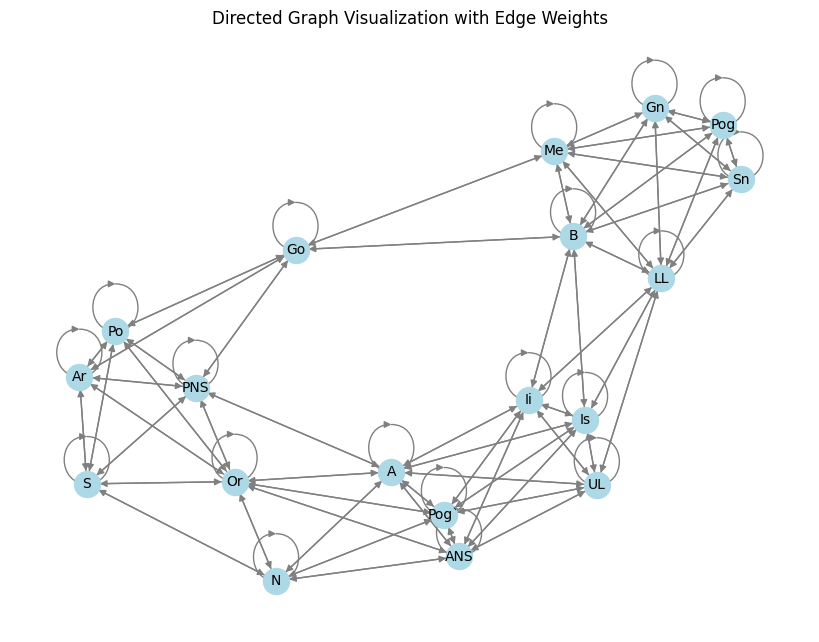

In [36]:
import networkx as nx
import matplotlib.pyplot as plt

# Convert to NetworkX directed graph (DiGraph)
G = nx.DiGraph()
edges = graph.edge_index.t().tolist()  # Convert edge_index to a list of edge tuples
G.add_edges_from(edges)

# Add edge weights if available (assuming graph.edge_attr holds the edge weights)
edge_weights = {}
if graph.edge_attr is not None:
    for i, (start, end) in enumerate(edges):
        edge_weights[(start, end)] = graph.edge_attr[i].item()  # Assuming graph.edge_attr is a tensor

# Add node positions if available
if graph.pos is not None:
    pos = {i: graph.pos[i].tolist() for i in range(graph.num_nodes)}
else:
    pos = nx.spring_layout(G)  # Generate positions automatically

# Create labels for nodes based on the mapper (optional)
labels_attr = {i: categories_names[i] for i in range(graph.num_nodes)}  # Use default if not in mapper

# Plot the graph
plt.figure(figsize=(8, 6))

# Draw the directed graph with node labels
nx.draw(G, pos, with_labels=True, labels=labels_attr, node_size=350, node_color="lightblue", font_size=10, edge_color="gray", arrows=True)

# Draw edge labels (weights) for directed edges
# nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_weights)

plt.title("Directed Graph Visualization with Edge Weights")
plt.show()

## Graphs Creating Function

In [29]:
def create_graphs_for_dataset(folder, resultss, labelss, img_width, img_height, k=4, data = None):
    """
    Create graph data for a dataset of images.

    Args:
        dataset (list): A list of tuples, where each tuple contains:
            - predicted_coords (numpy.ndarray): Predicted coordinates from YOLO (num_nodes, 2).
            - roi_features (numpy.ndarray): ROI features from Inception (num_nodes, feature_dim).
            - ground_truth_coords (numpy.ndarray): Ground truth coordinates (num_nodes, 2).
        img_width (int): Image width.
        img_height (int): Image height.
        k (int): Number of nearest neighbors.

    Returns:
        list: List of `torch_geometric.data.Data` graphs.
    """
    graphs = []
    # os.listdir(train_folder)
    for image_name in os.listdir(folder):
        # print(image_name)
        graph = construct_graph(resultss['predictions'], resultss['feature_dict'], labelss, image_name, k_neighbors=k, data = data)
        graphs.append(graph)
    return graphs

## Train Graphs Constructions

In [30]:
train_graphs = create_graphs_for_dataset(train_folder, train_results, train_labels, img_width = 1935, img_height = 2400, k=4,data='test')

In [39]:
print(len(train_graphs))
print(train_graphs[0])

280
Data(x=[19, 2050], edge_index=[2, 190], edge_attr=[190], y=[19, 2], num_nodes=19)


## Valid Graphs Constructions

In [31]:
valid_graphs = create_graphs_for_dataset(valid_folder, valid_results, valid_labels, img_width = 1935, img_height = 2400, k=4,data='test')

In [41]:
print(len(valid_graphs))
print(valid_graphs[0])

80
Data(x=[19, 2050], edge_index=[2, 190], edge_attr=[190], y=[19, 2], num_nodes=19)


## Test Graphs Constructions

In [32]:
test_graphs = create_graphs_for_dataset(test_folder, test_results, test_labels, img_width = 1935, img_height = 2400, k=4, data = 'test')

In [43]:
print(len(test_graphs))
print(test_graphs[0])

40
Data(x=[19, 2050], edge_index=[2, 190], edge_attr=[190], y=[19, 2], num_nodes=19)


## Building GNNs 

# Static Edge Convolution Layers Network

In [44]:
# # EDGE CONV IMPLEMENTATION
# import torch
# import torch_geometric
# import torch
# from torch.nn import Linear, ReLU
# from torch_geometric.nn import EdgeConv
# import torch
# from torch.nn import Linear, Sequential, ReLU, BatchNorm1d, Dropout
# from torch_geometric.nn import DynamicEdgeConv
# from tqdm import tqdm
# import torch_cluster
# from torch_geometric.nn import DynamicEdgeConv, global_max_pool

# # Define the EdgeConv block
# class EdgeConvBlock(torch.nn.Module):
#     def __init__(self, input_dim, output_dim):
#         super(EdgeConvBlock, self).__init__()
#         self.edge_conv = EdgeConv(
#              nn=Sequential(
#                 Linear(input_dim * 2, output_dim),
#                 ReLU(),
#                 Linear(output_dim, output_dim),
#             )
#         )
#         self.activation = ReLU()

#     def forward(self, x, edge_index):
#         x = self.edge_conv(x, edge_index)
#         return self.activation(x)

In [45]:
# class DGCNN(torch.nn.Module):
#     def __init__(self, input_dim, hidden_dim, output_dim, num_layers=4):
#         super(DGCNN, self).__init__()

#         # Define EdgeConv layers
#         self.edge_convs = torch.nn.ModuleList([
#             EdgeConvBlock(input_dim if i == 0 else hidden_dim, hidden_dim)
#             for i in range(num_layers)
#         ])

#         # Final MLP for regression
#         self.mlp = Sequential(
#             Linear(hidden_dim, hidden_dim // 2),
#             BatchNorm1d(hidden_dim // 2), # additional batch norm
#             ReLU(),
#             Dropout(0.3), # additional dropout
#             Linear(hidden_dim // 2, output_dim)
#         )

#     def forward(self, x, edge_index):
#         for edge_conv in self.edge_convs:
#             x = edge_conv(x, edge_index)
#         return self.mlp(x)


## Training Setup

In [46]:
# import torch
# import torch.optim as optim
# from torch.nn import MSELoss
# from torch_geometric.loader import DataLoader

# # Ensure GPU is available
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# # Move model to GPU
# static_model= DGCNN(input_dim=2050, hidden_dim=256, output_dim=2).to(device)

# # Initialize optimizer and loss function
# optimizer = optim.Adam(MODEL_01.parameters(), lr=1e-3, weight_decay=1e-4)
# criterion = MSELoss()

# # Track losses
# train_losses = []
# val_losses = []

# # Training loop
# for epoch in range(500):  # Set epochs
#     MODEL_01.train()
#     train_loss = 0
#     for batch in train_loader:
#         # Move batch data to GPU
#         batch = batch.to(device)

#         optimizer.zero_grad()

#         # Forward pass
#         out = MODEL_01(batch.x, batch.edge_index)

#         # Compute loss
#         loss = criterion(out, batch.y)

#         # Backward pass and optimization
#         loss.backward()
#         optimizer.step()
#         train_loss += loss.item()

#     train_losses.append(train_loss)

#     MODEL_01.eval()  # Set model to evaluation mode
#     val_loss = 0
#     with torch.no_grad():  # Disable gradient calculation during validation
#         for batch in val_loader:
#             # Move batch data to GPU
#             batch = batch.to(device)

#             # Forward pass
#             out = MODEL_01(batch.x, batch.edge_index)

#             # Compute validation loss
#             loss = criterion(out, batch.y)
#             val_loss += loss.item()

#     # Compute validation loss for the epoch
#     val_losses.append(val_loss / len(val_loader))

#     # Print training and validation loss
#     print(f"Epoch {epoch+1}, Train Loss: {train_loss / len(train_loader):.4f}, Val Loss: {val_loss / len(val_loader):.4f}")


# Dynamic Edge Convolution Layers Network

In [44]:
import torch
from torch.nn import Linear, Sequential, ReLU, BatchNorm1d, Dropout,LayerNorm
from torch_geometric.nn import DynamicEdgeConv, GATConv
from tqdm import tqdm
import torch_cluster
from torch_geometric.nn import DynamicEdgeConv, global_max_pool
from torch_geometric.nn import GINConv
# Define DynamicEdgeConv block
class DynamicEdgeConvBlock(torch.nn.Module):
    def __init__(self, input_dim, output_dim, k=4):
        super(DynamicEdgeConvBlock, self).__init__()
        self.edge_conv = DynamicEdgeConv(
            nn=Sequential(
                Linear(input_dim * 2, output_dim),
                ReLU(),
                Linear(output_dim, output_dim),
            ),
            k=k,  # k-Nearest Neighbors
        )



    def forward(self, x, batch):
        return self.edge_conv(x, batch)

from torch_geometric.nn import knn_graph
class DGCNN(torch.nn.Module):
    
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers=4, k=4):
        super(DGCNN, self).__init__()
    
        self.dynamic_edge_convs_1 = torch.nn.ModuleList([
            DynamicEdgeConvBlock(input_dim if i == 0 else hidden_dim, hidden_dim, 4)
            for i in range(2)
        ])

        # Graph Attention Layers

        self.gin = GINConv(
            Sequential(
                Linear(hidden_dim, hidden_dim),
                ReLU(),
                Linear(hidden_dim, hidden_dim),
                BatchNorm1d(hidden_dim)
            ))
        
        self.gat = GATConv(hidden_dim, hidden_dim  , heads=1, concat=True)
        self.gat_2 = GATConv(hidden_dim, hidden_dim //4 , heads=4, concat=True)
        self.dynamic_edge_convs_2 = torch.nn.ModuleList([
            DynamicEdgeConvBlock(hidden_dim, hidden_dim, 3)
            for i in range(2)
        ])



        self.mlp = Sequential(
            Linear(hidden_dim, hidden_dim * 2),
            BatchNorm1d(hidden_dim * 2),
            ReLU(),
            Dropout(0.3),
            Linear(hidden_dim * 2, hidden_dim),
            BatchNorm1d(hidden_dim),
            ReLU(),
            Dropout(0.2),
            Linear(hidden_dim, hidden_dim // 2),
            BatchNorm1d(hidden_dim // 2),
            ReLU(),
            Linear(hidden_dim // 2, output_dim)
        )

    def forward(self, x, batch,edge_index):
        # Apply multiple Dynamic Edge Convolution layers
        for edge_conv in self.dynamic_edge_convs_1:
            x = edge_conv(x, batch)
          # Compute k-NN-based edges for GAT
        edge_index = knn_graph(x, k=4, batch=batch)

        # x = self.gat_2(x, edge_index)
            x = self.gin(x, edge_index)

        for edge_conv in self.dynamic_edge_convs_2:
            x = edge_conv(x, batch)

        return self.mlp(x)
    



In [347]:
def distance_loss(pred_coords, true_coords):
    pred_distances = torch.cdist(pred_coords, pred_coords)
    true_distances = torch.cdist(true_coords, true_coords)
    return torch.mean((pred_distances - true_distances) ** 2)

In [240]:
import torch
from tqdm import tqdm
import numpy as np
from torch_geometric.loader import DataLoader
from torchinfo import summary

# Create DataLoaders
train_loader = DataLoader(train_graphs, batch_size=32, shuffle=True)
val_loader = DataLoader(valid_graphs, batch_size=32, shuffle=False)
class EarlyStopping:
    def __init__(self, patience=7, min_delta=0, verbose=True):
        """
        Initialize early stopping.
        
        Args:
            patience (int): Number of epochs to wait before stopping after loss plateaus
            min_delta (float): Minimum change in loss to qualify as an improvement
            verbose (bool): If True, prints improvement messages
        """
        self.patience = patience
        self.min_delta = min_delta
        self.verbose = verbose
        self.counter = 0
        self.best_loss = None
        self.early_stop = False
        self.min_validation_loss = float('inf')

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        elif val_loss > self.best_loss - self.min_delta:
            self.counter += 1
            if self.verbose:
                print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_loss = val_loss
            self.counter = 0

# Main training loop
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = DGCNN(input_dim=2050, hidden_dim=1024, output_dim=2).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-4)
criterion = torch.nn.MSELoss()

# Initialize trackers
train_losses = []
val_losses = []
best_val_loss = float("inf")
best_model_path = "best_model_weights.pth"

# Initialize early stopping
early_stopping = EarlyStopping(patience=150, min_delta=1e-4)

# Training loop
for epoch in tqdm(range(1000), desc="Epochs"):
    # Training phase
    model.train()
    train_loss = 0
    for batch in train_loader:
        batch = batch.to(device)
        optimizer.zero_grad()
        out = model(batch.x, batch.batch,batch.edge_index)
        loss = criterion(out, batch.y)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()
    
    avg_train_loss = train_loss / len(train_loader)
    train_losses.append(avg_train_loss)
    
    # Validation phase
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for batch in tqdm(val_loader, desc="Validation", leave=False):
            batch = batch.to(device)
            out = model(batch.x, batch.batch,batch.edge_index)
            loss = criterion(out, batch.y)
            val_loss += loss.item()
    
    avg_val_loss = val_loss / len(val_loader)
    val_losses.append(avg_val_loss)
    
    # Print progress
    print(f"Epoch {epoch+1}, Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")
    
    # Save best model
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'train_loss': avg_train_loss,
            'val_loss': avg_val_loss,
        }, best_model_path)
        print(f"Best model weights saved at epoch {epoch+1} with Val Loss: {best_val_loss:.4f}")
    
    # Early stopping check
    early_stopping(avg_val_loss)
    if early_stopping.early_stop:
        print(f"Early stopping triggered at epoch {epoch+1}")
        break

Validation: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s]
                                                         

Epoch 1, Train Loss: 2127774.9861, Val Loss: 2140361.3333


Epochs:   0%|          | 1/1000 [00:01<25:30,  1.53s/it]

Best model weights saved at epoch 1 with Val Loss: 2140361.3333



Validation: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s]
                                                         

Epoch 2, Train Loss: 2119375.1250, Val Loss: 2026715.4583


Epochs:   0%|          | 2/1000 [00:02<24:20,  1.46s/it]

Best model weights saved at epoch 2 with Val Loss: 2026715.4583



Epochs:   0%|          | 3/1000 [00:03<19:49,  1.19s/it] 

Epoch 3, Train Loss: 2112452.8056, Val Loss: 2107464.1667
EarlyStopping counter: 1 out of 150


Epochs:   0%|          | 3/1000 [00:04<22:35,  1.36s/it]


KeyboardInterrupt: 

# Another Architecture

In [45]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import GINConv, DynamicEdgeConv
from torch_geometric.utils import scatter
from torch.utils.data import random_split
from torch_geometric.loader import DataLoader
from torch_geometric.nn import knn_graph
from torch.optim.lr_scheduler import ReduceLROnPlateau

class LandmarkRefiner(nn.Module):
    def __init__(self, 
                 feat_dim=2048, 
                 coord_dim=2,
                 hidden_dim=256,
                 num_refinement_steps=3,
                 k_neighbors=4):
        super().__init__()
        
        self.coord_dim = coord_dim
        self.hidden_dim = hidden_dim
        self.num_steps = num_refinement_steps
        
        # Coordinate processing
        self.coord_encoder = nn.Sequential(
            nn.Linear(coord_dim, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Dropout(0.3)
            # nn.Linear(64, 256)

        )
        
        # Feature processing
        self.feat_encoder = nn.Sequential(
            nn.Linear(feat_dim, 512),
            nn.LayerNorm(512),
            nn.ReLU(),
            nn.Dropout(0.4),
            nn.Linear(512, 128) #ghyart 128 l 256
        )
        
        # Fusion layer
        self.fusion = nn.Linear(256 + 128, hidden_dim)
        
        # Graph processors
        self.gin_convs = nn.ModuleList([(
            GINConv(nn.Sequential(
                nn.Linear(hidden_dim, hidden_dim),
                nn.ReLU(),
                nn.LayerNorm(hidden_dim)
            ))) for _ in range(2) # ghyrty mn 2 le 4
        ])
        
        self.edge_conv = DynamicEdgeConv(
            nn=nn.Linear(2*hidden_dim, hidden_dim),
            k=4
        )
        
        # Refinement heads
        self.refiners = nn.ModuleList([
            nn.Sequential(
                nn.Linear(hidden_dim + coord_dim, 256),
                nn.ReLU(),
                nn.Linear(256, coord_dim)
            ) for _ in range(num_refinement_steps)
        ])


    def forward(self, x, batch):
        # Split into coordinates and features
        coords = x[:, :self.coord_dim]
        features = x[:, self.coord_dim:]
        
        # Encode components
        h_coord = self.coord_encoder(coords) # encoding coords
        h_feat = self.feat_encoder(features) # encoding roi features ( for dimensionality reduction )
        
        # Fuse representations 
        h = F.relu(self.fusion(torch.cat([h_coord, h_feat], dim=1)))


        
        # Multi-step refinement
        refined_coords = coords.clone()
        for refine_step in range(self.num_steps): # 3 refinement iterations
            # Update graph connectivity
            edge_index = knn_graph(refined_coords, k=4, batch=batch)
            
            # Graph processing
            for gin_conv in self.gin_convs:
                h = gin_conv(h, edge_index) + h  # Residual   
            h_edge = self.edge_conv(h, batch)
            h = h + h_edge  # Combine global and local 
            # Coordinate refinement
            delta = self.refiners[refine_step](torch.cat([h, refined_coords], dim=1)) # repition of the module list 3 times
            refined_coords = refined_coords + delta
            # Update coordinate encoding
            h_coord = self.coord_encoder(refined_coords)
            h = h + h_coord  # Coordinate feedback
        return refined_coords
## EXPERIMENTS ##
# class CombinedLoss(nn.Module):
#     def __init__(self, alpha=0.4):
#         super().__init__()
#         self.alpha = alpha
        
#     def forward(self, pred, target, batch):
#         # Coordinate MSE
#         mse_loss = F.mse_loss(pred, target)
        
#         # Structure preservation loss
#         unique_batches = torch.unique(batch)
#         struct_loss = 0
        
#         for b in unique_batches:
#             mask = batch == b
#             pred_batch = pred[mask]
#             target_batch = target[mask]
            
#             pred_dists = torch.pdist(pred_batch, p=2)
#             target_dists = torch.pdist(target_batch, p=2)
            
#             struct_loss += F.smooth_l1_loss(pred_dists, target_dists)
            
#         struct_loss /= len(unique_batches)
        
#         return mse_loss + self.alpha * struct_loss


# def augment_coords(coords, batch):
#     # Add Gaussian noise
#     coords += torch.randn_like(coords) * 0.02
    
#     # Random rotation per sample
#     unique_batches = torch.unique(batch)
#     for b in unique_batches:
#         mask = batch == b
#         angle = torch.rand(1) * 30 - 15  # -15 to +15 degrees
#         theta = torch.deg2rad(angle)
#         rot_mat = torch.tensor([[torch.cos(theta), -torch.sin(theta)],
#                                 [torch.sin(theta), torch.cos(theta)]])
#         coords[mask] = coords[mask] @ rot_mat.to(coords.device)
    
#     return coords



In [ ]:
def train(model, device, train_loader, val_loader, epochs=200):
    criterion = torch.nn.MSELoss()
    optimizer = torch.optim.AdamW(model.parameters(), lr=3e-4, weight_decay=0.4)
    scheduler = ReduceLROnPlateau(optimizer, 'min', patience=100, factor=0.5)
    
    best_val_loss = float('inf')
    
    for epoch in range(epochs):
        # Training
        model.train()
        train_loss = 0
        
        for batch in train_loader:
            batch = batch.to(device)
            optimizer.zero_grad()
            
            pred = model(batch.x, batch.batch)
            loss = criterion(pred, batch.y)
            # + 0.5* distance_loss(pred,batch.y)
            
            loss.backward()
            nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optimizer.step()
            
            train_loss += loss.item()
        
        # Validation
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for batch in val_loader:
                batch = batch.to(device)
                pred = model(batch.x, batch.batch)
                loss = criterion(pred, batch.y)
                + 0.5* distance_loss(pred,batch.y)
                val_loss += loss.item()
        
        # Metrics
        train_loss /= len(train_loader)
        val_loss /= len(val_loader)
        
        scheduler.step(val_loss)
        
        # Save best model
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), 'best_model.pth')
        
        print(f'Epoch {epoch+1:03d} | '
              f'Train Loss: {train_loss:.4f} | '
              f'Val Loss: {val_loss:.4f} | '
              f'LR: {optimizer.param_groups[0]["lr"]:.2e}')


In [367]:
train_loader = DataLoader(train_graphs, batch_size=16, shuffle=True)
val_loader = DataLoader(valid_graphs, batch_size=16, shuffle=False)
model = LandmarkRefiner().to(device)
train(model, device, train_loader, val_loader, epochs=250)

Epoch 001 | Train Loss: 621.9109 | Val Loss: 396.5837 | LR: 3.00e-04
Epoch 002 | Train Loss: 444.3037 | Val Loss: 373.3696 | LR: 3.00e-04
Epoch 003 | Train Loss: 438.0151 | Val Loss: 383.0698 | LR: 3.00e-04
Epoch 004 | Train Loss: 438.3381 | Val Loss: 380.6295 | LR: 3.00e-04
Epoch 005 | Train Loss: 430.3115 | Val Loss: 366.6312 | LR: 3.00e-04
Epoch 006 | Train Loss: 431.9600 | Val Loss: 414.9221 | LR: 3.00e-04
Epoch 007 | Train Loss: 430.0656 | Val Loss: 363.9270 | LR: 3.00e-04
Epoch 008 | Train Loss: 422.4893 | Val Loss: 409.0179 | LR: 3.00e-04
Epoch 009 | Train Loss: 437.2171 | Val Loss: 391.7950 | LR: 3.00e-04
Epoch 010 | Train Loss: 433.8704 | Val Loss: 411.8446 | LR: 3.00e-04
Epoch 011 | Train Loss: 439.4804 | Val Loss: 347.0740 | LR: 3.00e-04
Epoch 012 | Train Loss: 408.2815 | Val Loss: 344.6843 | LR: 3.00e-04
Epoch 013 | Train Loss: 457.3751 | Val Loss: 381.5428 | LR: 3.00e-04
Epoch 014 | Train Loss: 636.0459 | Val Loss: 360.4326 | LR: 3.00e-04
Epoch 015 | Train Loss: 382.3616 |

KeyboardInterrupt: 

In [36]:
import torch

# Step 1: Initialize the model (use the same params used during saving)
model = LandmarkRefiner(
    feat_dim=2048,         # match your saved model
    coord_dim=2,
    hidden_dim=256,
    num_refinement_steps=3,
    k_neighbors=4
)

# Step 2: Load the weights
checkpoint_path = '/kaggle/input/yrab/pytorch/default/1/best_model (1).pth'  # or the path to your weights file
model.load_state_dict(torch.load(checkpoint_path, map_location=torch.device('cpu')))  # Use 'cuda' if needed

# Step 3 (Optional): Move to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# Step 4 (Optional): Set to eval mode if you're evaluating
model.eval()


LandmarkRefiner(
  (coord_encoder): Sequential(
    (0): Linear(in_features=2, out_features=256, bias=True)
    (1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
    (2): ReLU()
    (3): Dropout(p=0.3, inplace=False)
  )
  (feat_encoder): Sequential(
    (0): Linear(in_features=2048, out_features=512, bias=True)
    (1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
    (2): ReLU()
    (3): Dropout(p=0.4, inplace=False)
    (4): Linear(in_features=512, out_features=128, bias=True)
  )
  (fusion): Linear(in_features=384, out_features=256, bias=True)
  (gin_convs): ModuleList(
    (0-1): 2 x GINConv(nn=Sequential(
      (0): Linear(in_features=256, out_features=256, bias=True)
      (1): ReLU()
      (2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
    ))
  )
  (edge_conv): DynamicEdgeConv(nn=Linear(in_features=512, out_features=256, bias=True), k=4)
  (refiners): ModuleList(
    (0-2): 3 x Sequential(
      (0): Linear(in_features=258, out_features=256, bias=T

## Model Eval

In [37]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(train_losses[100:], label='Training Loss', color='blue')
plt.plot(val_losses[100:], label='Validation Loss', color='red')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

NameError: name 'train_losses' is not defined

<Figure size 1000x600 with 0 Axes>

In [39]:
def predict(model, data):
    # Ensure the model is in evaluation mode
    model.eval()
    with torch.no_grad():
        # Move data to the same device as the model
        device = next(model.parameters()).device
        data = data.to(device)

        # Forward pass through the model
        pred = model(data.x, data.batch)  

        # Return predictions on the CPU
        return pred.cpu()


In [40]:
train_images = os.listdir(train_folder)
train_graphs_dict={}

valid_images = os.listdir(valid_folder)
valid_graphs_dict={}

test_images = os.listdir(test_folder)
test_graphs_dict={}


for i, img in enumerate(train_images):
    train_graphs_dict[img] =train_graphs[i]
    
for i, img in enumerate(valid_images):
    valid_graphs_dict[img] = valid_graphs[i]
    
for i, img in enumerate(test_images):
    test_graphs_dict[img] = test_graphs[i]

print(train_graphs_dict[train_images[0]])
print(valid_graphs_dict[valid_images[0]])
print(test_graphs_dict[test_images[0]])

print(len(train_graphs_dict.keys()))
print(len(valid_graphs_dict.keys()))
print(len(test_graphs_dict.keys()))

Data(x=[19, 2050], edge_index=[2, 190], edge_attr=[190], y=[19, 2], num_nodes=19)
Data(x=[19, 2050], edge_index=[2, 190], edge_attr=[190], y=[19, 2], num_nodes=19)
Data(x=[19, 2050], edge_index=[2, 190], edge_attr=[190], y=[19, 2], num_nodes=19)
280
80
40


In [118]:
test_images

['358.jpg',
 '288.jpg',
 '217.jpg',
 '004.jpg',
 '347.jpg',
 '280.jpg',
 '017.jpg',
 '397.jpg',
 '175.jpg',
 '360.jpg',
 '230.jpg',
 '378.jpg',
 '014.jpg',
 '112.jpg',
 '385.jpg',
 '115.jpg',
 '141.jpg',
 '082.jpg',
 '013.jpg',
 '072.jpg',
 '309.jpg',
 '302.jpg',
 '113.jpg',
 '388.jpg',
 '058.jpg',
 '045.jpg',
 '303.jpg',
 '126.jpg',
 '380.jpg',
 '102.jpg',
 '120.jpg',
 '328.jpg',
 '333.jpg',
 '143.jpg',
 '367.jpg',
 '215.jpg',
 '053.jpg',
 '048.jpg',
 '259.jpg',
 '016.jpg']

# Model Evaluation

## Calculate MRE IN PIXELS 

In [41]:
import torch
import pandas as pd
import os

w, h = 1935, 2400
def calculate_point_to_point_error(predicted_coords, ground_truth_coords):
    # Calculate Point-to-Point error (Euclidean distance between predicted and ground truth)
    point_errors = torch.sqrt(torch.sum((predicted_coords - ground_truth_coords) ** 2, dim=1))
    return point_errors


def calculate_error_between_predictions_and_labels(results, labels, folder, model, graphs_dict, error_type="point"):
    """
    Calculate the cumulative error for each landmark across all images in the dataset,
    while scaling the coordinates by the image width and height.

    Args:
        results: A dictionary containing predictions from the GNN model (results['predictions']).
        labels: A dictionary containing the ground truth labels (labels[image_name]).
        test_folder: Path to the folder containing the test images.
        model: The trained GNN model.
        error_type: Type of error to compute ('mse' or 'point').

    Returns:
        pd.DataFrame: A DataFrame containing cumulative errors for each landmark across all images.
    """
    # List all images in the test folder
    image_names = os.listdir(folder)

    # Initialize accumulators for errors for each landmark (0-18)
    cumulative_errors = {i: [] for i in range(19)}  # Assuming 19 landmarks from 0 to 18

    # Iterate over each image in the test folder
    for image_name in image_names:
        if image_name not in labels:  # If no label exists for the image, skip it
            continue

        # Get the full path of the image to open and get its dimensions
        image_path = os.path.join(folder, image_name)
        img = Image.open(image_path)
        img_width, img_height = img.size  # Get image width and height

        # Extract ground truth landmarks (assuming landmarks are already in order)
        ground_truth = labels[image_name]
        
        # Convert ground truth coordinates to tensor and scale them
        ground_truth_coords = torch.tensor([
            # [float(landmark['x']) * img_width, float(landmark['y'] * img_height)]  # Multiply by image dimensions
            [float(landmark['x']), float(landmark['y'])]  # Multiply by image dimensions
            for landmark in ground_truth.values()
        ], dtype=torch.float32)

        # Get predictions from `results['predictions']` for the image
        predicted_coords_from_results = results['predictions'][image_name]
        predicted_coords_from_results = torch.tensor([
            # [float(landmark['bbox'][0]) * img_width, float(landmark['bbox'][1]) * img_height] for landmark in predicted_coords_from_results.values()
            [float(landmark['bbox'][0]), float(landmark['bbox'][1])] for landmark in predicted_coords_from_results.values()
        ], dtype=torch.float32)

        # Get predictions from the GNN model using the `predict` function
        predicted_coords_from_model = predict(model, graphs_dict[image_name])  # This is the prediction from the GNN model
        
        # Ensure `predicted_coords_from_model` is a tensor and scale by image size
        if isinstance(predicted_coords_from_model, torch.Tensor):
            # If the model output is already a tensor, we scale it directly
            predicted_coords_from_model = predicted_coords_from_model 
        else:
            # If it's a dictionary, convert it to tensor after scaling
            predicted_coords_from_model = torch.tensor([
                [float(x) , float(y) ]  # Scale predicted coordinates
                for x,y in predicted_coords_from_model
            ], dtype=torch.float32)
        
        # Calculate error for each landmark (0-18)
        for i in range(len(ground_truth_coords)):
            # Calculate error for predictions from `results['predictions']`
            if error_type == "point":
                error_from_results = calculate_point_to_point_error(predicted_coords_from_results[i:i+1], ground_truth_coords[i:i+1])
            else:  # MSE calculation can be added here
                error_from_results = torch.mean((predicted_coords_from_results[i:i+1] - ground_truth_coords[i:i+1]) ** 2, dim=1)

            # Calculate error for predictions from the GNN model
            if error_type == "point":
                error_from_model = calculate_point_to_point_error(predicted_coords_from_model[i:i+1], ground_truth_coords[i:i+1])
            else:  # MSE calculation can be added here
                error_from_model = torch.mean((predicted_coords_from_model[i:i+1] - ground_truth_coords[i:i+1]) ** 2, dim=1)

            # Accumulate the errors for each landmark across all images
            cumulative_errors[i].append(error_from_results.item())  # For results['predictions']
            cumulative_errors[i].append(error_from_model.item())    # For GNN model predictions

    # Convert cumulative errors for each landmark into a DataFrame
    accumulated_errors = []
    for landmark, errors in cumulative_errors.items():
        accumulated_errors.append({
            'Landmark': category_names_shorted[landmark],
            'YOLO_OUTPUT': np.mean(errors[::2]),  # Every other entry is from 'results['predictions']'
            'GNNS_OUTPUT': np.mean(errors[1::2])    # Every other entry starting from index 1 is from GNN model
        })

    # Create a final DataFrame containing cumulative errors
    final_errors_df = pd.DataFrame(accumulated_errors)

    return final_errors_df

### Training MRE Errors IN PIXELS

In [42]:
category_names_shorted = categories_names

In [46]:
# Call the function to calculate errors for the entire dataset
final_errors_df = calculate_error_between_predictions_and_labels(train_results, train_labels, train_folder, model, train_graphs_dict, error_type="point")

# Show the final errors DataFrame
print("Final Errors for the Dataset:")
print()
final_errors_df

Final Errors for the Dataset:



,Landmark,YOLO_OUTPUT,GNNS_OUTPUT
0,S,4.331878,4.560143
1,N,10.457295,10.556464
2,Or,15.770944,15.771194
3,Po,12.273578,12.482408
4,A,17.434344,17.449129
5,B,22.967484,20.475943
6,Pog,6.845557,6.806531
7,Me,7.924834,7.939845
8,Gn,5.765835,7.181405
9,Go,19.163500,18.760638


### Valid MRE Error IN PIXELS

In [47]:
# Call the function to calculate errors for the entire dataset
final_errors_df = calculate_error_between_predictions_and_labels(valid_results, valid_labels, valid_folder, model, valid_graphs_dict, error_type="point")

# Show the final errors DataFrame
print("Final Errors for the Dataset:")
print()
final_errors_df

Final Errors for the Dataset:



,Landmark,YOLO_OUTPUT,GNNS_OUTPUT
0,S,7.422861,7.880511
1,N,12.772603,12.812996
2,Or,26.426876,26.477662
3,Po,27.787529,27.138447
4,A,22.495899,22.467220
5,B,29.316532,27.671371
6,Pog,8.819906,8.514270
7,Me,8.282087,8.118723
8,Gn,7.444654,8.400248
9,Go,30.553377,30.660844


### Testing Errors in PIXELS ONLY

In [48]:
# Call the function to calculate errors for the entire dataset
final_errors_df = calculate_error_between_predictions_and_labels(test_results, test_labels, test_folder, model, test_graphs_dict, error_type="point")

# Show the final errors DataFrame
print("Final Errors for the Dataset:")
print()
final_errors_df

Final Errors for the Dataset:



,Landmark,YOLO_OUTPUT,GNNS_OUTPUT
0,S,4.553624,4.762681
1,N,12.611247,13.141546
2,Or,23.304564,23.449031
3,Po,25.916420,25.592637
4,A,19.137482,18.970247
5,B,30.601124,27.322274
6,Pog,7.636420,7.631999
7,Me,7.520825,8.173874
8,Gn,5.937693,7.776994
9,Go,23.330372,23.232613


## Calculate MRE IN pixels AND mm

## Visualizing the Results

In [49]:
import matplotlib.pyplot as plt
import cv2
import torch
import pandas as pd

def plot_landmarks_with_errors(image_name, test_results, test_labels, model, category_names_shorted, plot_yolo=None, unseen = None):
    """
    Function to plot predicted landmarks (model and YOLO predictions), 
    calculate errors, and visualize ground truth landmarks.
    
    Args:
        image_name (str): The name of the image file to process.
        test_results (dict): Dictionary containing predictions for the test data.
        test_labels (dict): Dictionary containing ground truth labels for the test data.
        model (torch.nn.Module): The model used for landmark prediction.
        category_names_shorted (list): List of category names for landmarks.
        platform_root (str, optional): Path to the platform root for loading images.
    """
    # Construct the graph and predict the landmarks
    test_graph = construct_graph(test_results['predictions'], test_results['feature_dict'], test_labels, image_name, k_neighbors=4)
    p_coords = predict(model, test_graph)

    # Ground truth coordinates
    ground_truth = test_labels[image_name]
    gt_coords = torch.tensor([
        [float(landmark['x']), float(landmark['y'])]  # Multiply by image dimensions
        for landmark in ground_truth.values()
    ], dtype=torch.float32)

    # Initialize YOLO coordinates and detection status
    yolo_coords = []
    yolo_found = {str(i): None for i in range(19)}
    for i, landmark in enumerate(test_results['predictions'][image_name].values()):
        if landmark['confidence'] == 0:  # Check if 'detected' is True
            yolo_found[str(i)] = False
            yolo_coords.append([0, 0])
        else:
            yolo_coords.append([float(landmark['bbox'][0]), float(landmark['bbox'][1])])
            yolo_found[str(i)] = True

    yolo_coords = torch.tensor(yolo_coords, dtype=torch.float32)

    # Create a DataFrame for errors
    errors_df = []

    # Calculate errors and populate the DataFrame
    for i in range(19):
        absolute_errors = torch.abs(p_coords[i] - gt_coords[i])
        yolo_absolute_errors_gnn = torch.abs(p_coords[i] - yolo_coords[i]) if yolo_found[str(i)] else torch.tensor([0.0, 0.0])
        yolo_absolute_errors_gt = torch.abs(gt_coords[i] - yolo_coords[i]) if yolo_found[str(i)] else torch.tensor([0.0, 0.0])
        
        # Append the data to the errors DataFrame
        errors_df.append({
            'Category': category_names_shorted[i],
            # 'GT_x': gt_coords[i][0].item(),
            # 'GT_y': gt_coords[i][1].item(),
            # 'Pred_x': p_coords[i][0].item(),
            # 'Pred_y': p_coords[i][1].item(),
            # 'YOLO_x': yolo_coords[i][0].item(),
            # 'YOLO_y': yolo_coords[i][1].item(),
            'Error_YOLO_to_GT': yolo_absolute_errors_gt.sum().item(),
            'Error_GNN_to_GT': absolute_errors.sum().item(),
            # 'Error_GT_to_Pred': absolute_errors.sum().item(),
            'YOLO_Found': yolo_found[str(i)]
        })

    # Convert errors into a pandas DataFrame for better readability
    errors_df = pd.DataFrame(errors_df)

    if unseen:
        image_path = f'/kaggle/working/{unseen}/{image_name}'
    else:
        image_path = f'/kaggle/working/dataset/test/images/{image_name}'
    
    # Check if the image exists
    image = cv2.imread(image_path)
    if image is None:
        raise FileNotFoundError(f"Image '{image_name}' not found at the specified path: {image_path}")

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Plot the image and landmarks
    plt.figure(figsize = [20, 10])
    plt.imshow(image_rgb)
    plt.scatter(gt_coords[:, 0], gt_coords[:, 1], color='red', marker='.', s=60, label='Ground Truth Landmarks')
    plt.scatter(p_coords[:, 0], p_coords[:, 1], color='blue', marker='x', s=30, label='GNNs Predicted Landmarks')

    # Plot YOLO coordinates, skipping those with 'detected' = False
    if len(yolo_coords) > 0 and plot_yolo == True:
        plt.scatter(yolo_coords[:, 0], yolo_coords[:, 1], color='yellow', marker='x', s=30, label='YOLO Predicted Landmarks')

    plt.title('Predicted Landmarks')
    plt.legend(fontsize = 15)
    plt.axis('off')
    plt.show()
    # Print the DataFrame for errors
    print(errors_df)
# Example usage:
# plot_landmarks_with_errors(image_name='image_name.bmp', test_results=test_results, test_labels=test_labels, model=model, category_names_shorted=category_names_shorted)


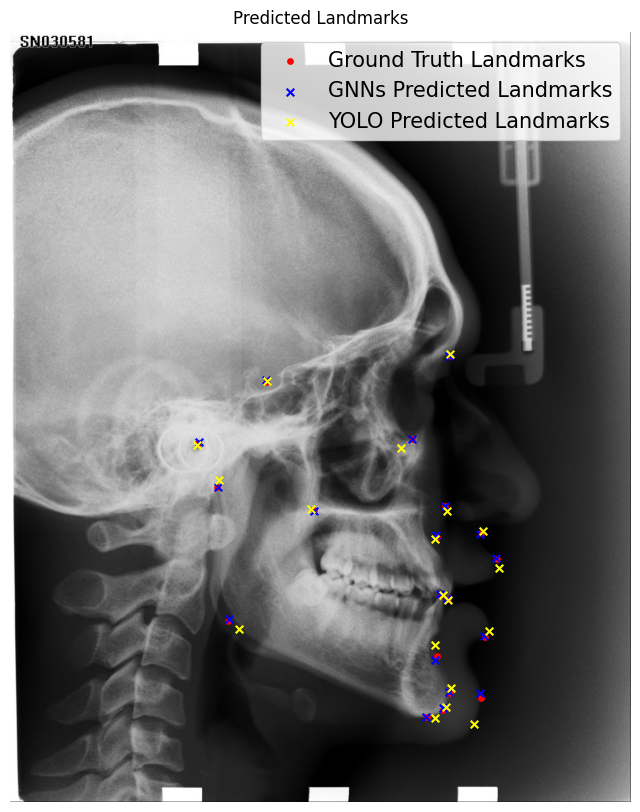

   Category  Error_YOLO_to_GT  Error_GNN_to_GT  YOLO_Found
0         S          5.674194         5.666870        True
1         N          4.588013         3.566040        True
2        Or         60.299805         1.413696        True
3        Po         10.145203         3.537720        True
4         A         13.705688         5.115479        True
5         B         42.872559        15.994141        True
6       Pog         18.881836         5.733398        True
7        Me         27.998779         3.451782        True
8        Gn         19.025879         7.899292        True
9        Go         57.119629         8.178101        True
10       Ii          6.034912         4.688721        True
11       Is          1.584961         4.594971        True
12       UL         36.790039         3.471802        True
13       LL         26.982422         6.025024        True
14     Pog`         15.697510         5.183960        True
15       Sn         98.823120        16.177246        Tr

In [50]:
plot_landmarks_with_errors(image_name=test_images[10], test_results=test_results, test_labels=test_labels, model=model, category_names_shorted=category_names_shorted, plot_yolo = True)

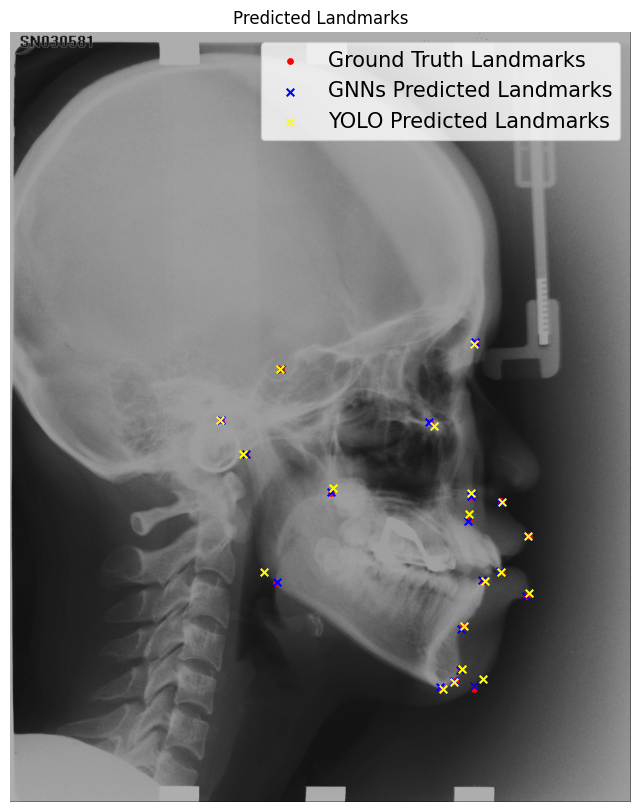

   Category  Error_YOLO_to_GT  Error_GNN_to_GT  YOLO_Found
0         S          6.836548         1.882019        True
1         N         12.832214         2.808716        True
2        Or         23.189209         2.464966        True
3        Po          3.129944         4.328491        True
4         A         17.434692         5.516113        True
5         B          5.264282        16.684326        True
6       Pog          6.064453         4.782349        True
7        Me          8.311768         6.720215        True
8        Gn          5.947754         4.726074        True
9        Go         71.762695         5.111145        True
10       Ii          6.015015         4.639526        True
11       Is          1.683594         5.576538        True
12       UL          2.593018         4.708252        True
13       LL         12.552246         3.954590        True
14     Pog`          6.203735         5.806519        True
15       Sn         58.359131        11.428833        Tr

In [52]:
plot_landmarks_with_errors(image_name=test_images[9], test_results=test_results, test_labels=test_labels, model=model, category_names_shorted=categories_names, plot_yolo = True)

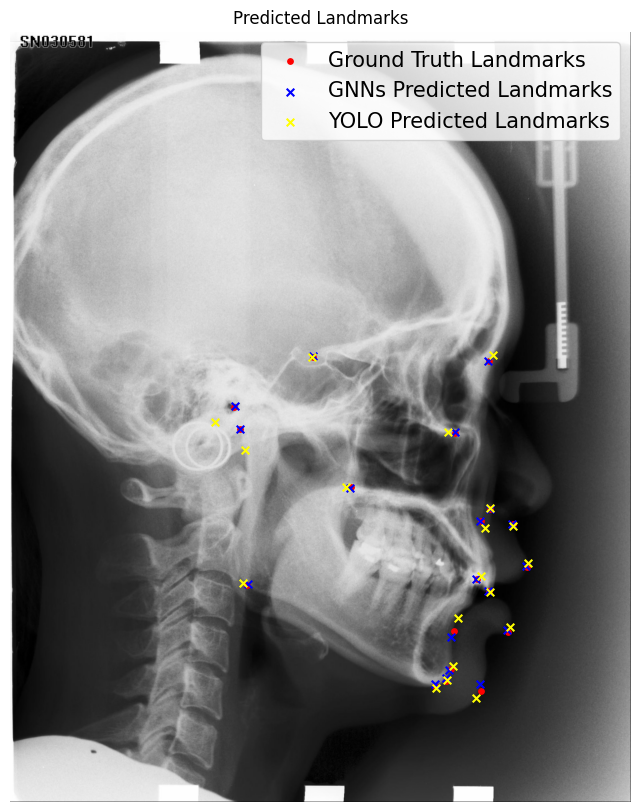

   Category  Error_YOLO_to_GT  Error_GNN_to_GT  YOLO_Found
0         S          5.493347         2.168823        True
1         N         33.337891         3.350952        True
2        Or         24.331421         4.015137        True
3        Po        108.919922         3.227539        True
4         A         35.335205         2.147705        True
5         B         57.705322        24.285767        True
6       Pog         14.865601         7.847168        True
7        Me          5.356689         7.208862        True
8        Gn          3.477295         8.363403        True
9        Go         16.460571         7.310730        True
10       Ii         21.678223         3.578003        True
11       Is          8.431152         4.261841        True
12       UL         13.331055         5.808960        True
13       LL         17.465820         8.826538        True
14     Pog`          8.229004         3.229736        True
15       Sn         37.355713        20.742554        Tr

In [53]:
plot_landmarks_with_errors(image_name=test_images[17], test_results=test_results, test_labels=test_labels, model=model, category_names_shorted=category_names_shorted, plot_yolo = True)

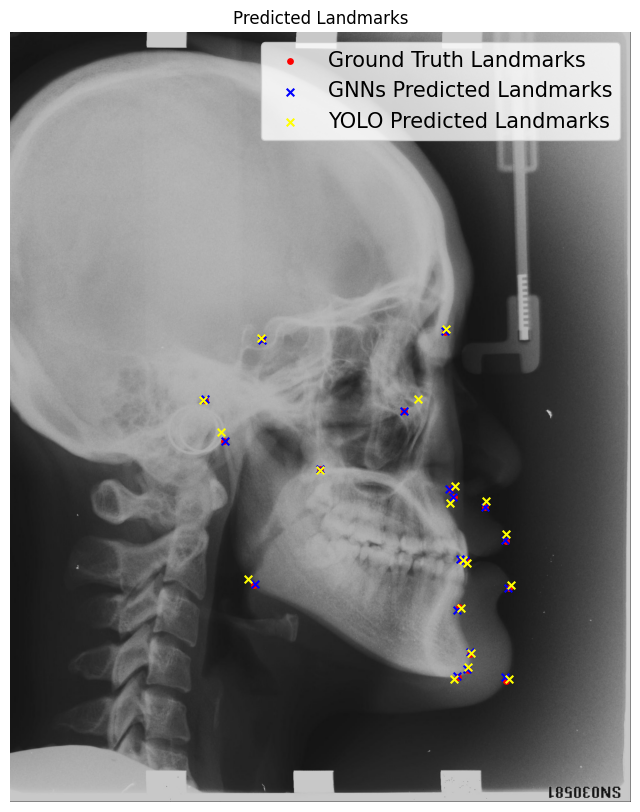

   Category  Error_YOLO_to_GT  Error_GNN_to_GT  YOLO_Found
0         S          8.282410         1.050964        True
1         N         10.235107         3.783386        True
2        Or         79.065430         2.038452        True
3        Po          5.333008         4.321838        True
4         A         30.386597         2.762939        True
5         B          6.830322        16.210571        True
6       Pog          6.318726         8.425049        True
7        Me         17.823608         4.975220        True
8        Gn         10.121094         4.665771        True
9        Go         38.665894         6.816589        True
10       Ii          8.111816         5.212524        True
11       Is          8.788574         2.895386        True
12       UL         19.428467         5.440552        True
13       LL         14.979492         3.597046        True
14     Pog`         18.686279         3.575684        True
15       Sn         14.447144        14.366455        Tr

In [54]:
plot_landmarks_with_errors(image_name=test_images[28], test_results=test_results, test_labels=test_labels, model=model, category_names_shorted=category_names_shorted, plot_yolo = True)

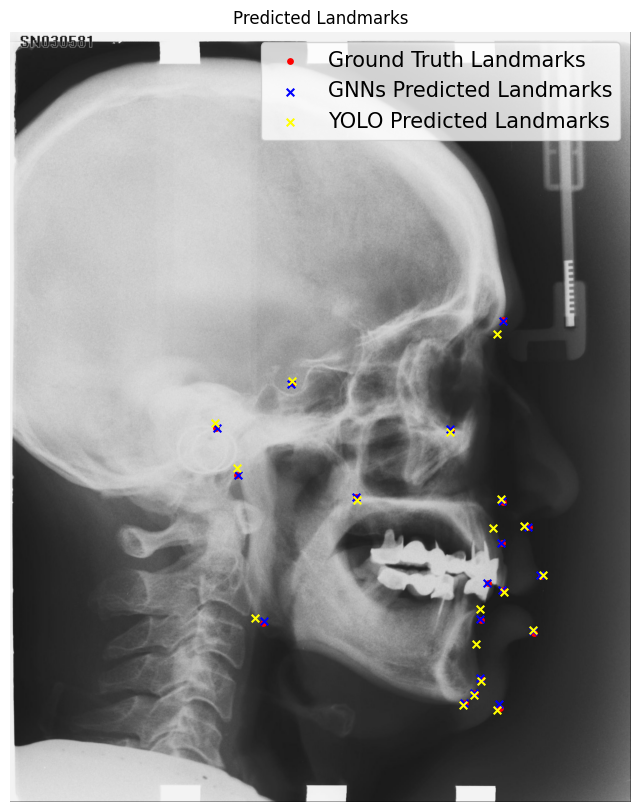

   Category  Error_YOLO_to_GT  Error_GNN_to_GT  YOLO_Found
0         S          7.801331         3.650330        True
1         N         63.040405         3.213684        True
2        Or         12.111084         3.507812        True
3        Po         21.200195         4.565002        True
4         A         74.890137         2.458862        True
5         B         89.994141         6.525146        True
6       Pog          5.943848         5.990234        True
7        Me         13.772217         3.227051        True
8        Gn          8.033203         3.085938        True
9        Go         40.846069         9.982788        True
10       Ii        107.231201         3.859131        True
11       Is          4.489746         3.115234        True
12       UL          6.296875         5.656494        True
13       LL         10.182373         8.844482        True
14     Pog`         17.090088         4.424438        True
15       Sn         14.534424        13.109985        Tr

In [55]:
# Example usage:
plot_landmarks_with_errors(image_name=test_images[24], test_results=test_results, test_labels=test_labels, model=model, category_names_shorted=category_names_shorted,plot_yolo = True)

## SDR metric

## Calculating SDR in PIXELS AND mm

In [56]:
def calculate_mean_radial_error(pred_center, gt_center, normalization_factor=None):
    """
    Calculates the Mean Radial Error (MRE) for each landmark in both pixels and mm.
    Assumes that 1 pixel corresponds to 0.1 mm.
    """
    # Calculate Euclidean distance (error) in pixels
    mre = np.sqrt((pred_center[0, 0] - gt_center[0, 0])**2 + (pred_center[0, 1] - gt_center[0, 1])**2)
    
    return mre

def calculate_error_and_sdr_with_mm(results, labels, folder, model, graphs_dict, error_type="point", penalty_value=1e6):
    """
    Calculate the cumulative error and SDR for each landmark, with errors converted to millimeters.
    All coordinates (ground truth, YOLO, and GNN) are in 640x640 space and need to be converted.
    """
    # Image dimensions and conversion factors
    original_width, original_height = 1935, 2400
    pixel_to_mm = 0.1  # 1 pixel = 0.1mm in original size
    
    thresholds_mm = [2.0, 2.5, 3.0, 4.0]
    
    cumulative_errors_mm = {i: {'yolo': [], 'gnn': [], 'best':[]} for i in range(19)}
    yolo_failures = {i: 0 for i in range(19)}

    for image_name in os.listdir(folder):
        if image_name not in labels:
            continue

        # Get ground truth coordinates (in 640x640 space)
        ground_truth = labels[image_name]
        ground_truth_coords= torch.tensor([[float(landmark['x']), float(landmark['y'])] for landmark in ground_truth.values()], dtype=torch.float32)


        if image_name not in results['predictions']:
            print(f"Warning: No predictions found for image {image_name}. Skipping.")
            continue

        # Get YOLO predictions (in 640x640 space)
        predicted_coords_from_results = results['predictions'][image_name]
        yolo_coords = torch.tensor([[float(landmark['bbox'][0]), float(landmark['bbox'][1]), float(landmark['confidence'])]
            for landmark in predicted_coords_from_results.values()], dtype=torch.float32)

        # Get GNN predictions (in 640x640 space) and convert to original scale
        gnn_coords = predict(model, graphs_dict[image_name])
        if not isinstance(gnn_coords, torch.Tensor):
            gnn_coords = torch.tensor(gnn_coords, dtype=torch.float32)

        # Calculate errors for each landmark
        # print(yolo_coords[0:0+1, :2])
        # print(ground_truth_coords[0:0+1])
        for i in range(len(ground_truth_coords)):
            # Check YOLO confidence
            confidence = yolo_coords[i, 2]
            if confidence == 0:
                yolo_failures[i] += 1
                yolo_coords = torch.tensor([[0, 0, float(landmark['confidence'])] for landmark in predicted_coords_from_results.values()], dtype=torch.float32)
                error_from_results = calculate_mean_radial_error(yolo_coords[i:i+1, :2], ground_truth_coords[i:i+1])
            
            else:
                error_from_results = calculate_mean_radial_error(yolo_coords[i:i+1, :2], ground_truth_coords[i:i+1])
                
            error_from_model = calculate_mean_radial_error(
                gnn_coords[i:i+1], 
                ground_truth_coords[i:i+1]
            )
            # Convert errors to mm (errors are in original pixel space)
            error_yolo_mm = error_from_results.item() * pixel_to_mm
            error_gnn_mm = error_from_model.item() * pixel_to_mm

            if categories_names[i] in ['B', 'ANS', 'li', 'UL']:
                error_best_mm = error_gnn_mm
            else:
                error_best_mm = error_yolo_mm
            # error_best_mm = min(error_gnn_mm, error_yolo_mm)
            # print(error_yolo_mm, error_gnn_mm, error_best_mm)


            # Store errors in mm
            cumulative_errors_mm[i]['yolo'].append(error_yolo_mm)
            cumulative_errors_mm[i]['gnn'].append(error_gnn_mm)
            cumulative_errors_mm[i]['best'].append(error_best_mm)

    # [Rest of the function remains the same...]
    # Calculate statistics and create final DataFrame
    accumulated_errors = []
    for landmark, errors in cumulative_errors_mm.items():
        yolo_errors_mm = errors['yolo']
        gnn_errors_mm = errors['gnn']
        best_errors_mm = errors['best']
        
        # Calculate MRE and SD
        yolo_mre = np.mean(yolo_errors_mm)
        yolo_sd = np.std(yolo_errors_mm)
        
        gnn_mre = np.mean(gnn_errors_mm)
        gnn_sd = np.std(gnn_errors_mm)
        
        best_mre = np.mean(best_errors_mm)
        best_sd = np.std(best_errors_mm)
        
        # Create error strings with ± std
        yolo_error = f"{yolo_mre:.2f} ± {yolo_sd:.2f}"
        gnn_error = f"{gnn_mre:.2f} ± {gnn_sd:.2f}"
        best_error = f"{best_mre:.2f} ± {best_sd:.2f}"
        
        # Calculate SDR for each threshold
        sdr_yolo = {f'SDR_YOLO_{threshold}mm': 
                   (sum(e <= threshold for e in yolo_errors_mm) / len(yolo_errors_mm) * 100)
                   for threshold in thresholds_mm}
        sdr_gnn = {f'SDR_GNN_{threshold}mm': 
                  (sum(e <= threshold for e in gnn_errors_mm) / len(gnn_errors_mm) * 100)
                  for threshold in thresholds_mm}
        sdr_best = {f'SDR_Best_{threshold}mm': 
                  (sum(e <= threshold for e in best_errors_mm) / len(best_errors_mm) * 100)
                  for threshold in thresholds_mm}

        accumulated_errors.append({
            'Landmark': category_names_shorted[landmark],
            'YOLO_Error': yolo_error,
            'GNN_Error': gnn_error,
            'YOLO_MRE_mm': yolo_mre,
            'YOLO_SD_mm': yolo_sd,
            'GNN_MRE_mm': gnn_mre,
            'GNN_SD_mm': gnn_sd,
            **sdr_yolo,
            **sdr_gnn,
            **sdr_best,
            'YOLO_Failures': yolo_failures[landmark]
        })

    final_errors_df = pd.DataFrame(accumulated_errors)

    # Calculate overall statistics
    overall_stats = {
        'Overall_YOLO_MRE': final_errors_df['YOLO_MRE_mm'].mean(),
        'Overall_GNN_MRE': final_errors_df['GNN_MRE_mm'].mean(),
        'Overall_YOLO_SDR_2mm': final_errors_df['SDR_YOLO_2.0mm'].mean(),
        'Overall_GNN_SDR_2mm': final_errors_df['SDR_GNN_2.0mm'].mean(),
        'Overall_YOLO_SDR_2.5mm': final_errors_df['SDR_YOLO_2.5mm'].mean(),
        'Overall_GNN_SDR_2.5mm': final_errors_df['SDR_GNN_2.5mm'].mean(),
        'Overall_YOLO_SDR_3mm': final_errors_df['SDR_YOLO_3.0mm'].mean(),
        'Overall_GNN_SDR_3mm': final_errors_df['SDR_GNN_3.0mm'].mean(),
        'Overall_YOLO_SDR_4mm': final_errors_df['SDR_YOLO_4.0mm'].mean(),
        'Overall_GNN_SDR_4mm': final_errors_df['SDR_GNN_4.0mm'].mean(),
        'Overall_Best_SDR_2mm': final_errors_df['SDR_Best_2.0mm'].mean(),
        'Overall_Best_SDR_2.5mm': final_errors_df['SDR_Best_2.5mm'].mean(),
        'Overall_Best_SDR_3mm': final_errors_df['SDR_Best_3.0mm'].mean(),
        'Overall_Best_SDR_4mm': final_errors_df['SDR_Best_4.0mm'].mean(),
    }

    return final_errors_df, overall_stats

In [57]:
def calculate_mean_radial_error(pred_center, gt_center, normalization_factor=None):
    """
    Calculates the Mean Radial Error (MRE) for each landmark in both pixels and mm.
    Assumes that 1 pixel corresponds to 0.1 mm.
    """
    # Calculate Euclidean distance (error) in pixels
    mre = np.sqrt((pred_center[0, 0] - gt_center[0, 0])**2 + (pred_center[0, 1] - gt_center[0, 1])**2)
    
    return mre

def calculate_error_and_sdr_with_mm(results, labels, folder, model, graphs_dict):
    """
    Calculate the cumulative error and SDR for each landmark, with errors converted to millimeters.
    All coordinates (ground truth, YOLO, and GNN) are in 640x640 space and need to be converted.
    """
    # Image dimensions and conversion factors
    original_width, original_height = 1935, 2400
    pixel_to_mm = 0.1  # 1 pixel = 0.1mm in original size
    
    thresholds_mm = [2.0, 2.5, 3.0, 4.0]
    
    cumulative_errors_mm = {i: {'yolo': [], 'gnn': [], 'best':[]} for i in range(19)}
    yolo_failures = {i: 0 for i in range(19)}

    for image_name in os.listdir(folder):
        if image_name not in labels:
            continue

        # Get ground truth coordinates (in 640x640 space)
        ground_truth = labels[image_name]
        ground_truth_coords= torch.tensor([[float(landmark['x']), float(landmark['y'])] for landmark in ground_truth.values()], dtype=torch.float32)


        if image_name not in results['predictions']:
            print(f"Warning: No predictions found for image {image_name}. Skipping.")
            continue

        predicted_coords_from_results = results['predictions'][image_name]
        yolo_coords = torch.tensor([[float(landmark['bbox'][0]), float(landmark['bbox'][1]), float(landmark['confidence'])]
            for landmark in predicted_coords_from_results.values()], dtype=torch.float32)

        # Get GNN predictions (in 640x640 space) and convert to original scale
        gnn_coords = predict(model, graphs_dict[image_name])
       
        if not isinstance(gnn_coords, torch.Tensor):
            gnn_coords = torch.tensor(gnn_coords, dtype=torch.float32)
       
        for i in range(len(ground_truth_coords)):
            # Check YOLO confidence
            confidence = yolo_coords[i, 2]
            if confidence == 0:
                yolo_failures[i] += 1
                # yolo_coords = torch.tensor([[0, 0, float(landmark['confidence'])] for landmark in predicted_coords_from_results.values()], dtype=torch.float32)
                # error_from_results = calculate_mean_radial_error(yolo_coords[i:i+1, :2], ground_truth_coords[i:i+1])
            
            else:
                error_from_results = calculate_mean_radial_error(yolo_coords[i:i+1, :2], ground_truth_coords[i:i+1])
                
            error_from_model = calculate_mean_radial_error(gnn_coords[i:i+1], ground_truth_coords[i:i+1])
            # Convert errors to mm (errors are in original pixel space)
            error_yolo_mm = error_from_results.item() * pixel_to_mm
            error_gnn_mm = error_from_model.item() * pixel_to_mm

            if categories_names[i] in ['B', 'ANS', 'li', 'UL']:
                error_best_mm = error_gnn_mm
            else:
                error_best_mm = error_yolo_mm
            # error_best_mm = min(error_gnn_mm, error_yolo_mm)
            # print(error_yolo_mm, error_gnn_mm, error_best_mm)


            # Store errors in mm
            cumulative_errors_mm[i]['yolo'].append(error_yolo_mm)
            cumulative_errors_mm[i]['gnn'].append(error_gnn_mm)
            cumulative_errors_mm[i]['best'].append(error_best_mm)

    # [Rest of the function remains the same...]
    # Calculate statistics and create final DataFrame
    accumulated_errors = []
    for landmark, errors in cumulative_errors_mm.items():
        yolo_errors_mm = errors['yolo']
        gnn_errors_mm = errors['gnn']
        best_errors_mm = errors['best']
        
        # Calculate MRE and SD
        yolo_mre = np.mean(yolo_errors_mm)
        yolo_sd = np.std(yolo_errors_mm)
        
        gnn_mre = np.mean(gnn_errors_mm)
        gnn_sd = np.std(gnn_errors_mm)
        
        best_mre = np.mean(best_errors_mm)
        best_sd = np.std(best_errors_mm)
        
        # Create error strings with ± std
        yolo_error = f"{yolo_mre:.2f} ± {yolo_sd:.2f}"
        gnn_error = f"{gnn_mre:.2f} ± {gnn_sd:.2f}"
        best_error = f"{best_mre:.2f} ± {best_sd:.2f}"
        
        # Calculate SDR for each threshold
        sdr_yolo = {f'SDR_YOLO_{threshold}mm': 
                   (sum(e <= threshold for e in yolo_errors_mm) / len(yolo_errors_mm) * 100)
                   for threshold in thresholds_mm}
        sdr_gnn = {f'SDR_GNN_{threshold}mm': 
                  (sum(e <= threshold for e in gnn_errors_mm) / len(gnn_errors_mm) * 100)
                  for threshold in thresholds_mm}
        sdr_best = {f'SDR_Best_{threshold}mm': 
                  (sum(e <= threshold for e in best_errors_mm) / len(best_errors_mm) * 100)
                  for threshold in thresholds_mm}

        accumulated_errors.append({
            'Landmark': category_names_shorted[landmark],
            'YOLO_Error': yolo_error,
            'GNN_Error': gnn_error,
            'YOLO_MRE_mm': yolo_mre,
            'YOLO_SD_mm': yolo_sd,
            'GNN_MRE_mm': gnn_mre,
            'GNN_SD_mm': gnn_sd,
            **sdr_yolo,
            **sdr_gnn,
            **sdr_best,
            'YOLO_Failures': yolo_failures[landmark]
        })

    final_errors_df = pd.DataFrame(accumulated_errors)

    # Calculate overall statistics
    overall_stats = {
    'Overall_YOLO_MRE': f"{final_errors_df['YOLO_MRE_mm'].mean():.2f} ± {final_errors_df['YOLO_MRE_mm'].std():.2f}",
    'Overall_GNN_MRE': f"{final_errors_df['GNN_MRE_mm'].mean():.2f} ± {final_errors_df['GNN_MRE_mm'].std():.2f}",
    'Overall_YOLO_SDR_2mm': f"{final_errors_df['SDR_YOLO_2.0mm'].mean():.2f}",
    'Overall_GNN_SDR_2mm': f"{final_errors_df['SDR_GNN_2.0mm'].mean():.2f}",
    'Overall_YOLO_SDR_2.5mm': f"{final_errors_df['SDR_YOLO_2.5mm'].mean():.2f}",
    'Overall_GNN_SDR_2.5mm': f"{final_errors_df['SDR_GNN_2.5mm'].mean():.2f}",
    'Overall_YOLO_SDR_3mm': f"{final_errors_df['SDR_YOLO_3.0mm'].mean():.2f}",
    'Overall_GNN_SDR_3mm': f"{final_errors_df['SDR_GNN_3.0mm'].mean():.2f}",
    'Overall_YOLO_SDR_4mm': f"{final_errors_df['SDR_YOLO_4.0mm'].mean():.2f}",
    'Overall_GNN_SDR_4mm': f"{final_errors_df['SDR_GNN_4.0mm'].mean():.2f}",
    'Overall_Best_SDR_2mm': f"{final_errors_df['SDR_Best_2.0mm'].mean():.2f}",
    'Overall_Best_SDR_2.5mm': f"{final_errors_df['SDR_Best_2.5mm'].mean():.2f}",
    'Overall_Best_SDR_3mm': f"{final_errors_df['SDR_Best_3.0mm'].mean():.2f}",
    'Overall_Best_SDR_4mm': f"{final_errors_df['SDR_Best_4.0mm'].mean():.2f}",
    }


    return final_errors_df, overall_stats

In [58]:
# Usage:
errors_df, overall_stats = calculate_error_and_sdr_with_mm(
    train_results,
    train_labels,
    train_folder,
    model,
    train_graphs_dict
)

print("\nOverall Statistics:")
for metric, value in overall_stats.items():
    print(f"{metric}: {value}")

# Print results
print("\nResults by Landmark:")
errors_df = errors_df.drop(['YOLO_MRE_mm', 'YOLO_SD_mm', 'GNN_MRE_mm', 'GNN_SD_mm'], axis=1)
errors_df


Overall Statistics:
Overall_YOLO_MRE: 1.22 ± 0.72
Overall_GNN_MRE: 1.23 ± 0.69
Overall_YOLO_SDR_2mm: 87.46
Overall_GNN_SDR_2mm: 87.63
Overall_YOLO_SDR_2.5mm: 90.38
Overall_GNN_SDR_2.5mm: 90.39
Overall_YOLO_SDR_3mm: 92.01
Overall_GNN_SDR_3mm: 92.37
Overall_YOLO_SDR_4mm: 94.08
Overall_GNN_SDR_4mm: 94.44
Overall_Best_SDR_2mm: 87.73
Overall_Best_SDR_2.5mm: 90.51
Overall_Best_SDR_3mm: 92.22
Overall_Best_SDR_4mm: 94.40

Results by Landmark:


,Landmark,YOLO_Error,GNN_Error,SDR_YOLO_2.0mm,SDR_YOLO_2.5mm,SDR_YOLO_3.0mm,SDR_YOLO_4.0mm,SDR_GNN_2.0mm,SDR_GNN_2.5mm,SDR_GNN_3.0mm,SDR_GNN_4.0mm,SDR_Best_2.0mm,SDR_Best_2.5mm,SDR_Best_3.0mm,SDR_Best_4.0mm,YOLO_Failures
0,S,0.43 ± 0.24,0.46 ± 0.25,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,0
1,N,1.05 ± 1.58,1.06 ± 1.50,90.000000,92.500000,93.571429,95.714286,91.428571,92.500000,93.928571,95.714286,90.000000,92.500000,93.571429,95.714286,0
2,Or,1.58 ± 1.77,1.58 ± 1.70,77.857143,82.500000,83.928571,88.214286,79.285714,82.142857,84.642857,88.928571,77.857143,82.500000,83.928571,88.214286,0
3,Po,1.23 ± 1.60,1.25 ± 1.49,87.500000,89.642857,90.357143,91.428571,87.500000,89.285714,90.357143,91.785714,87.500000,89.642857,90.357143,91.428571,0
4,A,1.74 ± 1.78,1.74 ± 1.76,74.642857,81.071429,85.714286,89.642857,75.000000,80.714286,85.714286,89.642857,74.642857,81.071429,85.714286,89.642857,0
5,B,2.30 ± 2.46,2.05 ± 1.93,66.785714,72.500000,75.357143,79.642857,68.571429,74.285714,78.571429,85.357143,68.571429,74.285714,78.571429,85.357143,0
6,Pog,0.68 ± 0.45,0.68 ± 0.43,98.571429,99.285714,100.000000,100.000000,98.928571,100.000000,100.000000,100.000000,98.571429,99.285714,100.000000,100.000000,0
7,Me,0.79 ± 0.55,0.79 ± 0.52,97.142857,98.571429,99.642857,99.642857,97.500000,98.571429,99.642857,99.642857,97.142857,98.571429,99.642857,99.642857,0
8,Gn,0.58 ± 0.42,0.72 ± 0.41,98.928571,99.642857,100.000000,100.000000,98.571429,99.285714,100.000000,100.000000,98.928571,99.642857,100.000000,100.000000,0
9,Go,1.92 ± 1.98,1.88 ± 1.91,69.285714,79.285714,82.500000,90.000000,72.500000,79.642857,84.642857,90.000000,69.285714,79.285714,82.500000,90.000000,0


In [59]:
# Add debug information for the first few calculations
errors_df, overall_stats = calculate_error_and_sdr_with_mm(
    valid_results,
    valid_labels,
    valid_folder,
    model,
    valid_graphs_dict
)


print("\nOverall Statistics:")
for metric, value in overall_stats.items():
    print(f"{metric}: {value}")
    
# Display results
print()
print("\nResults by Landmark:")
errors_df = errors_df.drop(['YOLO_MRE_mm', 'YOLO_SD_mm', 'GNN_MRE_mm', 'GNN_SD_mm'], axis=1)
errors_df


Overall Statistics:
Overall_YOLO_MRE: 1.67 ± 1.00
Overall_GNN_MRE: 1.68 ± 1.00
Overall_YOLO_SDR_2mm: 77.30
Overall_GNN_SDR_2mm: 75.92
Overall_YOLO_SDR_2.5mm: 82.24
Overall_GNN_SDR_2.5mm: 81.97
Overall_YOLO_SDR_3mm: 85.13
Overall_GNN_SDR_3mm: 85.46
Overall_YOLO_SDR_4mm: 89.54
Overall_GNN_SDR_4mm: 90.00
Overall_Best_SDR_2mm: 77.11
Overall_Best_SDR_2.5mm: 82.57
Overall_Best_SDR_3mm: 85.39
Overall_Best_SDR_4mm: 89.93


Results by Landmark:


,Landmark,YOLO_Error,GNN_Error,SDR_YOLO_2.0mm,SDR_YOLO_2.5mm,SDR_YOLO_3.0mm,SDR_YOLO_4.0mm,SDR_GNN_2.0mm,SDR_GNN_2.5mm,SDR_GNN_3.0mm,SDR_GNN_4.0mm,SDR_Best_2.0mm,SDR_Best_2.5mm,SDR_Best_3.0mm,SDR_Best_4.0mm,YOLO_Failures
0,S,0.74 ± 1.93,0.79 ± 1.93,98.75,98.75,98.75,98.75,97.50,98.75,98.75,98.75,98.75,98.75,98.75,98.75,0
1,N,1.28 ± 1.59,1.28 ± 1.57,86.25,88.75,88.75,93.75,86.25,88.75,88.75,93.75,86.25,88.75,88.75,93.75,0
2,Or,2.64 ± 1.81,2.65 ± 1.75,50.00,60.00,65.00,73.75,43.75,58.75,66.25,76.25,50.00,60.00,65.00,73.75,0
3,Po,2.78 ± 2.57,2.71 ± 2.50,56.25,66.25,68.75,75.00,58.75,67.50,68.75,73.75,56.25,66.25,68.75,75.00,0
4,A,2.25 ± 2.02,2.25 ± 2.04,53.75,63.75,73.75,86.25,55.00,62.50,73.75,86.25,53.75,63.75,73.75,86.25,0
5,B,2.93 ± 3.02,2.77 ± 2.68,57.50,61.25,65.00,71.25,57.50,65.00,67.50,77.50,57.50,65.00,67.50,77.50,0
6,Pog,0.88 ± 0.89,0.85 ± 0.85,92.50,93.75,95.00,97.50,91.25,95.00,96.25,97.50,92.50,93.75,95.00,97.50,0
7,Me,0.83 ± 0.66,0.81 ± 0.64,93.75,98.75,98.75,98.75,93.75,98.75,98.75,98.75,93.75,98.75,98.75,98.75,0
8,Gn,0.74 ± 0.56,0.84 ± 0.55,96.25,97.50,97.50,100.00,96.25,97.50,98.75,100.00,96.25,97.50,97.50,100.00,0
9,Go,3.06 ± 2.25,3.07 ± 2.16,41.25,50.00,56.25,68.75,38.75,48.75,57.50,70.00,41.25,50.00,56.25,68.75,0


In [60]:
# Usage:
errors_df, overall_stats = calculate_error_and_sdr_with_mm(
    test_results,
    test_labels,
    test_folder,
    model,
    test_graphs_dict
)

print("\nOverall Statistics:")
for metric, value in overall_stats.items():
    print(f"{metric}: {value}")

# Print results
print("\nResults by Landmark:")
errors_df = errors_df.drop(['YOLO_MRE_mm', 'YOLO_SD_mm', 'GNN_MRE_mm', 'GNN_SD_mm'], axis=1)
errors_df.at[15, 'Landmark'] = 'Pog`'
errors_df.at[14, 'Landmark'] = 'Sn'
errors_df


Overall Statistics:
Overall_YOLO_MRE: 1.65 ± 1.13
Overall_GNN_MRE: 1.64 ± 1.05
Overall_YOLO_SDR_2mm: 76.18
Overall_GNN_SDR_2mm: 76.58
Overall_YOLO_SDR_2.5mm: 81.97
Overall_GNN_SDR_2.5mm: 81.45
Overall_YOLO_SDR_3mm: 85.66
Overall_GNN_SDR_3mm: 86.32
Overall_YOLO_SDR_4mm: 90.79
Overall_GNN_SDR_4mm: 91.45
Overall_Best_SDR_2mm: 76.84
Overall_Best_SDR_2.5mm: 82.37
Overall_Best_SDR_3mm: 86.32
Overall_Best_SDR_4mm: 91.45

Results by Landmark:


,Landmark,YOLO_Error,GNN_Error,SDR_YOLO_2.0mm,SDR_YOLO_2.5mm,SDR_YOLO_3.0mm,SDR_YOLO_4.0mm,SDR_GNN_2.0mm,SDR_GNN_2.5mm,SDR_GNN_3.0mm,SDR_GNN_4.0mm,SDR_Best_2.0mm,SDR_Best_2.5mm,SDR_Best_3.0mm,SDR_Best_4.0mm,YOLO_Failures
0,S,0.46 ± 0.28,0.48 ± 0.28,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0
1,N,1.26 ± 1.48,1.31 ± 1.51,77.5,90.0,90.0,92.5,80.0,85.0,92.5,92.5,77.5,90.0,90.0,92.5,0
2,Or,2.33 ± 1.46,2.34 ± 1.44,47.5,57.5,62.5,85.0,50.0,52.5,65.0,85.0,47.5,57.5,62.5,85.0,0
3,Po,2.59 ± 2.76,2.56 ± 2.71,67.5,72.5,72.5,77.5,62.5,72.5,75.0,77.5,67.5,72.5,72.5,77.5,0
4,A,1.91 ± 1.22,1.90 ± 1.23,57.5,75.0,80.0,92.5,55.0,75.0,80.0,92.5,57.5,75.0,80.0,92.5,0
5,B,3.06 ± 2.75,2.73 ± 2.29,50.0,60.0,60.0,67.5,55.0,62.5,67.5,80.0,55.0,62.5,67.5,80.0,0
6,Pog,0.76 ± 0.45,0.76 ± 0.49,100.0,100.0,100.0,100.0,97.5,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0
7,Me,0.75 ± 0.51,0.82 ± 0.45,97.5,97.5,100.0,100.0,97.5,100.0,100.0,100.0,97.5,97.5,100.0,100.0,0
8,Gn,0.59 ± 0.41,0.78 ± 0.48,100.0,100.0,100.0,100.0,97.5,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0
9,Go,2.33 ± 1.52,2.32 ± 1.45,45.0,55.0,80.0,87.5,45.0,52.5,72.5,87.5,45.0,55.0,80.0,87.5,0


In [63]:
def calculate_mean_radial_error(pred_center, gt_center, normalization_factor=None):
    """
    Calculates the Mean Radial Error (MRE) for each landmark in both pixels and mm.
    Assumes that 1 pixel corresponds to 0.1 mm.
    """
    # Calculate Euclidean distance (error) in pixels
    mre = np.sqrt((pred_center[0, 0] - gt_center[0, 0])**2 + (pred_center[0, 1] - gt_center[0, 1])**2)
    
    return mre

def calculate_error_and_sdr_with_mm(results, labels, folder, model, graphs_dict):
    """
    Calculate the cumulative error and SDR for each landmark, with errors converted to millimeters.
    All coordinates (ground truth, YOLO, and GNN) are in 640x640 space and need to be converted.
    """
    # Image dimensions and conversion factors
    original_width, original_height = 1935, 2400
    pixel_to_mm = 0.1  # 1 pixel = 0.1mm in original size
    
    thresholds_mm = [2.0, 2.5, 3.0, 4.0]
    
    cumulative_errors_mm = {i: {'yolo': [], 'gnn': [], 'best':[]} for i in range(19)}
    yolo_failures = {i: 0 for i in range(19)}

    for image_name in os.listdir(folder):
        if image_name not in labels:
            continue

        # Get ground truth coordinates (in 640x640 space)
        ground_truth = labels[image_name]
        ground_truth_coords= torch.tensor([[float(landmark['x']), float(landmark['y'])] for landmark in ground_truth.values()], dtype=torch.float32)


        if image_name not in results['predictions']:
            print(f"Warning: No predictions found for image {image_name}. Skipping.")
            continue

        predicted_coords_from_results = results['predictions'][image_name]
        yolo_coords = torch.tensor([[float(landmark['bbox'][0]), float(landmark['bbox'][1]), float(landmark['confidence'])]
            for landmark in predicted_coords_from_results.values()], dtype=torch.float32)

        # Get GNN predictions (in 640x640 space) and convert to original scale
        gnn_coords = predict(model, graphs_dict[image_name])
        
        if not isinstance(gnn_coords, torch.Tensor):
            gnn_coords = torch.tensor(gnn_coords, dtype=torch.float32)
       
        for i in range(len(ground_truth_coords)):
            # Check YOLO confidence
            confidence = yolo_coords[i, 2]
            if confidence == 0:
                yolo_failures[i] += 1
                # yolo_coords = torch.tensor([[0, 0, float(landmark['confidence'])] for landmark in predicted_coords_from_results.values()], dtype=torch.float32)
                # error_from_results = calculate_mean_radial_error(yolo_coords[i:i+1, :2], ground_truth_coords[i:i+1])
            
            else:
                error_from_results = calculate_mean_radial_error(yolo_coords[i:i+1, :2], ground_truth_coords[i:i+1])
                
            error_from_model = calculate_mean_radial_error(gnn_coords[i:i+1], ground_truth_coords[i:i+1])
            # Convert errors to mm (errors are in original pixel space)
            error_yolo_mm = error_from_results.item() * pixel_to_mm
            error_gnn_mm = error_from_model.item() * pixel_to_mm

            if categories_names[i] in ['B', 'ANS', 'li', 'UL']:
                error_best_mm = error_gnn_mm
            else:
                error_best_mm = error_yolo_mm
            # error_best_mm = min(error_gnn_mm, error_yolo_mm)
            # print(error_yolo_mm, error_gnn_mm, error_best_mm)


            # Store errors in mm
            cumulative_errors_mm[i]['yolo'].append(error_yolo_mm)
            cumulative_errors_mm[i]['gnn'].append(error_gnn_mm)
            cumulative_errors_mm[i]['best'].append(error_best_mm)

    # [Rest of the function remains the same...]
    # Calculate statistics and create final DataFrame
    accumulated_errors = []
    for landmark, errors in cumulative_errors_mm.items():
        yolo_errors_mm = errors['yolo']
        gnn_errors_mm = errors['gnn']
        best_errors_mm = errors['best']
        
        # Calculate MRE and SD
        yolo_mre = np.mean(yolo_errors_mm)
        yolo_sd = np.std(yolo_errors_mm)
        
        gnn_mre = np.mean(gnn_errors_mm)
        gnn_sd = np.std(gnn_errors_mm)
        
        best_mre = np.mean(best_errors_mm)
        best_sd = np.std(best_errors_mm)
        
        # Create error strings with ± std
        yolo_error = f"{yolo_mre:.2f} ± {yolo_sd:.2f}"
        gnn_error = f"{gnn_mre:.2f} ± {gnn_sd:.2f}"
        best_error = f"{best_mre:.2f} ± {best_sd:.2f}"
        
        # Calculate SDR for each threshold
        sdr_yolo = {f'SDR_YOLO_{threshold}mm': 
                   (sum(e <= threshold for e in yolo_errors_mm) / len(yolo_errors_mm) * 100)
                   for threshold in thresholds_mm}
        sdr_gnn = {f'SDR_GNN_{threshold}mm': 
                  (sum(e <= threshold for e in gnn_errors_mm) / len(gnn_errors_mm) * 100)
                  for threshold in thresholds_mm}
        sdr_best = {f'SDR_Best_{threshold}mm': 
                  (sum(e <= threshold for e in best_errors_mm) / len(best_errors_mm) * 100)
                  for threshold in thresholds_mm}

        accumulated_errors.append({
            'Landmark': category_names_shorted[landmark],
            'YOLO_Error': yolo_error,
            'GNN_Error': gnn_error,
            'YOLO_MRE_mm': yolo_mre,
            'YOLO_SD_mm': yolo_sd,
            'GNN_MRE_mm': gnn_mre,
            'GNN_SD_mm': gnn_sd,
            **sdr_yolo,
            **sdr_gnn,
            **sdr_best,
            'YOLO_Failures': yolo_failures[landmark]
        })

    final_errors_df = pd.DataFrame(accumulated_errors)

    # Calculate overall statistics
    overall_stats = {
    'Overall_YOLO_MRE': f"{final_errors_df['YOLO_MRE_mm'].mean():.2f} ± {final_errors_df['YOLO_MRE_mm'].std():.2f}",
    'Overall_GNN_MRE': f"{final_errors_df['GNN_MRE_mm'].mean():.2f} ± {final_errors_df['GNN_MRE_mm'].std():.2f}",
    'Overall_YOLO_SDR_2mm': f"{final_errors_df['SDR_YOLO_2.0mm'].mean():.2f}",
    'Overall_GNN_SDR_2mm': f"{final_errors_df['SDR_GNN_2.0mm'].mean():.2f}",
    'Overall_YOLO_SDR_2.5mm': f"{final_errors_df['SDR_YOLO_2.5mm'].mean():.2f}",
    'Overall_GNN_SDR_2.5mm': f"{final_errors_df['SDR_GNN_2.5mm'].mean():.2f}",
    'Overall_YOLO_SDR_3mm': f"{final_errors_df['SDR_YOLO_3.0mm'].mean():.2f}",
    'Overall_GNN_SDR_3mm': f"{final_errors_df['SDR_GNN_3.0mm'].mean():.2f}",
    'Overall_YOLO_SDR_4mm': f"{final_errors_df['SDR_YOLO_4.0mm'].mean():.2f}",
    'Overall_GNN_SDR_4mm': f"{final_errors_df['SDR_GNN_4.0mm'].mean():.2f}",
    'Overall_Best_SDR_2mm': f"{final_errors_df['SDR_Best_2.0mm'].mean():.2f}",
    'Overall_Best_SDR_2.5mm': f"{final_errors_df['SDR_Best_2.5mm'].mean():.2f}",
    'Overall_Best_SDR_3mm': f"{final_errors_df['SDR_Best_3.0mm'].mean():.2f}",
    'Overall_Best_SDR_4mm': f"{final_errors_df['SDR_Best_4.0mm'].mean():.2f}",
    }


    return final_errors_df, overall_stats, cumulative_errors_mm

In [101]:
# Usage:
errors_df, overall_stats, cumulative_errors_mm_best = calculate_error_and_sdr_with_mm(
    test_results,
    test_labels,
    test_folder,
    model,
    test_graphs_dict
)

print("\nOverall Statistics:")
for metric, value in overall_stats.items():
    print(f"{metric}: {value}")

# Print results
print("\nResults by Landmark:")
errors_df = errors_df.drop(['YOLO_MRE_mm', 'YOLO_SD_mm', 'GNN_MRE_mm', 'GNN_SD_mm'], axis=1)
errors_df.at[15, 'Landmark'] = 'Pog`'
errors_df.at[14, 'Landmark'] = 'Sn'
errors_df


Overall Statistics:
Overall_YOLO_MRE: 1.65 ± 1.13
Overall_GNN_MRE: 1.64 ± 1.05
Overall_YOLO_SDR_2mm: 76.18
Overall_GNN_SDR_2mm: 76.58
Overall_YOLO_SDR_2.5mm: 81.97
Overall_GNN_SDR_2.5mm: 81.45
Overall_YOLO_SDR_3mm: 85.66
Overall_GNN_SDR_3mm: 86.32
Overall_YOLO_SDR_4mm: 90.79
Overall_GNN_SDR_4mm: 91.45
Overall_Best_SDR_2mm: 76.84
Overall_Best_SDR_2.5mm: 82.37
Overall_Best_SDR_3mm: 86.32
Overall_Best_SDR_4mm: 91.45

Results by Landmark:


,Landmark,YOLO_Error,GNN_Error,SDR_YOLO_2.0mm,SDR_YOLO_2.5mm,SDR_YOLO_3.0mm,SDR_YOLO_4.0mm,SDR_GNN_2.0mm,SDR_GNN_2.5mm,SDR_GNN_3.0mm,SDR_GNN_4.0mm,SDR_Best_2.0mm,SDR_Best_2.5mm,SDR_Best_3.0mm,SDR_Best_4.0mm,YOLO_Failures
0,S,0.46 ± 0.28,0.48 ± 0.28,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0
1,N,1.26 ± 1.48,1.31 ± 1.51,77.5,90.0,90.0,92.5,80.0,85.0,92.5,92.5,77.5,90.0,90.0,92.5,0
2,Or,2.33 ± 1.46,2.34 ± 1.44,47.5,57.5,62.5,85.0,50.0,52.5,65.0,85.0,47.5,57.5,62.5,85.0,0
3,Po,2.59 ± 2.76,2.56 ± 2.71,67.5,72.5,72.5,77.5,62.5,72.5,75.0,77.5,67.5,72.5,72.5,77.5,0
4,A,1.91 ± 1.22,1.90 ± 1.23,57.5,75.0,80.0,92.5,55.0,75.0,80.0,92.5,57.5,75.0,80.0,92.5,0
5,B,3.06 ± 2.75,2.73 ± 2.29,50.0,60.0,60.0,67.5,55.0,62.5,67.5,80.0,55.0,62.5,67.5,80.0,0
6,Pog,0.76 ± 0.45,0.76 ± 0.49,100.0,100.0,100.0,100.0,97.5,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0
7,Me,0.75 ± 0.51,0.82 ± 0.45,97.5,97.5,100.0,100.0,97.5,100.0,100.0,100.0,97.5,97.5,100.0,100.0,0
8,Gn,0.59 ± 0.41,0.78 ± 0.48,100.0,100.0,100.0,100.0,97.5,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0
9,Go,2.33 ± 1.52,2.32 ± 1.45,45.0,55.0,80.0,87.5,45.0,52.5,72.5,87.5,45.0,55.0,80.0,87.5,0


In [71]:
from scipy.stats import ttest_rel
import numpy as np
import pandas as pd

def calculate_t_tests(cumulative_errors_mm):
    """
    Performs paired t-tests on error distributions:
    1. YOLO vs Ground Truth
    2. GNN vs Ground Truth
    3. YOLO vs GNN
    Determines which model is better based on error means and T-statistic.
    """
    t_test_results = []
    
    for landmark, errors in cumulative_errors_mm.items():
        yolo_errors = np.array(errors['yolo'])
        gnn_errors = np.array(errors['gnn'])


        if len(yolo_errors) != len(gnn_errors):
            print(f"Skipping landmark {landmark} due to unequal sample sizes.")
            continue
        
        # Perform paired t-tests
        t_yolo_vs_gnn, p_yolo_vs_gnn = ttest_rel(yolo_errors, gnn_errors)
        # t_yolo_vs_gt, p_yolo_vs_gt = ttest_rel(yolo_errors, np.zeros_like(yolo_errors))
        # t_gnn_vs_gt, p_gnn_vs_gt = ttest_rel(gnn_errors, np.zeros_like(gnn_errors))
        # t_best_vs_gt, p_best_vs_gt = ttest_rel(best_errors, np.zeros_like(best_errors))

        # Determine which model performs better
        mean_yolo = np.mean(yolo_errors)
        mean_gnn = np.mean(gnn_errors)

        if t_yolo_vs_gnn < 0:  
            better_model = "YOLO"
        else:
            better_model = "GNN"

        t_test_results.append({
            'Landmark': categories_names[landmark],
            'Mean_YOLO': mean_yolo,
            'Mean_GNN': mean_gnn,
            'T_YOLO_vs_GNN': t_yolo_vs_gnn,
            'P_YOLO_vs_GNN': p_yolo_vs_gnn,
            'Better_Model': better_model if p_yolo_vs_gnn < 0.05 else "No Significant Difference",
        })
    
    return pd.DataFrame(t_test_results)

# Example usage:
t_test_df = calculate_t_tests(cumulative_errors_mm_best)

# Display results
t_test_df


,Landmark,Mean_YOLO,Mean_GNN,T_YOLO_vs_GNN,P_YOLO_vs_GNN,Better_Model
0,S,0.455362,0.476268,-0.620243,0.538706,No Significant Difference
1,N,1.261125,1.314154,-1.518762,0.136888,No Significant Difference
2,Or,2.330456,2.344903,-0.484146,0.630990,No Significant Difference
3,Po,2.591642,2.559264,0.945537,0.350206,No Significant Difference
4,A,1.913748,1.897024,0.601851,0.550757,No Significant Difference
5,B,3.060112,2.732228,2.133998,0.039187,GNN
6,Pog,0.763642,0.763200,0.010472,0.991698,No Significant Difference
7,Me,0.752082,0.817387,-1.650863,0.106798,No Significant Difference
8,Gn,0.593769,0.777699,-4.410674,0.000079,YOLO
9,Go,2.333037,2.323262,0.198241,0.843886,No Significant Difference


# PKU Dataset

In [91]:
PKU_MAPPER = {
    'ANS': 18, 
    'Ar': 19, 
    'Gn': 9, 
    'Go': 10, 
    'li': 11, 
    'ls': 12, 
    'LL': 14, 
    'Me': 8, 
    'N': 2, 
    'Or': 3, 
    'Pog': 7, 
    'Po': 4, 
    'PNS': 17, 
    'S': 1, 
    'Pog`': 16, 
    'Sn': 15,
    'A': 5,
    'B': 6,
    'UL': 13
}


# Testing Pipeline

In [ ]:
# import os
# import numpy as np
# import torch
# from torchvision import transforms as T
# from torchvision.models import inception_v3
# from torch_geometric.data import Data
# from torch_geometric.utils import add_self_loops
# from PIL import Image
# import matplotlib.pyplot as plt
# import cv2

# class CephalometricLandmarkPipeline:
#     def __init__(self, easy_labels_model, hard_labels_model, class_names, label_centroids, gnn_model):
#         self.easy_labels_model = easy_labels_model
#         self.hard_labels_model = hard_labels_model
#         self.class_names = class_names
#         self.label_centroids = label_centroids
#         self.gnn_model = gnn_model

#         # Transformations for images and ROIs
#         self.transform = T.Compose([
#             T.Resize((224, 224)),
#             T.ToTensor(),
#             T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
#         ])

#         # Feature extractor setup
#         self.feature_extractor = inception_v3(pretrained=True)
#         self.feature_extractor.fc = torch.nn.Identity()
#         self.feature_extractor.eval()

#     def load_and_resize_image(self, image_path):
#         """Load an image and resize it to 640x640."""
#         image = Image.open(image_path).convert("RGB")
#         image = image.resize((640, 640))
#         return image

#     def predict_yolo(self, image_path, conf=0.5, iou=0.9):
#         """Predict landmarks using YOLO models."""
#         predictions = {str(i): None for i in range(19)}

#         if self.easy_labels_model:
#             easy_results = self.easy_labels_model.predict(source=image_path, conf=conf, iou=iou)
#             for result in easy_results:
#                 for det in result.boxes:
#                     x_center, y_center, width, height = det.xywh[0].tolist()
#                     cls = det.cls.item()
#                     predictions[str(int(cls))] = {
#                         "bbox": [x_center, y_center, width, height],
#                         "confidence": det.conf.item()
#                     }

#         if self.hard_labels_model:
#             hard_results = self.hard_labels_model.predict(source=image_path, conf=conf, iou=iou)
#             for result in hard_results:
#                 for det in result.boxes:
#                     x_center, y_center, width, height = det.xywh[0].tolist()
#                     cls = det.cls.item()
#                     predictions[str(int(cls))] = {
#                         "bbox": [x_center, y_center, width, height],
#                         "confidence": det.conf.item()
#                     }
        
#         return predictions

#     def process_image(self, image, predictions, roi_width, roi_height):
#         """Crop ROIs based on predictions and centroids."""
#         rois = []
#         new_predictions = predictions.copy()
#         for class_id_str, detection in predictions.items():
#             if detection is None:
#                 print(
#                     f"landmark {self.class_names[int(class_id_str)]} detection failed"
#                 )
#                 centroid = self.label_centroids[class_id_str]
#                 xc, yc = float(centroid['x']), float(centroid['y'])
#                 new_predictions[class_id_str] = {
#                     'bbox': [xc, yc, 0.08, 0.08],
#                     'confidence': 0,
#                 }
#                 #xc = xc * 640
#                 #yc = yc * 640
#                 w, h = roi_width, roi_height  # Use specified width and height for ROI

#                 x_start = max(0, xc - w // 2)
#                 y_start = max(0, yc - h // 2)
#                 x_end = min(image.width, xc + w // 2)
#                 y_end = min(image.height, yc + h // 2)

#                 roi = image.crop((x_start, y_start, x_end, y_end))
#                 roi = self.transform(roi)
#                 rois.append(roi)

#             if detection is not None:
#                 x_center, y_center, _, _ = detection["bbox"]  # [x_center, y_center, width, height]
#                 xc, yc = float(x_center), float(y_center)
#                 #xc = xc * 640
#                 #yc = yc * 640
#                 w, h = roi_width, roi_height  # Use specified width and height for ROI

#                 x_start = max(0, xc - w // 2)
#                 y_start = max(0, yc - h // 2)
#                 x_end = min(image.width, xc + w // 2)
#                 y_end = min(image.height, yc + h // 2)
#                 # print(x_start, x_end)

#                 roi = image.crop((x_start, y_start, x_end, y_end))
#                 roi = self.transform(roi)
#                 rois.append(roi)
        
#         # for i in range(19):
#         #     print(self.class_names[i])
#         #     print(new_predictions[str(i)])
#         #     print(predictions[str(i)])
            
#         # print(len(rois))
#         return torch.stack(rois) if rois else None, new_predictions

#     def extract_features(self, rois_tensor):
#         """Extract features from ROIs."""
#         with torch.no_grad():
#             device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#             self.feature_extractor = self.feature_extractor.to(device)
#             rois_tensor = rois_tensor.to(device)
#             features = self.feature_extractor(rois_tensor)
#         return features.cpu()

#     def construct_graph(self, predictions, features, k_neighbors=5):
#         """Construct graph using ROI features and predictions."""
#         nodes = []
#         for i in predictions:
#             print(i, predictions[i])
            
#         for class_id, det in predictions.items():
#             coords = det["bbox"][:2] if det else self.label_centroids[class_id]
#             print(coords)
#             roi_feat = features[int(class_id)]
#             print('shape', roi_feat.shape)
#             node_features = np.concatenate([coords, roi_feat.numpy()])
            
#             nodes.append(node_features)

#         x = torch.tensor(nodes, dtype=torch.float)
#         edges = []
#         num_nodes = x.size(0)
#         for i in range(num_nodes):
#             distances = torch.norm(x[i, :2] - x[:, :2], dim=1)
#             _, neighbors = torch.topk(distances, k_neighbors, largest=False)
#             for neighbor in neighbors:
#                 if neighbor != i:
#                     edges.append([i, neighbor.item()])

#         edge_index = torch.tensor(edges, dtype=torch.long).t().contiguous()
#         edge_index, _ = add_self_loops(edge_index, num_nodes=num_nodes)
#         graph = Data(x=x, edge_index=edge_index)
#         print(graph)
#         return graph

#     def predict_gnn(self, graph):
#         """Predict landmarks using the GNN model."""
#         self.gnn_model.eval()
#         with torch.no_grad():
#             device = next(self.gnn_model.parameters()).device
#             graph = graph.to(device)
#             pred = self.gnn_model(graph.x, graph.batch)
#         return pred.cpu()

#     def plot_predictions(self, image_path, yolo_predictions, gnn_predictions):
#         """Plot predictions from YOLO and GNN on the input image."""
#         image = cv2.imread(image_path)
#         image = cv2.resize(image, (640, 640))
#         image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

#         yolo_coords = [det["bbox"][:2] for det in yolo_predictions.values() if det]
#         gnn_coords = gnn_predictions.numpy()

#         plt.imshow(image_rgb)
#         if yolo_coords:
#             yolo_coords = np.array(yolo_coords)
#             plt.scatter(yolo_coords[:, 0], yolo_coords[:, 1], color='green', marker='x', s=30, label='YOLO Predictions')

#         plt.scatter(gnn_coords[:, 0], gnn_coords[:, 1], color='blue', marker='o', s=20, label='GNN Predictions')
#         plt.legend()
#         plt.title("Cephalometric Landmark Predictions")
#         plt.show()

#     def process_single_image(self, image_path, roi_width, roi_height, k_neighbors=5):
#         """Full pipeline for a single image."""
#         image = self.load_and_resize_image(image_path)
#         yolo_predictions = self.predict_yolo(image)
#         rois_tensor, new_predictions = self.process_image(image, yolo_predictions, roi_width, roi_height)
#         features = self.extract_features(rois_tensor)
#         graph = self.construct_graph(new_predictions, features, k_neighbors)
#         gnn_predictions = self.predict_gnn(graph)
#         self.plot_predictions(image_path, yolo_predictions, gnn_predictions)


# processer = CephalometricLandmarkPipeline(
#     easy_labels_model = easy_model, hard_labels_model = hard_model, class_names = category_names_shorted, label_centroids = train_centroids, gnn_model = model
# )

# processer.process_single_image(
#     '/kaggle/working/dataset_yolo/test/images/270_bmp_jpg.rf.8daf05a20c189adf048cc025c0d3c417.jpg', 128, 128)

In [78]:
import os
from PIL import Image

def resize_images_in_folder(folder_path, output_folder, size=(640, 640)):
    """Resizes all images in a folder to the given size, converts to grayscale, and saves them to the output folder."""
    # Ensure the output folder exists
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    for filename in os.listdir(folder_path):
        file_path = os.path.join(folder_path, filename)
        if os.path.isfile(file_path) and filename.lower().endswith(('png', 'jpg', 'jpeg', 'bmp', 'gif', 'tiff')):
            with Image.open(file_path) as img:
                # Convert to grayscale
                img_rgb = img.convert("RGB")
                # Resize the grayscale image
                # img_resized = img_rgb.resize(size, Image.Resampling.LANCZOS)
                # Define the output path
                output_path = os.path.join(output_folder, filename)
                # Save the resized grayscale image
                img_rgb.save(output_path)
                # print(f"Resized and saved (grayscale): {filename} to {output_folder}")

# Example usage:
# resize_images_in_folder("input_folder_path", "output_folder_path", (640, 640))
# Example usage:
resize_images_in_folder("/kaggle/input/pku-dataset/image", "/kaggle/working/PKU", (1935, 2400))

In [79]:
from pathlib import Path

class LabelsProcessor:
    def __init__(self, labels_dir):
        self.labels_dir = Path(labels_dir)
        self.labels_dict = {}
        self.width, self.height = 1935, 2400

    def _convert_yolo_to_xywh(self, x_center, y_center, width, height):
        """Convert YOLO format (xywhn) to xywh"""
        return {"x": x_center, "y": y_center, "width": width, "height": height}

    def process_labels(self):
        """Process all label files in directory"""
        for label_file in self.labels_dir.glob("*.txt"):
            # Get corresponding image name
            image_name = label_file.stem + ".bmp"

            # Initialize nested dict for this image
            self.labels_dict[image_name] = {str(i): None for i in range(19)}
            class_id = 0
            # Read and process label file
            with open(label_file, "r") as f:
                for line in f:
                    xc, yc= map(float, line.strip().split(','))                    
                    bbox = {"x": float(xc), "y": float(yc)}
                    str_class_id = str(int(class_id))
                    # Store in nested dict
                    self.labels_dict[image_name][str_class_id] = bbox
                    class_id = class_id + 1

        return self.labels_dict

    def calculate_landmark_centroids(self):
        """Calculate centroid coordinates for each landmark class across all images."""
        # Dictionary to store coordinates for each class
        class_points = {}

        # Collect all points for each class
        for image_data in self.labels_dict.values():
            for class_id, bbox in image_data.items():
                if class_id not in class_points:
                    class_points[class_id] = {'x': [], 'y': []}
                # Use center point of bbox
                class_points[class_id]['x'].append(bbox['x'])
                class_points[class_id]['y'].append(bbox['y'])

        # Calculate centroids
        centroids = {}
        for class_id, points in class_points.items():
            if points['x'] and points['y']:  # Check if we have any points
                centroids[class_id] = {
                    'x': sum(points['x']) / len(points['x']),
                    'y': sum(points['y']) / len(points['y']),
                    'count': len(points['x'])  # Number of instances
                }

        return centroids

In [80]:
unseen_processor = LabelsProcessor(f"/kaggle/input/pku-dataset/label/doctor1")
unseen_labels = unseen_processor.process_labels()

In [97]:
unseen_labels

{'40.bmp': {'0': {'x': 1126.0, 'y': 869.0},
  '1': {'x': 1599.0, 'y': 761.0},
  '2': {'x': 1552.0, 'y': 974.0},
  '3': {'x': 986.0, 'y': 952.0},
  '4': {'x': 1642.0, 'y': 1170.0},
  '5': {'x': 1630.0, 'y': 1487.0},
  '6': {'x': 1617.0, 'y': 1605.0},
  '7': {'x': 1560.0, 'y': 1646.0},
  '8': {'x': 1599.0, 'y': 1636.0},
  '9': {'x': 1119.0, 'y': 1448.0},
  '10': {'x': 1708.0, 'y': 1352.0},
  '11': {'x': 1727.0, 'y': 1361.0},
  '12': {'x': 1791.0, 'y': 1309.0},
  '13': {'x': 1781.0, 'y': 1410.0},
  '14': {'x': 1732.0, 'y': 1158.0},
  '15': {'x': 1712.0, 'y': 1595.0},
  '16': {'x': 1298.0, 'y': 1165.0},
  '17': {'x': 1675.0, 'y': 1120.0},
  '18': {'x': 1066.0, 'y': 1088.0}},
 '44.bmp': {'0': {'x': 1204.0, 'y': 844.0},
  '1': {'x': 1671.0, 'y': 756.0},
  '2': {'x': 1614.0, 'y': 970.0},
  '3': {'x': 1011.0, 'y': 939.0},
  '4': {'x': 1667.0, 'y': 1194.0},
  '5': {'x': 1605.0, 'y': 1481.0},
  '6': {'x': 1623.0, 'y': 1568.0},
  '7': {'x': 1589.0, 'y': 1614.0},
  '8': {'x': 1617.0, 'y': 1602.0},

In [81]:
unseen_pipeline = CephalometricPipeline(
    easy_labels_model=easy_model,
    hard_labels_model=hard_model,
    train_folder='/kaggle/working/PKU',
    classes_names=categories_names,
    labels_centroids=train_centroids,
)

# print(train_labels)
unseen_centroids = unseen_processor.calculate_landmark_centroids()

# Usage
unseen_results = process_folder('/kaggle/working/PKU', unseen_pipeline, 512, 512)

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  0%|          | 0/102 [00:00<?, ?it/s]


0: 960x1024 59 Ss, 9 Pos, 8 Pogs, 72 Mes, 6 Gns, 4 Iis, 1 Is, 82 ULs, 26 LLs, 33 Sns, 196.4ms
Speed: 7.5ms preprocess, 196.4ms inference, 59.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 10 Ns, 7 Ors, 13 As, 22 Bs, 61 Gos, 76 Pog`s, 62 PNSs, 6 ANSs, 43 Ars, 129.3ms
Speed: 6.3ms preprocess, 129.3ms inference, 55.4ms postprocess per image at shape (1, 3, 960, 1024)


  1%|          | 1/102 [00:00<01:24,  1.19it/s]

Processed 11.bmp: torch.Size([19, 2048])

0: 960x1024 80 Ss, 15 Pos, 6 Pogs, 47 Mes, 5 Gns, 3 Iis, 4 Iss, 50 ULs, 46 LLs, 44 Sns, 130.0ms
Speed: 6.8ms preprocess, 130.0ms inference, 59.2ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 5 Ors, 6 As, 26 Bs, 66 Gos, 45 Pog`s, 90 PNSs, 6 ANSs, 48 Ars, 129.9ms
Speed: 6.9ms preprocess, 129.9ms inference, 57.7ms postprocess per image at shape (1, 3, 960, 1024)


  2%|▏         | 2/102 [00:01<01:18,  1.28it/s]

Processed 23.bmp: torch.Size([19, 2048])

0: 960x1024 57 Ss, 8 Pos, 11 Pogs, 61 Mes, 6 Gns, 6 Iis, 4 Iss, 64 ULs, 40 LLs, 43 Sns, 130.9ms
Speed: 6.8ms preprocess, 130.9ms inference, 58.6ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 8 Ors, 10 As, 35 Bs, 85 Gos, 61 Pog`s, 34 PNSs, 17 ANSs, 44 Ars, 128.8ms
Speed: 6.8ms preprocess, 128.8ms inference, 56.1ms postprocess per image at shape (1, 3, 960, 1024)


  3%|▎         | 3/102 [00:02<01:15,  1.32it/s]

Processed 15.bmp: torch.Size([19, 2048])

0: 960x1024 59 Ss, 9 Pos, 13 Pogs, 51 Mes, 7 Gns, 5 Iis, 8 Iss, 62 ULs, 35 LLs, 51 Sns, 131.7ms
Speed: 6.9ms preprocess, 131.7ms inference, 59.3ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 7 Ors, 9 As, 38 Bs, 82 Gos, 44 Pog`s, 63 PNSs, 10 ANSs, 39 Ars, 130.9ms
Speed: 7.0ms preprocess, 130.9ms inference, 59.9ms postprocess per image at shape (1, 3, 960, 1024)


  4%|▍         | 4/102 [00:03<01:13,  1.33it/s]

Processed 47.bmp: torch.Size([19, 2048])

0: 960x1024 48 Ss, 8 Pos, 6 Pogs, 70 Mes, 5 Gns, 3 Iis, 8 Iss, 83 ULs, 39 LLs, 30 Sns, 131.1ms
Speed: 6.7ms preprocess, 131.1ms inference, 58.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 10 Ors, 13 As, 23 Bs, 76 Gos, 90 Pog`s, 36 PNSs, 15 ANSs, 30 Ars, 131.2ms
Speed: 6.5ms preprocess, 131.2ms inference, 58.1ms postprocess per image at shape (1, 3, 960, 1024)


  5%|▍         | 5/102 [00:03<01:12,  1.34it/s]

Processed 1.bmp: torch.Size([19, 2048])

0: 960x1024 50 Ss, 12 Pos, 7 Pogs, 74 Mes, 8 Gns, 5 Iis, 6 Iss, 61 ULs, 38 LLs, 39 Sns, 129.9ms
Speed: 6.9ms preprocess, 129.9ms inference, 59.2ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 5 Ors, 14 As, 22 Bs, 58 Gos, 74 Pog`s, 58 PNSs, 18 ANSs, 45 Ars, 132.3ms
Speed: 6.5ms preprocess, 132.3ms inference, 59.1ms postprocess per image at shape (1, 3, 960, 1024)


  6%|▌         | 6/102 [00:04<01:11,  1.34it/s]

Processed 96.bmp: torch.Size([19, 2048])

0: 960x1024 48 Ss, 5 Pos, 8 Pogs, 74 Mes, 7 Gns, 2 Iis, 2 Iss, 71 ULs, 42 LLs, 41 Sns, 129.7ms
Speed: 6.6ms preprocess, 129.7ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 10 Ns, 7 Ors, 9 As, 27 Bs, 74 Gos, 79 Pog`s, 45 PNSs, 13 ANSs, 36 Ars, 131.9ms
Speed: 6.5ms preprocess, 131.9ms inference, 58.4ms postprocess per image at shape (1, 3, 960, 1024)


  7%|▋         | 7/102 [00:05<01:10,  1.34it/s]

Processed 58.bmp: torch.Size([19, 2048])

0: 960x1024 67 Ss, 13 Pos, 7 Pogs, 69 Mes, 7 Gns, 6 Iis, 3 Iss, 58 ULs, 42 LLs, 28 Sns, 131.1ms
Speed: 6.8ms preprocess, 131.1ms inference, 58.1ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 5 Ors, 7 As, 36 Bs, 54 Gos, 95 Pog`s, 28 PNSs, 15 ANSs, 53 Ars, 131.2ms
Speed: 6.6ms preprocess, 131.2ms inference, 58.0ms postprocess per image at shape (1, 3, 960, 1024)


  8%|▊         | 8/102 [00:06<01:09,  1.35it/s]

Processed 101.bmp: torch.Size([19, 2048])

0: 960x1024 64 Ss, 13 Pos, 6 Pogs, 60 Mes, 6 Gns, 3 Iis, 5 Iss, 60 ULs, 43 LLs, 40 Sns, 129.5ms
Speed: 6.6ms preprocess, 129.5ms inference, 58.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 11 Ors, 7 As, 24 Bs, 96 Gos, 92 Pog`s, 10 PNSs, 16 ANSs, 36 Ars, 131.7ms
Speed: 6.7ms preprocess, 131.7ms inference, 57.2ms postprocess per image at shape (1, 3, 960, 1024)


  9%|▉         | 9/102 [00:06<01:08,  1.36it/s]

Processed 91.bmp: torch.Size([19, 2048])

0: 960x1024 53 Ss, 7 Pos, 14 Pogs, 76 Mes, 8 Gns, 3 Iis, 4 Iss, 65 ULs, 28 LLs, 42 Sns, 130.5ms
Speed: 6.9ms preprocess, 130.5ms inference, 58.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 9 Ors, 9 As, 27 Bs, 61 Gos, 75 Pog`s, 62 PNSs, 13 ANSs, 36 Ars, 132.1ms
Speed: 6.8ms preprocess, 132.1ms inference, 55.7ms postprocess per image at shape (1, 3, 960, 1024)


 10%|▉         | 10/102 [00:07<01:07,  1.36it/s]

Processed 20.bmp: torch.Size([19, 2048])

0: 960x1024 57 Ss, 8 Pos, 9 Pogs, 61 Mes, 6 Gns, 4 Iis, 3 Iss, 67 ULs, 34 LLs, 51 Sns, 131.0ms
Speed: 6.5ms preprocess, 131.0ms inference, 58.4ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 3 Ors, 7 As, 34 Bs, 64 Gos, 83 Pog`s, 60 PNSs, 8 ANSs, 36 Ars, 132.2ms
Speed: 6.4ms preprocess, 132.2ms inference, 58.4ms postprocess per image at shape (1, 3, 960, 1024)


 11%|█         | 11/102 [00:08<01:07,  1.35it/s]

Processed 42.bmp: torch.Size([19, 2048])

0: 960x1024 57 Ss, 9 Pos, 10 Pogs, 55 Mes, 9 Gns, 4 Iis, 5 Iss, 70 ULs, 37 LLs, 44 Sns, 132.6ms
Speed: 6.7ms preprocess, 132.6ms inference, 58.6ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 10 Ns, 4 Ors, 8 As, 25 Bs, 75 Gos, 45 Pog`s, 77 PNSs, 8 ANSs, 48 Ars, 131.7ms
Speed: 7.0ms preprocess, 131.7ms inference, 58.2ms postprocess per image at shape (1, 3, 960, 1024)


 12%|█▏        | 12/102 [00:08<01:06,  1.36it/s]

Processed 57.bmp: torch.Size([19, 2048])

0: 960x1024 56 Ss, 6 Pos, 4 Pogs, 85 Mes, 5 Gns, 4 Iis, 3 Iss, 56 ULs, 37 LLs, 44 Sns, 131.9ms
Speed: 7.1ms preprocess, 131.9ms inference, 58.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 4 Ns, 5 Ors, 11 As, 17 Bs, 49 Gos, 122 Pog`s, 38 PNSs, 18 ANSs, 36 Ars, 130.6ms
Speed: 6.8ms preprocess, 130.6ms inference, 58.4ms postprocess per image at shape (1, 3, 960, 1024)


 13%|█▎        | 13/102 [00:09<01:05,  1.36it/s]

Processed 24.bmp: torch.Size([19, 2048])

0: 960x1024 49 Ss, 8 Pos, 8 Pogs, 76 Mes, 4 Gns, 2 Iis, 3 Iss, 72 ULs, 42 LLs, 36 Sns, 131.5ms
Speed: 7.0ms preprocess, 131.5ms inference, 59.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 3 Ns, 14 Ors, 8 As, 18 Bs, 75 Gos, 100 Pog`s, 32 PNSs, 14 ANSs, 36 Ars, 133.4ms
Speed: 6.8ms preprocess, 133.4ms inference, 57.5ms postprocess per image at shape (1, 3, 960, 1024)


 14%|█▎        | 14/102 [00:10<01:05,  1.35it/s]

Processed 45.bmp: torch.Size([19, 2048])

0: 960x1024 64 Ss, 8 Pos, 8 Pogs, 71 Mes, 4 Gns, 7 Iis, 6 Iss, 69 ULs, 33 LLs, 30 Sns, 131.3ms
Speed: 6.9ms preprocess, 131.3ms inference, 58.6ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 6 Ors, 12 As, 23 Bs, 57 Gos, 66 Pog`s, 94 PNSs, 9 ANSs, 27 Ars, 131.4ms
Speed: 6.8ms preprocess, 131.4ms inference, 59.2ms postprocess per image at shape (1, 3, 960, 1024)


 15%|█▍        | 15/102 [00:11<01:04,  1.35it/s]

Processed 98.bmp: torch.Size([19, 2048])

0: 960x1024 66 Ss, 6 Pos, 7 Pogs, 82 Mes, 4 Gns, 4 Iis, 3 Iss, 72 ULs, 19 LLs, 37 Sns, 133.0ms
Speed: 6.8ms preprocess, 133.0ms inference, 58.1ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 9 Ors, 8 As, 23 Bs, 72 Gos, 58 Pog`s, 78 PNSs, 11 ANSs, 36 Ars, 131.7ms
Speed: 6.8ms preprocess, 131.7ms inference, 54.4ms postprocess per image at shape (1, 3, 960, 1024)


 16%|█▌        | 16/102 [00:11<01:03,  1.36it/s]

Processed 22.bmp: torch.Size([19, 2048])

0: 960x1024 62 Ss, 10 Pos, 5 Pogs, 60 Mes, 6 Gns, 8 Iis, 6 Iss, 68 ULs, 31 LLs, 44 Sns, 134.2ms
Speed: 6.6ms preprocess, 134.2ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 9 Ors, 11 As, 29 Bs, 62 Gos, 64 Pog`s, 68 PNSs, 13 ANSs, 39 Ars, 137.2ms
Speed: 6.7ms preprocess, 137.2ms inference, 56.4ms postprocess per image at shape (1, 3, 960, 1024)


 17%|█▋        | 17/102 [00:12<01:02,  1.35it/s]

Processed 12.bmp: torch.Size([19, 2048])

0: 960x1024 53 Ss, 10 Pos, 7 Pogs, 78 Mes, 4 Gns, 5 Iis, 4 Iss, 80 ULs, 16 LLs, 43 Sns, 134.0ms
Speed: 6.7ms preprocess, 134.0ms inference, 60.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 8 Ors, 11 As, 26 Bs, 83 Gos, 57 Pog`s, 58 PNSs, 9 ANSs, 39 Ars, 131.1ms
Speed: 6.6ms preprocess, 131.1ms inference, 56.4ms postprocess per image at shape (1, 3, 960, 1024)


 18%|█▊        | 18/102 [00:13<01:01,  1.36it/s]

Processed 64.bmp: torch.Size([19, 2048])

0: 960x1024 69 Ss, 15 Pos, 10 Pogs, 71 Mes, 5 Gns, 3 Iis, 5 Iss, 53 ULs, 29 LLs, 40 Sns, 132.9ms
Speed: 6.9ms preprocess, 132.9ms inference, 57.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 9 Ors, 7 As, 21 Bs, 72 Gos, 50 Pog`s, 87 PNSs, 10 ANSs, 38 Ars, 132.3ms
Speed: 6.6ms preprocess, 132.3ms inference, 57.6ms postprocess per image at shape (1, 3, 960, 1024)


 19%|█▊        | 19/102 [00:14<01:01,  1.36it/s]

Processed 74.bmp: torch.Size([19, 2048])

0: 960x1024 48 Ss, 8 Pos, 8 Pogs, 75 Mes, 4 Gns, 2 Iis, 3 Iss, 67 ULs, 40 LLs, 45 Sns, 131.9ms
Speed: 6.6ms preprocess, 131.9ms inference, 60.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 5 Ors, 15 As, 22 Bs, 51 Gos, 131 Pog`s, 7 PNSs, 26 ANSs, 37 Ars, 133.6ms
Speed: 9.3ms preprocess, 133.6ms inference, 58.9ms postprocess per image at shape (1, 3, 960, 1024)


 20%|█▉        | 20/102 [00:14<01:00,  1.35it/s]

Processed 39.bmp: torch.Size([19, 2048])

0: 960x1024 43 Ss, 10 Pos, 5 Pogs, 69 Mes, 5 Gns, 5 Iis, 6 Iss, 82 ULs, 29 LLs, 46 Sns, 135.9ms
Speed: 6.9ms preprocess, 135.9ms inference, 58.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 13 Ors, 10 As, 30 Bs, 71 Gos, 55 Pog`s, 72 PNSs, 8 ANSs, 36 Ars, 132.6ms
Speed: 6.7ms preprocess, 132.6ms inference, 53.9ms postprocess per image at shape (1, 3, 960, 1024)


 21%|██        | 21/102 [00:15<00:59,  1.35it/s]

Processed 30.bmp: torch.Size([19, 2048])

0: 960x1024 59 Ss, 17 Pos, 8 Pogs, 77 Mes, 8 Gns, 3 Iis, 4 Iss, 62 ULs, 39 LLs, 23 Sns, 133.1ms
Speed: 8.3ms preprocess, 133.1ms inference, 60.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 6 Ors, 8 As, 22 Bs, 54 Gos, 93 Pog`s, 57 PNSs, 11 ANSs, 40 Ars, 135.7ms
Speed: 8.4ms preprocess, 135.7ms inference, 56.8ms postprocess per image at shape (1, 3, 960, 1024)


 22%|██▏       | 22/102 [00:16<00:59,  1.35it/s]

Processed 33.bmp: torch.Size([19, 2048])

0: 960x1024 61 Ss, 12 Pos, 6 Pogs, 69 Mes, 4 Gns, 6 Iis, 6 Iss, 86 ULs, 31 LLs, 19 Sns, 134.1ms
Speed: 6.7ms preprocess, 134.1ms inference, 58.6ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 10 Ors, 11 As, 24 Bs, 63 Gos, 79 Pog`s, 60 PNSs, 16 ANSs, 30 Ars, 135.1ms
Speed: 6.7ms preprocess, 135.1ms inference, 57.7ms postprocess per image at shape (1, 3, 960, 1024)


 23%|██▎       | 23/102 [00:17<00:58,  1.35it/s]

Processed 21.bmp: torch.Size([19, 2048])

0: 960x1024 45 Ss, 6 Pos, 10 Pogs, 72 Mes, 5 Gns, 1 Ii, 3 Iss, 84 ULs, 41 LLs, 33 Sns, 133.0ms
Speed: 6.8ms preprocess, 133.0ms inference, 59.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 12 Ns, 10 Ors, 6 As, 37 Bs, 72 Gos, 75 Pog`s, 42 PNSs, 11 ANSs, 35 Ars, 132.9ms
Speed: 6.7ms preprocess, 132.9ms inference, 55.3ms postprocess per image at shape (1, 3, 960, 1024)


 24%|██▎       | 24/102 [00:17<00:58,  1.34it/s]

Processed 68.bmp: torch.Size([19, 2048])

0: 960x1024 51 Ss, 10 Pos, 4 Pogs, 87 Mes, 2 Gns, 1 Ii, 2 Iss, 84 ULs, 24 LLs, 35 Sns, 136.3ms
Speed: 7.1ms preprocess, 136.3ms inference, 61.6ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 13 Ors, 14 As, 23 Bs, 86 Gos, 63 Pog`s, 46 PNSs, 8 ANSs, 41 Ars, 133.5ms
Speed: 7.0ms preprocess, 133.5ms inference, 57.6ms postprocess per image at shape (1, 3, 960, 1024)


 25%|██▍       | 25/102 [00:18<00:58,  1.32it/s]

Processed 92.bmp: torch.Size([19, 2048])

0: 960x1024 59 Ss, 11 Pos, 10 Pogs, 66 Mes, 5 Gns, 7 Iis, 3 Iss, 70 ULs, 30 LLs, 39 Sns, 134.5ms
Speed: 9.5ms preprocess, 134.5ms inference, 57.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 10 Ors, 12 As, 33 Bs, 85 Gos, 51 Pog`s, 64 PNSs, 10 ANSs, 29 Ars, 136.4ms
Speed: 8.2ms preprocess, 136.4ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)


 25%|██▌       | 26/102 [00:19<00:57,  1.32it/s]

Processed 66.bmp: torch.Size([19, 2048])

0: 960x1024 60 Ss, 10 Pos, 8 Pogs, 68 Mes, 7 Gns, 3 Iis, 3 Iss, 75 ULs, 27 LLs, 39 Sns, 133.9ms
Speed: 6.5ms preprocess, 133.9ms inference, 59.6ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 6 Ors, 8 As, 21 Bs, 67 Gos, 63 Pog`s, 76 PNSs, 15 ANSs, 37 Ars, 135.3ms
Speed: 6.6ms preprocess, 135.3ms inference, 56.7ms postprocess per image at shape (1, 3, 960, 1024)


 26%|██▋       | 27/102 [00:20<00:56,  1.33it/s]

Processed 76.bmp: torch.Size([19, 2048])

0: 960x1024 56 Ss, 13 Pos, 8 Pogs, 81 Mes, 6 Gns, 4 Iis, 3 Iss, 73 ULs, 21 LLs, 35 Sns, 133.4ms
Speed: 6.8ms preprocess, 133.4ms inference, 58.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 4 Ors, 8 As, 20 Bs, 60 Gos, 49 Pog`s, 110 PNSs, 8 ANSs, 32 Ars, 138.2ms
Speed: 6.8ms preprocess, 138.2ms inference, 52.7ms postprocess per image at shape (1, 3, 960, 1024)


 27%|██▋       | 28/102 [00:20<00:55,  1.33it/s]

Processed 95.bmp: torch.Size([19, 2048])

0: 960x1024 52 Ss, 6 Pos, 8 Pogs, 78 Mes, 9 Gns, 3 Iis, 6 Iss, 71 ULs, 33 LLs, 34 Sns, 135.3ms
Speed: 6.6ms preprocess, 135.3ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 11 Ors, 10 As, 23 Bs, 84 Gos, 84 Pog`s, 34 PNSs, 11 ANSs, 35 Ars, 136.2ms
Speed: 6.6ms preprocess, 136.2ms inference, 56.8ms postprocess per image at shape (1, 3, 960, 1024)


 28%|██▊       | 29/102 [00:21<00:54,  1.33it/s]

Processed 4.bmp: torch.Size([19, 2048])

0: 960x1024 55 Ss, 10 Pos, 4 Pogs, 79 Mes, 4 Gns, 8 Iis, 7 Iss, 79 ULs, 27 LLs, 27 Sns, 134.5ms
Speed: 6.7ms preprocess, 134.5ms inference, 58.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 4 Ns, 9 Ors, 4 As, 20 Bs, 63 Gos, 80 Pog`s, 82 PNSs, 4 ANSs, 34 Ars, 135.7ms
Speed: 6.9ms preprocess, 135.7ms inference, 57.7ms postprocess per image at shape (1, 3, 960, 1024)


 29%|██▉       | 30/102 [00:22<00:53,  1.34it/s]

Processed 18.bmp: torch.Size([19, 2048])

0: 960x1024 51 Ss, 10 Pos, 8 Pogs, 73 Mes, 7 Gns, 5 Iis, 5 Iss, 70 ULs, 39 LLs, 32 Sns, 134.7ms
Speed: 6.9ms preprocess, 134.7ms inference, 59.1ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 14 Ns, 8 Ors, 12 As, 22 Bs, 67 Gos, 77 Pog`s, 58 PNSs, 8 ANSs, 34 Ars, 137.2ms
Speed: 6.5ms preprocess, 137.2ms inference, 56.5ms postprocess per image at shape (1, 3, 960, 1024)


 30%|███       | 31/102 [00:23<00:53,  1.34it/s]

Processed 84.bmp: torch.Size([19, 2048])

0: 960x1024 49 Ss, 12 Pos, 7 Pogs, 68 Mes, 4 Gns, 5 Iis, 3 Iss, 73 ULs, 32 LLs, 47 Sns, 135.8ms
Speed: 7.1ms preprocess, 135.8ms inference, 58.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 10 Ors, 10 As, 20 Bs, 61 Gos, 57 Pog`s, 77 PNSs, 15 ANSs, 42 Ars, 137.5ms
Speed: 6.7ms preprocess, 137.5ms inference, 56.5ms postprocess per image at shape (1, 3, 960, 1024)


 31%|███▏      | 32/102 [00:23<00:52,  1.34it/s]

Processed 9.bmp: torch.Size([19, 2048])

0: 960x1024 60 Ss, 12 Pos, 10 Pogs, 75 Mes, 8 Gns, 3 Iis, 2 Iss, 51 ULs, 32 LLs, 47 Sns, 137.7ms
Speed: 7.0ms preprocess, 137.7ms inference, 59.2ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 14 Ns, 8 Ors, 11 As, 35 Bs, 54 Gos, 68 Pog`s, 57 PNSs, 12 ANSs, 41 Ars, 135.4ms
Speed: 6.6ms preprocess, 135.4ms inference, 58.1ms postprocess per image at shape (1, 3, 960, 1024)


 32%|███▏      | 33/102 [00:24<00:52,  1.33it/s]

Processed 31.bmp: torch.Size([19, 2048])

0: 960x1024 58 Ss, 11 Pos, 7 Pogs, 62 Mes, 3 Gns, 7 Iis, 9 Iss, 72 ULs, 35 LLs, 36 Sns, 137.1ms
Speed: 6.8ms preprocess, 137.1ms inference, 57.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 8 Ors, 10 As, 32 Bs, 80 Gos, 57 Pog`s, 47 PNSs, 9 ANSs, 52 Ars, 136.3ms
Speed: 7.1ms preprocess, 136.3ms inference, 56.1ms postprocess per image at shape (1, 3, 960, 1024)


 33%|███▎      | 34/102 [00:25<00:51,  1.33it/s]

Processed 65.bmp: torch.Size([19, 2048])

0: 960x1024 49 Ss, 10 Pos, 11 Pogs, 65 Mes, 7 Gns, 2 Iis, 5 Iss, 78 ULs, 39 LLs, 34 Sns, 137.7ms
Speed: 6.5ms preprocess, 137.7ms inference, 58.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 8 Ors, 8 As, 25 Bs, 63 Gos, 76 Pog`s, 72 PNSs, 10 ANSs, 33 Ars, 135.3ms
Speed: 6.5ms preprocess, 135.3ms inference, 56.8ms postprocess per image at shape (1, 3, 960, 1024)


 34%|███▍      | 35/102 [00:26<00:50,  1.34it/s]

Processed 82.bmp: torch.Size([19, 2048])

0: 960x1024 59 Ss, 9 Pos, 5 Pogs, 69 Mes, 8 Gns, 3 Iis, 4 Iss, 70 ULs, 35 LLs, 38 Sns, 137.0ms
Speed: 7.7ms preprocess, 137.0ms inference, 62.2ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 4 Ns, 5 Ors, 9 As, 25 Bs, 55 Gos, 73 Pog`s, 87 PNSs, 5 ANSs, 37 Ars, 136.0ms
Speed: 6.7ms preprocess, 136.0ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)


 35%|███▌      | 36/102 [00:26<00:49,  1.33it/s]

Processed 53.bmp: torch.Size([19, 2048])

0: 960x1024 44 Ss, 9 Pos, 9 Pogs, 71 Mes, 9 Gns, 2 Iis, 3 Iss, 82 ULs, 18 LLs, 53 Sns, 138.3ms
Speed: 6.6ms preprocess, 138.3ms inference, 58.6ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 5 Ors, 5 As, 28 Bs, 75 Gos, 76 Pog`s, 63 PNSs, 8 ANSs, 33 Ars, 95.7ms
Speed: 6.7ms preprocess, 95.7ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)


 36%|███▋      | 37/102 [00:27<00:48,  1.34it/s]

Processed 44.bmp: torch.Size([19, 2048])

0: 960x1024 44 Ss, 8 Pos, 6 Pogs, 78 Mes, 3 Gns, 4 Iis, 5 Iss, 81 ULs, 32 LLs, 39 Sns, 136.3ms
Speed: 7.0ms preprocess, 136.3ms inference, 61.4ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 10 Ns, 10 Ors, 13 As, 32 Bs, 69 Gos, 82 Pog`s, 39 PNSs, 12 ANSs, 33 Ars, 137.3ms
Speed: 7.0ms preprocess, 137.3ms inference, 56.3ms postprocess per image at shape (1, 3, 960, 1024)


 37%|███▋      | 38/102 [00:28<00:48,  1.32it/s]

Processed 90.bmp: torch.Size([19, 2048])

0: 960x1024 78 Ss, 9 Pos, 6 Pogs, 56 Mes, 6 Gns, 6 Iis, 4 Iss, 60 ULs, 33 LLs, 42 Sns, 137.0ms
Speed: 7.0ms preprocess, 137.0ms inference, 60.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 12 Ors, 9 As, 34 Bs, 69 Gos, 48 Pog`s, 73 PNSs, 7 ANSs, 39 Ars, 137.0ms
Speed: 6.8ms preprocess, 137.0ms inference, 59.0ms postprocess per image at shape (1, 3, 960, 1024)


 38%|███▊      | 39/102 [00:29<00:47,  1.32it/s]

Processed 75.bmp: torch.Size([19, 2048])

0: 960x1024 57 Ss, 11 Pos, 5 Pogs, 82 Mes, 7 Gns, 5 Iis, 5 Iss, 81 ULs, 20 LLs, 27 Sns, 139.9ms
Speed: 8.2ms preprocess, 139.9ms inference, 58.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 4 Ns, 11 Ors, 10 As, 18 Bs, 77 Gos, 65 Pog`s, 65 PNSs, 8 ANSs, 42 Ars, 139.5ms
Speed: 8.0ms preprocess, 139.5ms inference, 56.7ms postprocess per image at shape (1, 3, 960, 1024)


 39%|███▉      | 40/102 [00:29<00:46,  1.33it/s]

Processed 80.bmp: torch.Size([19, 2048])

0: 960x1024 73 Ss, 6 Pos, 9 Pogs, 56 Mes, 10 Gns, 7 Iis, 8 Iss, 41 ULs, 44 LLs, 46 Sns, 136.3ms
Speed: 6.6ms preprocess, 136.3ms inference, 59.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 4 Ors, 9 As, 25 Bs, 62 Gos, 61 Pog`s, 83 PNSs, 7 ANSs, 42 Ars, 139.2ms
Speed: 7.3ms preprocess, 139.2ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)


 40%|████      | 41/102 [00:30<00:46,  1.32it/s]

Processed 59.bmp: torch.Size([19, 2048])

0: 960x1024 43 Ss, 6 Pos, 7 Pogs, 76 Mes, 6 Gns, 4 Iis, 4 Iss, 73 ULs, 39 LLs, 42 Sns, 138.0ms
Speed: 6.9ms preprocess, 138.0ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 10 Ors, 9 As, 30 Bs, 78 Gos, 84 Pog`s, 35 PNSs, 12 ANSs, 36 Ars, 136.6ms
Speed: 6.9ms preprocess, 136.6ms inference, 55.5ms postprocess per image at shape (1, 3, 960, 1024)


 41%|████      | 42/102 [00:31<00:45,  1.33it/s]

Processed 26.bmp: torch.Size([19, 2048])

0: 960x1024 54 Ss, 7 Pos, 7 Pogs, 79 Mes, 6 Gns, 5 Iis, 3 Iss, 70 ULs, 30 LLs, 39 Sns, 140.1ms
Speed: 6.9ms preprocess, 140.1ms inference, 59.3ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 12 Ns, 8 Ors, 11 As, 27 Bs, 74 Gos, 57 Pog`s, 58 PNSs, 12 ANSs, 41 Ars, 137.9ms
Speed: 6.7ms preprocess, 137.9ms inference, 57.5ms postprocess per image at shape (1, 3, 960, 1024)


 42%|████▏     | 43/102 [00:32<00:44,  1.33it/s]

Processed 2.bmp: torch.Size([19, 2048])

0: 960x1024 58 Ss, 4 Pos, 10 Pogs, 47 Mes, 7 Gns, 8 Iis, 7 Iss, 67 ULs, 41 LLs, 51 Sns, 140.3ms
Speed: 7.6ms preprocess, 140.3ms inference, 58.6ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 8 Ors, 9 As, 38 Bs, 76 Gos, 77 Pog`s, 37 PNSs, 8 ANSs, 40 Ars, 138.3ms
Speed: 6.9ms preprocess, 138.3ms inference, 59.0ms postprocess per image at shape (1, 3, 960, 1024)


 43%|████▎     | 44/102 [00:32<00:43,  1.33it/s]

Processed 29.bmp: torch.Size([19, 2048])

0: 960x1024 33 Ss, 11 Pos, 8 Pogs, 76 Mes, 6 Gns, 2 Iis, 2 Iss, 79 ULs, 45 LLs, 38 Sns, 139.5ms
Speed: 6.9ms preprocess, 139.5ms inference, 58.6ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 7 Ors, 15 As, 25 Bs, 75 Gos, 88 Pog`s, 39 PNSs, 12 ANSs, 33 Ars, 139.8ms
Speed: 6.5ms preprocess, 139.8ms inference, 57.7ms postprocess per image at shape (1, 3, 960, 1024)


 44%|████▍     | 45/102 [00:33<00:42,  1.33it/s]

Processed 102.bmp: torch.Size([19, 2048])

0: 960x1024 55 Ss, 10 Pos, 9 Pogs, 67 Mes, 4 Gns, 6 Iis, 4 Iss, 70 ULs, 32 LLs, 43 Sns, 141.0ms
Speed: 7.0ms preprocess, 141.0ms inference, 59.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 3 Ors, 8 As, 33 Bs, 81 Gos, 46 Pog`s, 81 PNSs, 9 ANSs, 32 Ars, 136.9ms
Speed: 6.8ms preprocess, 136.9ms inference, 57.1ms postprocess per image at shape (1, 3, 960, 1024)


 45%|████▌     | 46/102 [00:34<00:42,  1.32it/s]

Processed 49.bmp: torch.Size([19, 2048])

0: 960x1024 59 Ss, 14 Pos, 6 Pogs, 73 Mes, 7 Gns, 3 Iis, 6 Iss, 59 ULs, 42 LLs, 31 Sns, 138.1ms
Speed: 7.3ms preprocess, 138.1ms inference, 60.1ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 4 Ns, 8 Ors, 7 As, 24 Bs, 63 Gos, 54 Pog`s, 93 PNSs, 10 ANSs, 37 Ars, 141.4ms
Speed: 6.5ms preprocess, 141.4ms inference, 59.5ms postprocess per image at shape (1, 3, 960, 1024)


 46%|████▌     | 47/102 [00:35<00:41,  1.32it/s]

Processed 99.bmp: torch.Size([19, 2048])

0: 960x1024 50 Ss, 11 Pos, 8 Pogs, 78 Mes, 4 Gns, 5 Iis, 4 Iss, 53 ULs, 28 LLs, 59 Sns, 138.0ms
Speed: 8.2ms preprocess, 138.0ms inference, 58.4ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 5 Ors, 11 As, 31 Bs, 63 Gos, 88 Pog`s, 36 PNSs, 15 ANSs, 45 Ars, 141.9ms
Speed: 8.2ms preprocess, 141.9ms inference, 58.4ms postprocess per image at shape (1, 3, 960, 1024)


 47%|████▋     | 48/102 [00:35<00:40,  1.32it/s]

Processed 60.bmp: torch.Size([19, 2048])

0: 960x1024 62 Ss, 9 Pos, 9 Pogs, 76 Mes, 9 Gns, 7 Iis, 5 Iss, 61 ULs, 34 LLs, 28 Sns, 140.6ms
Speed: 6.5ms preprocess, 140.6ms inference, 59.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 3 Ors, 12 As, 18 Bs, 57 Gos, 56 Pog`s, 87 PNSs, 8 ANSs, 50 Ars, 138.0ms
Speed: 6.5ms preprocess, 138.0ms inference, 57.6ms postprocess per image at shape (1, 3, 960, 1024)


 48%|████▊     | 49/102 [00:36<00:39,  1.33it/s]

Processed 3.bmp: torch.Size([19, 2048])

0: 960x1024 58 Ss, 10 Pos, 10 Pogs, 74 Mes, 7 Gns, 3 Iis, 2 Iss, 73 ULs, 36 LLs, 27 Sns, 138.8ms
Speed: 6.6ms preprocess, 138.8ms inference, 59.4ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 6 Ors, 7 As, 17 Bs, 59 Gos, 75 Pog`s, 76 PNSs, 11 ANSs, 41 Ars, 139.0ms
Speed: 6.4ms preprocess, 139.0ms inference, 58.5ms postprocess per image at shape (1, 3, 960, 1024)


 49%|████▉     | 50/102 [00:37<00:39,  1.33it/s]

Processed 5.bmp: torch.Size([19, 2048])

0: 960x1024 62 Ss, 10 Pos, 6 Pogs, 79 Mes, 6 Gns, 1 Ii, 2 Iss, 61 ULs, 39 LLs, 34 Sns, 139.1ms
Speed: 6.6ms preprocess, 139.1ms inference, 59.3ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 11 Ors, 9 As, 19 Bs, 57 Gos, 73 Pog`s, 76 PNSs, 8 ANSs, 42 Ars, 141.0ms
Speed: 6.4ms preprocess, 141.0ms inference, 56.2ms postprocess per image at shape (1, 3, 960, 1024)


 50%|█████     | 51/102 [00:38<00:38,  1.33it/s]

Processed 78.bmp: torch.Size([19, 2048])

0: 960x1024 52 Ss, 11 Pos, 6 Pogs, 75 Mes, 6 Gns, 3 Iis, 5 Iss, 78 ULs, 28 LLs, 36 Sns, 139.2ms
Speed: 8.2ms preprocess, 139.2ms inference, 59.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 7 Ors, 6 As, 24 Bs, 60 Gos, 67 Pog`s, 92 PNSs, 6 ANSs, 31 Ars, 111.8ms
Speed: 8.1ms preprocess, 111.8ms inference, 56.1ms postprocess per image at shape (1, 3, 960, 1024)


 51%|█████     | 52/102 [00:38<00:37,  1.34it/s]

Processed 54.bmp: torch.Size([19, 2048])

0: 960x1024 58 Ss, 14 Pos, 5 Pogs, 71 Mes, 6 Gns, 3 Iis, 5 Iss, 60 ULs, 35 LLs, 43 Sns, 138.1ms
Speed: 7.2ms preprocess, 138.1ms inference, 60.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 4 Ors, 9 As, 19 Bs, 64 Gos, 69 Pog`s, 68 PNSs, 12 ANSs, 47 Ars, 140.5ms
Speed: 6.9ms preprocess, 140.5ms inference, 56.8ms postprocess per image at shape (1, 3, 960, 1024)


 52%|█████▏    | 53/102 [00:39<00:36,  1.33it/s]

Processed 70.bmp: torch.Size([19, 2048])

0: 960x1024 48 Ss, 9 Pos, 11 Pogs, 80 Mes, 4 Gns, 4 Iis, 5 Iss, 72 ULs, 28 LLs, 39 Sns, 141.4ms
Speed: 7.3ms preprocess, 141.4ms inference, 60.2ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 4 Ns, 6 Ors, 10 As, 21 Bs, 75 Gos, 100 Pog`s, 31 PNSs, 10 ANSs, 43 Ars, 139.8ms
Speed: 7.2ms preprocess, 139.8ms inference, 58.2ms postprocess per image at shape (1, 3, 960, 1024)


 53%|█████▎    | 54/102 [00:40<00:36,  1.32it/s]

Processed 71.bmp: torch.Size([19, 2048])

0: 960x1024 57 Ss, 11 Pos, 12 Pogs, 83 Mes, 6 Gns, 3 Iis, 3 Iss, 72 ULs, 26 LLs, 27 Sns, 140.9ms
Speed: 6.9ms preprocess, 140.9ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 3 Ns, 6 Ors, 11 As, 31 Bs, 65 Gos, 64 Pog`s, 71 PNSs, 9 ANSs, 40 Ars, 141.8ms
Speed: 7.0ms preprocess, 141.8ms inference, 55.4ms postprocess per image at shape (1, 3, 960, 1024)


 54%|█████▍    | 55/102 [00:41<00:35,  1.32it/s]

Processed 89.bmp: torch.Size([19, 2048])

0: 960x1024 51 Ss, 9 Pos, 10 Pogs, 71 Mes, 6 Gns, 9 Iis, 7 Iss, 67 ULs, 29 LLs, 41 Sns, 139.4ms
Speed: 6.9ms preprocess, 139.4ms inference, 60.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 6 Ors, 11 As, 26 Bs, 57 Gos, 66 Pog`s, 77 PNSs, 8 ANSs, 40 Ars, 140.3ms
Speed: 6.6ms preprocess, 140.3ms inference, 55.4ms postprocess per image at shape (1, 3, 960, 1024)


 55%|█████▍    | 56/102 [00:41<00:34,  1.32it/s]

Processed 61.bmp: torch.Size([19, 2048])

0: 960x1024 49 Ss, 6 Pos, 11 Pogs, 76 Mes, 9 Gns, 4 Iis, 5 Iss, 63 ULs, 41 LLs, 36 Sns, 140.7ms
Speed: 7.1ms preprocess, 140.7ms inference, 57.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 10 Ors, 12 As, 23 Bs, 72 Gos, 53 Pog`s, 74 PNSs, 11 ANSs, 40 Ars, 141.7ms
Speed: 6.7ms preprocess, 141.7ms inference, 56.6ms postprocess per image at shape (1, 3, 960, 1024)


 56%|█████▌    | 57/102 [00:42<00:34,  1.32it/s]

Processed 7.bmp: torch.Size([19, 2048])

0: 960x1024 53 Ss, 10 Pos, 9 Pogs, 78 Mes, 4 Gns, 4 Iis, 6 Iss, 72 ULs, 22 LLs, 42 Sns, 139.6ms
Speed: 6.6ms preprocess, 139.6ms inference, 59.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 10 Ns, 8 Ors, 7 As, 23 Bs, 72 Gos, 43 Pog`s, 93 PNSs, 8 ANSs, 36 Ars, 142.9ms
Speed: 6.7ms preprocess, 142.9ms inference, 53.9ms postprocess per image at shape (1, 3, 960, 1024)


 57%|█████▋    | 58/102 [00:43<00:33,  1.32it/s]

Processed 19.bmp: torch.Size([19, 2048])

0: 960x1024 60 Ss, 11 Pos, 12 Pogs, 69 Mes, 3 Gns, 4 Iis, 2 Iss, 58 ULs, 38 LLs, 43 Sns, 140.2ms
Speed: 6.9ms preprocess, 140.2ms inference, 61.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 8 Ors, 12 As, 31 Bs, 47 Gos, 95 Pog`s, 32 PNSs, 13 ANSs, 54 Ars, 140.4ms
Speed: 6.9ms preprocess, 140.4ms inference, 58.4ms postprocess per image at shape (1, 3, 960, 1024)


 58%|█████▊    | 59/102 [00:44<00:32,  1.32it/s]

Processed 67.bmp: torch.Size([19, 2048])

0: 960x1024 50 Ss, 12 Pos, 6 Pogs, 76 Mes, 4 Gns, 6 Iis, 6 Iss, 80 ULs, 38 LLs, 22 Sns, 142.8ms
Speed: 6.7ms preprocess, 142.8ms inference, 62.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 7 Ors, 6 As, 16 Bs, 43 Gos, 121 Pog`s, 63 PNSs, 9 ANSs, 28 Ars, 141.9ms
Speed: 6.6ms preprocess, 141.9ms inference, 56.8ms postprocess per image at shape (1, 3, 960, 1024)


 59%|█████▉    | 60/102 [00:45<00:32,  1.31it/s]

Processed 51.bmp: torch.Size([19, 2048])

0: 960x1024 52 Ss, 8 Pos, 9 Pogs, 75 Mes, 6 Gns, 6 Iis, 7 Iss, 79 ULs, 25 LLs, 33 Sns, 143.8ms
Speed: 6.9ms preprocess, 143.8ms inference, 59.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 10 Ors, 12 As, 20 Bs, 65 Gos, 70 Pog`s, 61 PNSs, 10 ANSs, 43 Ars, 143.8ms
Speed: 6.8ms preprocess, 143.8ms inference, 58.1ms postprocess per image at shape (1, 3, 960, 1024)


 60%|█████▉    | 61/102 [00:45<00:31,  1.31it/s]

Processed 79.bmp: torch.Size([19, 2048])

0: 960x1024 58 Ss, 16 Pos, 7 Pogs, 76 Mes, 6 Gns, 4 Iis, 4 Iss, 65 ULs, 40 LLs, 24 Sns, 141.3ms
Speed: 6.7ms preprocess, 141.3ms inference, 59.4ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 6 Ors, 10 As, 24 Bs, 69 Gos, 81 Pog`s, 55 PNSs, 11 ANSs, 38 Ars, 138.9ms
Speed: 6.5ms preprocess, 138.9ms inference, 56.8ms postprocess per image at shape (1, 3, 960, 1024)


 61%|██████    | 62/102 [00:46<00:30,  1.31it/s]

Processed 32.bmp: torch.Size([19, 2048])

0: 960x1024 55 Ss, 10 Pos, 6 Pogs, 77 Mes, 2 Gns, 6 Iis, 8 Iss, 83 ULs, 30 LLs, 23 Sns, 142.6ms
Speed: 6.8ms preprocess, 142.6ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 8 Ors, 8 As, 34 Bs, 66 Gos, 103 Pog`s, 33 PNSs, 12 ANSs, 28 Ars, 144.1ms
Speed: 6.8ms preprocess, 144.1ms inference, 53.8ms postprocess per image at shape (1, 3, 960, 1024)


 62%|██████▏   | 63/102 [00:47<00:29,  1.32it/s]

Processed 100.bmp: torch.Size([19, 2048])

0: 960x1024 59 Ss, 8 Pos, 10 Pogs, 63 Mes, 10 Gns, 7 Iis, 4 Iss, 50 ULs, 39 LLs, 50 Sns, 141.6ms
Speed: 6.9ms preprocess, 141.6ms inference, 59.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 10 Ors, 10 As, 33 Bs, 61 Gos, 45 Pog`s, 79 PNSs, 9 ANSs, 45 Ars, 145.0ms
Speed: 6.9ms preprocess, 145.0ms inference, 59.3ms postprocess per image at shape (1, 3, 960, 1024)


 63%|██████▎   | 64/102 [00:48<00:29,  1.31it/s]

Processed 14.bmp: torch.Size([19, 2048])

0: 960x1024 63 Ss, 9 Pos, 12 Pogs, 74 Mes, 9 Gns, 3 Iis, 4 Iss, 58 ULs, 31 LLs, 37 Sns, 141.4ms
Speed: 7.0ms preprocess, 141.4ms inference, 60.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 7 Ors, 17 As, 22 Bs, 36 Gos, 70 Pog`s, 92 PNSs, 10 ANSs, 38 Ars, 141.5ms
Speed: 6.7ms preprocess, 141.5ms inference, 59.0ms postprocess per image at shape (1, 3, 960, 1024)


 64%|██████▎   | 65/102 [00:48<00:28,  1.31it/s]

Processed 56.bmp: torch.Size([19, 2048])

0: 960x1024 46 Ss, 19 Pos, 11 Pogs, 78 Mes, 6 Gns, 2 Iis, 3 Iss, 73 ULs, 28 LLs, 34 Sns, 141.4ms
Speed: 6.6ms preprocess, 141.4ms inference, 59.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 11 Ns, 7 Ors, 12 As, 33 Bs, 66 Gos, 71 Pog`s, 59 PNSs, 8 ANSs, 33 Ars, 141.2ms
Speed: 6.6ms preprocess, 141.2ms inference, 54.2ms postprocess per image at shape (1, 3, 960, 1024)


 65%|██████▍   | 66/102 [00:49<00:27,  1.31it/s]

Processed 28.bmp: torch.Size([19, 2048])

0: 960x1024 54 Ss, 10 Pos, 11 Pogs, 59 Mes, 7 Gns, 7 Iis, 7 Iss, 68 ULs, 31 LLs, 46 Sns, 140.5ms
Speed: 7.0ms preprocess, 140.5ms inference, 59.1ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 10 Ors, 8 As, 26 Bs, 75 Gos, 62 Pog`s, 57 PNSs, 15 ANSs, 41 Ars, 140.2ms
Speed: 6.7ms preprocess, 140.2ms inference, 58.5ms postprocess per image at shape (1, 3, 960, 1024)


 66%|██████▌   | 67/102 [00:50<00:26,  1.32it/s]

Processed 37.bmp: torch.Size([19, 2048])

0: 960x1024 59 Ss, 10 Pos, 9 Pogs, 67 Mes, 6 Gns, 3 Iis, 3 Iss, 69 ULs, 37 LLs, 37 Sns, 143.1ms
Speed: 6.5ms preprocess, 143.1ms inference, 59.3ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 9 Ors, 14 As, 26 Bs, 78 Gos, 89 Pog`s, 32 PNSs, 15 ANSs, 30 Ars, 142.7ms
Speed: 6.9ms preprocess, 142.7ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)


 67%|██████▋   | 68/102 [00:51<00:25,  1.31it/s]

Processed 35.bmp: torch.Size([19, 2048])

0: 960x1024 56 Ss, 9 Pos, 10 Pogs, 67 Mes, 4 Gns, 5 Iis, 3 Iss, 64 ULs, 37 LLs, 45 Sns, 142.4ms
Speed: 6.9ms preprocess, 142.4ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 11 Ns, 5 Ors, 14 As, 29 Bs, 76 Gos, 71 Pog`s, 48 PNSs, 13 ANSs, 33 Ars, 140.3ms
Speed: 7.0ms preprocess, 140.3ms inference, 56.9ms postprocess per image at shape (1, 3, 960, 1024)


 68%|██████▊   | 69/102 [00:51<00:25,  1.32it/s]

Processed 94.bmp: torch.Size([19, 2048])

0: 960x1024 67 Ss, 16 Pos, 6 Pogs, 60 Mes, 8 Gns, 9 Iis, 10 Iss, 65 ULs, 23 LLs, 36 Sns, 141.0ms
Speed: 7.0ms preprocess, 141.0ms inference, 58.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 11 Ns, 9 Ors, 10 As, 33 Bs, 94 Gos, 76 Pog`s, 23 PNSs, 13 ANSs, 31 Ars, 141.6ms
Speed: 6.7ms preprocess, 141.6ms inference, 61.3ms postprocess per image at shape (1, 3, 960, 1024)


 69%|██████▊   | 70/102 [00:52<00:24,  1.31it/s]

Processed 62.bmp: torch.Size([19, 2048])

0: 960x1024 62 Ss, 9 Pos, 10 Pogs, 78 Mes, 6 Gns, 3 Iis, 4 Iss, 57 ULs, 30 LLs, 41 Sns, 141.5ms
Speed: 7.0ms preprocess, 141.5ms inference, 59.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 7 Ors, 6 As, 22 Bs, 66 Gos, 76 Pog`s, 72 PNSs, 9 ANSs, 35 Ars, 141.5ms
Speed: 6.8ms preprocess, 141.5ms inference, 58.8ms postprocess per image at shape (1, 3, 960, 1024)


 70%|██████▉   | 71/102 [00:53<00:23,  1.31it/s]

Processed 52.bmp: torch.Size([19, 2048])

0: 960x1024 57 Ss, 13 Pos, 5 Pogs, 76 Mes, 4 Gns, 6 Iis, 4 Iss, 49 ULs, 31 LLs, 55 Sns, 143.0ms
Speed: 6.5ms preprocess, 143.0ms inference, 58.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 11 Ors, 10 As, 22 Bs, 63 Gos, 66 Pog`s, 75 PNSs, 10 ANSs, 37 Ars, 141.7ms
Speed: 6.5ms preprocess, 141.7ms inference, 59.1ms postprocess per image at shape (1, 3, 960, 1024)


 71%|███████   | 72/102 [00:54<00:22,  1.31it/s]

Processed 36.bmp: torch.Size([19, 2048])

0: 960x1024 43 Ss, 11 Pos, 11 Pogs, 81 Mes, 9 Gns, 5 Iis, 2 Iss, 80 ULs, 30 LLs, 28 Sns, 140.1ms
Speed: 6.8ms preprocess, 140.1ms inference, 60.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 6 Ors, 10 As, 32 Bs, 43 Gos, 67 Pog`s, 91 PNSs, 5 ANSs, 39 Ars, 139.4ms
Speed: 7.0ms preprocess, 139.4ms inference, 57.5ms postprocess per image at shape (1, 3, 960, 1024)


 72%|███████▏  | 73/102 [00:54<00:22,  1.30it/s]

Processed 46.bmp: torch.Size([19, 2048])

0: 960x1024 56 Ss, 8 Pos, 12 Pogs, 75 Mes, 7 Gns, 3 Iis, 2 Iss, 65 ULs, 25 LLs, 47 Sns, 143.5ms
Speed: 6.8ms preprocess, 143.5ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 5 Ors, 16 As, 23 Bs, 77 Gos, 85 Pog`s, 31 PNSs, 12 ANSs, 45 Ars, 144.5ms
Speed: 6.5ms preprocess, 144.5ms inference, 57.0ms postprocess per image at shape (1, 3, 960, 1024)


 73%|███████▎  | 74/102 [00:55<00:21,  1.31it/s]

Processed 73.bmp: torch.Size([19, 2048])

0: 960x1024 41 Ss, 6 Pos, 9 Pogs, 70 Mes, 6 Gns, 7 Iis, 6 Iss, 75 ULs, 33 LLs, 47 Sns, 141.9ms
Speed: 7.0ms preprocess, 141.9ms inference, 59.1ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 7 Ors, 15 As, 27 Bs, 66 Gos, 85 Pog`s, 40 PNSs, 11 ANSs, 40 Ars, 140.0ms
Speed: 6.8ms preprocess, 140.0ms inference, 62.2ms postprocess per image at shape (1, 3, 960, 1024)


 74%|███████▎  | 75/102 [00:56<00:20,  1.31it/s]

Processed 25.bmp: torch.Size([19, 2048])

0: 960x1024 47 Ss, 8 Pos, 7 Pogs, 72 Mes, 5 Gns, 7 Iis, 2 Iss, 77 ULs, 31 LLs, 44 Sns, 140.5ms
Speed: 8.4ms preprocess, 140.5ms inference, 59.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 9 Ors, 9 As, 20 Bs, 69 Gos, 81 Pog`s, 61 PNSs, 12 ANSs, 32 Ars, 140.5ms
Speed: 8.3ms preprocess, 140.5ms inference, 55.0ms postprocess per image at shape (1, 3, 960, 1024)


 75%|███████▍  | 76/102 [00:57<00:19,  1.31it/s]

Processed 8.bmp: torch.Size([19, 2048])

0: 960x1024 68 Ss, 17 Pos, 10 Pogs, 67 Mes, 5 Gns, 1 Ii, 6 Iss, 62 ULs, 32 LLs, 32 Sns, 144.3ms
Speed: 6.8ms preprocess, 144.3ms inference, 59.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 4 Ns, 3 Ors, 11 As, 24 Bs, 58 Gos, 69 Pog`s, 70 PNSs, 18 ANSs, 43 Ars, 141.0ms
Speed: 6.9ms preprocess, 141.0ms inference, 58.2ms postprocess per image at shape (1, 3, 960, 1024)


 75%|███████▌  | 77/102 [00:57<00:19,  1.31it/s]

Processed 27.bmp: torch.Size([19, 2048])

0: 960x1024 57 Ss, 18 Pos, 11 Pogs, 75 Mes, 3 Gns, 4 Iis, 6 Iss, 71 ULs, 28 LLs, 27 Sns, 141.6ms
Speed: 6.6ms preprocess, 141.6ms inference, 58.4ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 10 Ns, 9 Ors, 12 As, 37 Bs, 58 Gos, 49 Pog`s, 87 PNSs, 9 ANSs, 29 Ars, 141.0ms
Speed: 6.4ms preprocess, 141.0ms inference, 55.8ms postprocess per image at shape (1, 3, 960, 1024)


 76%|███████▋  | 78/102 [00:58<00:18,  1.30it/s]

Processed 93.bmp: torch.Size([19, 2048])

0: 960x1024 49 Ss, 9 Pos, 5 Pogs, 71 Mes, 3 Gns, 6 Iis, 8 Iss, 54 ULs, 41 LLs, 54 Sns, 141.0ms
Speed: 10.5ms preprocess, 141.0ms inference, 69.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 4 Ors, 14 As, 17 Bs, 71 Gos, 77 Pog`s, 75 PNSs, 9 ANSs, 26 Ars, 142.8ms
Speed: 6.7ms preprocess, 142.8ms inference, 55.8ms postprocess per image at shape (1, 3, 960, 1024)


 77%|███████▋  | 79/102 [00:59<00:17,  1.28it/s]

Processed 63.bmp: torch.Size([19, 2048])

0: 960x1024 62 Ss, 8 Pos, 11 Pogs, 71 Mes, 5 Gns, 4 Iis, 3 Iss, 62 ULs, 31 LLs, 43 Sns, 138.7ms
Speed: 8.2ms preprocess, 138.7ms inference, 58.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 4 Ns, 9 Ors, 10 As, 28 Bs, 61 Gos, 68 Pog`s, 79 PNSs, 9 ANSs, 32 Ars, 141.2ms
Speed: 8.2ms preprocess, 141.2ms inference, 57.5ms postprocess per image at shape (1, 3, 960, 1024)


 78%|███████▊  | 80/102 [01:00<00:17,  1.29it/s]

Processed 38.bmp: torch.Size([19, 2048])

0: 960x1024 61 Ss, 10 Pos, 7 Pogs, 81 Mes, 4 Gns, 4 Iis, 5 Iss, 68 ULs, 31 LLs, 29 Sns, 143.4ms
Speed: 7.5ms preprocess, 143.4ms inference, 59.3ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 10 Ns, 4 Ors, 10 As, 18 Bs, 58 Gos, 87 Pog`s, 64 PNSs, 7 ANSs, 42 Ars, 140.4ms
Speed: 6.9ms preprocess, 140.4ms inference, 58.0ms postprocess per image at shape (1, 3, 960, 1024)


 79%|███████▉  | 81/102 [01:01<00:16,  1.30it/s]

Processed 83.bmp: torch.Size([19, 2048])

0: 960x1024 51 Ss, 8 Pos, 9 Pogs, 69 Mes, 7 Gns, 3 Iis, 4 Iss, 74 ULs, 36 LLs, 39 Sns, 138.6ms
Speed: 6.9ms preprocess, 138.6ms inference, 59.3ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 9 Ors, 13 As, 25 Bs, 76 Gos, 91 Pog`s, 44 PNSs, 8 ANSs, 27 Ars, 139.1ms
Speed: 6.8ms preprocess, 139.1ms inference, 59.8ms postprocess per image at shape (1, 3, 960, 1024)


 80%|████████  | 82/102 [01:01<00:15,  1.30it/s]

Processed 77.bmp: torch.Size([19, 2048])

0: 960x1024 53 Ss, 13 Pos, 6 Pogs, 67 Mes, 6 Gns, 2 Iis, 1 Is, 71 ULs, 39 LLs, 42 Sns, 141.9ms
Speed: 6.6ms preprocess, 141.9ms inference, 60.2ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 5 Ors, 7 As, 36 Bs, 68 Gos, 53 Pog`s, 70 PNSs, 11 ANSs, 42 Ars, 142.0ms
Speed: 7.0ms preprocess, 142.0ms inference, 58.1ms postprocess per image at shape (1, 3, 960, 1024)


 81%|████████▏ | 83/102 [01:02<00:14,  1.31it/s]

Processed 97.bmp: torch.Size([19, 2048])

0: 960x1024 53 Ss, 9 Pos, 6 Pogs, 71 Mes, 4 Gns, 6 Iis, 4 Iss, 62 ULs, 39 LLs, 46 Sns, 138.6ms
Speed: 6.9ms preprocess, 138.6ms inference, 59.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 7 Ors, 18 As, 24 Bs, 66 Gos, 101 Pog`s, 31 PNSs, 15 ANSs, 30 Ars, 142.3ms
Speed: 6.8ms preprocess, 142.3ms inference, 57.9ms postprocess per image at shape (1, 3, 960, 1024)


 82%|████████▏ | 84/102 [01:03<00:13,  1.31it/s]

Processed 13.bmp: torch.Size([19, 2048])

0: 960x1024 39 Ss, 8 Pos, 9 Pogs, 76 Mes, 6 Gns, 5 Iis, 3 Iss, 90 ULs, 32 LLs, 32 Sns, 140.4ms
Speed: 6.8ms preprocess, 140.4ms inference, 59.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 8 Ors, 11 As, 21 Bs, 71 Gos, 80 Pog`s, 45 PNSs, 12 ANSs, 43 Ars, 138.4ms
Speed: 6.7ms preprocess, 138.4ms inference, 57.7ms postprocess per image at shape (1, 3, 960, 1024)


 83%|████████▎ | 85/102 [01:04<00:12,  1.32it/s]

Processed 17.bmp: torch.Size([19, 2048])

0: 960x1024 52 Ss, 5 Pos, 10 Pogs, 79 Mes, 2 Gns, 2 Iis, 4 Iss, 80 ULs, 34 LLs, 32 Sns, 140.4ms
Speed: 6.8ms preprocess, 140.4ms inference, 61.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 9 Ors, 10 As, 24 Bs, 51 Gos, 77 Pog`s, 78 PNSs, 6 ANSs, 39 Ars, 140.5ms
Speed: 9.7ms preprocess, 140.5ms inference, 56.9ms postprocess per image at shape (1, 3, 960, 1024)


 84%|████████▍ | 86/102 [01:04<00:12,  1.31it/s]

Processed 86.bmp: torch.Size([19, 2048])

0: 960x1024 41 Ss, 5 Pos, 8 Pogs, 79 Mes, 4 Gns, 4 Iis, 3 Iss, 67 ULs, 34 LLs, 55 Sns, 141.5ms
Speed: 6.8ms preprocess, 141.5ms inference, 60.1ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 7 Ns, 5 Ors, 10 As, 17 Bs, 56 Gos, 93 Pog`s, 71 PNSs, 10 ANSs, 31 Ars, 138.9ms
Speed: 6.5ms preprocess, 138.9ms inference, 56.8ms postprocess per image at shape (1, 3, 960, 1024)


 85%|████████▌ | 87/102 [01:05<00:11,  1.32it/s]

Processed 81.bmp: torch.Size([19, 2048])

0: 960x1024 48 Ss, 4 Pos, 12 Pogs, 76 Mes, 5 Gns, 5 Iis, 6 Iss, 67 ULs, 35 LLs, 42 Sns, 139.7ms
Speed: 6.5ms preprocess, 139.7ms inference, 58.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 11 Ors, 9 As, 15 Bs, 76 Gos, 62 Pog`s, 78 PNSs, 7 ANSs, 34 Ars, 141.0ms
Speed: 6.6ms preprocess, 141.0ms inference, 55.5ms postprocess per image at shape (1, 3, 960, 1024)


 86%|████████▋ | 88/102 [01:06<00:10,  1.32it/s]

Processed 88.bmp: torch.Size([19, 2048])

0: 960x1024 63 Ss, 11 Pos, 4 Pogs, 56 Mes, 3 Gns, 5 Iis, 4 Iss, 65 ULs, 35 LLs, 54 Sns, 138.3ms
Speed: 6.8ms preprocess, 138.3ms inference, 59.3ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 5 Ors, 10 As, 33 Bs, 59 Gos, 62 Pog`s, 65 PNSs, 15 ANSs, 45 Ars, 140.3ms
Speed: 6.8ms preprocess, 140.3ms inference, 56.8ms postprocess per image at shape (1, 3, 960, 1024)


 87%|████████▋ | 89/102 [01:07<00:09,  1.33it/s]

Processed 50.bmp: torch.Size([19, 2048])

0: 960x1024 59 Ss, 8 Pos, 11 Pogs, 58 Mes, 10 Gns, 4 Iis, 6 Iss, 85 ULs, 26 LLs, 33 Sns, 136.1ms
Speed: 8.3ms preprocess, 136.1ms inference, 61.1ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 8 Ns, 7 Ors, 8 As, 22 Bs, 76 Gos, 79 Pog`s, 61 PNSs, 14 ANSs, 25 Ars, 137.5ms
Speed: 7.3ms preprocess, 137.5ms inference, 57.1ms postprocess per image at shape (1, 3, 960, 1024)


 88%|████████▊ | 90/102 [01:07<00:09,  1.33it/s]

Processed 10.bmp: torch.Size([19, 2048])

0: 960x1024 63 Ss, 9 Pos, 7 Pogs, 76 Mes, 4 Gns, 2 Iis, 3 Iss, 62 ULs, 34 LLs, 40 Sns, 140.7ms
Speed: 6.7ms preprocess, 140.7ms inference, 58.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 3 Ns, 4 Ors, 6 As, 22 Bs, 46 Gos, 91 Pog`s, 81 PNSs, 11 ANSs, 36 Ars, 136.8ms
Speed: 6.9ms preprocess, 136.8ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)


 89%|████████▉ | 91/102 [01:08<00:08,  1.32it/s]

Processed 43.bmp: torch.Size([19, 2048])

0: 960x1024 53 Ss, 15 Pos, 12 Pogs, 72 Mes, 4 Gns, 4 Iis, 4 Iss, 58 ULs, 31 LLs, 47 Sns, 137.1ms
Speed: 6.8ms preprocess, 137.1ms inference, 58.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 5 Ors, 11 As, 22 Bs, 53 Gos, 67 Pog`s, 66 PNSs, 15 ANSs, 52 Ars, 139.8ms
Speed: 6.6ms preprocess, 139.8ms inference, 58.0ms postprocess per image at shape (1, 3, 960, 1024)


 90%|█████████ | 92/102 [01:09<00:07,  1.33it/s]

Processed 87.bmp: torch.Size([19, 2048])

0: 960x1024 78 Ss, 10 Pos, 8 Pogs, 78 Mes, 3 Gns, 4 Iis, 2 Iss, 52 ULs, 39 LLs, 26 Sns, 135.7ms
Speed: 6.9ms preprocess, 135.7ms inference, 65.6ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 4 Ors, 10 As, 20 Bs, 70 Gos, 66 Pog`s, 73 PNSs, 21 ANSs, 31 Ars, 138.2ms
Speed: 6.6ms preprocess, 138.2ms inference, 60.9ms postprocess per image at shape (1, 3, 960, 1024)


 91%|█████████ | 93/102 [01:10<00:06,  1.31it/s]

Processed 34.bmp: torch.Size([19, 2048])

0: 960x1024 51 Ss, 9 Pos, 7 Pogs, 71 Mes, 6 Gns, 4 Iis, 4 Iss, 73 ULs, 36 LLs, 39 Sns, 139.1ms
Speed: 6.7ms preprocess, 139.1ms inference, 59.1ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 8 Ors, 9 As, 32 Bs, 66 Gos, 74 Pog`s, 62 PNSs, 9 ANSs, 31 Ars, 136.1ms
Speed: 6.6ms preprocess, 136.1ms inference, 58.3ms postprocess per image at shape (1, 3, 960, 1024)


 92%|█████████▏| 94/102 [01:10<00:06,  1.32it/s]

Processed 6.bmp: torch.Size([19, 2048])

0: 960x1024 60 Ss, 9 Pos, 8 Pogs, 74 Mes, 3 Gns, 6 Iis, 2 Iss, 73 ULs, 21 LLs, 44 Sns, 137.6ms
Speed: 7.0ms preprocess, 137.6ms inference, 59.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 11 Ors, 8 As, 32 Bs, 76 Gos, 50 Pog`s, 66 PNSs, 10 ANSs, 42 Ars, 136.8ms
Speed: 6.7ms preprocess, 136.8ms inference, 56.8ms postprocess per image at shape (1, 3, 960, 1024)


 93%|█████████▎| 95/102 [01:11<00:05,  1.32it/s]

Processed 69.bmp: torch.Size([19, 2048])

0: 960x1024 54 Ss, 7 Pos, 11 Pogs, 71 Mes, 6 Gns, 5 Iis, 5 Iss, 70 ULs, 37 LLs, 34 Sns, 137.3ms
Speed: 6.6ms preprocess, 137.3ms inference, 59.5ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 4 Ors, 11 As, 23 Bs, 61 Gos, 83 Pog`s, 54 PNSs, 15 ANSs, 40 Ars, 138.7ms
Speed: 6.6ms preprocess, 138.7ms inference, 58.6ms postprocess per image at shape (1, 3, 960, 1024)


 94%|█████████▍| 96/102 [01:12<00:04,  1.32it/s]

Processed 48.bmp: torch.Size([19, 2048])

0: 960x1024 54 Ss, 9 Pos, 7 Pogs, 86 Mes, 7 Gns, 1 Ii, 2 Iss, 71 ULs, 31 LLs, 32 Sns, 136.5ms
Speed: 6.9ms preprocess, 136.5ms inference, 58.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 8 Ors, 9 As, 19 Bs, 65 Gos, 94 Pog`s, 41 PNSs, 11 ANSs, 44 Ars, 135.6ms
Speed: 6.8ms preprocess, 135.6ms inference, 58.1ms postprocess per image at shape (1, 3, 960, 1024)


 95%|█████████▌| 97/102 [01:13<00:03,  1.32it/s]

Processed 16.bmp: torch.Size([19, 2048])

0: 960x1024 55 Ss, 7 Pos, 6 Pogs, 66 Mes, 2 Gns, 3 Iis, 3 Iss, 67 ULs, 41 LLs, 50 Sns, 137.9ms
Speed: 6.8ms preprocess, 137.9ms inference, 59.9ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 9 Ns, 9 Ors, 5 As, 28 Bs, 73 Gos, 45 Pog`s, 84 PNSs, 10 ANSs, 37 Ars, 136.4ms
Speed: 6.8ms preprocess, 136.4ms inference, 54.7ms postprocess per image at shape (1, 3, 960, 1024)


 96%|█████████▌| 98/102 [01:13<00:03,  1.33it/s]

Processed 72.bmp: torch.Size([19, 2048])

0: 960x1024 34 Ss, 7 Pos, 11 Pogs, 70 Mes, 8 Gns, 6 Iis, 5 Iss, 68 ULs, 41 LLs, 50 Sns, 137.9ms
Speed: 6.8ms preprocess, 137.9ms inference, 59.4ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 7 Ors, 15 As, 18 Bs, 75 Gos, 93 Pog`s, 50 PNSs, 4 ANSs, 32 Ars, 136.1ms
Speed: 6.9ms preprocess, 136.1ms inference, 64.8ms postprocess per image at shape (1, 3, 960, 1024)


 97%|█████████▋| 99/102 [01:14<00:02,  1.32it/s]

Processed 41.bmp: torch.Size([19, 2048])

0: 960x1024 46 Ss, 5 Pos, 5 Pogs, 76 Mes, 5 Gns, 5 Iis, 11 Iss, 70 ULs, 37 LLs, 40 Sns, 137.8ms
Speed: 7.0ms preprocess, 137.8ms inference, 60.8ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 5 Ns, 7 Ors, 13 As, 26 Bs, 61 Gos, 82 Pog`s, 51 PNSs, 11 ANSs, 44 Ars, 138.2ms
Speed: 6.5ms preprocess, 138.2ms inference, 57.4ms postprocess per image at shape (1, 3, 960, 1024)


 98%|█████████▊| 100/102 [01:15<00:01,  1.32it/s]

Processed 85.bmp: torch.Size([19, 2048])

0: 960x1024 57 Ss, 6 Pos, 9 Pogs, 58 Mes, 5 Gns, 7 Iis, 4 Iss, 65 ULs, 35 LLs, 54 Sns, 135.6ms
Speed: 7.0ms preprocess, 135.6ms inference, 58.7ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 4 Ns, 5 Ors, 9 As, 25 Bs, 56 Gos, 41 Pog`s, 107 PNSs, 9 ANSs, 44 Ars, 136.2ms
Speed: 7.0ms preprocess, 136.2ms inference, 59.1ms postprocess per image at shape (1, 3, 960, 1024)


 99%|█████████▉| 101/102 [01:16<00:00,  1.33it/s]

Processed 55.bmp: torch.Size([19, 2048])

0: 960x1024 46 Ss, 10 Pos, 8 Pogs, 74 Mes, 9 Gns, 4 Iis, 3 Iss, 95 ULs, 19 LLs, 32 Sns, 136.2ms
Speed: 6.6ms preprocess, 136.2ms inference, 59.0ms postprocess per image at shape (1, 3, 960, 1024)

0: 960x1024 6 Ns, 15 Ors, 12 As, 20 Bs, 70 Gos, 101 Pog`s, 22 PNSs, 13 ANSs, 41 Ars, 134.9ms
Speed: 6.6ms preprocess, 134.9ms inference, 56.4ms postprocess per image at shape (1, 3, 960, 1024)


100%|██████████| 102/102 [01:16<00:00,  1.33it/s]

Processed 40.bmp: torch.Size([19, 2048])

Processing Summary:
Total images processed: 102
Total execution time: 76.95 seconds
Average time per image: 0.75 seconds


In [82]:
from torch_geometric.data import Data
from torch_geometric.utils import add_self_loops

def construct_graph_for_unseen_data(predictions, roi_features, image_name, k_neighbors=5, data = None):
    # Step 1: Prepare landmarks data (x, y coordinates + ROI features)
    landmarks, ground_truths_list = [], []
    for landmark_id, pred_info in predictions[image_name].items():
        predicted_coords = np.array(pred_info['bbox'][:2])
        roi_feat = roi_features[image_name][int(landmark_id)]
        
        node_features = np.concatenate([predicted_coords, roi_feat])
        landmarks.append(node_features)
        
    # Convert to torch tensors
    x = torch.tensor(landmarks, dtype=torch.float)
    
    # Step 2: Calculate pairwise distances
    num_nodes = len(landmarks)
    graph = Data(x=x)
    graph.num_nodes = x.size(0)
    return graph

In [83]:
graphs = []
# os.listdir(train_folder)
for image_name in os.listdir('/kaggle/working/PKU'):
    # print(image_name)
    graph = construct_graph_for_unseen_data(unseen_results['predictions'], unseen_results['feature_dict'], image_name, k_neighbors=5)
    graphs.append(graph)
    
print(len(graphs))

102


In [280]:
import matplotlib.pyplot as plt
import cv2
import torch

def plot_landmarks(image_name, unseen_results, model, category_names_shorted, platform_root=None):
    """
    Function to plot predicted landmarks, YOLO predictions, and errors.
    
    Args:
        image_name (str): The name of the image file.
        unseen_results (dict): Dictionary containing the predictions and feature dictionary.
        model (torch.nn.Module): The model used for landmark prediction.
        category_names_shorted (list): List of category names for landmarks.
        platform_root (str, optional): Path to the platform root for loading images.
    """
    # Construct the graph and predict the landmarks
    graph = construct_graph_for_unseen_data(unseen_results['predictions'], unseen_results['feature_dict'], image_name, k_neighbors=4)
    p_coords = predict(model, graph)

    # Initialize YOLO coordinates and detection status
    yolo_coords = []
    yolo_found = {str(i): None for i in range(19)}
    for i, landmark in enumerate(unseen_results['predictions'][image_name].values()):
        if landmark['confidence'] == 0:  # Check if 'detected' is True
            yolo_found[str(i)] = False
            yolo_coords.append([0, 0])
        else:
            yolo_coords.append([float(landmark['bbox'][0]), float(landmark['bbox'][1])])
            yolo_found[str(i)] = True

    yolo_coords = torch.tensor(yolo_coords, dtype=torch.float32)

    # Image path
    if platform_root:
        image_path = f'{platform_root}/dataset/test/images/{image_name}'
    else:
        image_path = f'/kaggle/working/PKU/{image_name}'
    image = cv2.imread(image_path)

    # Plot the image and predicted landmarks
    plt.figure(figsize=[20, 10])
    plt.imshow(image)
    plt.scatter(p_coords[:, 0], p_coords[:, 1], color='blue', marker='.', s=20, label='Predicted Landmarks')

    # Plot YOLO coordinates, skipping those with 'detected' = False
    if len(yolo_coords) > 0:
        plt.scatter(yolo_coords[:, 0], yolo_coords[:, 1], color='yellow', marker='x', s=20, label='YOLO Predicted Landmarks')

    plt.axis('off')
    plt.title('Predicted Landmarks')
    plt.legend()
    plt.show()# 

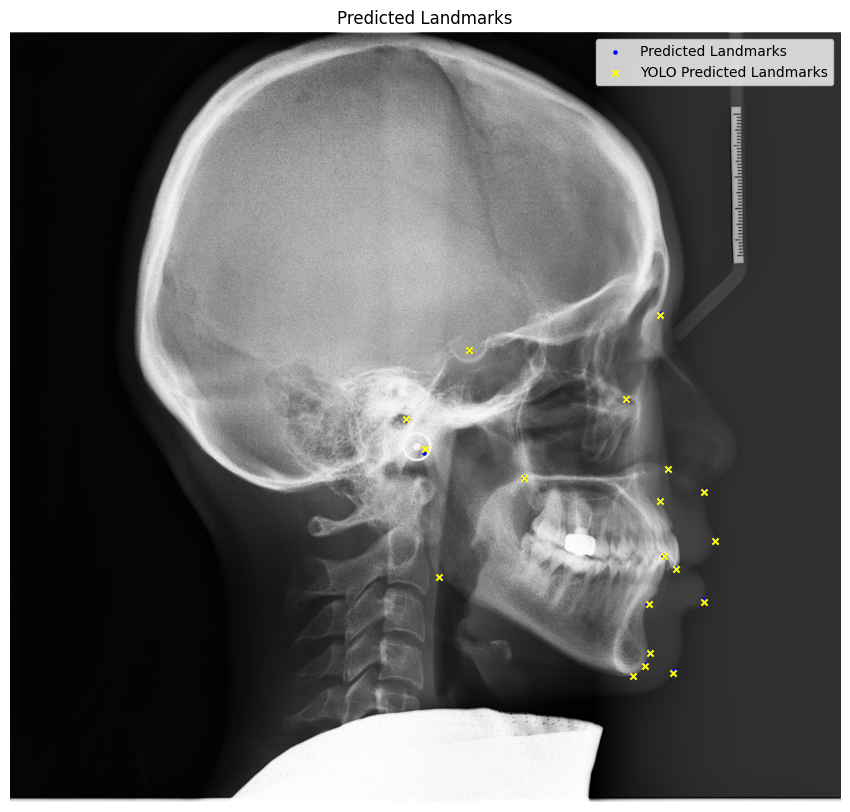

In [281]:
plot_landmarks(image_name='8.bmp', unseen_results=unseen_results, model=model, category_names_shorted=category_names_shorted)


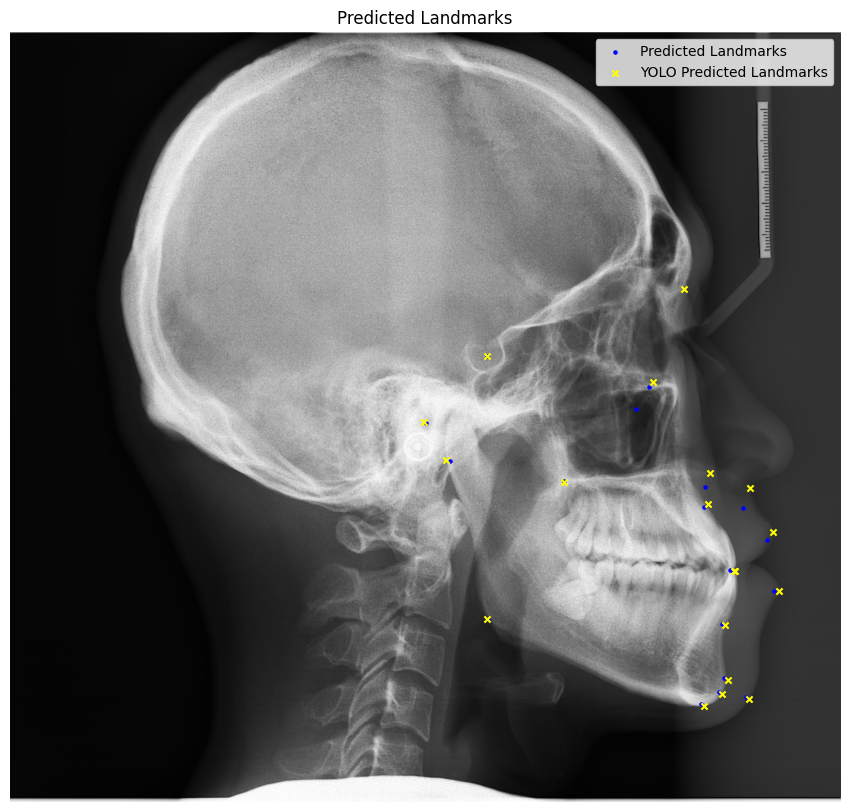

In [105]:
plot_landmarks(image_name='9.bmp', unseen_results=unseen_results, model=model, category_names_shorted=category_names_shorted)


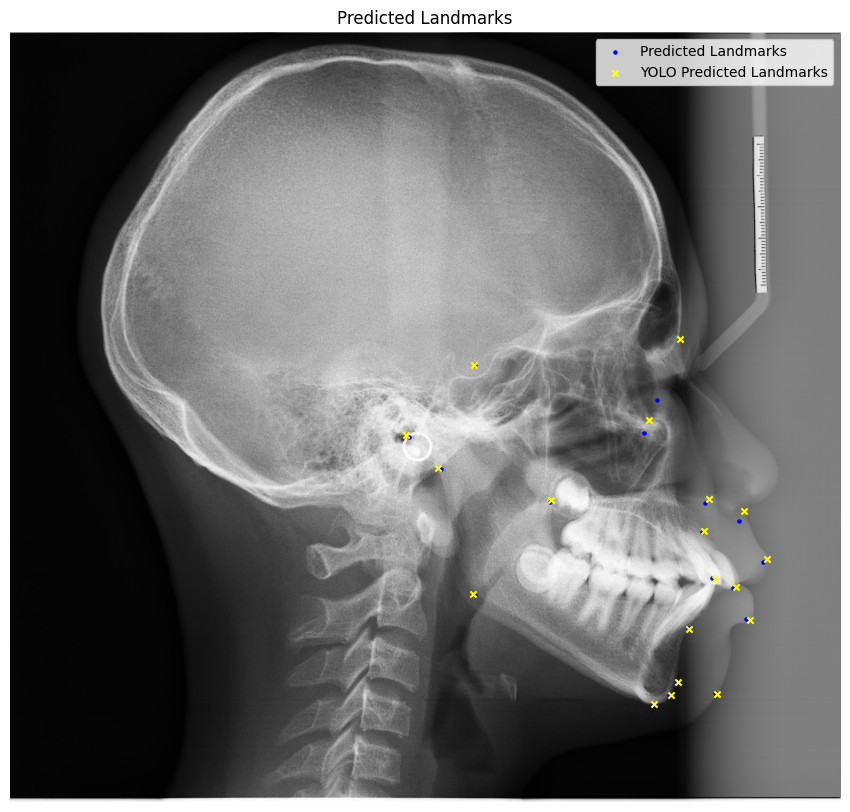

In [106]:
plot_landmarks(image_name='10.bmp', unseen_results=unseen_results, model=model, category_names_shorted=category_names_shorted)


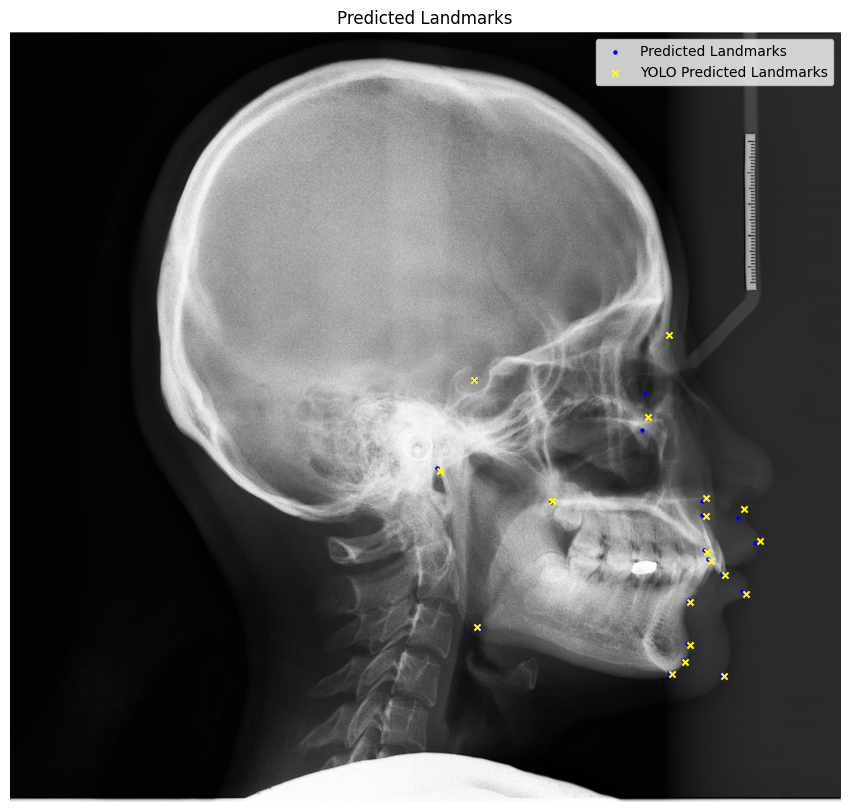

In [107]:
plot_landmarks(image_name='22.bmp', unseen_results=unseen_results, model=model, category_names_shorted=category_names_shorted)


In [85]:
unseen_folder = '/kaggle/working/PKU'
unseen_images = os.listdir(unseen_folder)
unseen_graphs_dict = {}
for i, img in enumerate(unseen_images):
    unseen_graphs_dict[img] = graphs[i]

In [285]:
unseen_graphs_dict

{'86.bmp': Data(x=[19, 2050], num_nodes=19),
 '32.bmp': Data(x=[19, 2050], num_nodes=19),
 '81.bmp': Data(x=[19, 2050], num_nodes=19),
 '80.bmp': Data(x=[19, 2050], num_nodes=19),
 '50.bmp': Data(x=[19, 2050], num_nodes=19),
 '48.bmp': Data(x=[19, 2050], num_nodes=19),
 '98.bmp': Data(x=[19, 2050], num_nodes=19),
 '61.bmp': Data(x=[19, 2050], num_nodes=19),
 '79.bmp': Data(x=[19, 2050], num_nodes=19),
 '101.bmp': Data(x=[19, 2050], num_nodes=19),
 '55.bmp': Data(x=[19, 2050], num_nodes=19),
 '57.bmp': Data(x=[19, 2050], num_nodes=19),
 '73.bmp': Data(x=[19, 2050], num_nodes=19),
 '41.bmp': Data(x=[19, 2050], num_nodes=19),
 '70.bmp': Data(x=[19, 2050], num_nodes=19),
 '30.bmp': Data(x=[19, 2050], num_nodes=19),
 '102.bmp': Data(x=[19, 2050], num_nodes=19),
 '84.bmp': Data(x=[19, 2050], num_nodes=19),
 '74.bmp': Data(x=[19, 2050], num_nodes=19),
 '100.bmp': Data(x=[19, 2050], num_nodes=19),
 '69.bmp': Data(x=[19, 2050], num_nodes=19),
 '11.bmp': Data(x=[19, 2050], num_nodes=19),
 '75.bm

In [88]:
# Usage:
errors_df, overall_stats, cumulative_errors_mm_pku = calculate_error_and_sdr_with_mm(
    unseen_results,
    unseen_labels,
    unseen_folder,
    model,
    unseen_graphs_dict
)

print("\nOverall Statistics:")
for metric, value in overall_stats.items():
    print(f"{metric}: {value}")

# Print results
print("\nResults by Landmark:")
errors_df = errors_df.drop(['YOLO_MRE_mm', 'YOLO_SD_mm', 'GNN_MRE_mm', 'GNN_SD_mm'], axis=1)
errors_df.at[15, 'Landmark'] = 'Pog`'
errors_df.at[14, 'Landmark'] = 'Sn'
errors_df


Overall Statistics:
Overall_YOLO_MRE: 1.66 ± 1.31
Overall_GNN_MRE: 1.66 ± 1.25
Overall_YOLO_SDR_2mm: 75.03
Overall_GNN_SDR_2mm: 76.57
Overall_YOLO_SDR_2.5mm: 81.89
Overall_GNN_SDR_2.5mm: 83.49
Overall_YOLO_SDR_3mm: 86.89
Overall_GNN_SDR_3mm: 88.29
Overall_YOLO_SDR_4mm: 93.50
Overall_GNN_SDR_4mm: 94.27
Overall_Best_SDR_2mm: 75.95
Overall_Best_SDR_2.5mm: 82.87
Overall_Best_SDR_3mm: 87.82
Overall_Best_SDR_4mm: 94.01

Results by Landmark:


,Landmark,YOLO_Error,GNN_Error,SDR_YOLO_2.0mm,SDR_YOLO_2.5mm,SDR_YOLO_3.0mm,SDR_YOLO_4.0mm,SDR_GNN_2.0mm,SDR_GNN_2.5mm,SDR_GNN_3.0mm,SDR_GNN_4.0mm,SDR_Best_2.0mm,SDR_Best_2.5mm,SDR_Best_3.0mm,SDR_Best_4.0mm,YOLO_Failures
0,S,0.62 ± 1.30,0.60 ± 1.34,99.019608,99.019608,99.019608,99.019608,99.019608,99.019608,99.019608,99.019608,99.019608,99.019608,99.019608,99.019608,0
1,N,0.96 ± 0.76,0.87 ± 0.79,96.078431,98.039216,98.039216,99.019608,96.078431,98.039216,99.019608,99.019608,96.078431,98.039216,98.039216,99.019608,0
2,Or,1.73 ± 1.06,1.84 ± 1.06,64.705882,79.411765,89.215686,96.078431,63.725490,77.450980,85.294118,97.058824,64.705882,79.411765,89.215686,96.078431,0
3,Po,5.60 ± 13.40,5.64 ± 13.30,20.588235,30.392157,39.215686,70.588235,19.607843,29.411765,40.196078,66.666667,20.588235,30.392157,39.215686,70.588235,0
4,A,2.78 ± 1.39,2.78 ± 1.34,32.352941,45.098039,59.803922,81.372549,32.352941,46.078431,60.784314,82.352941,32.352941,45.098039,59.803922,81.372549,0
5,B,2.44 ± 1.52,1.69 ± 1.24,47.058824,53.921569,68.627451,83.333333,68.627451,75.490196,88.235294,94.117647,68.627451,75.490196,88.235294,94.117647,0
6,Pog,0.73 ± 0.54,0.70 ± 0.52,96.078431,100.000000,100.000000,100.000000,97.058824,100.000000,100.000000,100.000000,96.078431,100.000000,100.000000,100.000000,0
7,Me,1.15 ± 0.67,0.93 ± 0.60,89.215686,98.039216,99.019608,99.019608,97.058824,99.019608,99.019608,99.019608,89.215686,98.039216,99.019608,99.019608,0
8,Gn,0.82 ± 0.55,0.85 ± 0.46,93.137255,100.000000,100.000000,100.000000,96.078431,100.000000,100.000000,100.000000,93.137255,100.000000,100.000000,100.000000,0
9,Go,2.08 ± 1.34,2.10 ± 1.30,55.882353,65.686275,75.490196,89.215686,52.941176,64.705882,76.470588,89.215686,55.882353,65.686275,75.490196,89.215686,0


In [89]:
t_test_df = calculate_t_tests(cumulative_errors_mm_pku)

# Display results
t_test_df

,Landmark,Mean_YOLO,Mean_GNN,T_YOLO_vs_GNN,P_YOLO_vs_GNN,Better_Model
0,S,0.616137,0.600494,1.012466,3.137344e-01,No Significant Difference
1,N,0.957060,0.871078,3.897572,1.749553e-04,GNN
2,Or,1.727656,1.842105,-5.988204,3.272382e-08,YOLO
3,Po,5.598496,5.637837,-2.074602,4.056603e-02,YOLO
4,A,2.782746,2.775238,0.341486,7.334470e-01,No Significant Difference
5,B,2.443262,1.692904,12.610934,1.827688e-22,GNN
6,Pog,0.729611,0.695267,1.206738,2.303517e-01,No Significant Difference
7,Me,1.150976,0.930080,10.931929,8.009698e-19,GNN
8,Gn,0.816804,0.845477,-1.197969,2.337327e-01,No Significant Difference
9,Go,2.077416,2.100460,-0.914926,3.624099e-01,No Significant Difference


In [73]:
import os
import numpy as np
import torch
import matplotlib.pyplot as plt
import math

def plot_landmark_predictions(folder, labels, results, model, graphs_dict, landmark_idx, num_images=10):
    os.makedirs(folder, exist_ok=True)
    pixel_to_mm = 0.1  # Conversion factor (1 pixel = 0.1mm)
    thresholds_mm = [2.0, 2.5, 3.0, 4.0]  # SDR thresholds in mm
    thresholds_px = [t / pixel_to_mm for t in thresholds_mm]  # Convert to pixels
    
    images = [img for img in os.listdir(folder) if img in labels and img in results['predictions']]
    # images = images[:num_images]  # Limit to requested number of images
    num_cols = 5
    num_rows = math.ceil(len(images) / num_cols)  # Calculate rows dynamically
    
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 4, num_rows * 4))
    axes = axes.flatten()  # Flatten to iterate easily
    
    for i, image_name in enumerate(images):
        ax = axes[i]
        
        ground_truth = labels[image_name]
        landmark_idx = str(landmark_idx)
        gt_center = np.array([float(ground_truth[landmark_idx]['x']), float(ground_truth[landmark_idx]['y'])])
        
        yolo_coords = results['predictions'][image_name]
        yolo_pred = np.array([float(yolo_coords[landmark_idx]['bbox'][0]), float(yolo_coords[landmark_idx]['bbox'][1])])
        
        gnn_pred = predict(model, graphs_dict[image_name])[int(landmark_idx)]
        if not isinstance(gnn_pred, torch.Tensor):
            gnn_pred = torch.tensor(gnn_pred, dtype=torch.float32)
        gnn_pred = gnn_pred.numpy()
        
        ax.set_title(f"{image_name} - Landmark {landmark_idx}", fontsize=10)
        # ax.set_xlim(gt_center[0] - thresholds_px[-1], gt_center[0] + thresholds_px[-1])
        # ax.set_ylim(gt_center[1] - thresholds_px[-1], gt_center[1] + thresholds_px[-1])
        
        ax.scatter(gt_center[0], gt_center[1], c='green', label='Ground Truth', marker='x', s=100)
        
        for t_px in thresholds_px:
            circle = plt.Circle(gt_center, t_px, color='black', fill=False, linestyle='dashed', alpha=0.6)
            ax.add_patch(circle)
        
        ax.scatter(yolo_pred[0], yolo_pred[1], c='red', label='YOLO', marker='x')
        ax.scatter(gnn_pred[0], gnn_pred[1], c='blue', label='GNN', marker='x')
        
        # ax.legend(fontsize=8)
        ax.invert_yaxis()
    
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()


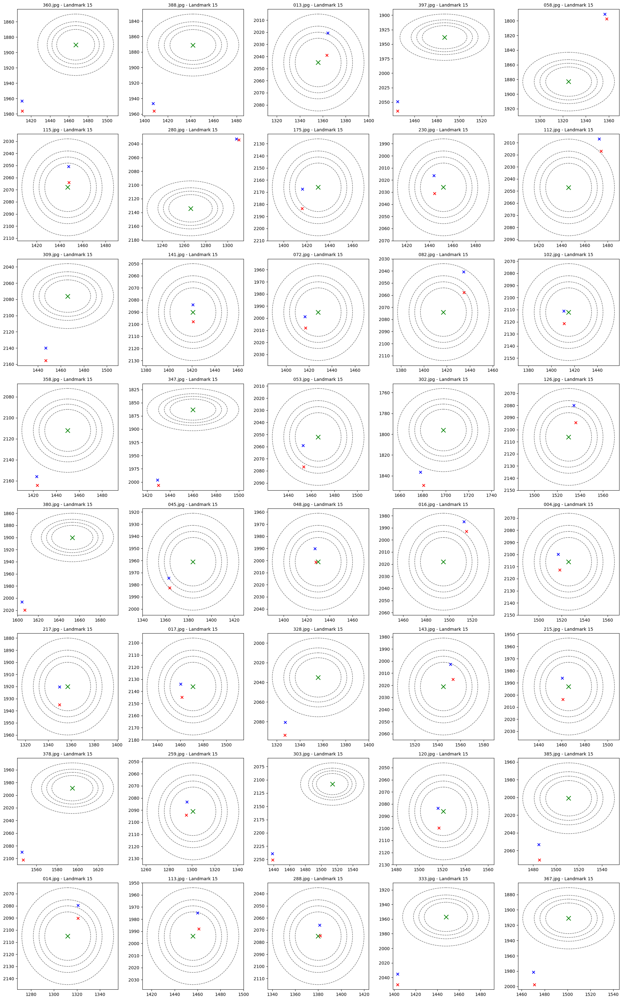

In [74]:
plot_landmark_predictions(test_folder, test_labels, test_results, model, test_graphs_dict, '15')# Usage:


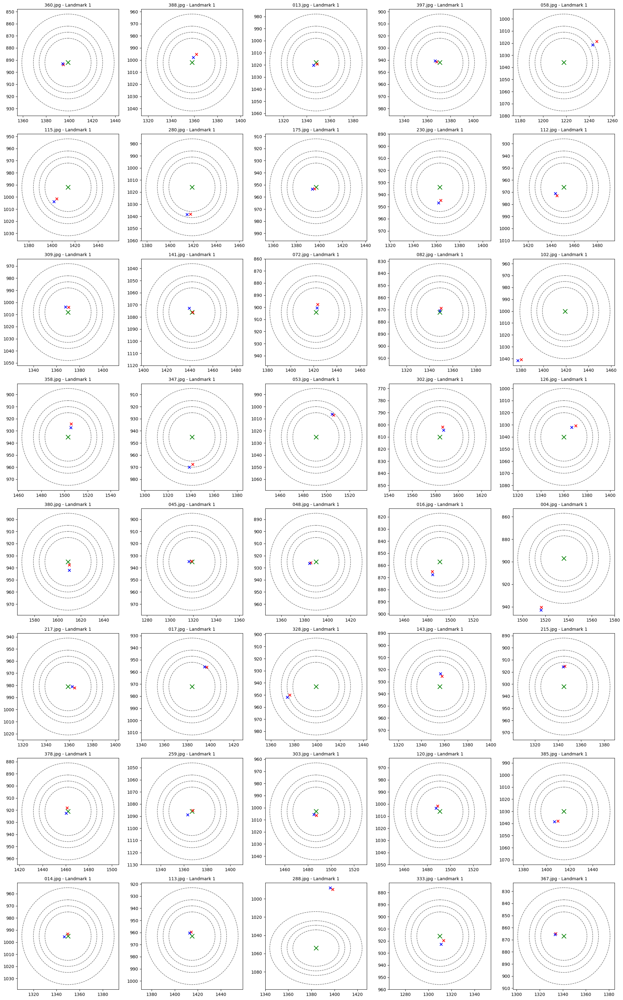

In [75]:
plot_landmark_predictions(test_folder, test_labels, test_results, model, test_graphs_dict, '1')# Usage:


# Other Visualizations

In [90]:
def get_gnns_outputs(model, graphs_dict, folder):
    results = {image: {} for image in os.listdir(folder)}
    for image_name in os.listdir(folder):
        # Get GNN predictions (in 640x640 space) and convert to original scale
        gnn_coords = predict(model, graphs_dict[image_name])
        gnn_coords = gnn_coords.tolist()
        # print(gnn_coords[0])
        for i in range(19):
            results[image_name][str(i)] = gnn_coords[i]
    return results

In [91]:
gnns_results = get_gnns_outputs(model, test_graphs_dict, test_folder)
gnns_results

{'360.jpg': {'0': [829.9484252929688, 1043.1956787109375],
  '1': [1394.322998046875, 892.96875],
  '2': [1329.8443603515625, 1131.9456787109375],
  '3': [657.2953491210938, 1222.35107421875],
  '4': [1458.312255859375, 1466.422607421875],
  '5': [1372.8433837890625, 1786.6448974609375],
  '6': [1329.517822265625, 1918.9766845703125],
  '7': [1283.8519287109375, 1977.4552001953125],
  '8': [1311.403076171875, 1964.6651611328125],
  '9': [771.5711059570312, 1693.0068359375],
  '10': [1510.3397216796875, 1640.1461181640625],
  '11': [1539.70751953125, 1667.1859130859375],
  '12': [1636.2589111328125, 1573.5037841796875],
  '13': [1566.5880126953125, 1762.353515625],
  '14': [1576.236572265625, 1420.9085693359375],
  '15': [1410.2503662109375, 1963.1884765625],
  '16': [1038.43896484375, 1409.9736328125],
  '17': [1482.4068603515625, 1379.86572265625],
  '18': [750.9395751953125, 1325.858154296875]},
 '388.jpg': {'0': [821.6722412109375, 1124.2469482421875],
  '1': [1359.1400146484375, 99

In [92]:
groundtruth = {}

for k, v in test_labels.items():  # Ensure proper unpacking
    groundtruth[k] = {}  # Initialize a nested dictionary
    for kk, vv in v.items():  # Ensure this is also a dictionary
        groundtruth[k][kk] = [vv['x'], vv['y']]  # Store bbox data
groundtruth

{'333.jpg': {'0': [756.0, 1003.0],
  '1': [1310.0, 916.0],
  '2': [1241.0, 1114.0],
  '3': [580.0, 1230.0],
  '4': [1382.0, 1468.0],
  '5': [1315.0, 1879.0],
  '6': [1320.0, 1976.0],
  '7': [1264.0, 2039.0],
  '8': [1302.0, 2016.0],
  '9': [701.0, 1712.0],
  '10': [1427.0, 1656.0],
  '11': [1462.0, 1685.0],
  '12': [1570.0, 1537.0],
  '13': [1527.0, 1799.0],
  '14': [1494.0, 1425.0],
  '15': [1448.0, 1957.0],
  '16': [967.0, 1387.0],
  '17': [1390.0, 1395.0],
  '18': [652.0, 1347.0]},
 '378.jpg': {'0': [887.0, 1024.0],
  '1': [1462.0, 921.0],
  '2': [1393.0, 1164.0],
  '3': [638.0, 1206.0],
  '4': [1478.0, 1500.0],
  '5': [1470.0, 1919.0],
  '6': [1484.0, 2016.0],
  '7': [1433.0, 2102.0],
  '8': [1470.0, 2065.0],
  '9': [832.0, 1821.0],
  '10': [1540.0, 1686.0],
  '11': [1564.0, 1709.0],
  '12': [1677.0, 1580.0],
  '13': [1650.0, 1823.0],
  '14': [1622.0, 1465.0],
  '15': [1595.0, 1989.0],
  '16': [1052.0, 1430.0],
  '17': [1503.0, 1434.0],
  '18': [713.0, 1342.0]},
 '230.jpg': {'0': [

In [93]:
yolo_results = {}

for k, v in test_results['predictions'].items():  # Ensure proper unpacking
    yolo_results[k] = {}  # Initialize a nested dictionary
    for kk, vv in v.items():  # Ensure this is also a dictionary
        yolo_results[k][kk] = vv['bbox'][:2]  # Store bbox data
yolo_results

{'360.jpg': {'0': [829.875732421875, 1046.288818359375],
  '1': [1394.8665771484375, 893.616455078125],
  '2': [1333.43115234375, 1132.155029296875],
  '3': [655.4317626953125, 1225.0283203125],
  '4': [1460.2625732421875, 1466.801025390625],
  '5': [1379.921142578125, 1774.0396728515625],
  '6': [1330.966796875, 1923.94140625],
  '7': [1284.566650390625, 1983.8070068359375],
  '8': [1313.482421875, 1965.6748046875],
  '9': [768.8832397460938, 1695.593017578125],
  '10': [1513.217041015625, 1638.492431640625],
  '11': [1541.7255859375, 1671.08740234375],
  '12': [1638.9495849609375, 1576.875],
  '13': [1569.2265625, 1764.1954345703125],
  '14': [1580.356201171875, 1418.774169921875],
  '15': [1410.700439453125, 1976.16845703125],
  '16': [1040.010009765625, 1409.204833984375],
  '17': [1485.557861328125, 1378.1041259765625],
  '18': [751.885009765625, 1321.0029296875]},
 '388.jpg': {'0': [821.3395385742188, 1126.506103515625],
  '1': [1361.944580078125, 995.0512084960938],
  '2': [1249

In [94]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm

def bland_altman_plot(data1, data2, title, xlabel, ylabel):
    """
    Plots a Bland-Altman graph to compare two sets of values.
    """
    data1, data2 = np.array(data1), np.array(data2)
    mean_values = (data1 + data2) / 2
    diff_values = data1 - data2  # Difference between the two sets

    mean_diff = np.mean(diff_values)
    std_diff = np.std(diff_values)
    upper_limit = mean_diff + 1.96 * std_diff
    lower_limit = mean_diff - 1.96 * std_diff

    plt.figure(figsize=(8, 6))
    plt.scatter(mean_values, diff_values, alpha=0.5)
    plt.axhline(mean_diff, color='red', linestyle='--', label=f"Mean Diff: {mean_diff:.2f}")
    plt.axhline(upper_limit, color='blue', linestyle='--', label=f"+1.96 SD: {upper_limit:.2f}")
    plt.axhline(lower_limit, color='blue', linestyle='--', label=f"-1.96 SD: {lower_limit:.2f}")
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.show()


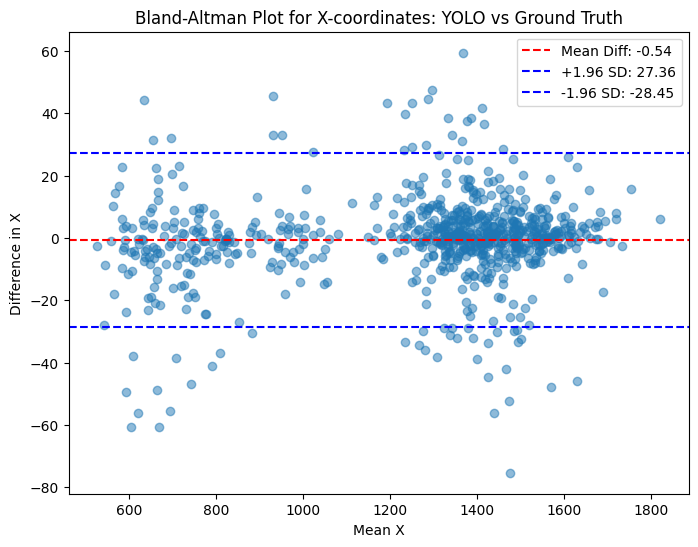

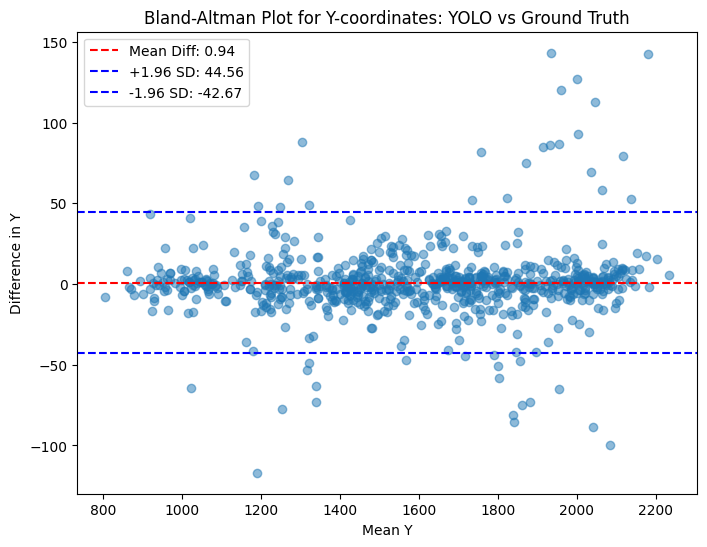

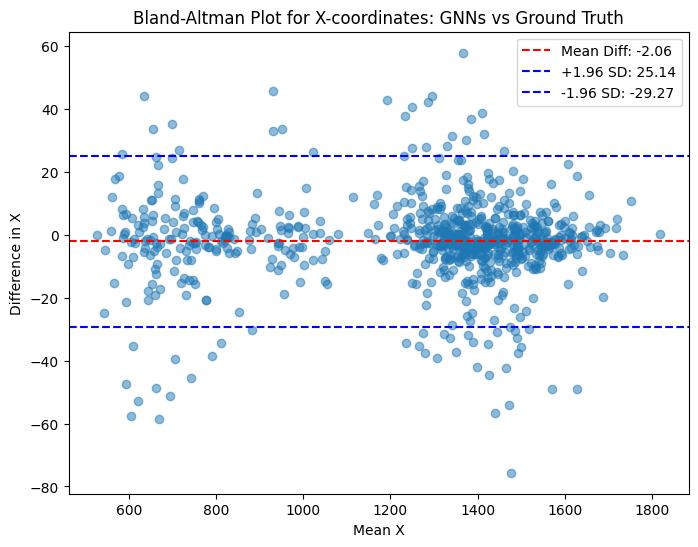

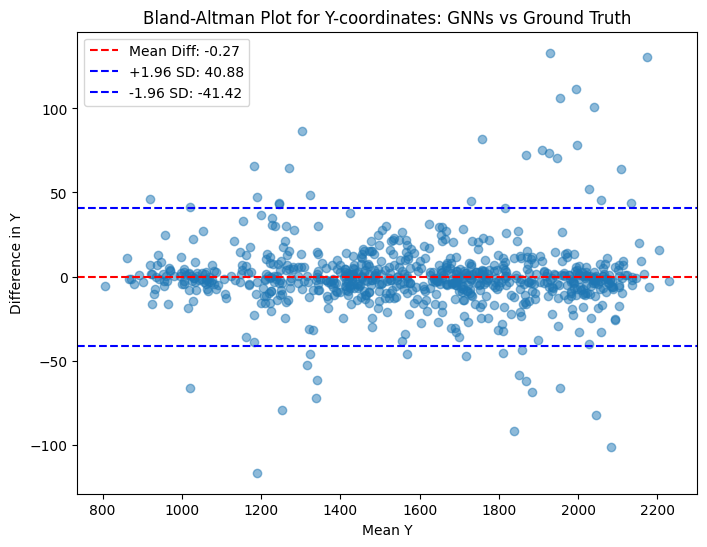

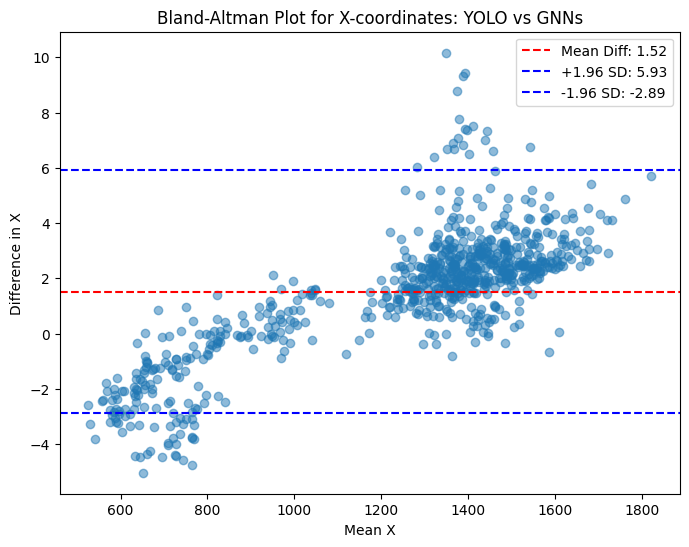

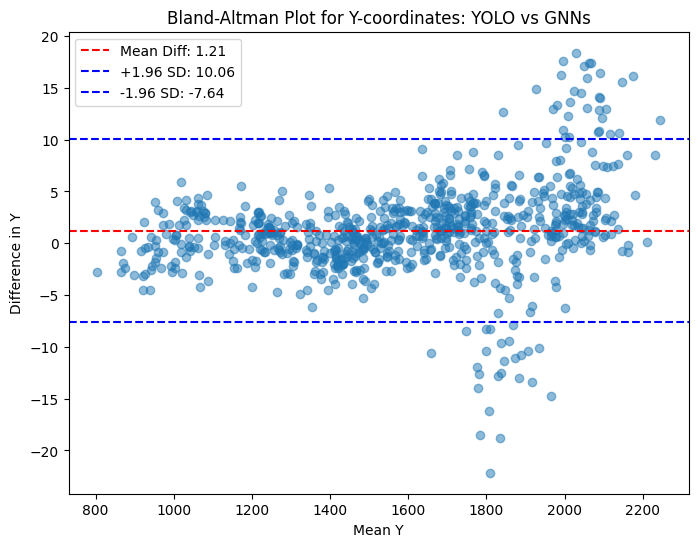

In [95]:
# Dictionaries: yolo_outputs, gnns_outputs, ground_truth
datasets = {
    "YOLO": yolo_results,
    "GNNs": gnns_results,
    "Ground Truth": groundtruth
}

# Define model names
comparisons = [
    ("YOLO", "Ground Truth"),
    ("GNNs", "Ground Truth"),
    ("YOLO", "GNNs")
]

# Extract data
for model1, model2 in comparisons:
    x_values1, y_values1 = [], []
    x_values2, y_values2 = [], []

    for image, landmarks in groundtruth.items():  # Iterate over images
        for landmark_id in landmarks.keys():  # Iterate over landmarks
            x1, y1 = datasets[model1][image][landmark_id]
            x2, y2 = datasets[model2][image][landmark_id]
            x_values1.append(x1)
            y_values1.append(y1)
            x_values2.append(x2)
            y_values2.append(y2)

    # Plot X-coordinates
    bland_altman_plot(
        x_values1, x_values2,
        title=f"Bland-Altman Plot for X-coordinates: {model1} vs {model2}",
        xlabel="Mean X",
        ylabel="Difference in X"
    )

    # Plot Y-coordinates
    bland_altman_plot(
        y_values1, y_values2,
        title=f"Bland-Altman Plot for Y-coordinates: {model1} vs {model2}",
        xlabel="Mean Y",
        ylabel="Difference in Y"
    )


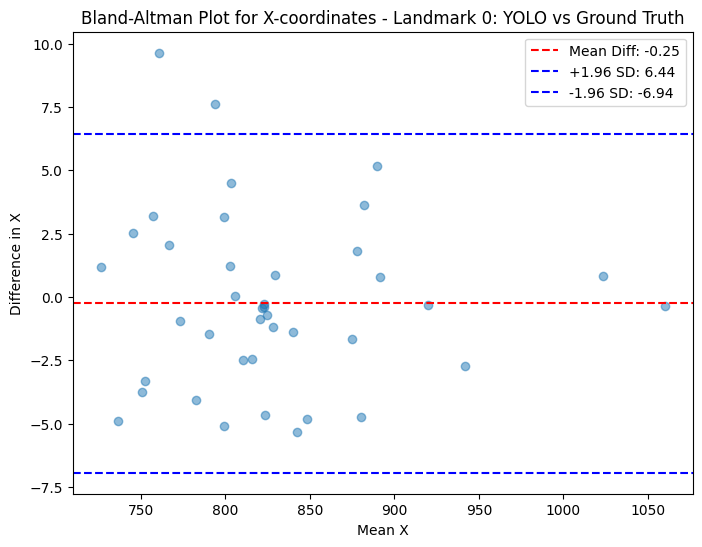

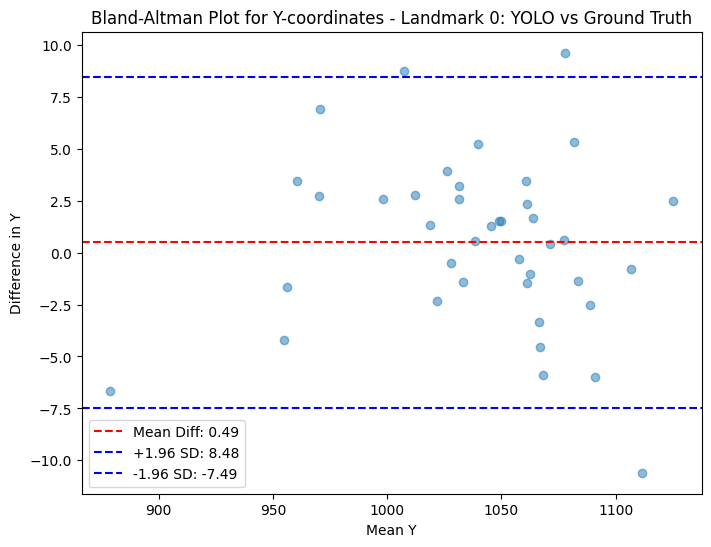

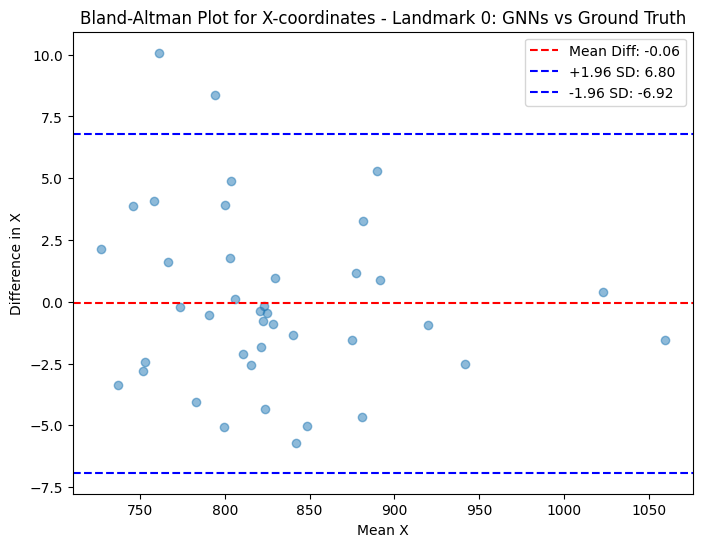

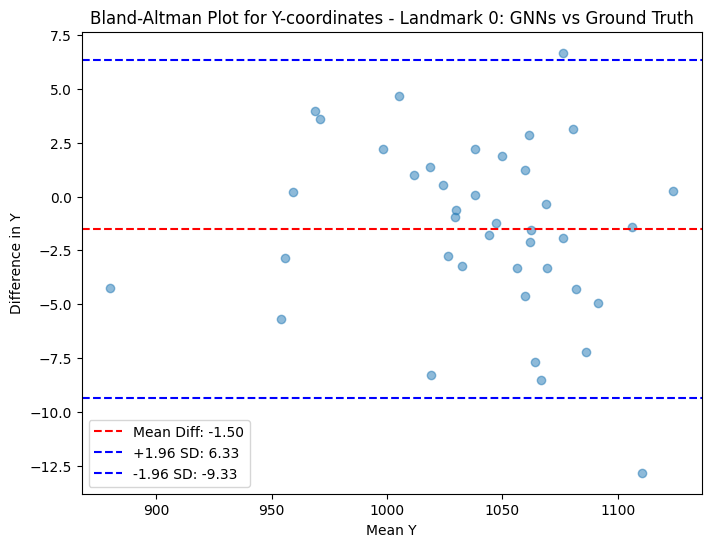

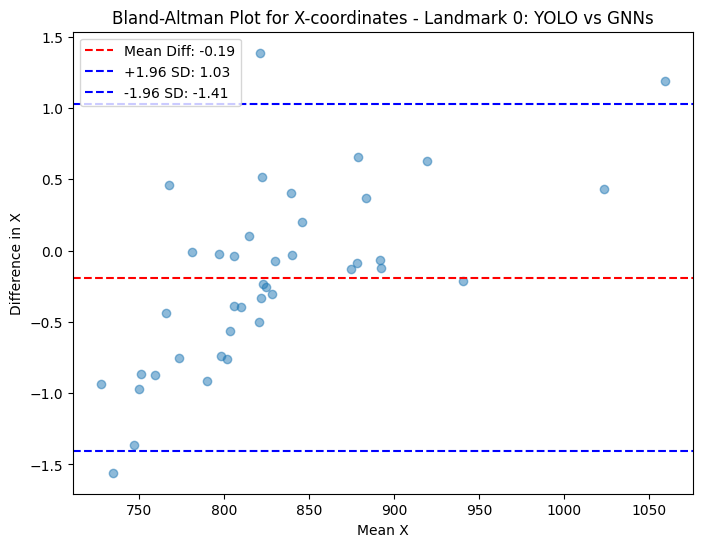

...

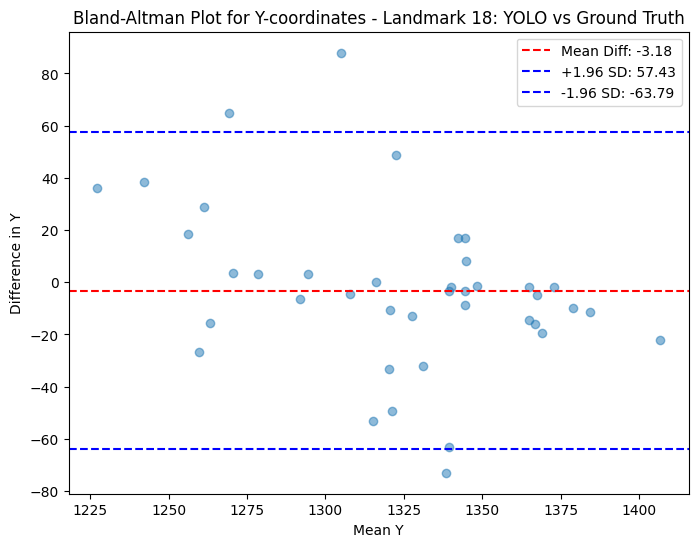

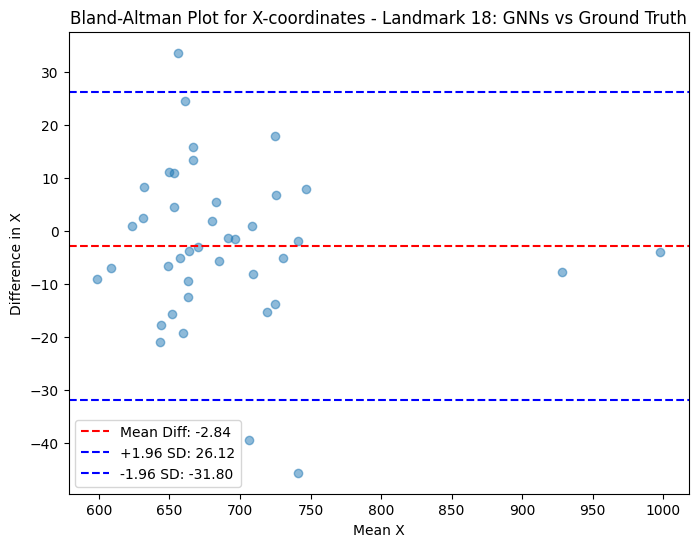

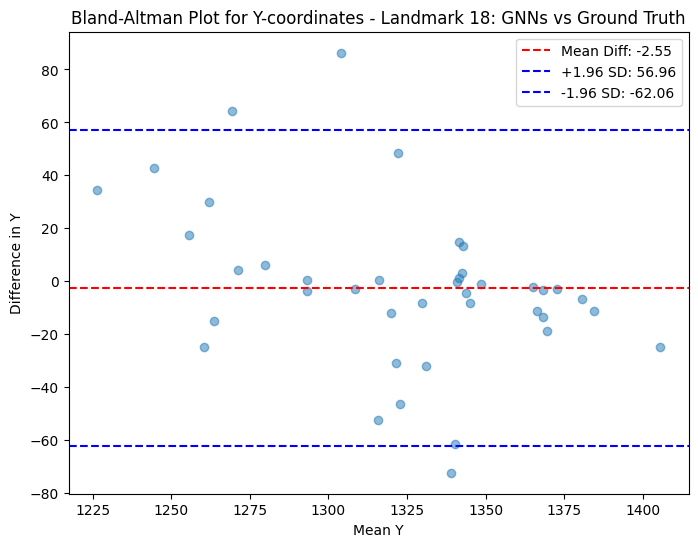

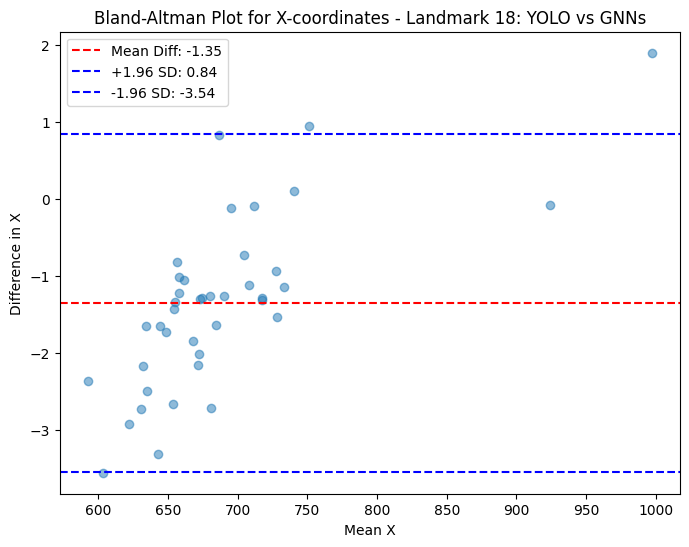

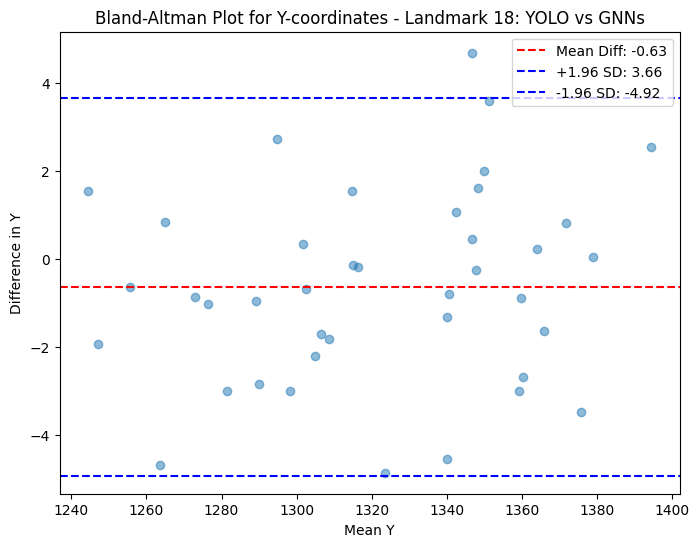

In [96]:
# Define model names
comparisons = [
    ("YOLO", "Ground Truth"),
    ("GNNs", "Ground Truth"),
    ("YOLO", "GNNs")
]

# Iterate over each landmark separately
for landmark_id in range(19):  # Assuming 19 landmarks
    for model1, model2 in comparisons:
        x_values1, y_values1 = [], []
        x_values2, y_values2 = [], []

        for image in groundtruth.keys():  # Iterate over all images
            if str(landmark_id) in groundtruth[image]:  # Ensure landmark exists
                x1, y1 = datasets[model1][image][str(landmark_id)]
                x2, y2 = datasets[model2][image][str(landmark_id)]
                x_values1.append(x1)
                y_values1.append(y1)
                x_values2.append(x2)
                y_values2.append(y2)

        # Plot X-coordinates for this landmark
        bland_altman_plot(
            x_values1, x_values2,
            title=f"Bland-Altman Plot for X-coordinates - Landmark {landmark_id}: {model1} vs {model2}",
            xlabel="Mean X",
            ylabel="Difference in X"
        )

        # Plot Y-coordinates for this landmark
        bland_altman_plot(
            y_values1, y_values2,
            title=f"Bland-Altman Plot for Y-coordinates - Landmark {landmark_id}: {model1} vs {model2}",
            xlabel="Mean Y",
            ylabel="Difference in Y"
        )


In [97]:
import numpy as np
import scipy.stats as stats

# Example data structure (your actual data will come from your dictionaries)
# ground_truth = {'126.jpg': {'0': [100, 200], '1': [150, 250]}}  # (x, y) coordinates
# yolo_results = {'126.jpg': {'0': [110, 190], '1': [140, 260]}}
# gnn_results = {'126.jpg': {'0': [105, 195], '1': [148, 252]}}

# Compute Mean Radial Error (MRE)
def compute_mre(predictions, groundtruth):
    errors = []
    for img, landmarks in groundtruth.items():
        for lm_id, gt_coords in landmarks.items():
            pred_coords = predictions[img][lm_id]
            error = np.sqrt((gt_coords[0] - pred_coords[0])**2 + (gt_coords[1] - pred_coords[1])**2)
            errors.append(error)
    return np.array(errors)

# Compute errors for YOLO and GNNs
yolo_errors = compute_mre(yolo_results, groundtruth)
gnn_errors = compute_mre(gnns_results, groundtruth)

# Compute paired differences
differences = yolo_errors - gnn_errors

# Perform paired t-test
t_stat, p_value = stats.ttest_rel(yolo_errors, gnn_errors)

# Print results
print(f"T-statistic: {t_stat:.4f}")
print(f"P-value: {p_value:.4f}")

# Interpretation
if p_value < 0.05:
    print("Statistically significant difference (GNNs outperform YOLO or vice versa).")
else:
    print("No significant difference (both models perform similarly).")


T-statistic: 0.8638
P-value: 0.3880
No significant difference (both models perform similarly).


In [99]:
gnn_results = gnns_results
ground_truth = groundtruth

In [102]:
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt

# Function to compute Mean Radial Error (MRE)
def compute_mre(predictions, ground_truth):
    errors = {lm_id: [] for lm_id in ground_truth[next(iter(ground_truth))]}  # Create dict for each landmark
    image_errors = {img: [] for img in ground_truth}  # Create dict for each image
    all_errors = []  # Store global errors

    for img, landmarks in ground_truth.items():
        for lm_id, gt_coords in landmarks.items():
            pred_coords = predictions[img][lm_id]
            error = np.sqrt((gt_coords[0] - pred_coords[0])**2 + (gt_coords[1] - pred_coords[1])**2)
            
            errors[lm_id].append(error)  # Store per landmark
            image_errors[img].append(error)  # Store per image
            all_errors.append(error)  # Store globally

    return errors, image_errors, np.array(all_errors)

# Compute errors for YOLO and GNNs
yolo_landmark_errors, yolo_image_errors, yolo_global_errors = compute_mre(yolo_results, ground_truth)
gnn_landmark_errors, gnn_image_errors, gnn_global_errors = compute_mre(gnn_results, ground_truth)

# Function to perform paired t-test
def paired_ttest(data1, data2, level="Global"):
    t_stat, p_value = stats.ttest_rel(data1, data2)
    mean_diff = np.mean(data1 - data2)
    
    print(f"\n{level} Analysis:")
    print(f"Mean Difference: {mean_diff:.4f}")
    print(f"T-statistic: {t_stat:.4f}")
    print(f"P-value: {p_value:.4f}")
    
    if p_value < 0.05:
        print(f"✅ Significant difference: One model is better at {level} level!")
        if mean_diff > 0:
            print("➡️ GNNs outperform YOLO (lower errors).")
        else:
            print("➡️ YOLO outperforms GNNs (lower errors).")
    else:
        print("⚠️ No significant difference at this level.")

# Global analysis
paired_ttest(yolo_global_errors, gnn_global_errors, "Global")

# Per landmark analysis
for lm_id in yolo_landmark_errors.keys():
    paired_ttest(np.array(yolo_landmark_errors[lm_id]), np.array(gnn_landmark_errors[lm_id]), f"Landmark {lm_id}")

# # Per image analysis
# for img_id in yolo_image_errors.keys():
#     paired_ttest(np.array(yolo_image_errors[img_id]), np.array(gnn_image_errors[img_id]), f"Image {img_id}")





Global Analysis:
Mean Difference: 0.1249
T-statistic: 0.8638
P-value: 0.3880
⚠️ No significant difference at this level.

Landmark 0 Analysis:
Mean Difference: -0.2091
T-statistic: -0.6203
P-value: 0.5387
⚠️ No significant difference at this level.

Landmark 1 Analysis:
Mean Difference: -0.5303
T-statistic: -1.5188
P-value: 0.1369
⚠️ No significant difference at this level.

Landmark 2 Analysis:
Mean Difference: -0.1445
T-statistic: -0.4842
P-value: 0.6310
⚠️ No significant difference at this level.

Landmark 3 Analysis:
Mean Difference: 0.3238
T-statistic: 0.9455
P-value: 0.3502
⚠️ No significant difference at this level.

Landmark 4 Analysis:
Mean Difference: 0.1672
T-statistic: 0.6019
P-value: 0.5508
⚠️ No significant difference at this level.

Landmark 5 Analysis:
Mean Difference: 3.2789
T-statistic: 2.1340
P-value: 0.0392
✅ Significant difference: One model is better at Landmark 5 level!
➡️ GNNs outperform YOLO (lower errors).

Landmark 6 Analysis:
Mean Difference: 0.0044
T-stati

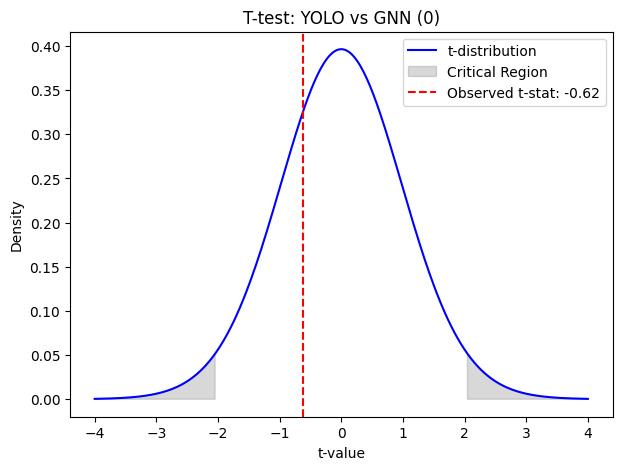

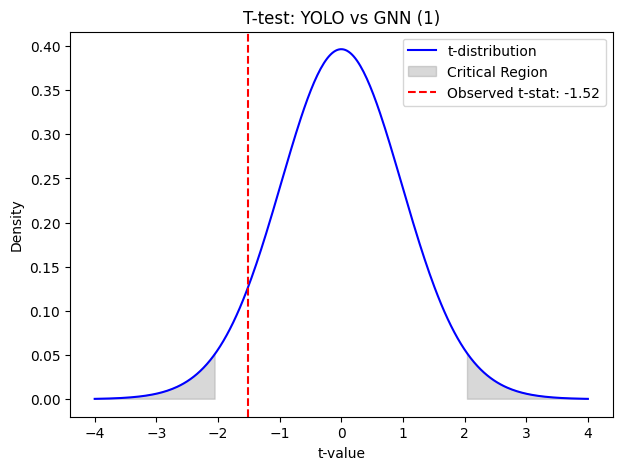

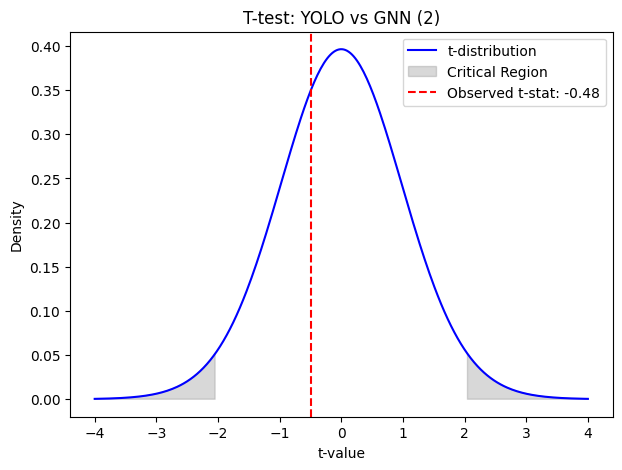

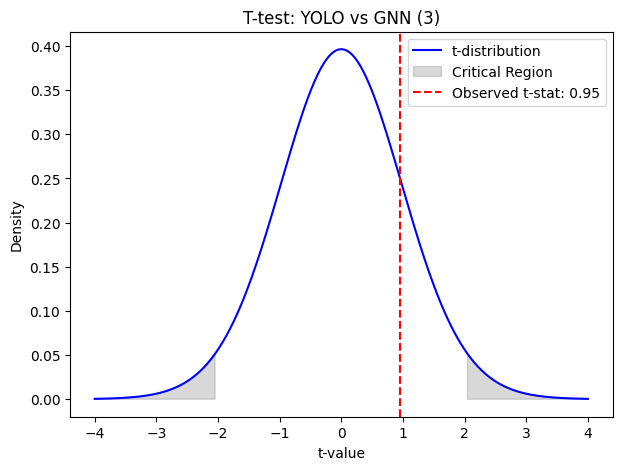

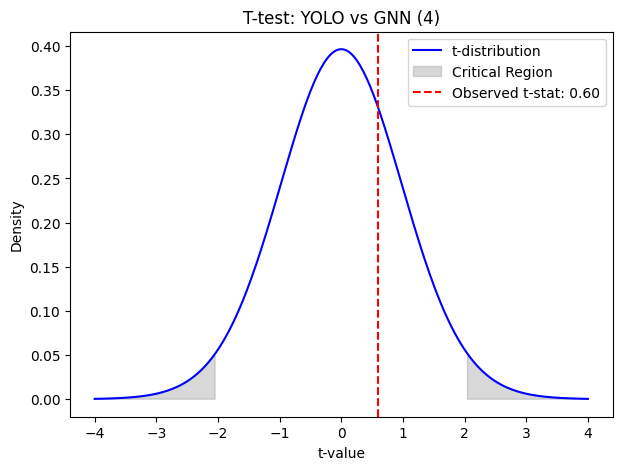

...

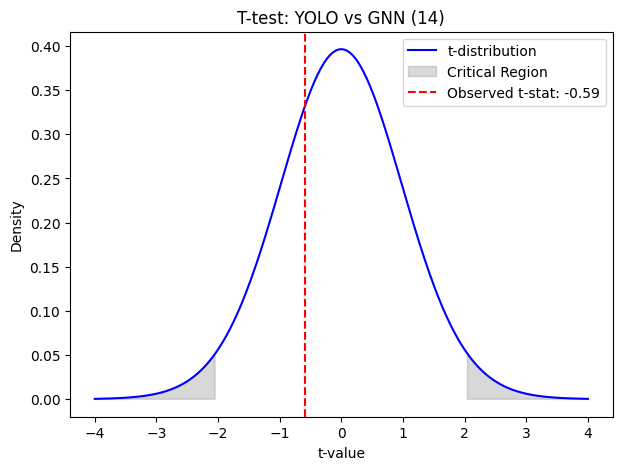

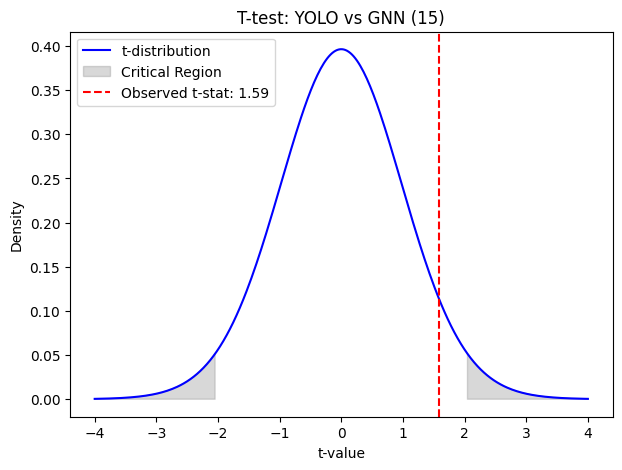

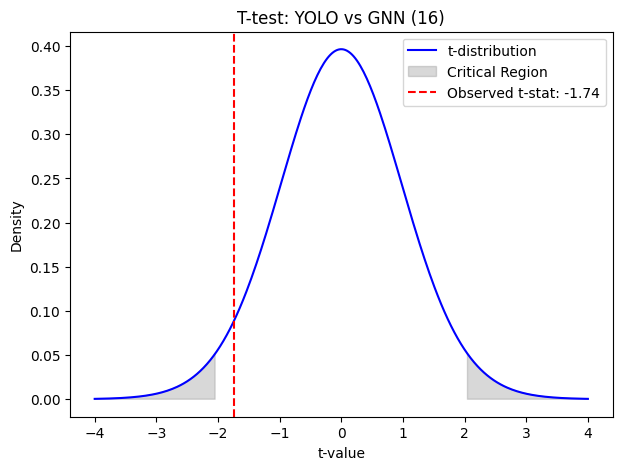

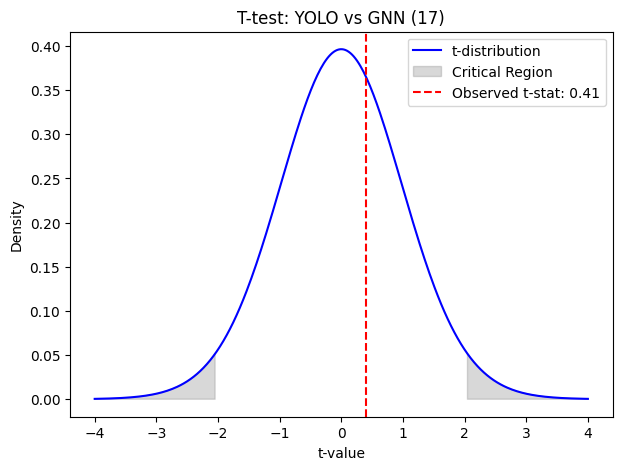

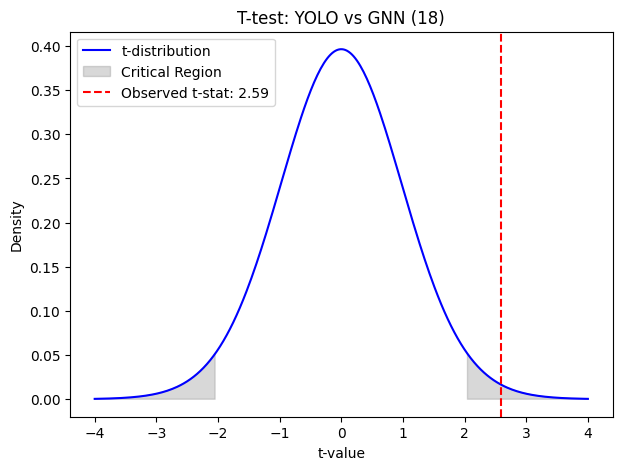

,Landmark,Mean_YOLO,Mean_GNN,T_YOLO_vs_GNN,P_YOLO_vs_GNN,Better_Model
0,0,0.455362,0.476268,-0.620244,0.538705,No Significant Difference
1,1,1.261125,1.314154,-1.518758,0.136889,No Significant Difference
2,2,2.330456,2.344903,-0.484147,0.630990,No Significant Difference
3,3,2.591642,2.559264,0.945533,0.350208,No Significant Difference
4,4,1.913748,1.897024,0.601857,0.550753,No Significant Difference
5,5,3.060112,2.732228,2.133995,0.039187,GNN
6,6,0.763642,0.763200,0.010473,0.991697,No Significant Difference
7,7,0.752082,0.817387,-1.650845,0.106802,No Significant Difference
8,8,0.593769,0.777699,-4.410671,0.000079,YOLO
9,9,2.333037,2.323261,0.198247,0.843882,No Significant Difference


In [103]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import ttest_rel, t

def calculate_t_tests_with_plots(cumulative_errors_mm):
    """
    Performs paired t-tests on error distributions:
    1. YOLO vs GNN
    Generates t-test results and visualizations for each comparison.
    """
    t_test_results = []
    
    def plot_t_test(t_stat, df, title):
        """ Helper function to visualize t-test results """
        x = np.linspace(-4, 4, 300)  # Range for t-distribution
        y = t.pdf(x, df)  # Compute t-distribution
        
        plt.figure(figsize=(7, 5))
        plt.plot(x, y, label="t-distribution", color="blue")
        
        # Critical region shading
        critical_val = t.ppf(0.975, df)  # 95% confidence interval
        plt.fill_between(x, 0, y, where=(x < -critical_val) | (x > critical_val), color='gray', alpha=0.3, label="Critical Region")
        
        # Observed t-statistic
        plt.axvline(t_stat, color='red', linestyle='dashed', label=f"Observed t-stat: {t_stat:.2f}")
        
        plt.title(title)
        plt.legend()
        plt.xlabel("t-value")
        plt.ylabel("Density")
        plt.show()
    
    for landmark, errors in cumulative_errors_mm.items():
        yolo_errors = np.array(errors['yolo'])
        gnn_errors = np.array(errors['gnn'])

        if len(yolo_errors) != len(gnn_errors):
            print(f"Skipping landmark {landmark} due to unequal sample sizes.")
            continue
        
        # Perform paired t-test
        t_yolo_vs_gnn, p_yolo_vs_gnn = ttest_rel(yolo_errors, gnn_errors)

        # Compute mean errors
        mean_yolo = np.mean(yolo_errors)
        mean_gnn = np.mean(gnn_errors)

        # Determine the better model with statistical significance
        if p_yolo_vs_gnn < 0.05:  # Significant difference
            better_model = "YOLO" if mean_yolo < mean_gnn else "GNN"
        else:
            better_model = "No Significant Difference"

        # Append results
        t_test_results.append({
            'Landmark': landmark,
            'Mean_YOLO': mean_yolo,
            'Mean_GNN': mean_gnn,
            'T_YOLO_vs_GNN': t_yolo_vs_gnn,
            'P_YOLO_vs_GNN': p_yolo_vs_gnn,
            'Better_Model': better_model
        })

        # Plot t-test results
        df = len(yolo_errors) - 1
        plot_t_test(t_yolo_vs_gnn, df, f"T-test: YOLO vs GNN ({landmark})")
    
    return pd.DataFrame(t_test_results)

# Example usage:
t_test_df = calculate_t_tests_with_plots(cumulative_errors_mm_best)

# Display results
print()
t_test_df

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


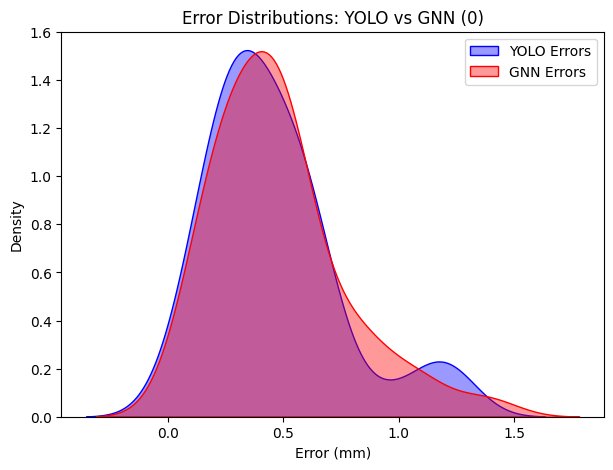

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


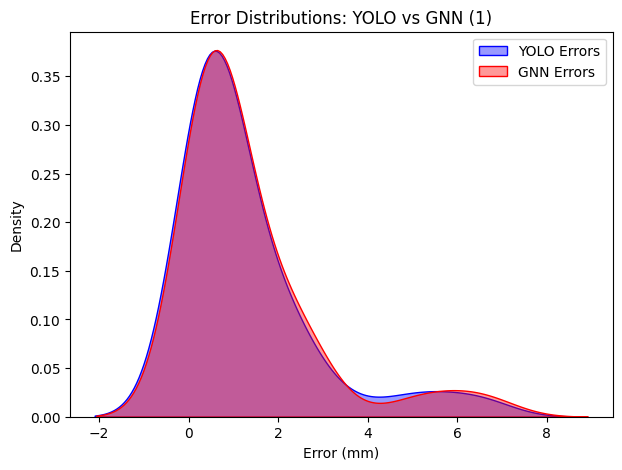

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


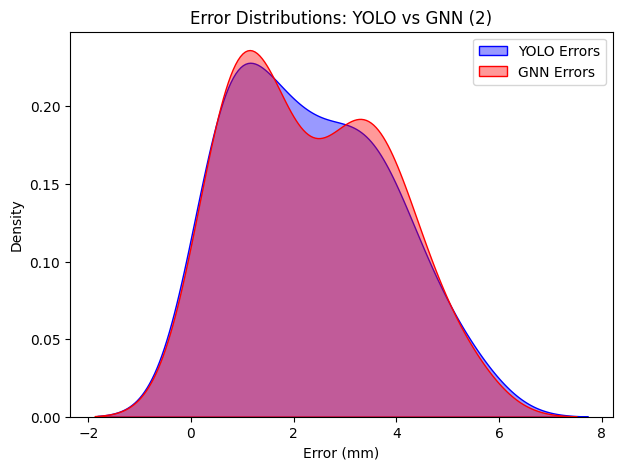

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


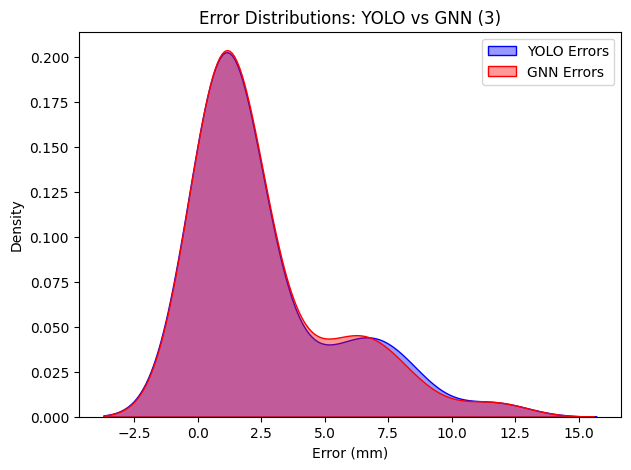

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


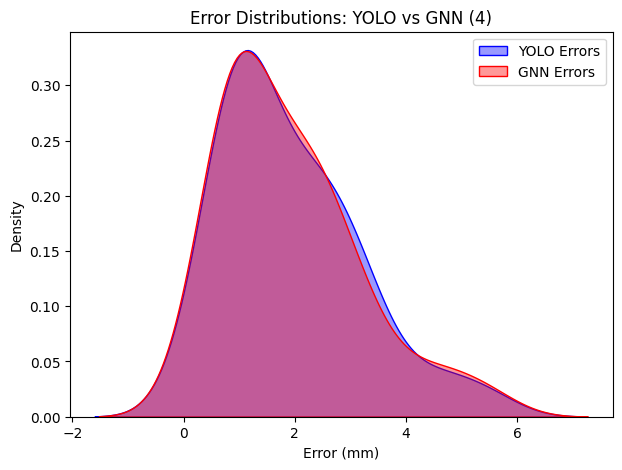

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


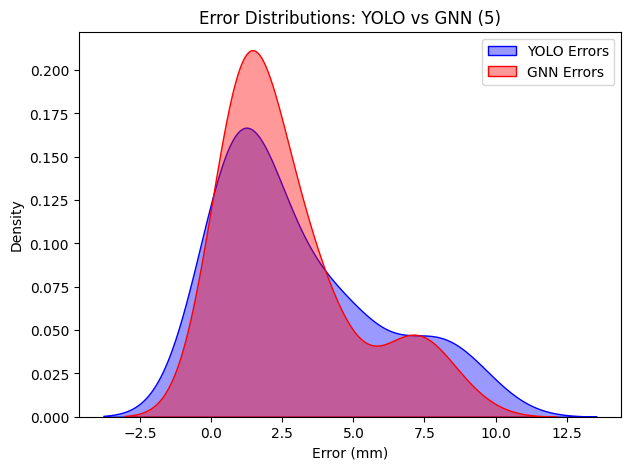

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


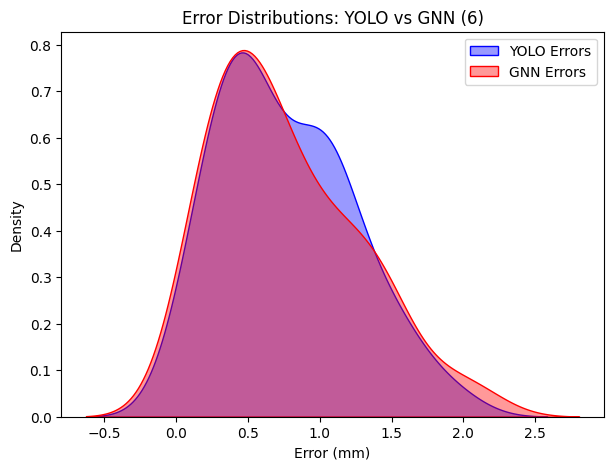

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


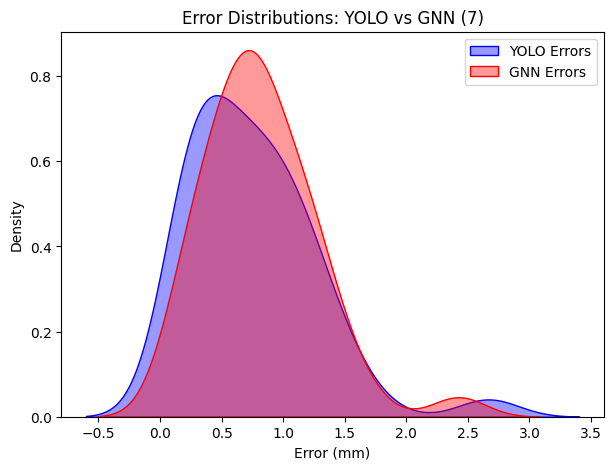

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


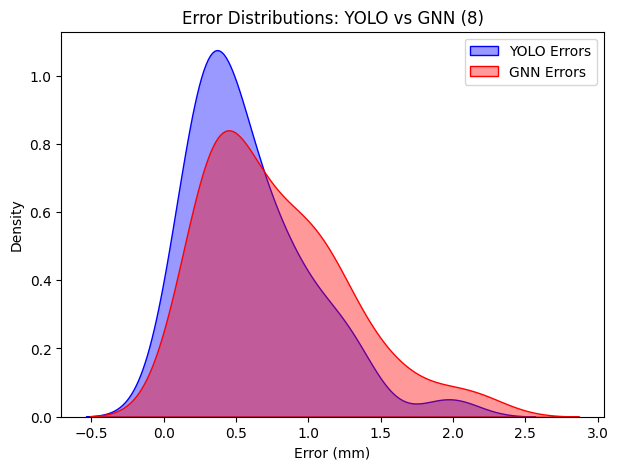

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


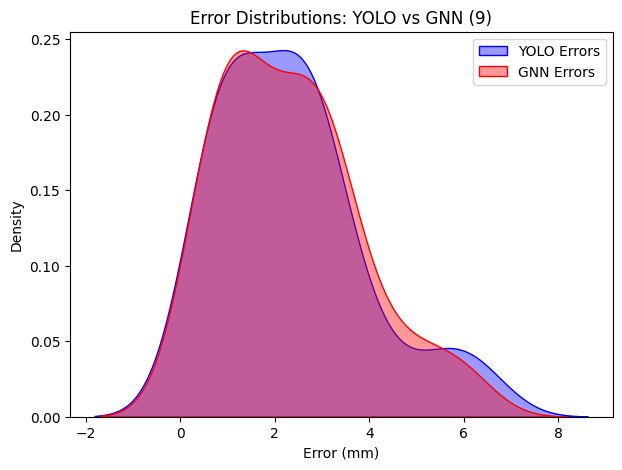

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


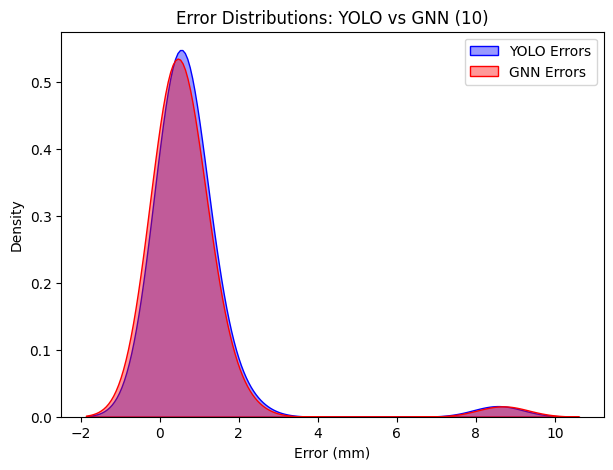

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


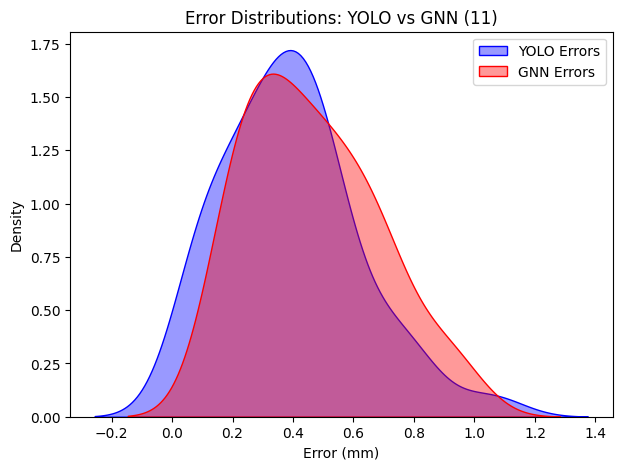

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


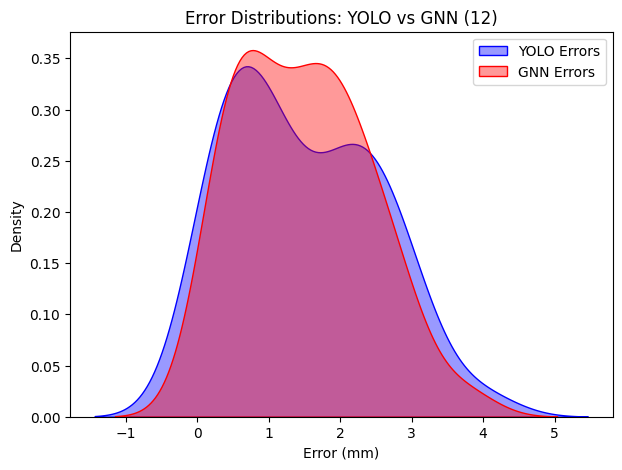

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


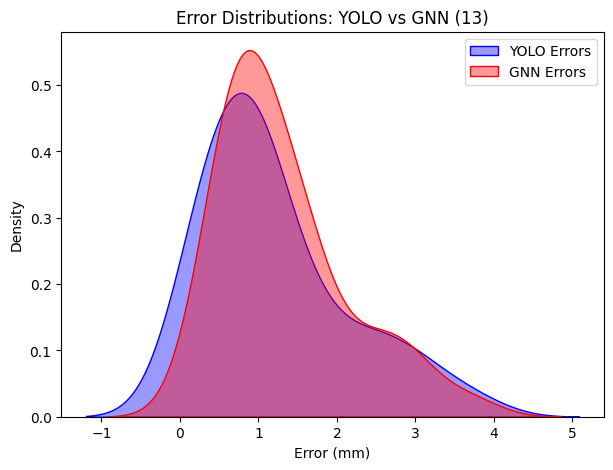

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


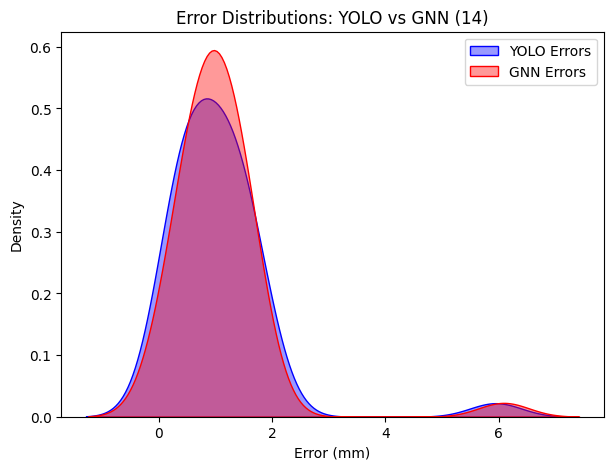

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


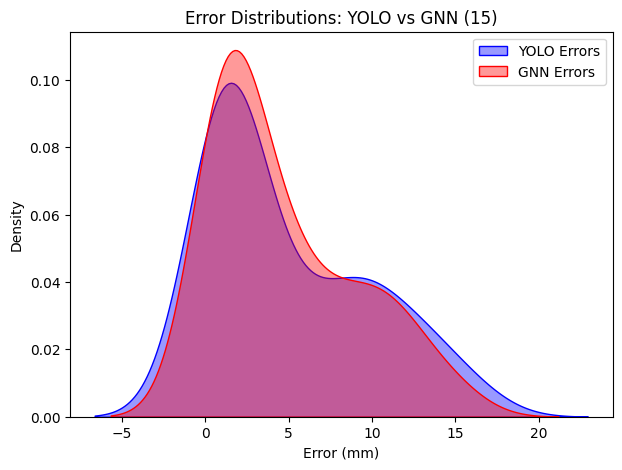

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


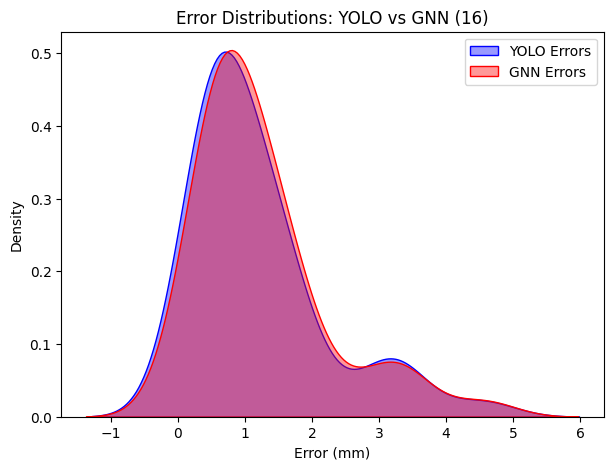

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


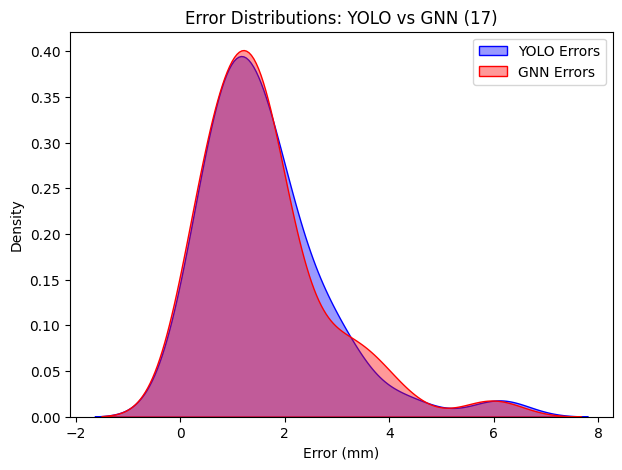

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.


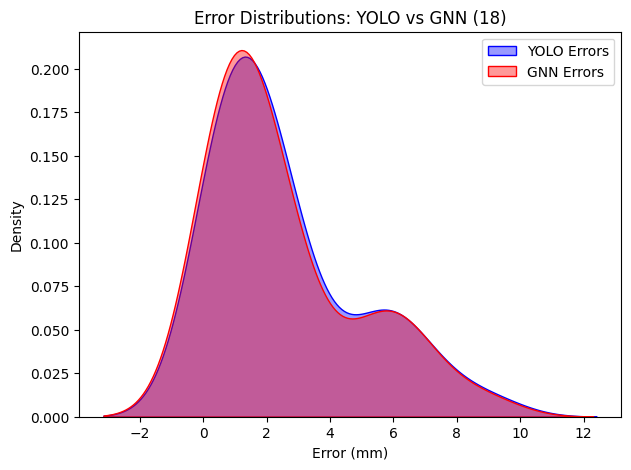

In [104]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def plot_error_distributions(cumulative_errors_mm):
    """
    Plots the error distributions of YOLO and GNN for each landmark.
    """
    for landmark, errors in cumulative_errors_mm.items():
        yolo_errors = np.array(errors['yolo'])
        gnn_errors = np.array(errors['gnn'])

        plt.figure(figsize=(7, 5))
        
        # KDE plot for YOLO errors
        sns.kdeplot(yolo_errors, fill=True, color="blue", alpha=0.4, label="YOLO Errors")
        
        # KDE plot for GNN errors
        sns.kdeplot(gnn_errors, fill=True, color="red", alpha=0.4, label="GNN Errors")
        
        plt.title(f"Error Distributions: YOLO vs GNN ({landmark})")
        plt.xlabel("Error (mm)")
        plt.ylabel("Density")
        plt.legend()
        plt.show()

# Example usage
plot_error_distributions(cumulative_errors_mm_best)
